The dataframe in this notebook is filtered using the wighted vote score of every review (weighted vote score is steam's helpfulness rating system)

In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import warnings
warnings.filterwarnings("ignore", category = DeprecationWarning)
warnings.filterwarnings("ignore", category = FutureWarning)
warnings.filterwarnings("ignore", category = UserWarning)

# preprocessing
import re
import string 
import itertools # for flattening

# nltk library
import nltk
from nltk.tokenize import word_tokenize, sent_tokenize, regexp_tokenize, RegexpTokenizer
from nltk.stem import PorterStemmer
from nltk.corpus import stopwords
from nltk import FreqDist
from wordcloud import WordCloud
from nltk.stem.wordnet import WordNetLemmatizer 
from nltk.corpus import wordnet
from nltk import pos_tag
from nltk.util import ngrams
from nltk.collocations import BigramAssocMeasures, BigramCollocationFinder 
from langdetect import detect
from nltk.util import ngrams

from wordcloud import WordCloud

nltk.download('punkt', quiet=True)
nltk.download('stopwords')
nltk.download('words')
nltk.download('averaged_perceptron_tagger')
nltk.download('wordnet')
nltk.download('omw-1.4')

# sklearn library 
from sklearn.model_selection import train_test_split
from sklearn.base import TransformerMixin, BaseEstimator
from sklearn.feature_extraction.text import CountVectorizer
from sklearn.feature_extraction.text import TfidfTransformer
from sklearn.manifold import TSNE
from sklearn.decomposition import NMF
from sklearn.model_selection import train_test_split, GridSearchCV
from sklearn.feature_extraction.text import TfidfVectorizer, CountVectorizer
from sklearn.linear_model import LogisticRegression
from sklearn.naive_bayes import MultinomialNB
from sklearn.neighbors import KNeighborsClassifier
from sklearn.tree import DecisionTreeClassifier
from sklearn.ensemble import RandomForestClassifier
from sklearn.ensemble import AdaBoostClassifier, GradientBoostingClassifier
from xgboost import XGBClassifier
from sklearn.ensemble import StackingClassifier
from sklearn.metrics import accuracy_score, precision_score, recall_score, f1_score, confusion_matrix, ConfusionMatrixDisplay, plot_roc_curve
from sklearn.metrics import plot_confusion_matrix
from sklearn.metrics import classification_report
from sklearn.metrics import plot_roc_curve, RocCurveDisplay
from sklearn.metrics import roc_auc_score
from sklearn.metrics import ConfusionMatrixDisplay
from imblearn.pipeline import Pipeline
from sklearn.preprocessing import StandardScaler, MinMaxScaler
from sklearn.compose import ColumnTransformer


from imblearn.over_sampling import SMOTE
from imblearn.over_sampling import RandomOverSampler
from imblearn.under_sampling import RandomUnderSampler
import pyLDAvis.sklearn

import pickle
from pprint import pprint

# Gensim package for topic modeling

import gensim, spacy, logging, warnings
from gensim import corpora
from gensim import models
from gensim.models import LdaModel, LdaMulticore
from gensim.models import CoherenceModel
import matplotlib.colors as mcolors
import pyLDAvis
import pyLDAvis.gensim_models as gensimvis
pyLDAvis.enable_notebook()

# prince package

import prince

[nltk_data] Downloading package stopwords to
[nltk_data]     C:\Users\jocel\AppData\Roaming\nltk_data...
[nltk_data]   Package stopwords is already up-to-date!
[nltk_data] Downloading package words to
[nltk_data]     C:\Users\jocel\AppData\Roaming\nltk_data...
[nltk_data]   Package words is already up-to-date!
[nltk_data] Downloading package averaged_perceptron_tagger to
[nltk_data]     C:\Users\jocel\AppData\Roaming\nltk_data...
[nltk_data]   Package averaged_perceptron_tagger is already up-to-
[nltk_data]       date!
[nltk_data] Downloading package wordnet to
[nltk_data]     C:\Users\jocel\AppData\Roaming\nltk_data...
[nltk_data]   Package wordnet is already up-to-date!
[nltk_data] Downloading package omw-1.4 to
[nltk_data]     C:\Users\jocel\AppData\Roaming\nltk_data...
[nltk_data]   Package omw-1.4 is already up-to-date!
C:\Users\jocel\anaconda3\lib\site-packages\past\builtins\misc.py:45: DeprecationWarning: the imp module is deprecated in favour of importlib; see the module's docu

In [2]:
# preprocessed dataframe

df = pd.read_pickle(r'final_gensim_df.pkl')
df

,num_games_owned,num_reviews,playtime_forever,playtime_last_two_weeks,review,voted_up,votes_up,votes_funny,weighted_vote_score,comment_count,review_preprocessed,joined_review_preprocessed
0,236,22,5650,0,The best game of all time. Don't believe me? P...,1,0,0,0.000000,0,"[best, believe, play, find]",best believe play find
1,78,2,2087,1681,i like that it is an open world game that you ...,1,0,0,0.000000,0,"[open, world, day]",open world day
2,33,5,523,518,"I fucking love this game, its one of my childh...",1,0,0,0.000000,0,"[fucking, love, childhood, favourite, although...",fucking love childhood favourite although game...
3,38,2,1142,671,All time great!,1,0,0,0.000000,0,[great],great
4,69,13,266,48,Uras,1,0,0,0.000000,0,[uras],uras
...,...,...,...,...,...,...,...,...,...,...,...,...
194030,343,7,3710,0,Loved this game when on ios platform. happy to...,1,7,2,0.398308,0,"[loved, platform, happy, play]",loved platform happy play
194031,168,27,971,0,"Named my first vault vault 69, the other vault...",1,6,34,0.277916,0,"[named, first, vault, vault, vault, gave, ever...",named first vault vault vault gave everyone gh...
194032,440,19,66,0,A F2P pile of shit that is laced in microtrans...,0,44,3,0.290692,16,"[pile, shit, laced, microtransactions, belong,...",pile shit laced microtransactions belong steam...
194033,197,12,1217,0,Finally! Now I can put my nvidia geforce gtx 1...,1,1,5,0.000000,0,"[finally, nvidia, geforce]",finally nvidia geforce


In [3]:
# dataframe for people who recommends the game filtered by weighted vote score

voted_up = df.loc[(df["voted_up"] == 1) & (df["weighted_vote_score"] > 0.50)]
voted_up = voted_up.reset_index()
voted_up = voted_up.drop("index", axis = 1)
voted_up

,num_games_owned,num_reviews,playtime_forever,playtime_last_two_weeks,review,voted_up,votes_up,votes_funny,weighted_vote_score,comment_count,review_preprocessed,joined_review_preprocessed
0,186,8,2120,412,Game of the Year 15 years ago means this buggy...,1,1,0,0.520000,0,"[year, year, mean, buggy, piece, patchwork, ho...",year year mean buggy piece patchwork hold some...
1,54,11,350,0,"Nobody reads the reviews anyways, so i'll just...",1,16,23,0.663568,0,"[nobody, read, review, anyways]",nobody read review anyways
2,67,17,2337,760,The fact that it crashes every time I go into ...,1,2,0,0.545455,0,"[fact, crash, every, another, window, summary,...",fact crash every another window summary window...
3,36,9,1210,137,yes,1,3,0,0.565217,0,[],
4,136,7,13040,0,WHERE IS THE EXIT BUTTON,1,2,2,0.545455,0,"[exit, button]",exit button
...,...,...,...,...,...,...,...,...,...,...,...,...
24586,557,36,1393,0,At the time of this review I haven't put much ...,1,16,0,0.624513,1,"[review, steam, release, phone, launcher, wind...",review steam release phone launcher window sto...
24587,280,18,6460,0,Even though this is a port of the mobile versi...,1,5,0,0.503940,0,"[though, port, mobile, version, extra, quest, ...",though port mobile version extra quest steam a...
24588,355,1,5015,0,I've already spent almost 100 hours playing th...,1,314,36,0.805282,19,"[already, spent, almost, hour, playing, window...",already spent almost hour playing window store...
24589,522,2535,12,0,I saw this on Steam this morning and was worri...,1,83,3,0.697786,6,"[steam, morning, worried, able, transfer, save...",steam morning worried able transfer save main ...


In [4]:
# dataframe for people who do not recommend the game filtered by weighted vote score

voted_down = df.loc[(df["voted_up"] == 0) & (df["weighted_vote_score"] >= 0.50)]
voted_down = voted_down.reset_index()
voted_down = voted_down.drop("index", axis = 1)
voted_down

,num_games_owned,num_reviews,playtime_forever,playtime_last_two_weeks,review,voted_up,votes_up,votes_funny,weighted_vote_score,comment_count,review_preprocessed,joined_review_preprocessed
0,56,3,1893,0,this shit doesnt fucking play,0,2,0,0.525025,0,"[shit, doesnt, fucking, play]",shit doesnt fucking play
1,48,1,78,0,tha game dont work,0,1,0,0.515050,0,"[dont, work]",dont work
2,6,4,92,0,"Awful, do not even waste money on this game. F...",0,9,4,0.616950,3,"[awful, waste, money, favorite, video, hour, x...",awful waste money favorite video hour xbox acc...
3,132,8,71,0,Can I recommend this game on any other platfor...,0,78,1,0.837594,3,"[recommend, platform, aside, steam, childhood,...",recommend platform aside steam childhood count...
4,90,1,958,0,it keeps shut down,0,5,2,0.500348,0,"[keep, shut]",keep shut
...,...,...,...,...,...,...,...,...,...,...,...,...
6151,158,65,1092,0,4/10\n\nIf you don't have the autolooting/reso...,0,200,11,0.572284,38,"[autolooting, resource, collecting, robot, abs...",autolooting resource collecting robot absolute...
6152,364,20,3773,0,"DON""T EVER SPEND MONEY ON THIS GAME! \n\nheres...",0,1514,95,0.749876,134,"[ever, spend, money, here, microtransactions, ...",ever spend money here microtransactions save f...
6153,1998,105,2172,0,[6.5/10]\n\nfallout shelter formula just does ...,0,347,14,0.620524,15,"[shelter, formula, gaming, mobile, shelter, ma...",shelter formula gaming mobile shelter manageme...
6154,1050,24,509,0,A free game which is designed for mobiles and ...,0,160,19,0.538470,1,"[free, designed, mobile, tablet, enjoyable, ty...",free designed mobile tablet enjoyable type per...


In [5]:
# bigrams for voted up and voted down

bigram_voted_up = gensim.models.phrases.Phrases(voted_up["review_preprocessed"], min_count = 3, threshold = 12)
bigram_voted_down = gensim.models.phrases.Phrases(voted_down["review_preprocessed"], min_count = 3, threshold = 12)

In [6]:
# Construct bigram for voted up

print(bigram_voted_up[voted_up["review_preprocessed"][300]])

['overall', 'entirely', 'pretty_decent', 'main_story', 'unoriginal', 'guess', 'rest', 'pretty', 'interesting', 'quest', 'started', 'point_lookout', 'atmosphere', 'radioactive', 'cannibal', 'hillbilly', 'amazing', 'undoubtedly', 'underrated', 'anyway', 'gonna', 'probably', 'recommend', 'goty_version', 'since', 'content', 'example', 'continue_playing', 'main_story', 'completed', 'unmarked', 'sidequests', 'available', 'default', 'version', 'maybe', 'activating', 'sidequests', 'correctly', 'annnnnyyyyywayyyyyy', 'amazing', 'yeahhhh', 'baby', 'woooooooooooooooooooooo']


In [7]:
# Construct bigram for voted down

print(bigram_voted_down[voted_down["review_preprocessed"][79]])

['isnt', 'working', 'bought', 'doesnt_work', 'spent', 'multiple', 'night', 'resolve', 'nothing', 'dont', 'steam', 'added', 'update', 'confused', 'update', 'fixed', 'crash', 'problem', 'doesnt_work', 'take', 'issue', 'update', 'send', 'information', 'thats', 'great']


In [8]:
# create dictionary of tokenized words 

dictionary_voted_up = corpora.Dictionary(bigram_voted_up[voted_up["review_preprocessed"]])

dictionary_voted_down = corpora.Dictionary(bigram_voted_down[voted_down["review_preprocessed"]])

In [9]:
# unique token to id mapping

dictionary_voted_up.token2id

{'baby': 0,
 'bug': 1,
 'buggy': 2,
 'child': 3,
 'chug': 4,
 'complete': 5,
 'engine': 6,
 'enough': 7,
 'fast': 8,
 'gaming_experience': 9,
 'graphic': 10,
 'hold': 11,
 'load': 12,
 'mean': 13,
 'patchwork': 14,
 'piece': 15,
 'raised': 16,
 'reload_save': 17,
 'remain': 18,
 'sharp': 19,
 'somehow': 20,
 'stay': 21,
 'time': 22,
 'year': 23,
 'anyways': 24,
 'nobody': 25,
 'read_review': 26,
 'another': 27,
 'anyway': 28,
 'centaur': 29,
 'continue': 30,
 'count': 31,
 'crash_every': 32,
 'creature': 33,
 'death': 34,
 'enjoying': 35,
 'fact': 36,
 'fully': 37,
 'gun': 38,
 'helpful': 39,
 'immensely': 40,
 'lyri': 41,
 'meet': 42,
 'playing': 43,
 'reason': 44,
 'running_around': 45,
 'summary': 46,
 'sure': 47,
 'unnerving': 48,
 'upsetting': 49,
 'vat': 50,
 'visual': 51,
 'window': 52,
 'world': 53,
 'button': 54,
 'exit': 55,
 'started_playing': 56,
 'folder': 57,
 'paste': 58,
 'play': 59,
 'recommend_anyone': 60,
 'without_crashing': 61,
 'story': 62,
 'year_edition': 63,
 '

In [10]:
dictionary_voted_down.token2id

{'doesnt_fucking': 0,
 'play': 1,
 'shit': 2,
 'dont': 3,
 'work': 4,
 'account': 5,
 'attempt': 6,
 'avail': 7,
 'awful': 8,
 'continue': 9,
 'crash_every': 10,
 'decided': 11,
 'discussion': 12,
 'entire': 13,
 'evening': 14,
 'every': 15,
 'favorite': 16,
 'going': 17,
 'hour': 18,
 'need': 19,
 'purchase': 20,
 'sell': 21,
 'spending': 22,
 'start': 23,
 'steam': 24,
 'trying': 25,
 'user_friendly': 26,
 'video': 27,
 'waste_money': 28,
 'xbox': 29,
 'youtube_video': 30,
 'add': 31,
 'among': 32,
 'anniversary': 33,
 'aside': 34,
 'blasting': 35,
 'break': 36,
 'bypass': 37,
 'card': 38,
 'childhood': 39,
 'computer': 40,
 'countless_hour': 41,
 'course': 42,
 'crash_startup': 43,
 'detect': 44,
 'dinky': 45,
 'dinosaur': 46,
 'downgrade': 47,
 'dream': 48,
 'dumb': 49,
 'ever_made': 50,
 'every_single': 51,
 'first': 52,
 'forget': 53,
 'fose': 54,
 'funny': 55,
 'government': 56,
 'grandma': 57,
 'graphic': 58,
 'graphic_card': 59,
 'haha': 60,
 'head': 61,
 'hell': 62,
 'importa

In [11]:
# creating the corpus (bag of words) for voted up

corpus_voted_up = [dictionary_voted_up.doc2bow(doc, allow_update = True) for doc in bigram_voted_up[voted_up["review_preprocessed"]]]
corpus_voted_up

[[(0, 1),
  (1, 1),
  (2, 1),
  (3, 1),
  (4, 1),
  (5, 1),
  (6, 1),
  (7, 2),
  (8, 1),
  (9, 1),
  (10, 1),
  (11, 1),
  (12, 1),
  (13, 1),
  (14, 1),
  (15, 1),
  (16, 1),
  (17, 1),
  (18, 1),
  (19, 1),
  (20, 1),
  (21, 1),
  (22, 1),
  (23, 2)],
 [(24, 1), (25, 1), (26, 1)],
 [(27, 1),
  (28, 1),
  (29, 1),
  (30, 1),
  (31, 1),
  (32, 1),
  (33, 1),
  (34, 1),
  (35, 1),
  (36, 1),
  (37, 1),
  (38, 1),
  (39, 1),
  (40, 1),
  (41, 1),
  (42, 1),
  (43, 1),
  (44, 1),
  (45, 1),
  (46, 1),
  (47, 1),
  (48, 1),
  (49, 1),
  (50, 1),
  (51, 1),
  (52, 2),
  (53, 1)],
 [],
 [(54, 1), (55, 1)],
 [(56, 1)],
 [(57, 1), (58, 1), (59, 1), (60, 1), (61, 1)],
 [(62, 1)],
 [(63, 1)],
 [(64, 1), (65, 1), (66, 1)],
 [(67, 1)],
 [(53, 1),
  (68, 1),
  (69, 1),
  (70, 1),
  (71, 1),
  (72, 1),
  (73, 1),
  (74, 1),
  (75, 1),
  (76, 1),
  (77, 1),
  (78, 1)],
 [(79, 1)],
 [(80, 1), (81, 1)],
 [(3, 1), (82, 1), (83, 1)],
 [(11, 1),
  (84, 1),
  (85, 1),
  (86, 1),
  (87, 1),
  (88, 1),
  (8

In [12]:
corpus_voted_down = [dictionary_voted_down.doc2bow(doc, allow_update = True) for doc in bigram_voted_down[voted_down["review_preprocessed"]]]
corpus_voted_down

[[(0, 1), (1, 1), (2, 1)],
 [(3, 1), (4, 1)],
 [(5, 1),
  (6, 1),
  (7, 1),
  (8, 1),
  (9, 1),
  (10, 1),
  (11, 1),
  (12, 1),
  (13, 1),
  (14, 1),
  (15, 1),
  (16, 1),
  (17, 1),
  (18, 1),
  (19, 1),
  (20, 1),
  (21, 1),
  (22, 1),
  (23, 1),
  (24, 3),
  (25, 1),
  (26, 1),
  (27, 1),
  (28, 1),
  (29, 1),
  (30, 1)],
 [(4, 3),
  (11, 1),
  (17, 1),
  (19, 1),
  (24, 1),
  (31, 1),
  (32, 1),
  (33, 1),
  (34, 1),
  (35, 1),
  (36, 1),
  (37, 1),
  (38, 1),
  (39, 1),
  (40, 1),
  (41, 1),
  (42, 1),
  (43, 1),
  (44, 1),
  (45, 1),
  (46, 1),
  (47, 1),
  (48, 1),
  (49, 1),
  (50, 1),
  (51, 1),
  (52, 1),
  (53, 1),
  (54, 2),
  (55, 1),
  (56, 1),
  (57, 1),
  (58, 1),
  (59, 1),
  (60, 1),
  (61, 1),
  (62, 1),
  (63, 1),
  (64, 1),
  (65, 1),
  (66, 2),
  (67, 1),
  (68, 1),
  (69, 1),
  (70, 2),
  (71, 1),
  (72, 1),
  (73, 1),
  (74, 1),
  (75, 1),
  (76, 2),
  (77, 1),
  (78, 1),
  (79, 1),
  (80, 1),
  (81, 1),
  (82, 1),
  (83, 2),
  (84, 1),
  (85, 1),
  (86, 1),
  

In [13]:
# converting ids to words in voted up

word_counts_voted_up = [[(dictionary_voted_up[id], count) for id, count in line] for line in corpus_voted_up]
pprint(word_counts_voted_up)

[[('baby', 1),
  ('bug', 1),
  ('buggy', 1),
  ('child', 1),
  ('chug', 1),
  ('complete', 1),
  ('engine', 1),
  ('enough', 2),
  ('fast', 1),
  ('gaming_experience', 1),
  ('graphic', 1),
  ('hold', 1),
  ('load', 1),
  ('mean', 1),
  ('patchwork', 1),
  ('piece', 1),
  ('raised', 1),
  ('reload_save', 1),
  ('remain', 1),
  ('sharp', 1),
  ('somehow', 1),
  ('stay', 1),
  ('time', 1),
  ('year', 2)],
 [('anyways', 1), ('nobody', 1), ('read_review', 1)],
 [('another', 1),
  ('anyway', 1),
  ('centaur', 1),
  ('continue', 1),
  ('count', 1),
  ('crash_every', 1),
  ('creature', 1),
  ('death', 1),
  ('enjoying', 1),
  ('fact', 1),
  ('fully', 1),
  ('gun', 1),
  ('helpful', 1),
  ('immensely', 1),
  ('lyri', 1),
  ('meet', 1),
  ('playing', 1),
  ('reason', 1),
  ('running_around', 1),
  ('summary', 1),
  ('sure', 1),
  ('unnerving', 1),
  ('upsetting', 1),
  ('vat', 1),
  ('visual', 1),
  ('window', 2),
  ('world', 1)],
 [],
 [('button', 1), ('exit', 1)],
 [('started_playing', 1)],
 

  ('great', 3),
  ('absolutely', 1),
  ('amazing', 3),
  ('believe', 1),
  ('especially', 2),
  ('exploring', 1),
  ('first', 4),
  ('gaming', 1),
  ('heart', 1),
  ('made', 2),
  ('review', 1),
  ('system', 4),
  ('tell', 3),
  ('entire', 1),
  ('absolute_masterpiece', 1),
  ('breaking', 1),
  ('open', 1),
  ('probably', 1),
  ('truly', 1),
  ('close', 1),
  ('decided', 1),
  ('found', 1),
  ('given', 1),
  ('going', 1),
  ('hand', 1),
  ('hand_hand', 1),
  ('hell', 1),
  ('never', 5),
  ('nothing', 1),
  ('relationship', 1),
  ('shot', 1),
  ('thank', 1),
  ('change', 1),
  ('different', 1),
  ('ever', 1),
  ('one', 1),
  ('personal', 1),
  ('style', 1),
  ('enjoy', 1),
  ('thinking', 1),
  ('get', 1),
  ('though', 1),
  ('saying', 1),
  ('done', 1),
  ('sweet', 1),
  ('annoying', 1),
  ('anything', 1),
  ('atmosphere', 1),
  ('care', 1),
  ('character', 1),
  ('dialogue', 2),
  ('encounter', 1),
  ('getting', 1),
  ('install', 1),
  ('intro', 1),
  ('level', 2),
  ('remember', 6),
 

  ('stuck', 1),
  ('loaded', 1),
  ('spend', 1),
  ('triple', 1),
  ('decided_steam', 1),
  ('grandfather', 2),
  ('account_could', 1),
  ('benis', 1),
  ('brought_many', 1),
  ('butttt', 1),
  ('husband', 1),
  ('pornhubbb', 1),
  ('reminded_everything', 1),
  ('youngest', 1)],
 [('playing', 1),
  ('hour', 1),
  ('many', 1),
  ('despite', 1),
  ('playable', 1),
  ('immersive', 1),
  ('ready', 1),
  ('sink', 1),
  ('minor_glitch', 1)],
 [('something', 1), ('never_change', 1), ('taugh', 1)],
 [('play', 1),
  ('others', 1),
  ('one', 1),
  ('fine', 1),
  ('besides', 1),
  ('diffrent', 1)],
 [('year', 1), ('father', 1)],
 [('year', 1), ('father', 1)],
 [('baby', 1),
  ('toilet', 1),
  ('however', 1),
  ('using', 2),
  ('month', 1),
  ('right', 1),
  ('spot', 1),
  ('wife', 1),
  ('tried', 2),
  ('half', 1),
  ('worth_price', 1),
  ('final', 1),
  ('figured', 1),
  ('opinion', 1),
  ('purchased', 1),
  ('result', 1),
  ('friend_mine', 1),
  ('lose', 1),
  ('wipe', 1),
  ('usage', 1),
  ('h

  ('ignored', 1),
  ('enables', 1),
  ('automatic', 1),
  ('firstly', 1),
  ('torso', 1),
  ('necessity', 1),
  ('special_attribute', 1),
  ('revolves_around', 1),
  ('base_building', 1),
  ('water_food', 1),
  ('scuffed', 1),
  ('wood', 1),
  ('crop', 1),
  ('legendary_enemy', 1),
  ('surroundings', 1),
  ('midnight', 1),
  ('circuit', 1),
  ('receiver', 1),
  ('satisfaction', 1),
  ('assign_settler', 2),
  ('wear_power', 1),
  ('protection', 4),
  ('ability_create', 1),
  ('pay', 1),
  ('assigning', 1),
  ('compressed', 1),
  ('farmland', 1),
  ('interactable', 1),
  ('legendary_item', 1),
  ('legging', 1),
  ('overridden', 1),
  ('runability', 1),
  ('syncing', 1),
  ('wearable', 2)],
 [],
 [('mod', 2),
  ('entire', 1),
  ('written', 1),
  ('bombarded', 1),
  ('look', 1),
  ('page', 2),
  ('looked', 1),
  ('upon', 1),
  ('remove', 1),
  ('effect', 1),
  ('pornographic', 1),
  ('plastic', 1),
  ('rudimentary', 1)],
 [('great', 1), ('around', 1)],
 [('gotten', 1), ('port', 1), ('diner

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



In [14]:
# converting ids to words in voted down

word_counts_voted_down = [[(dictionary_voted_down[id], count) for id, count in line] for line in corpus_voted_down]
pprint(word_counts_voted_down)

[[('doesnt_fucking', 1), ('play', 1), ('shit', 1)],
 [('dont', 1), ('work', 1)],
 [('account', 1),
  ('attempt', 1),
  ('avail', 1),
  ('awful', 1),
  ('continue', 1),
  ('crash_every', 1),
  ('decided', 1),
  ('discussion', 1),
  ('entire', 1),
  ('evening', 1),
  ('every', 1),
  ('favorite', 1),
  ('going', 1),
  ('hour', 1),
  ('need', 1),
  ('purchase', 1),
  ('sell', 1),
  ('spending', 1),
  ('start', 1),
  ('steam', 3),
  ('trying', 1),
  ('user_friendly', 1),
  ('video', 1),
  ('waste_money', 1),
  ('xbox', 1),
  ('youtube_video', 1)],
 [('work', 3),
  ('decided', 1),
  ('going', 1),
  ('need', 1),
  ('steam', 1),
  ('add', 1),
  ('among', 1),
  ('anniversary', 1),
  ('aside', 1),
  ('blasting', 1),
  ('break', 1),
  ('bypass', 1),
  ('card', 1),
  ('childhood', 1),
  ('computer', 1),
  ('countless_hour', 1),
  ('course', 1),
  ('crash_startup', 1),
  ('detect', 1),
  ('dinky', 1),
  ('dinosaur', 1),
  ('downgrade', 1),
  ('dream', 1),
  ('dumb', 1),
  ('ever_made', 1),
  ('ever

 [('play', 2),
  ('every', 1),
  ('hour', 1),
  ('patched', 1),
  ('playing', 1),
  ('sure', 1),
  ('version', 1),
  ('cant', 1),
  ('anything', 1),
  ('mean', 1),
  ('tldr', 1),
  ('buggy', 1),
  ('since', 2),
  ('understand', 1),
  ('boring', 1),
  ('faction', 2),
  ('gun', 1),
  ('player', 1),
  ('often', 2),
  ('building', 1),
  ('however', 1),
  ('cannot', 1),
  ('developer', 1),
  ('worst', 1),
  ('nonsense', 1),
  ('personally', 1),
  ('around', 1),
  ('credit', 1),
  ('writing', 1),
  ('enjoyed', 1),
  ('might', 1),
  ('away', 1),
  ('error', 1),
  ('seen', 1),
  ('trash', 1),
  ('garbage', 1),
  ('glitch', 1),
  ('inside', 1),
  ('putting', 1),
  ('plot', 2),
  ('choice', 1),
  ('option', 2),
  ('strange', 1),
  ('place', 1),
  ('hero', 1),
  ('school', 1),
  ('outside', 1),
  ('terrible', 1),
  ('inconsistent', 2),
  ('sense', 1),
  ('result', 1),
  ('mention', 1),
  ('city', 1),
  ('accepted', 1),
  ('call', 1),
  ('agree', 1),
  ('mediocre', 1),
  ('fails', 1),
  ('set', 1)

  ('lost', 1),
  ('broken', 1),
  ('enough', 1),
  ('mess', 1),
  ('around', 1),
  ('though', 1),
  ('probably', 1),
  ('sale', 1),
  ('something', 1),
  ('amazing', 1),
  ('improved', 1),
  ('series', 2),
  ('unfortunately', 1),
  ('couple', 1),
  ('pretty', 2),
  ('paid', 1),
  ('music', 1),
  ('house', 1),
  ('used', 1),
  ('right', 1),
  ('huge', 1),
  ('thousand_hour', 1),
  ('anyways', 1),
  ('none', 1),
  ('various', 1),
  ('adding', 1),
  ('decade', 1),
  ('npc', 3),
  ('faith', 1),
  ('first_came', 1),
  ('slightly', 2),
  ('figured', 1),
  ('stripped', 1),
  ('give_another', 1),
  ('sunk', 1),
  ('hard_find', 1),
  ('videogame', 1),
  ('skeleton', 1),
  ('hoping_get', 1),
  ('several_year', 1),
  ('clusterf', 1),
  ('estimating', 1),
  ('extemely', 1)],
 [('internet', 1),
  ('downfall', 1),
  ('provided', 1),
  ('coverage', 1),
  ('entertaining_part', 1),
  ('historian', 1)],
 [('play', 1)],
 [('play', 2),
  ('work', 1),
  ('video', 1),
  ('playing', 2),
  ('sure', 1),
  ('th

  ('tell', 2),
  ('away', 1),
  ('trash', 1),
  ('completely', 1),
  ('forced', 2),
  ('stupid', 1),
  ('knowing', 1),
  ('changed', 1),
  ('idea', 2),
  ('online', 3),
  ('exiting', 1),
  ('mode', 1),
  ('kill', 1),
  ('suddenly', 1),
  ('menu', 3),
  ('regarding', 1),
  ('google', 1),
  ('mention', 1),
  ('enemy', 1),
  ('answer', 1),
  ('basic', 3),
  ('landscape', 1),
  ('control', 2),
  ('nowhere', 1),
  ('key', 1),
  ('zero', 1),
  ('respawn', 1),
  ('command', 1),
  ('play_offline', 1),
  ('whats_going', 1),
  ('redundant', 1),
  ('hare', 1),
  ('backwoods', 1),
  ('enthusiasm', 1),
  ('feedbsck', 1),
  ('noob', 1),
  ('ususal', 1)],
 [('lame', 1)],
 [('crash', 1),
  ('tried', 1),
  ('count', 1),
  ('quest', 1),
  ('doesnt_work', 1),
  ('party', 1),
  ('high', 1),
  ('pretty', 1),
  ('must', 1),
  ('expectation', 2),
  ('worse', 1),
  ('previous', 1),
  ('rest', 1),
  ('team', 1),
  ('character_creation', 1),
  ('completing', 1),
  ('coop', 1),
  ('admit', 1),
  ('leader', 1),
 

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



In [15]:
# saving dict and corpus to disk 

dictionary_voted_up.save('dictionary_voted_up1.dict')  # save dict to disk
corpora.MmCorpus.serialize('bow_corpus_voted_up1.mm', corpus_voted_up)  # save corpus to disk

dictionary_voted_down.save('dictionary_voted_down1.dict')  # save dict to disk
corpora.MmCorpus.serialize('bow_corpus_voted_down1.mm', corpus_voted_down)  # save corpus to disk

In [16]:
# Load dict and corpus 

loaded_dict_voted_up = corpora.Dictionary.load('dictionary_voted_up1.dict')
loaded_dict_voted_down = corpora.Dictionary.load('dictionary_voted_down1.dict')

corpus_voted_up = corpora.MmCorpus('bow_corpus_voted_up1.mm')
for line in corpus_voted_up:
    print(line)

corpus_voted_down = corpora.MmCorpus('bow_corpus_voted_down1.mm')
for line in corpus_voted_down:
    print(line)

[(0, 1.0), (1, 1.0), (2, 1.0), (3, 1.0), (4, 1.0), (5, 1.0), (6, 1.0), (7, 2.0), (8, 1.0), (9, 1.0), (10, 1.0), (11, 1.0), (12, 1.0), (13, 1.0), (14, 1.0), (15, 1.0), (16, 1.0), (17, 1.0), (18, 1.0), (19, 1.0), (20, 1.0), (21, 1.0), (22, 1.0), (23, 2.0)]
[(24, 1.0), (25, 1.0), (26, 1.0)]
[(27, 1.0), (28, 1.0), (29, 1.0), (30, 1.0), (31, 1.0), (32, 1.0), (33, 1.0), (34, 1.0), (35, 1.0), (36, 1.0), (37, 1.0), (38, 1.0), (39, 1.0), (40, 1.0), (41, 1.0), (42, 1.0), (43, 1.0), (44, 1.0), (45, 1.0), (46, 1.0), (47, 1.0), (48, 1.0), (49, 1.0), (50, 1.0), (51, 1.0), (52, 2.0), (53, 1.0)]
[]
[(54, 1.0), (55, 1.0)]
[(56, 1.0)]
[(57, 1.0), (58, 1.0), (59, 1.0), (60, 1.0), (61, 1.0)]
[(62, 1.0)]
[(63, 1.0)]
[(64, 1.0), (65, 1.0), (66, 1.0)]
[(67, 1.0)]
[(53, 1.0), (68, 1.0), (69, 1.0), (70, 1.0), (71, 1.0), (72, 1.0), (73, 1.0), (74, 1.0), (75, 1.0), (76, 1.0), (77, 1.0), (78, 1.0)]
[(79, 1.0)]
[(80, 1.0), (81, 1.0)]
[(3, 1.0), (82, 1.0), (83, 1.0)]
[(11, 1.0), (84, 1.0), (85, 1.0), (86, 1.0), (87

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



In [17]:
# show the word weights on the corpus for voted up

for doc in corpus_voted_up:
    print([[dictionary_voted_up[id], freq] for id, freq in doc])

[['baby', 1.0], ['bug', 1.0], ['buggy', 1.0], ['child', 1.0], ['chug', 1.0], ['complete', 1.0], ['engine', 1.0], ['enough', 2.0], ['fast', 1.0], ['gaming_experience', 1.0], ['graphic', 1.0], ['hold', 1.0], ['load', 1.0], ['mean', 1.0], ['patchwork', 1.0], ['piece', 1.0], ['raised', 1.0], ['reload_save', 1.0], ['remain', 1.0], ['sharp', 1.0], ['somehow', 1.0], ['stay', 1.0], ['time', 1.0], ['year', 2.0]]
[['anyways', 1.0], ['nobody', 1.0], ['read_review', 1.0]]
[['another', 1.0], ['anyway', 1.0], ['centaur', 1.0], ['continue', 1.0], ['count', 1.0], ['crash_every', 1.0], ['creature', 1.0], ['death', 1.0], ['enjoying', 1.0], ['fact', 1.0], ['fully', 1.0], ['gun', 1.0], ['helpful', 1.0], ['immensely', 1.0], ['lyri', 1.0], ['meet', 1.0], ['playing', 1.0], ['reason', 1.0], ['running_around', 1.0], ['summary', 1.0], ['sure', 1.0], ['unnerving', 1.0], ['upsetting', 1.0], ['vat', 1.0], ['visual', 1.0], ['window', 2.0], ['world', 1.0]]
[]
[['button', 1.0], ['exit', 1.0]]
[['started_playing', 1.0

[['baby', 1.0], ['bug', 1.0], ['child', 1.0], ['enough', 1.0], ['graphic', 2.0], ['hold', 1.0], ['somehow', 1.0], ['time', 2.0], ['continue', 1.0], ['death', 1.0], ['gun', 2.0], ['meet', 1.0], ['playing', 1.0], ['reason', 1.0], ['sure', 2.0], ['play', 3.0], ['story', 1.0], ['give', 4.0], ['grow', 1.0], ['long', 1.0], ['missed', 1.0], ['trying', 1.0], ['feeling', 1.0], ['finding', 1.0], ['people', 5.0], ['soundtrack', 2.0], ['together', 1.0], ['vega', 3.0], ['always', 1.0], ['best', 1.0], ['hard', 1.0], ['spent', 1.0], ['experience', 1.0], ['gonna', 2.0], ['great', 1.0], ['easily', 1.0], ['heard', 1.0], ['city', 1.0], ['crash', 1.0], ['keep', 2.0], ['mod', 1.0], ['recommend', 1.0], ['admit', 1.0], ['come', 4.0], ['element', 1.0], ['first', 1.0], ['made', 1.0], ['nuclear', 1.0], ['often', 1.0], ['player', 1.0], ['system', 2.0], ['thing', 1.0], ['thousand', 2.0], ['using', 1.0], ['rather', 1.0], ['tell', 1.0], ['nice', 1.0], ['build', 2.0], ['choice', 1.0], ['interesting', 1.0], ['become'

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



In [18]:
# show the word weights on the corpus for voted down

for doc in corpus_voted_down:
    print([[dictionary_voted_down[id], freq] for id, freq in doc])

[['doesnt_fucking', 1.0], ['play', 1.0], ['shit', 1.0]]
[['dont', 1.0], ['work', 1.0]]
[['account', 1.0], ['attempt', 1.0], ['avail', 1.0], ['awful', 1.0], ['continue', 1.0], ['crash_every', 1.0], ['decided', 1.0], ['discussion', 1.0], ['entire', 1.0], ['evening', 1.0], ['every', 1.0], ['favorite', 1.0], ['going', 1.0], ['hour', 1.0], ['need', 1.0], ['purchase', 1.0], ['sell', 1.0], ['spending', 1.0], ['start', 1.0], ['steam', 3.0], ['trying', 1.0], ['user_friendly', 1.0], ['video', 1.0], ['waste_money', 1.0], ['xbox', 1.0], ['youtube_video', 1.0]]
[['work', 3.0], ['decided', 1.0], ['going', 1.0], ['need', 1.0], ['steam', 1.0], ['add', 1.0], ['among', 1.0], ['anniversary', 1.0], ['aside', 1.0], ['blasting', 1.0], ['break', 1.0], ['bypass', 1.0], ['card', 1.0], ['childhood', 1.0], ['computer', 1.0], ['countless_hour', 1.0], ['course', 1.0], ['crash_startup', 1.0], ['detect', 1.0], ['dinky', 1.0], ['dinosaur', 1.0], ['downgrade', 1.0], ['dream', 1.0], ['dumb', 1.0], ['ever_made', 1.0], [

[['play', 1.0], ['hour', 2.0], ['issue', 1.0], ['love', 2.0], ['made', 2.0], ['many', 1.0], ['properly', 1.0], ['anything', 1.0], ['point', 1.0], ['bought', 1.0], ['since', 1.0], ['actually', 2.0], ['took', 1.0], ['review', 1.0], ['fucking', 5.0], ['minute', 1.0], ['refund', 1.0], ['wanted', 1.0], ['could', 2.0], ['fuck', 1.0], ['nice', 1.0], ['enough', 1.0], ['fixing', 1.0], ['download', 1.0], ['month', 1.0], ['recently', 1.0], ['sorry', 2.0], ['done', 1.0], ['setting', 1.0], ['tell', 3.0], ['combat', 1.0], ['later', 1.0], ['gameplay', 2.0], ['downloaded', 1.0], ['anyone', 1.0], ['dropped', 1.0], ['laptop', 2.0], ['dead', 1.0], ['actual', 1.0], ['sense', 2.0], ['push', 1.0], ['mine', 1.0], ['power', 1.0], ['fairly', 1.0], ['five', 1.0], ['detail', 1.0], ['graphical', 1.0], ['bomb', 1.0], ['empty', 1.0], ['give_another', 1.0], ['maximum', 1.0], ['admit', 2.0], ['complained', 1.0], ['lowest_setting', 1.0], ['daylight', 1.0], ['phasmophobia', 1.0], ['presentation', 1.0], ['subnautica', 1

[['play', 4.0], ['work', 1.0], ['continue', 1.0], ['discussion', 1.0], ['every', 2.0], ['hour', 1.0], ['start', 2.0], ['break', 1.0], ['first', 1.0], ['forget', 1.0], ['issue', 1.0], ['never', 1.0], ['support', 1.0], ['sure', 1.0], ['thing', 1.0], ['year', 1.0], ['crash', 1.0], ['bug', 4.0], ['anything', 3.0], ['mean', 3.0], ['since', 2.0], ['people', 1.0], ['certain', 1.0], ['click', 2.0], ['fixed', 1.0], ['problem', 1.0], ['quest', 1.0], ['unplayable', 1.0], ['maybe', 2.0], ['expect', 1.0], ['give', 3.0], ['little', 2.0], ['without', 1.0], ['page', 1.0], ['review', 2.0], ['take', 1.0], ['definitely', 4.0], ['everything', 4.0], ['screen', 1.0], ['almost_every', 1.0], ['minute', 2.0], ['care', 2.0], ['find', 1.0], ['developer', 3.0], ['nothing', 1.0], ['worst', 1.0], ['absolutely', 1.0], ['annoying', 1.0], ['enough', 1.0], ['le', 1.0], ['simply', 1.0], ['title', 1.0], ['unless', 1.0], ['part', 1.0], ['though', 2.0], ['deal', 1.0], ['disappointed', 1.0], ['probably', 1.0], ['suggest', 1

In [19]:
# create TF-IDF model for voted up

tfidf_voted_up = models.TfidfModel(corpus_voted_up, smartirs = "ntc")
tfidf_voted_up

In [20]:
# create TF-IDF model for voted down

tfidf_voted_down = models.TfidfModel(corpus_voted_down, smartirs = "ntc")
tfidf_voted_down

In [21]:
# Show the TF-IDF weights for voted up

for doc in tfidf_voted_up[corpus_voted_up]:
    print([[dictionary_voted_up[id], np.around(freq, decimals=2)] for id, freq in doc])

[['baby', 0.16], ['bug', 0.11], ['buggy', 0.14], ['child', 0.17], ['chug', 0.33], ['complete', 0.15], ['engine', 0.16], ['enough', 0.25], ['fast', 0.18], ['gaming_experience', 0.21], ['graphic', 0.12], ['hold', 0.15], ['load', 0.17], ['mean', 0.14], ['patchwork', 0.33], ['piece', 0.18], ['raised', 0.26], ['reload_save', 0.26], ['remain', 0.22], ['sharp', 0.27], ['somehow', 0.19], ['stay', 0.18], ['time', 0.13], ['year', 0.22]]
[['anyways', 0.53], ['nobody', 0.58], ['read_review', 0.62]]
[['another', 0.12], ['anyway', 0.16], ['centaur', 0.29], ['continue', 0.16], ['count', 0.19], ['crash_every', 0.18], ['creature', 0.18], ['death', 0.16], ['enjoying', 0.16], ['fact', 0.14], ['fully', 0.17], ['gun', 0.14], ['helpful', 0.18], ['immensely', 0.24], ['lyri', 0.31], ['meet', 0.16], ['playing', 0.09], ['reason', 0.13], ['running_around', 0.2], ['summary', 0.21], ['sure', 0.12], ['unnerving', 0.27], ['upsetting', 0.28], ['vat', 0.17], ['visual', 0.2], ['window', 0.25], ['world', 0.09]]
[]
[['bu

[['reason', 0.17], ['play', 0.08], ['life', 0.16], ['line', 0.21], ['choice', 0.16], ['ton', 0.2], ['totally', 0.22], ['whole', 0.18], ['done', 0.17], ['already', 0.17], ['character', 0.13], ['plot', 0.22], ['vault', 0.15], ['multiple', 0.21], ['multiple_ending', 0.28], ['reading_review', 0.29], ['wasting', 0.27], ['lived', 0.27], ['open_ended', 0.31], ['excuse', 0.28], ['accept', 0.29]]
[['bug', 0.09], ['story', 0.07], ['give', 0.09], ['help', 0.21], ['people', 0.16], ['many', 0.08], ['mod', 0.08], ['work', 0.08], ['come', 0.19], ['first', 0.08], ['video', 0.13], ['overall', 0.1], ['running', 0.12], ['going', 0.1], ['character', 0.09], ['pretty', 0.25], ['problem', 0.1], ['aspect', 0.12], ['gameplay', 0.09], ['along', 0.12], ['alright', 0.13], ['large_amount', 0.19], ['someone', 0.13], ['improve', 0.15], ['look', 0.12], ['shooting', 0.13], ['guide', 0.14], ['stats', 0.15], ['installation', 0.19], ['number', 0.13], ['progress', 0.14], ['perfect', 0.11], ['shotgun', 0.17], ['face', 0.14

[['play', 0.04], ['story', 0.1], ['give', 0.07], ['unique', 0.09], ['many', 0.06], ['experience', 0.07], ['great', 0.19], ['broken_steel', 0.12], ['recommend', 0.07], ['first', 0.13], ['entire', 0.1], ['interesting', 0.08], ['since', 0.15], ['probably', 0.08], ['seem', 0.1], ['little', 0.07], ['moment', 0.1], ['okay', 0.1], ['others', 0.09], ['original', 0.1], ['part', 0.08], ['thinking', 0.12], ['though', 0.07], ['hate', 0.09], ['used', 0.09], ['dlcs', 0.09], ['favorite', 0.15], ['classic', 0.09], ['forever', 0.12], ['forced', 0.12], ['weapon', 0.08], ['left', 0.1], ['place', 0.17], ['wonderful', 0.11], ['allows', 0.11], ['true', 0.1], ['complicated', 0.14], ['worse', 0.11], ['literally', 0.1], ['possible', 0.1], ['stop', 0.1], ['capital_wasteland', 0.13], ['past', 0.09], ['consider', 0.11], ['mainly', 0.12], ['point_lookout', 0.14], ['strewn', 0.18], ['reference', 0.12], ['short', 0.1], ['capital', 0.17], ['mothership_zeta', 0.14], ['reward', 0.11], ['aged', 0.12], ['understand', 0.2

[['enough', 0.03], ['mean', 0.04], ['piece', 0.05], ['year', 0.03], ['playing', 0.02], ['world', 0.03], ['give', 0.03], ['life', 0.03], ['real', 0.04], ['building', 0.03], ['together', 0.09], ['vega', 0.02], ['always', 0.03], ['best', 0.02], ['could', 0.03], ['find', 0.03], ['hard', 0.04], ['great', 0.02], ['inside', 0.05], ['keep', 0.04], ['exploration', 0.04], ['first', 0.03], ['however', 0.07], ['longer', 0.04], ['perception', 0.07], ['picking', 0.05], ['require', 0.05], ['ultimately', 0.05], ['weapon_armour', 0.06], ['worth', 0.03], ['rather', 0.04], ['build', 0.1], ['choice', 0.07], ['within', 0.05], ['moment', 0.08], ['needed', 0.05], ['never', 0.06], ['nothing', 0.04], ['right', 0.07], ['ever', 0.06], ['home', 0.14], ['physic', 0.06], ['several', 0.05], ['part', 0.07], ['modding', 0.04], ['action', 0.08], ['anything', 0.04], ['character', 0.03], ['encounter', 0.05], ['level', 0.07], ['term', 0.05], ['trouble', 0.06], ['every', 0.12], ['amount', 0.04], ['around', 0.03], ['weapon'

[['another', 0.11], ['story', 0.07], ['could', 0.09], ['element', 0.13], ['main_quest', 0.13], ['instead', 0.12], ['interesting', 0.1], ['others', 0.12], ['issue', 0.1], ['part', 0.11], ['except', 0.13], ['yeah', 0.12], ['goty', 0.17], ['definitely', 0.11], ['dumb', 0.16], ['sale', 0.11], ['fuck', 0.26], ['despite', 0.12], ['make', 0.1], ['idea', 0.13], ['fine', 0.13], ['base', 0.11], ['seriously', 0.15], ['completely', 0.13], ['perk', 0.13], ['terrible', 0.14], ['stupid', 0.15], ['matter', 0.13], ['lore', 0.12], ['abysmal', 0.23], ['riddled', 0.22], ['without_doubt', 0.18], ['special', 0.13], ['ridiculously', 0.2], ['vague', 0.21], ['harbor', 0.17], ['separate', 0.19], ['dunno', 0.23], ['besmirching', 0.27], ['nukaworld', 0.26]]
[['mod', 0.34], ['porn', 0.94]]
[['story', 0.59], ['gameplay', 0.81]]
[['great', 0.12], ['amazing', 0.17], ['easy', 0.22], ['please', 0.25], ['dollar', 0.31], ['liek', 0.45], ['iots', 0.54], ['pelase', 0.5]]
[['work', 1.0]]
[['make', 0.41], ['cock', 0.91]]
[['

[['complete', 0.04], ['anyways', 0.11], ['fact', 0.04], ['gun', 0.04], ['sure', 0.07], ['world', 0.03], ['story', 0.02], ['love', 0.03], ['real', 0.04], ['hour', 0.03], ['building', 0.07], ['future', 0.05], ['help', 0.04], ['vega', 0.02], ['best', 0.02], ['could', 0.03], ['experience', 0.03], ['great', 0.02], ['area', 0.09], ['mod', 0.03], ['exploring', 0.04], ['happy', 0.09], ['limiting', 0.07], ['location', 0.04], ['made', 0.03], ['review', 0.07], ['said', 0.04], ['system', 0.04], ['thing', 0.09], ['universe', 0.05], ['worth', 0.03], ['instead', 0.08], ['nice', 0.07], ['build', 0.04], ['choice', 0.07], ['overall', 0.03], ['large', 0.05], ['solid', 0.05], ['everything', 0.1], ['fight', 0.05], ['found', 0.04], ['going', 0.04], ['moment', 0.04], ['music', 0.05], ['never', 0.03], ['nothing', 0.04], ['right', 0.04], ['similar', 0.05], ['home', 0.15], ['version', 0.04], ['wasteland', 0.04], ['though', 0.03], ['done', 0.04], ['annoying', 0.09], ['character', 0.03], ['enemy', 0.16], ['evil',

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



[['complete', 0.1], ['enough', 0.03], ['fast', 0.04], ['graphic', 0.03], ['mean', 0.03], ['piece', 0.04], ['time', 0.09], ['year', 0.02], ['reason', 0.06], ['sure', 0.05], ['window', 0.03], ['play', 0.03], ['give', 0.02], ['long', 0.03], ['hour', 0.08], ['almost', 0.03], ['help', 0.08], ['hard', 0.03], ['week', 0.04], ['experience', 0.02], ['making', 0.03], ['quest', 0.11], ['free', 0.03], ['keep', 0.06], ['recommend', 0.05], ['drop', 0.07], ['however', 0.03], ['made', 0.05], ['said', 0.06], ['become', 0.03], ['difficult', 0.08], ['might', 0.03], ['open', 0.03], ['patience', 0.05], ['within', 0.04], ['shit', 0.03], ['thought', 0.03], ['able', 0.03], ['going', 0.05], ['hell', 0.03], ['hope', 0.03], ['keep_mind', 0.09], ['needed', 0.04], ['self', 0.04], ['went', 0.03], ['one', 0.04], ['saved', 0.05], ['several', 0.07], ['saying', 0.04], ['legendary', 0.04], ['getting', 0.03], ['mission', 0.03], ['plan', 0.04], ['point', 0.03], ['pretty', 0.02], ['sometimes', 0.03], ['vault', 0.03], ['eve

In [22]:
# Show the TF-IDF weights for voted down

for doc in tfidf_voted_down[corpus_voted_down]:
    print([[dictionary_voted_down[id], np.around(freq, decimals=2)] for id, freq in doc])

[['doesnt_fucking', 0.89], ['play', 0.18], ['shit', 0.41]]
[['dont', 0.85], ['work', 0.52]]
[['account', 0.18], ['attempt', 0.19], ['avail', 0.26], ['awful', 0.16], ['continue', 0.18], ['crash_every', 0.19], ['decided', 0.16], ['discussion', 0.25], ['entire', 0.16], ['evening', 0.3], ['every', 0.11], ['favorite', 0.18], ['going', 0.12], ['hour', 0.09], ['need', 0.16], ['purchase', 0.16], ['sell', 0.16], ['spending', 0.18], ['start', 0.12], ['steam', 0.31], ['trying', 0.12], ['user_friendly', 0.32], ['video', 0.18], ['waste_money', 0.17], ['xbox', 0.18], ['youtube_video', 0.27]]
[['work', 0.1], ['decided', 0.07], ['going', 0.05], ['need', 0.07], ['steam', 0.04], ['add', 0.09], ['among', 0.11], ['anniversary', 0.12], ['aside', 0.08], ['blasting', 0.13], ['break', 0.07], ['bypass', 0.11], ['card', 0.09], ['childhood', 0.12], ['computer', 0.06], ['countless_hour', 0.11], ['course', 0.07], ['crash_startup', 0.13], ['detect', 0.12], ['dinky', 0.15], ['dinosaur', 0.15], ['downgrade', 0.1], ['

[['playing', 0.08], ['spent', 0.13], ['version', 0.11], ['window', 0.1], ['crash', 0.09], ['vega', 0.1], ['money', 0.09], ['people', 0.09], ['getting', 0.11], ['last', 0.13], ['luck', 0.15], ['boot', 0.19], ['fix', 0.13], ['however', 0.12], ['shame', 0.14], ['find', 0.1], ['enough', 0.11], ['worth_buying', 0.22], ['probably', 0.12], ['get', 0.13], ['look', 0.14], ['quickly', 0.15], ['paid', 0.14], ['modern_system', 0.2], ['online', 0.12], ['experience', 0.1], ['wonderful', 0.2], ['attention', 0.19], ['contrived', 0.25], ['decade', 0.2], ['difficult', 0.17], ['elsewhere', 0.22], ['itch', 0.24], ['laden', 0.29], ['particular', 0.2], ['scratch', 0.22], ['unlikely', 0.26]]
[['work', 0.24], ['sell', 0.16], ['told', 0.21], ['bought', 0.26], ['state', 0.18], ['crashing', 0.18], ['service', 0.21], ['ever', 0.13], ['selling', 0.19], ['minute', 0.13], ['friend', 0.13], ['fix', 0.16], ['sadly', 0.18], ['might', 0.15], ['edit', 0.16], ['continuous', 0.31], ['another', 0.13], ['sold_steam', 0.26], 

[['console', 0.17], ['install', 0.35], ['unacceptable', 0.23], ['fine', 0.15], ['although', 0.37], ['fact', 0.14], ['upon', 0.19], ['completely', 0.15], ['system', 0.13], ['initial', 0.23], ['modern_operating', 0.3], ['several', 0.18], ['tweak', 0.23], ['unstable', 0.21], ['modder', 0.28], ['previously', 0.23], ['proficient', 0.36]]
[['work', 0.1], ['sell', 0.19], ['steam', 0.13], ['recommend', 0.14], ['version', 0.16], ['window', 0.14], ['crash', 0.12], ['mod', 0.15], ['actually', 0.27], ['guide', 0.22], ['great', 0.13], ['playable', 0.2], ['party', 0.26], ['instead', 0.15], ['always', 0.18], ['vault', 0.16], ['ton', 0.23], ['used', 0.18], ['followed', 0.26], ['bunch', 0.22], ['article', 0.37], ['totally', 0.25], ['suited', 0.34]]
[['play', 0.03], ['work', 0.05], ['playing', 0.06], ['year', 0.06], ['anymore', 0.09], ['character', 0.21], ['bought', 0.08], ['boring', 0.07], ['little', 0.08], ['role', 0.14], ['sort', 0.22], ['interesting', 0.17], ['think', 0.07], ['barely', 0.1], ['whole

[['sure', 0.13], ['vega', 0.11], ['fine', 0.15], ['think', 0.11], ['writing', 0.17], ['disappointed', 0.18], ['setting', 0.15], ['hard', 0.13], ['wandering', 0.25], ['give_shot', 0.26], ['killer', 0.24], ['somewhat', 0.19], ['weakest', 0.26], ['bored', 0.18], ['blandest', 0.32], ['expecting_something', 0.29], ['inscrutable', 0.35], ['mindless', 0.23], ['settlement_building', 0.22], ['unquestionably', 0.32]]
[['fucking', 0.61], ['bored', 0.79]]
[['said', 0.13], ['tried', 0.11], ['leave', 0.3], ['house', 0.17], ['long', 0.11], ['monitor', 0.19], ['force', 0.15], ['exit', 0.18], ['talking', 0.17], ['drop', 0.14], ['egg', 0.25], ['piper', 0.27], ['refused', 0.22], ['blocked', 0.22], ['crawled', 0.31], ['deviled', 0.31], ['feeding', 0.31], ['handed', 0.23], ['keep_going', 0.21], ['smacked', 0.29]]
[['based', 1.0]]
[]
[]
[['dont', 1.0]]
[['keep_crashing', 0.66], ['high', 0.52], ['show', 0.55]]
[['dont', 0.37], ['newer', 0.61], ['driver', 0.7]]
[['work', 0.11], ['steam', 0.14], ['issue', 0.31

[['hour', 0.07], ['story', 0.08], ['update', 0.09], ['crash', 0.08], ['impossible', 0.15], ['dialogue', 0.13], ['often', 0.12], ['building', 0.22], ['fucked', 0.19], ['interesting', 0.11], ['randomly', 0.14], ['multiple', 0.13], ['sale', 0.11], ['disgusting', 0.17], ['completely', 0.11], ['loading', 0.16], ['recommend_unless', 0.19], ['additional', 0.17], ['npc', 0.12], ['control', 0.25], ['clumsy', 0.21], ['line', 0.14], ['concept', 0.15], ['stuck', 0.13], ['item', 0.1], ['follower', 0.21], ['door', 0.16], ['interior', 0.2], ['finely', 0.25], ['rush', 0.18], ['settlement_system', 0.2], ['buildable', 0.28], ['meshing', 0.28], ['routinely', 0.24]]
[['hour', 0.09], ['never', 0.05], ['playing', 0.04], ['recommend', 0.05], ['want', 0.09], ['bug', 0.05], ['lack', 0.08], ['pick', 0.08], ['vega', 0.16], ['mod', 0.06], ['stuff', 0.06], ['actually', 0.05], ['tried', 0.06], ['crashing', 0.08], ['shot', 0.08], ['maybe', 0.19], ['feel', 0.06], ['supposed', 0.09], ['interesting', 0.07], ['refund', 

[['account', 0.12], ['started', 0.11], ['since', 0.08], ['fixed', 0.09], ['getting', 0.08], ['shot', 0.11], ['sometimes', 0.1], ['constantly', 0.1], ['quit', 0.12], ['weapon', 0.17], ['time', 0.09], ['fair', 0.14], ['used', 0.1], ['changed', 0.13], ['super_mutant', 0.14], ['plan', 0.12], ['ready', 0.13], ['prime', 0.17], ['kill', 0.09], ['shoot', 0.12], ['next', 0.11], ['pitt', 0.13], ['level', 0.08], ['twice', 0.13], ['shotgun', 0.15], ['kicked', 0.17], ['ammo', 0.11], ['desk', 0.21], ['complain', 0.16], ['beta', 0.14], ['nerfed', 0.18], ['weapon_nerfed', 0.21], ['newbie', 0.2], ['foundry', 0.24], ['harpoon', 0.47], ['legacey', 0.24], ['nerf', 0.18], ['nerfing', 0.2]]
[['could', 0.23], ['grandmother', 0.72], ['blind', 0.66]]
[['play', 0.08], ['work', 0.02], ['entire', 0.05], ['need', 0.09], ['purchase', 0.05], ['trying', 0.07], ['add', 0.06], ['important', 0.06], ['made', 0.03], ['never', 0.03], ['playing', 0.06], ['support', 0.04], ['thing', 0.03], ['bug', 0.03], ['pick', 0.05], ['ca

[['play', 0.06], ['work', 0.08], ['every', 0.05], ['going', 0.06], ['playing', 0.1], ['story', 0.05], ['many', 0.06], ['people', 0.15], ['boring', 0.12], ['change', 0.07], ['clear', 0.1], ['player', 0.05], ['finally', 0.08], ['everything', 0.06], ['came', 0.08], ['uninstalled', 0.1], ['unless', 0.07], ['order', 0.08], ['probably', 0.07], ['kind', 0.08], ['something', 0.06], ['enjoyed', 0.09], ['basically', 0.16], ['edit', 0.08], ['pretty', 0.13], ['check', 0.09], ['element', 0.09], ['released', 0.09], ['introduced', 0.12], ['possible', 0.09], ['mind', 0.09], ['coming', 0.1], ['mission', 0.08], ['various', 0.11], ['alright', 0.11], ['thus', 0.12], ['full_price', 0.1], ['glad', 0.1], ['content', 0.07], ['event', 0.08], ['level', 0.06], ['ultimately', 0.11], ['lackluster', 0.22], ['alone', 0.09], ['interest', 0.11], ['large', 0.1], ['conclusion', 0.11], ['immersion', 0.11], ['aesthetic', 0.13], ['benefit', 0.11], ['grinding', 0.09], ['dy', 0.13], ['necessarily', 0.15], ['slog', 0.12], ['m

[['play', 0.03], ['every', 0.03], ['going', 0.03], ['hour', 0.03], ['break', 0.1], ['important', 0.11], ['made', 0.03], ['needed', 0.05], ['playing', 0.05], ['running', 0.04], ['sure', 0.08], ['thing', 0.06], ['year', 0.03], ['come', 0.04], ['pick', 0.05], ['anything', 0.03], ['tldr', 0.06], ['buggy', 0.08], ['point', 0.03], ['actually', 0.03], ['reason', 0.04], ['suck', 0.04], ['fixed', 0.04], ['hope', 0.04], ['problem', 0.03], ['join', 0.06], ['lore', 0.05], ['note', 0.06], ['player', 0.03], ['quest', 0.06], ['give', 0.07], ['disappointing', 0.05], ['honestly', 0.13], ['patch', 0.04], ['review', 0.04], ['shitty', 0.06], ['take', 0.03], ['everything', 0.1], ['extra', 0.05], ['member', 0.06], ['enjoy', 0.08], ['please', 0.09], ['think', 0.03], ['could', 0.03], ['cannot', 0.04], ['hate', 0.09], ['absolutely', 0.05], ['open', 0.05], ['broken', 0.04], ['constantly', 0.04], ['simply', 0.09], ['disappointed', 0.05], ['probably', 0.04], ['last_couple', 0.08], ['something', 0.03], ['get', 0.0

[['every', 0.04], ['downgrade', 0.1], ['graphic_card', 0.11], ['hell', 0.07], ['year', 0.05], ['lack', 0.07], ['vega', 0.05], ['thought', 0.06], ['tldr', 0.09], ['character', 0.05], ['bought', 0.06], ['change', 0.06], ['run_poorly', 0.11], ['feel', 0.17], ['sort', 0.08], ['honestly', 0.06], ['finally', 0.07], ['take', 0.05], ['everything', 0.1], ['open', 0.07], ['random', 0.07], ['instead', 0.05], ['mess', 0.07], ['around', 0.05], ['enjoyed', 0.07], ['done', 0.06], ['fact', 0.06], ['firing', 0.13], ['weapon', 0.11], ['realize', 0.08], ['skyrim', 0.22], ['found', 0.07], ['high', 0.07], ['second', 0.06], ['check', 0.08], ['finish', 0.08], ['worst_part', 0.2], ['world', 0.05], ['person', 0.08], ['right', 0.06], ['system', 0.06], ['gameplay', 0.05], ['feature', 0.07], ['us', 0.09], ['refuse', 0.08], ['experience', 0.05], ['wrong', 0.07], ['face', 0.08], ['next', 0.21], ['massive', 0.08], ['removed', 0.08], ['prefer', 0.1], ['gunplay', 0.09], ['extremely', 0.14], ['soulless', 0.1], ['zoom',

[['work', 0.09], ['entire', 0.19], ['bug', 0.14], ['player', 0.12], ['great', 0.13], ['amount', 0.18], ['could', 0.25], ['lost', 0.19], ['someone', 0.19], ['glitch', 0.19], ['turned', 0.23], ['lose', 0.21], ['base', 0.17], ['overlook', 0.33], ['hacking', 0.31], ['failure', 0.28], ['deliver', 0.3], ['multiplayer', 0.34], ['respect', 0.28]]
[['reason', 0.64], ['grind', 0.76]]
[['play', 0.06], ['love', 0.14], ['made', 0.13], ['vega', 0.13], ['someone', 0.19], ['mostly', 0.2], ['basically', 0.18], ['trash', 0.18], ['system', 0.15], ['negative_review', 0.24], ['terrible', 0.16], ['lame', 0.26], ['extremely_boring', 0.3], ['level', 0.14], ['ruined', 0.22], ['crappy', 0.25], ['plenty', 0.23], ['reasonable', 0.28], ['label', 0.33], ['buggyhot', 0.42]]
[['play', 0.05], ['head', 0.09], ['love', 0.06], ['story', 0.05], ['bug', 0.05], ['people', 0.05], ['hope', 0.07], ['life', 0.08], ['change', 0.07], ['join', 0.1], ['player', 0.15], ['quest', 0.05], ['honestly', 0.07], ['take', 0.11], ['part', 0.

[['play', 0.01], ['shit', 0.06], ['entire', 0.04], ['every', 0.02], ['going', 0.03], ['start', 0.03], ['aside', 0.14], ['made', 0.03], ['running', 0.03], ['story', 0.03], ['super', 0.04], ['update', 0.03], ['pick', 0.04], ['immediately', 0.09], ['anymore', 0.03], ['longer', 0.04], ['thought', 0.04], ['character', 0.03], ['point', 0.14], ['since', 0.14], ['people', 0.05], ['reason', 0.03], ['boring', 0.03], ['either', 0.03], ['lore', 0.04], ['quest', 0.02], ['total', 0.04], ['ever', 0.06], ['often', 0.04], ['building', 0.07], ['feel', 0.09], ['took', 0.07], ['disappointing', 0.04], ['fucking', 0.17], ['shitty', 0.05], ['take', 0.03], ['everything', 0.08], ['exactly', 0.05], ['wanted', 0.03], ['however', 0.03], ['whole', 0.1], ['unable', 0.05], ['find', 0.08], ['hate', 0.2], ['fuck', 0.04], ['lost', 0.04], ['nothing', 0.08], ['random', 0.04], ['instead', 0.09], ['unless', 0.03], ['usually', 0.05], ['order', 0.04], ['around', 0.06], ['liked', 0.04], ['kind', 0.14], ['something', 0.03], ['

[['kill', 0.25], ['bitch', 0.47], ['paladin', 0.57], ['rahmani', 0.62]]
[['update', 0.13], ['bug', 0.13], ['fixed', 0.16], ['selling', 0.21], ['think', 0.13], ['must', 0.19], ['previous', 0.2], ['realise', 0.27], ['item', 0.14], ['shop', 0.23], ['pass', 0.3], ['half_assed', 0.34], ['run_terribly', 0.34], ['reinstaling', 0.41], ['reskins', 0.41]]
[['play', 0.14], ['year', 0.26], ['bug', 0.29], ['requiring', 0.61], ['within', 0.48], ['rest', 0.47]]
[['play', 0.03], ['work', 0.05], ['break', 0.1], ['never', 0.06], ['story', 0.06], ['hope', 0.26], ['lore', 0.19], ['shot', 0.1], ['give', 0.06], ['little', 0.07], ['working', 0.09], ['franchise', 0.09], ['find', 0.07], ['waste', 0.08], ['enclave', 0.13], ['combat', 0.08], ['microsoft', 0.11], ['trash', 0.09], ['release', 0.09], ['area', 0.09], ['happened', 0.1], ['idea', 0.09], ['original', 0.11], ['build', 0.08], ['owned', 0.13], ['biggest', 0.11], ['make', 0.08], ['struggle', 0.13], ['kill', 0.08], ['possible', 0.1], ['cool', 0.09], ['legen

[['play', 0.05], ['attempt', 0.04], ['need', 0.07], ['trying', 0.03], ['first', 0.07], ['needed', 0.04], ['playing', 0.02], ['recommend', 0.02], ['running', 0.06], ['keep', 0.11], ['shut', 0.22], ['bug', 0.02], ['come', 0.08], ['earn', 0.04], ['started', 0.03], ['immediately', 0.04], ['mean', 0.03], ['stuff', 0.03], ['told', 0.04], ['point', 0.03], ['progress', 0.03], ['bought', 0.03], ['actually', 0.05], ['people', 0.08], ['worth', 0.03], ['tried', 0.03], ['getting', 0.05], ['help', 0.03], ['last', 0.03], ['load', 0.03], ['quest', 0.02], ['total', 0.04], ['product', 0.04], ['take', 0.03], ['everything', 0.02], ['extra', 0.04], ['minute', 0.05], ['guess', 0.03], ['party', 0.04], ['becomes', 0.04], ['half', 0.03], ['sadly', 0.04], ['nothing', 0.05], ['save', 0.03], ['nice', 0.03], ['enough', 0.05], ['stable', 0.04], ['unless', 0.06], ['store', 0.03], ['cause', 0.04], ['though', 0.08], ['frequently', 0.04], ['information', 0.05], ['send', 0.04], ['mostly', 0.04], ['negative', 0.04], ['tr

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



In [23]:
# LDA Model for Voted Up

lda_model_voted_up = LdaMulticore(corpus=corpus_voted_up,
                         id2word=dictionary_voted_up,
                         random_state=100,
                         num_topics=6,
                         passes=10,
                         chunksize=1000,
                         batch=False,
                         alpha='asymmetric',
                         decay=0.5,
                         offset=64,
                         eta=None,
                         eval_every=0,
                         iterations=100,
                         gamma_threshold=0.001,
                         per_word_topics=True)

In [24]:
# LDA Model for Voted Down

lda_model_voted_down = LdaMulticore(corpus=corpus_voted_down,
                         id2word=dictionary_voted_down,
                         random_state=100,
                         num_topics=6,
                         passes=10,
                         chunksize=1000,
                         batch=False,
                         alpha='asymmetric',
                         decay=0.5,
                         offset=64,
                         eta=None,
                         eval_every=0,
                         iterations=100,
                         gamma_threshold=0.001,
                         per_word_topics=True)

In [25]:
# see the topics for voted up 

lda_model_voted_up.print_topics(-1)

[(0,
  '0.019*"play" + 0.019*"best" + 0.017*"great" + 0.011*"love" + 0.008*"mod" + 0.008*"story" + 0.007*"hour" + 0.006*"best_ever" + 0.006*"amazing" + 0.006*"made"'),
 (1,
  '0.012*"vega" + 0.009*"play" + 0.007*"story" + 0.005*"quest" + 0.005*"playing" + 0.005*"great" + 0.005*"people" + 0.005*"world" + 0.005*"character" + 0.005*"many"'),
 (2,
  '0.009*"story" + 0.007*"hour" + 0.005*"worth_price" + 0.004*"price_free" + 0.004*"long_enough" + 0.004*"bug" + 0.004*"average" + 0.003*"learn_hard" + 0.003*"graphic_forget" + 0.003*"coffee_short"'),
 (3,
  '0.019*"piper_piper" + 0.002*"people" + 0.002*"hate_johny" + 0.002*"johny_guitar" + 0.002*"guitar_hate" + 0.002*"play" + 0.002*"quest" + 0.002*"vault_canteen" + 0.002*"take_trusty" + 0.001*"vega"'),
 (4,
  '0.015*"iron" + 0.012*"hipbig_iron" + 0.011*"iron_hipbig" + 0.007*"bear_bull" + 0.005*"take" + 0.004*"town_agua" + 0.004*"stranger_fine" + 0.004*"tried_match" + 0.004*"ranger_iron" + 0.004*"fria_rode"'),
 (5,
  '0.009*"pain_pain" + 0.006*"r

In [26]:
# see the topics for voted down

lda_model_voted_down.print_topics(-1)

[(0,
  '0.012*"play" + 0.006*"work" + 0.004*"hour" + 0.004*"player" + 0.004*"quest" + 0.004*"people" + 0.004*"playing" + 0.003*"story" + 0.003*"steam" + 0.003*"crash"'),
 (1,
  '0.003*"play" + 0.003*"dweller" + 0.002*"money" + 0.002*"thing" + 0.002*"room" + 0.002*"hour" + 0.001*"quest" + 0.001*"every" + 0.001*"many" + 0.001*"everything"'),
 (2,
  '0.001*"play" + 0.001*"work" + 0.001*"player" + 0.001*"hour" + 0.001*"trash" + 0.001*"quest" + 0.001*"tried" + 0.001*"playing" + 0.001*"launch" + 0.001*"update"'),
 (3,
  '0.003*"play" + 0.001*"story" + 0.001*"people" + 0.001*"player" + 0.001*"quest" + 0.001*"bug" + 0.001*"hour" + 0.001*"first" + 0.001*"everything" + 0.001*"problem"'),
 (4,
  '0.001*"mejor" + 0.001*"algo" + 0.001*"player" + 0.001*"play" + 0.000*"work" + 0.000*"lanzamiento" + 0.000*"poder" + 0.000*"world" + 0.000*"hour" + 0.000*"quest"'),
 (5,
  '0.010*"crash_crash" + 0.003*"fuck" + 0.001*"people" + 0.001*"andrew" + 0.001*"play" + 0.001*"vega" + 0.001*"nunca" + 0.001*"work" + 0

In [27]:
# dominant topic and percentage contribution in each document for voted up

def format_topics_sentences(ldamodel=None, corpus=None, texts=None):
#     Init output
    sent_topics_df = pd.DataFrame()

#     Get main topic in each document
    for i, row_list in enumerate(ldamodel[corpus]):
        row = row_list[0] if ldamodel.per_word_topics else row_list            
        print(row)
        row = sorted(row, key=lambda x: (x[1]), reverse=True)
        # Get the Dominant topic, Perc Contribution and Keywords for each document
        for j, (topic_num, prop_topic) in enumerate(row):
            if j == 0:  # => dominant topic
                wp = ldamodel.show_topic(topic_num)
                topic_keywords = ", ".join([word for word, prop in wp])
                sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
            else:
                break
    sent_topics_df.columns = ['Dominant_Topic', 'Perc_Contribution', 'Topic_Keywords']

    # Add original text to the end of the output
    contents = pd.Series(texts)
    sent_topics_df = pd.concat([sent_topics_df, contents], axis=1)
    return(sent_topics_df)


df_topic_sents_keywords_voted_up = format_topics_sentences(ldamodel=lda_model_voted_up, corpus=corpus_voted_up, texts=voted_up["review_preprocessed"])

# Format
df_dominant_topic_voted_up = df_topic_sents_keywords_voted_up.reset_index()
df_dominant_topic_voted_up.columns = ['Document_No', 'Dominant_Topic', 'Topic_Perc_Contrib', 'Keywords', 'Text']
df_dominant_topic_voted_up.head(10)

[(0, 0.0122447815), (1, 0.96911836)]
[(0, 0.8215599), (1, 0.053285193), (2, 0.040362444), (3, 0.032924816), (4, 0.027799878), (5, 0.024067754)]
[(0, 0.012287469), (1, 0.9703737)]
[(0, 0.29250792), (1, 0.20771046), (2, 0.16102861), (3, 0.13147931), (4, 0.1110933), (5, 0.096180424)]
[(0, 0.09938409), (1, 0.73377), (2, 0.053828955), (3, 0.04386873), (4, 0.037061997), (5, 0.03208622)]
[(0, 0.15799285), (1, 0.5919442), (2, 0.08059365), (3, 0.06577893), (4, 0.055579476), (5, 0.048110846)]
[(0, 0.88068116), (1, 0.03587631), (2, 0.026896479), (3, 0.021948185), (4, 0.018542161), (5, 0.016055703)]
[(0, 0.64087826), (1, 0.10796988), (2, 0.08173415), (3, 0.06577437), (4, 0.05555129), (5, 0.048092056)]
[(0, 0.6435177), (1, 0.10624933), (2, 0.0806711), (3, 0.06581882), (4, 0.0555973), (5, 0.048145797)]
[(0, 0.07358561), (1, 0.052160073), (2, 0.78918636), (3, 0.03302141), (4, 0.027895914), (5, 0.024150668)]
[(0, 0.64151186), (1, 0.10839686), (2, 0.080640286), (3, 0.065775394), (4, 0.055567447), (5, 0

[(0, 0.09930905), (1, 0.7336706), (2, 0.05386451), (3, 0.043927144), (4, 0.037105314), (5, 0.032123424)]
[(0, 0.82116246), (1, 0.05380007), (2, 0.040321857), (3, 0.03288909), (4, 0.027777962), (5, 0.024048565)]
[(2, 0.9828646)]
[(0, 0.100490525), (1, 0.7318795), (2, 0.054047056), (3, 0.044091303), (4, 0.037246447), (5, 0.03224518)]
[(0, 0.39099258), (1, 0.5946617)]
[(0, 0.7610131), (1, 0.07217935), (2, 0.053855654), (3, 0.0438505), (4, 0.037037194), (5, 0.03206424)]
[(0, 0.85625124), (1, 0.042992257), (2, 0.032533944), (3, 0.0264896), (4, 0.022368554), (5, 0.019364469)]
[(0, 0.8803521), (1, 0.036029298), (2, 0.027004093), (3, 0.021978842), (4, 0.018564306), (5, 0.016071359)]
[(0, 0.89760923), (1, 0.030663265), (2, 0.023143817), (3, 0.018863443), (4, 0.015929617), (5, 0.013790633)]
[(0, 0.04094067), (1, 0.89644015), (2, 0.020210864), (3, 0.016463913), (4, 0.0139056565), (5, 0.012038731)]
[(0, 0.7632761), (1, 0.07000377), (2, 0.053777), (3, 0.04384475), (4, 0.037035223), (5, 0.032063153)

[(0, 0.013063342), (1, 0.9669137)]
[(0, 0.91012394), (1, 0.027126845), (2, 0.020240396), (3, 0.01650371), (4, 0.013938144), (5, 0.01206693)]
[(0, 0.111721575), (1, 0.7215303), (2, 0.053738147), (3, 0.043870356), (4, 0.03705726), (5, 0.032082308)]
[(0, 0.76319265), (1, 0.07017625), (2, 0.05370167), (3, 0.04383517), (4, 0.03703311), (5, 0.0320612)]
[(0, 0.8208177), (1, 0.054052617), (2, 0.04041481), (3, 0.03288787), (4, 0.027779637), (5, 0.024047386)]
[(0, 0.2967606), (1, 0.6646862), (2, 0.012433155), (3, 0.010140845)]
[(0, 0.8580341), (1, 0.041934326), (2, 0.03226613), (3, 0.026305333), (4, 0.022222107), (5, 0.019238025)]
[(1, 0.9807072)]
[(0, 0.54338914), (1, 0.03664559), (2, 0.36320645), (3, 0.022037927), (4, 0.01860989), (5, 0.016110998)]
[(0, 0.8562591), (1, 0.043606788), (2, 0.03236105), (3, 0.026314324), (4, 0.022221174), (5, 0.019237578)]
[(0, 0.29250792), (1, 0.20771046), (2, 0.16102861), (3, 0.13147931), (4, 0.1110933), (5, 0.096180424)]
[(0, 0.04899875), (1, 0.03474406), (2, 0

[(0, 0.60826856), (1, 0.34985268), (2, 0.0135341715), (3, 0.011005878)]
[(0, 0.48861325), (1, 0.5054913)]
[(0, 0.9348668), (1, 0.019630805), (2, 0.014689578), (3, 0.011962304), (4, 0.010103358)]
[(0, 0.85713696), (1, 0.04277202), (2, 0.032275952), (3, 0.026328031), (4, 0.022236805), (5, 0.01925019)]
[(0, 0.92016274), (1, 0.024233695), (2, 0.017941162), (3, 0.014623031), (4, 0.01234833), (5, 0.0106910905)]
[(0, 0.024894293), (1, 0.9365637), (2, 0.012437164), (3, 0.010135736)]
[(0, 0.29250792), (1, 0.20771046), (2, 0.16102861), (3, 0.13147931), (4, 0.1110933), (5, 0.096180424)]
[(0, 0.82106024), (1, 0.053879227), (2, 0.040344592), (3, 0.032891266), (4, 0.027777564), (5, 0.024047092)]
[(0, 0.29250792), (1, 0.20771046), (2, 0.16102861), (3, 0.13147931), (4, 0.1110933), (5, 0.096180424)]
[(0, 0.76182777), (1, 0.071355045), (2, 0.053790066), (3, 0.043870326), (4, 0.037066672), (5, 0.032090116)]
[(0, 0.85661256), (1, 0.043252286), (2, 0.032289308), (3, 0.026342295), (4, 0.022245126), (5, 0.01

[(0, 0.7625837), (1, 0.07066654), (2, 0.05373131), (3, 0.043907758), (4, 0.037041463), (5, 0.032069277)]
[(0, 0.92014015), (1, 0.024079084), (2, 0.018002179), (3, 0.01467628), (4, 0.012382706), (5, 0.010719549)]
[(0, 0.10524583), (1, 0.72761166), (2, 0.053897362), (3, 0.043964118), (4, 0.0371337), (5, 0.032147326)]
[(0, 0.64561516), (1, 0.1044537), (2, 0.080542594), (3, 0.06574647), (4, 0.055550046), (5, 0.048092067)]
[(0, 0.7636313), (1, 0.069739826), (2, 0.05369887), (3, 0.04383454), (4, 0.03703371), (5, 0.03206177)]
[(0, 0.5834525), (1, 0.3887424)]
[(0, 0.8979671), (1, 0.030317143), (2, 0.023130404), (3, 0.01886409), (4, 0.015930042), (5, 0.013791214)]
[(0, 0.025168024), (1, 0.9389145), (2, 0.011597777)]
[(0, 0.910428), (1, 0.026808014), (2, 0.020285886), (3, 0.016491642), (4, 0.013928468), (5, 0.012058014)]
[(0, 0.8572245), (1, 0.042748634), (2, 0.032257937), (3, 0.026310705), (4, 0.022220656), (5, 0.019237515)]
[(0, 0.1792465), (1, 0.79109097)]
[(0, 0.037798528), (1, 0.89953005), 

[(0, 0.6457562), (1, 0.10402744), (2, 0.080720805), (3, 0.06578709), (4, 0.05558513), (5, 0.048123363)]
[(0, 0.08138533), (1, 0.7935852), (2, 0.04030289), (3, 0.032893665), (4, 0.027781341), (5, 0.024051556)]
[(0, 0.0903575), (1, 0.053878788), (2, 0.77094907), (3, 0.032923013), (4, 0.027812717), (5, 0.024078896)]
[(0, 0.8810948), (1, 0.0355501), (2, 0.026874296), (3, 0.021928033), (4, 0.01851978), (5, 0.01603298)]
[(0, 0.81995416), (1, 0.054175626), (2, 0.040616285), (3, 0.03311065), (4, 0.027948676), (5, 0.024194641)]
[(1, 0.9937553)]
[(0, 0.016903328), (1, 0.9579961)]
[(0, 0.29250792), (1, 0.20771046), (2, 0.16102861), (3, 0.13147931), (4, 0.1110933), (5, 0.096180424)]
[(0, 0.6252206), (1, 0.32470396), (2, 0.016170397), (3, 0.013162085), (4, 0.011118021)]
[(0, 0.8212442), (1, 0.053454716), (2, 0.040513273), (3, 0.032917283), (4, 0.027801447), (5, 0.024069084)]
[(0, 0.94002914), (1, 0.018154928), (2, 0.013513186), (3, 0.010987701)]
[(0, 0.8810684), (1, 0.03530432), (2, 0.026989285), (

[(0, 0.29250792), (1, 0.20771046), (2, 0.16102861), (3, 0.13147931), (4, 0.1110933), (5, 0.096180424)]
[(0, 0.08598271), (1, 0.7889809), (2, 0.040328868), (3, 0.03288449), (4, 0.027776096), (5, 0.024046969)]
[(0, 0.89698035), (1, 0.031380065), (2, 0.023169946), (3, 0.018824592), (4, 0.015889507), (5, 0.013755534)]
[(0, 0.18008012), (1, 0.8020187)]
[(0, 0.8972931), (1, 0.031223452), (2, 0.023071192), (3, 0.018794913), (4, 0.015874175), (5, 0.013743145)]
[(0, 0.8812212), (1, 0.035421923), (2, 0.026874037), (3, 0.021924138), (4, 0.018522767), (5, 0.016035965)]
[(0, 0.7627205), (1, 0.07060479), (2, 0.053737324), (3, 0.0438433), (4, 0.037032858), (5, 0.032061238)]
[(0, 0.6392184), (1, 0.10588022), (2, 0.082247496), (3, 0.06704494), (4, 0.05660683), (5, 0.04900209)]
[(0, 0.6074924), (1, 0.34237298), (2, 0.01620457), (3, 0.013170484), (4, 0.011128268)]
[(0, 0.27185944), (1, 0.043718982), (2, 0.61646307), (3, 0.026392184), (4, 0.02227876), (5, 0.019287596)]
[(1, 0.99540865)]
[(0, 0.38556448), 

[(0, 0.11821175), (1, 0.7136238), (2, 0.05422853), (3, 0.0442394), (4, 0.03735697), (5, 0.03233954)]
[(0, 0.76051694), (1, 0.070803), (2, 0.054393668), (3, 0.044372015), (4, 0.037473753), (5, 0.03244064)]
[(0, 0.8808423), (1, 0.03577444), (2, 0.026900748), (3, 0.021929976), (4, 0.018519413), (5, 0.01603305)]
[(1, 0.9807709)]
[(0, 0.9094307), (1, 0.027554274), (2, 0.020309411), (3, 0.016637731), (4, 0.013972022), (5, 0.012095868)]
[(0, 0.96419144), (1, 0.010742271)]
[(0, 0.94857866), (1, 0.015528368), (2, 0.011592868)]
[(0, 0.6454731), (1, 0.10447762), (2, 0.0805723), (3, 0.065779835), (4, 0.05557884), (5, 0.048118263)]
[(0, 0.8224629), (1, 0.05253968), (2, 0.040290873), (3, 0.032879338), (4, 0.027778393), (5, 0.024048815)]
[(0, 0.5608413), (1, 0.411148)]
[(0, 0.55680513), (1, 0.42886806)]
[(0, 0.6451841), (1, 0.10487294), (2, 0.080544025), (3, 0.06575775), (4, 0.055549186), (5, 0.048092023)]
[(0, 0.76325613), (1, 0.070100896), (2, 0.05370259), (3, 0.0438415), (4, 0.037037548), (5, 0.03

[(0, 0.95547116), (1, 0.013100245), (2, 0.010133055)]
[(0, 0.103480205), (1, 0.7295496), (2, 0.053871326), (3, 0.043901943), (4, 0.037086397), (5, 0.032110568)]
[(0, 0.03625266), (1, 0.81698734), (2, 0.016161157), (3, 0.013185498), (4, 0.10777153)]
[(0, 0.12600037), (1, 0.85459197)]
[(0, 0.64488655), (1, 0.10513066), (2, 0.08055119), (3, 0.06576538), (4, 0.055562597), (5, 0.048103612)]
[(0, 0.077909596), (1, 0.79475296), (2, 0.041101594), (3, 0.033491056), (4, 0.02827115), (5, 0.024473643)]
[(0, 0.8208392), (1, 0.05410491), (2, 0.040329646), (3, 0.03289367), (4, 0.027781963), (5, 0.02405063)]
[(0, 0.29250792), (1, 0.20771046), (2, 0.16102861), (3, 0.13147931), (4, 0.1110933), (5, 0.096180424)]
[(0, 0.29250792), (1, 0.20771046), (2, 0.16102861), (3, 0.13147931), (4, 0.1110933), (5, 0.096180424)]
[(0, 0.29250792), (1, 0.20771046), (2, 0.16102861), (3, 0.13147931), (4, 0.1110933), (5, 0.096180424)]
[(0, 0.7609512), (1, 0.07219263), (2, 0.053778138), (3, 0.043900046), (4, 0.037079014), (5,

[(0, 0.7638292), (1, 0.06953279), (2, 0.053697042), (3, 0.04383514), (4, 0.03704191), (5, 0.032063928)]
[(0, 0.061988674), (1, 0.8379652), (2, 0.032273583), (3, 0.026311537), (4, 0.02222222), (5, 0.019238755)]
[(0, 0.29250792), (1, 0.20771046), (2, 0.16102861), (3, 0.13147931), (4, 0.1110933), (5, 0.096180424)]
[(1, 0.998477)]
[(0, 0.14703166), (1, 0.10418654), (2, 0.080788694), (3, 0.065954834), (4, 0.055720225), (5, 0.54631805)]
[(0, 0.76312953), (1, 0.07017748), (2, 0.053731877), (3, 0.043847926), (4, 0.037042968), (5, 0.0320702)]
[(0, 0.9205088), (1, 0.02385172), (2, 0.017965853), (3, 0.014625943), (4, 0.012353104), (5, 0.010694606)]
[(0, 0.6419211), (1, 0.10793929), (2, 0.080704175), (3, 0.06577033), (4, 0.055568177), (5, 0.048096944)]
[(0, 0.94504225), (1, 0.016386315), (2, 0.012442128), (3, 0.010143829)]
[(0, 0.93487096), (1, 0.019528644), (2, 0.014703308), (3, 0.011995746), (4, 0.0101307705)]
[(0, 0.9206326), (1, 0.023688782), (2, 0.017984089), (3, 0.014631948), (4, 0.012360982

[(0, 0.8575219), (1, 0.0423856), (2, 0.032331374), (3, 0.02630386), (4, 0.022220328), (5, 0.019236946)]
[(0, 0.8809848), (1, 0.035337992), (2, 0.026974056), (3, 0.022012232), (4, 0.018593645), (5, 0.01609729)]
[(0, 0.77972585), (1, 0.19383009)]
[(0, 0.85734683), (1, 0.042105127), (2, 0.032408394), (3, 0.026452834), (4, 0.022343848), (5, 0.019342922)]
[(0, 0.47531968), (1, 0.49522665)]
[(0, 0.9202413), (1, 0.023632012), (2, 0.018095702), (3, 0.014765138), (4, 0.012470321), (5, 0.01079549)]
[(0, 0.96404743), (1, 0.010876018)]
[(0, 0.01605556), (1, 0.9600353)]
[(0, 0.026710385), (1, 0.93154067), (2, 0.0134765785), (3, 0.010976497)]
[(0, 0.76165706), (1, 0.07008173), (2, 0.05425401), (3, 0.044262554), (4, 0.037382934), (5, 0.032361712)]
[(0, 0.013259744), (1, 0.9666724)]
[(0, 0.6452972), (1, 0.10471292), (2, 0.08054578), (3, 0.06576345), (4, 0.05558007), (5, 0.04810061)]
[(0, 0.011214486), (1, 0.9715107)]
[(0, 0.97887623)]
[(1, 0.9942495)]
[(0, 0.76387084), (1, 0.06946616), (2, 0.05372933)

[(0, 0.95779717), (1, 0.012684722)]
[(0, 0.6460868), (1, 0.103982165), (2, 0.08054919), (3, 0.06574285), (4, 0.055547833), (5, 0.04809115)]
[(0, 0.18005411), (1, 0.80879515)]
[(0, 0.7633496), (1, 0.069975495), (2, 0.053735387), (3, 0.04384081), (4, 0.037035435), (5, 0.03206323)]
[(0, 0.85718995), (1, 0.04222498), (2, 0.03246076), (3, 0.026445886), (4, 0.022339642), (5, 0.019338826)]
[(0, 0.7611478), (1, 0.07197068), (2, 0.05382812), (3, 0.043946404), (4, 0.037040193), (5, 0.032066803)]
[(0, 0.95539576), (1, 0.013339507), (2, 0.010084142)]
[(0, 0.82032204), (1, 0.053725112), (2, 0.040690623), (3, 0.03310692), (4, 0.027954428), (5, 0.024200875)]
[(0, 0.6456124), (1, 0.104456425), (2, 0.0805426), (3, 0.06574647), (4, 0.055550046), (5, 0.048092067)]
[(0, 0.29250792), (1, 0.20771046), (2, 0.16102861), (3, 0.13147931), (4, 0.1110933), (5, 0.096180424)]
[(0, 0.08168954), (1, 0.7932142), (2, 0.040339887), (3, 0.03290838), (4, 0.027789403), (5, 0.024058599)]
[(1, 0.9778206)]
[(0, 0.070236236), 

[(0, 0.97824013)]
[(0, 0.013445106), (1, 0.9665277)]
[(0, 0.044790458), (1, 0.88363034), (2, 0.023071026), (3, 0.018832395), (4, 0.015905628), (5, 0.013770146)]
[(0, 0.14686525), (1, 0.10416027), (2, 0.080771916), (3, 0.065940715), (4, 0.055708107), (5, 0.54655373)]
[(0, 0.025601638), (1, 0.9356263), (2, 0.012519355), (3, 0.0101933945)]
[(0, 0.29250792), (1, 0.20771046), (2, 0.16102861), (3, 0.13147931), (4, 0.1110933), (5, 0.096180424)]
[(0, 0.88130164), (1, 0.035335347), (2, 0.026891049), (3, 0.02192188), (4, 0.01851811), (5, 0.01603203)]
[(0, 0.64550716), (1, 0.10453892), (2, 0.08055085), (3, 0.065752834), (4, 0.05555394), (5, 0.04809632)]
[(0, 0.29250792), (1, 0.20771046), (2, 0.16102861), (3, 0.13147931), (4, 0.1110933), (5, 0.096180424)]
[(0, 0.4168446), (1, 0.5722536)]
[(1, 0.99031687)]
[(0, 0.034650125), (1, 0.91984946), (2, 0.014688493), (3, 0.011962009), (4, 0.010103245)]
[(0, 0.010559905), (1, 0.97626394)]
[(0, 0.82089484), (1, 0.05390672), (2, 0.04047417), (3, 0.032897625),

[(0, 0.9554005), (1, 0.013321873), (2, 0.0100942105)]
[(0, 0.14007261), (1, 0.019736841), (2, 0.80930775), (3, 0.011992426), (4, 0.0101249255)]
[(0, 0.042886034), (1, 0.8945574), (2, 0.02019056), (3, 0.01644809), (4, 0.013891366), (5, 0.012026511)]
[(0, 0.89755166), (1, 0.030874388), (2, 0.023136871), (3, 0.018805144), (4, 0.015882557), (5, 0.013749358)]
[(0, 0.060355455), (1, 0.0416656), (2, 0.032234713), (3, 0.026318045), (4, 0.022237409), (5, 0.81718874)]
[(0, 0.88149256), (1, 0.03503479), (2, 0.0269293), (3, 0.021946644), (4, 0.018546605), (5, 0.016050104)]
[(0, 0.76254416), (1, 0.07071419), (2, 0.0537921), (3, 0.043850113), (4, 0.037035506), (5, 0.032063916)]
[(1, 0.9906244)]
[(0, 0.14677761), (1, 0.10408908), (2, 0.57937795), (3, 0.06588665), (4, 0.055665333), (5, 0.048203334)]
[(1, 0.98186654)]
[(1, 0.9911795)]
[(0, 0.8210998), (1, 0.053398155), (2, 0.04068045), (3, 0.03292351), (4, 0.027823031), (5, 0.024075035)]
[(0, 0.013348711), (1, 0.96875197)]
[(0, 0.95772684), (1, 0.01272

[(0, 0.097881906), (1, 0.069432944), (2, 0.053838648), (3, 0.70956326), (4, 0.03713434), (5, 0.03214893)]
[(0, 0.64209276), (1, 0.10767951), (2, 0.080722064), (3, 0.065850385), (4, 0.05555716), (5, 0.048098117)]
[(0, 0.03914471), (1, 0.89773566), (2, 0.020359501), (3, 0.016603671), (4, 0.014020077), (5, 0.012136392)]
[(0, 0.1479786), (1, 0.104070306), (2, 0.08054489), (3, 0.56373477), (4, 0.055565286), (5, 0.048106194)]
[(0, 0.8221224), (1, 0.05286371), (2, 0.040310178), (3, 0.032879613), (4, 0.027776862), (5, 0.024047263)]
[(0, 0.6420363), (1, 0.107890725), (2, 0.08058958), (3, 0.06578723), (4, 0.055579327), (5, 0.048116773)]
[(0, 0.88102263), (1, 0.03558514), (2, 0.026877986), (3, 0.021944726), (4, 0.018528508), (5, 0.016041078)]
[(0, 0.87992936), (1, 0.036658634), (2, 0.02688997), (3, 0.021946736), (4, 0.018531606), (5, 0.016043706)]
[(0, 0.8978623), (1, 0.03044178), (2, 0.023118304), (3, 0.018858531), (4, 0.015928842), (5, 0.013790238)]
[(1, 0.99718213)]
[(0, 0.7624567), (1, 0.0701

[(0, 0.8226203), (1, 0.05236217), (2, 0.04028297), (3, 0.03289007), (4, 0.027788328), (5, 0.024056185)]
[(0, 0.21059069), (1, 0.7560147), (2, 0.010771401)]
[(0, 0.9406588), (1, 0.017609816), (2, 0.013465695), (3, 0.010972286)]
[(0, 0.07946149), (1, 0.79540116), (2, 0.040342312), (3, 0.032919917), (4, 0.027803876), (5, 0.024071222)]
[(0, 0.9286727), (1, 0.021291591), (2, 0.016141478), (3, 0.013158028), (4, 0.011114173)]
[(1, 0.98372966)]
[(0, 0.7613441), (1, 0.07041564), (2, 0.05424949), (3, 0.044255786), (4, 0.037377466), (5, 0.03235748)]
[(0, 0.29250792), (1, 0.20771046), (2, 0.16102861), (3, 0.13147931), (4, 0.1110933), (5, 0.096180424)]
[(0, 0.07372371), (1, 0.052112896), (2, 0.040368337), (3, 0.032956287), (4, 0.02784344), (5, 0.77299535)]
[(0, 0.122440726), (1, 0.7105401), (2, 0.053911712), (3, 0.043910265), (4, 0.037088055), (5, 0.032109108)]
[(0, 0.75743), (1, 0.07396377), (2, 0.054468356), (3, 0.044317335), (4, 0.03742424), (5, 0.03239626)]
[(1, 0.9962618)]
[(0, 0.7618946), (1,

[(0, 0.23387508), (1, 0.74436307)]
[(0, 0.8559992), (1, 0.043835245), (2, 0.0323825), (3, 0.026316293), (4, 0.022225551), (5, 0.01924122)]
[(0, 0.03952829), (1, 0.9048674), (2, 0.01792523), (3, 0.014626951), (4, 0.01235571), (5, 0.01069639)]
[(0, 0.10552694), (1, 0.07661432), (2, 0.7048432), (3, 0.0439164), (4, 0.03703574), (5, 0.032063417)]
[(0, 0.62170535), (1, 0.3425169), (2, 0.011546319)]
[(0, 0.8812403), (1, 0.035397824), (2, 0.026867228), (3, 0.021936169), (4, 0.018522775), (5, 0.016035711)]
[(1, 0.9892096)]
[(0, 0.7612084), (1, 0.07197624), (2, 0.053824626), (3, 0.043881025), (4, 0.037041187), (5, 0.03206853)]
[(0, 0.82163274), (1, 0.053312015), (2, 0.040325604), (3, 0.032891545), (4, 0.02778394), (5, 0.024054153)]
[(0, 0.76365334), (1, 0.06954692), (2, 0.053755097), (3, 0.0438786), (4, 0.037071407), (5, 0.032094672)]
[(0, 0.0686922), (1, 0.83121175), (2, 0.032278124), (3, 0.02632409), (4, 0.02224065), (5, 0.019253226)]
[(0, 0.85682034), (1, 0.042663112), (2, 0.032409783), (3, 0

[(0, 0.29250792), (1, 0.20771046), (2, 0.16102861), (3, 0.13147931), (4, 0.1110933), (5, 0.096180424)]
[(0, 0.76341534), (1, 0.069863185), (2, 0.053718653), (3, 0.04386127), (4, 0.03706012), (5, 0.032081425)]
[(0, 0.29250792), (1, 0.20771046), (2, 0.16102861), (3, 0.13147931), (4, 0.1110933), (5, 0.096180424)]
[(0, 0.28276378), (1, 0.7077155)]
[(0, 0.107970975), (1, 0.3808269), (2, 0.053877246), (3, 0.3881412), (4, 0.037081506), (5, 0.032102127)]
[(0, 0.76323926), (1, 0.07003383), (2, 0.053781096), (3, 0.043842025), (4, 0.037037943), (5, 0.032065865)]
[(0, 0.06423475), (1, 0.83571535), (2, 0.03226114), (3, 0.026316334), (4, 0.022228273), (5, 0.019244144)]
[(0, 0.08097608), (1, 0.7927474), (2, 0.040725704), (3, 0.033213988), (4, 0.0280521), (5, 0.024284724)]
[(0, 0.8579414), (1, 0.04197406), (2, 0.03225627), (3, 0.026329381), (4, 0.022242652), (5, 0.01925628)]
[(0, 0.43148276), (1, 0.5264428), (2, 0.013576295), (3, 0.011090738)]
[(1, 0.98075175)]
[(0, 0.89815825), (1, 0.030317424), (2, 

[(0, 0.9203637), (1, 0.02400547), (2, 0.017940154), (3, 0.014632108), (4, 0.012358999), (5, 0.010699523)]
[(0, 0.9104196), (1, 0.026668306), (2, 0.020283822), (3, 0.016550995), (4, 0.01397679), (5, 0.0121005)]
[(0, 0.02972305), (1, 0.9247788), (2, 0.014684224), (3, 0.011962432), (4, 0.010104177)]
[(0, 0.036306396), (1, 0.9080032), (2, 0.017963175), (3, 0.014646386), (4, 0.012370913), (5, 0.010709942)]
[(0, 0.64503866), (1, 0.10500679), (2, 0.08056032), (3, 0.065753095), (4, 0.055549905), (5, 0.04809127)]
[(0, 0.9208149), (1, 0.023565715), (2, 0.017933214), (3, 0.014628635), (4, 0.012358234), (5, 0.010699292)]
[(0, 0.82178277), (1, 0.05316758), (2, 0.040342316), (3, 0.032883), (4, 0.027776722), (5, 0.024047608)]
[(0, 0.64488095), (1, 0.10500404), (2, 0.08062056), (3, 0.06578762), (4, 0.05558425), (5, 0.048122536)]
[(0, 0.03950605), (1, 0.89776886), (2, 0.020250453), (3, 0.016490538), (4, 0.013927726), (5, 0.012056376)]
[(0, 0.64435625), (1, 0.105632715), (2, 0.08060765), (3, 0.0657553),

[(0, 0.8978489), (1, 0.03063858), (2, 0.023082707), (3, 0.018804008), (4, 0.015879164), (5, 0.013746672)]
[(0, 0.60662854), (1, 0.3798297)]
[(0, 0.29250792), (1, 0.20771046), (2, 0.16102861), (3, 0.13147931), (4, 0.1110933), (5, 0.096180424)]
[(0, 0.29250792), (1, 0.20771046), (2, 0.16102861), (3, 0.13147931), (4, 0.1110933), (5, 0.096180424)]
[(0, 0.76275736), (1, 0.07057827), (2, 0.05372747), (3, 0.043842275), (4, 0.037033614), (5, 0.032061018)]
[(0, 0.71731573), (1, 0.26476988)]
[(0, 0.16446297), (1, 0.58540565), (2, 0.08060865), (3, 0.06584841), (4, 0.05556576), (5, 0.0481086)]
[(0, 0.64450043), (1, 0.10548981), (2, 0.08056538), (3, 0.065767504), (4, 0.05556853), (5, 0.048108343)]
[(0, 0.29250792), (1, 0.20771046), (2, 0.16102861), (3, 0.13147931), (4, 0.1110933), (5, 0.096180424)]
[(0, 0.64526665), (1, 0.10474463), (2, 0.0805927), (3, 0.06575272), (4, 0.05554955), (5, 0.04809378)]
[(1, 0.97716576)]
[(0, 0.9282898), (1, 0.021605352), (2, 0.016162071), (3, 0.01317849), (4, 0.0111292

[(1, 0.9881665)]
[(0, 0.9448918), (1, 0.0165341), (2, 0.012444645), (3, 0.010147248)]
[(0, 0.061987914), (1, 0.8379742), (2, 0.03227165), (3, 0.026308827), (4, 0.022220284), (5, 0.019237109)]
[(0, 0.29250792), (1, 0.20771046), (2, 0.16102861), (3, 0.13147931), (4, 0.1110933), (5, 0.096180424)]
[(0, 0.94006), (1, 0.01814292), (2, 0.013478393), (3, 0.010995737)]
[(0, 0.9488452), (1, 0.015332346), (2, 0.011570619)]
[(0, 0.29250792), (1, 0.20771046), (2, 0.16102861), (3, 0.13147931), (4, 0.1110933), (5, 0.096180424)]
[(0, 0.8222612), (1, 0.05275002), (2, 0.04028716), (3, 0.032877438), (4, 0.027776493), (5, 0.024047704)]
[(0, 0.29250792), (1, 0.20771046), (2, 0.16102861), (3, 0.13147931), (4, 0.1110933), (5, 0.096180424)]
[(0, 0.38178384), (1, 0.5725283), (2, 0.014730483), (3, 0.012018661), (4, 0.010150935)]
[(0, 0.49896345), (1, 0.4506573), (2, 0.016263822), (3, 0.013246579), (4, 0.011185298)]
[(0, 0.92875445), (1, 0.021131622), (2, 0.016158963), (3, 0.013180908), (4, 0.01113454)]
[(0, 0.9

[(0, 0.81431234), (1, 0.059457693), (2, 0.040714525), (3, 0.033214834), (4, 0.028032573), (5, 0.024267988)]
[(0, 0.29250792), (1, 0.20771046), (2, 0.16102861), (3, 0.13147931), (4, 0.1110933), (5, 0.096180424)]
[(0, 0.031094048), (1, 0.9234108), (2, 0.014671598), (3, 0.011966813), (4, 0.010106961)]
[(0, 0.44362396), (1, 0.3896252), (2, 0.05380551), (3, 0.043848988), (4, 0.037034858), (5, 0.03206153)]
[(0, 0.7617179), (1, 0.07038173), (2, 0.054136183), (3, 0.044166088), (4, 0.037303586), (5, 0.032294434)]
[(1, 0.9920244)]
[(0, 0.16159827), (1, 0.10705079), (2, 0.5619299), (3, 0.06577731), (4, 0.055550557), (5, 0.048093177)]
[(1, 0.9766197)]
[(1, 0.99802905)]
[(0, 0.76321304), (1, 0.070092), (2, 0.053713035), (3, 0.043857127), (4, 0.037049167), (5, 0.032075644)]
[(0, 0.10698887), (1, 0.72618896), (2, 0.05383846), (3, 0.043858625), (4, 0.0370498), (5, 0.032075245)]
[(0, 0.7632881), (1, 0.07003842), (2, 0.053739984), (3, 0.043836664), (4, 0.03703406), (5, 0.032062754)]
[(0, 0.6455897), (1,

[(0, 0.5235929), (1, 0.40493068), (2, 0.023042016), (3, 0.018804213), (4, 0.015881613), (5, 0.013748584)]
[(0, 0.6453187), (1, 0.10464206), (2, 0.08056422), (3, 0.06578377), (4, 0.055575907), (5, 0.048115343)]
[(0, 0.1516893), (1, 0.80979705), (2, 0.012422746), (3, 0.010130257)]
[(0, 0.64481735), (1, 0.104899414), (2, 0.080655105), (3, 0.065844625), (4, 0.055625424), (5, 0.048158087)]
[(0, 0.51200646), (1, 0.47271606)]
[(0, 0.7635047), (1, 0.06986282), (2, 0.053704668), (3, 0.04383304), (4, 0.03703343), (5, 0.03206137)]
[(0, 0.76202315), (1, 0.071249135), (2, 0.053779148), (3, 0.04385101), (4, 0.03703501), (5, 0.0320626)]
[(0, 0.6653474), (1, 0.31849992)]
[(0, 0.012568598), (1, 0.9672671)]
[(0, 0.0469449), (1, 0.88159484), (2, 0.023053864), (3, 0.018793063), (4, 0.01587215), (5, 0.013741198)]
[(0, 0.76317906), (1, 0.07014551), (2, 0.053737797), (3, 0.043837935), (4, 0.03703585), (5, 0.03206385)]
[(0, 0.01317451), (1, 0.96823287)]
[(0, 0.4446456), (1, 0.53970957)]
[(0, 0.6458375), (1, 0

[(0, 0.011802374), (1, 0.9694614)]
[(1, 0.99579823)]
[(0, 0.2297049), (1, 0.7485063)]
[(0, 0.37385336), (1, 0.57049894), (2, 0.017966174), (3, 0.014629389), (4, 0.012356843), (5, 0.010695289)]
[(0, 0.81798846), (1, 0.056697), (2, 0.04041619), (3, 0.03295156), (4, 0.027843421), (5, 0.024103394)]
[(0, 0.9404149), (1, 0.017715039), (2, 0.013507727), (3, 0.011010622)]
[(0, 0.7636211), (1, 0.06974022), (2, 0.05370277), (3, 0.043838486), (4, 0.037034746), (5, 0.0320627)]
[(0, 0.023120763), (1, 0.9435155), (2, 0.0107609015)]
[(0, 0.92849565), (1, 0.02138248), (2, 0.01615901), (3, 0.013184822), (4, 0.01113671)]
[(0, 0.64551115), (1, 0.10407222), (2, 0.08069182), (3, 0.0658773), (4, 0.05566005), (5, 0.048187412)]
[(0, 0.7619607), (1, 0.07075906), (2, 0.05433479), (3, 0.04384741), (4, 0.037034918), (5, 0.032063182)]
[(0, 0.5363135), (1, 0.4373004)]
[(0, 0.7630343), (1, 0.070188105), (2, 0.05375225), (3, 0.043871574), (4, 0.037065092), (5, 0.032088704)]
[(0, 0.42803323), (1, 0.5385761), (2, 0.010

[(0, 0.1594529), (1, 0.7988184), (2, 0.013463644), (3, 0.010972869)]
[(0, 0.012527443), (1, 0.96957433)]
[(0, 0.021860298), (1, 0.9422777), (2, 0.011573469)]
[(0, 0.29250792), (1, 0.20771046), (2, 0.16102861), (3, 0.13147931), (4, 0.1110933), (5, 0.096180424)]
[(0, 0.45115736), (1, 0.5238079)]
[(0, 0.76326287), (1, 0.07006549), (2, 0.053735286), (3, 0.043837275), (4, 0.03703582), (5, 0.032063257)]
[(0, 0.06947062), (1, 0.8302516), (2, 0.032329362), (3, 0.026377613), (4, 0.022281315), (5, 0.019289522)]
[(0, 0.64559186), (1, 0.10442146), (2, 0.08060089), (3, 0.06574784), (4, 0.05554731), (5, 0.048090696)]
[(1, 0.9804362)]
[(0, 0.7617017), (1, 0.07156875), (2, 0.053744342), (3, 0.0438762), (4, 0.03704021), (5, 0.03206879)]
[(0, 0.15085718), (1, 0.10436808), (2, 0.08091068), (3, 0.066048324), (4, 0.5495118), (5, 0.04830395)]
[(0, 0.29250792), (1, 0.20771046), (2, 0.16102861), (3, 0.13147931), (4, 0.1110933), (5, 0.096180424)]
[(0, 0.9404194), (1, 0.017889602), (2, 0.013450366), (3, 0.01096

[(0, 0.64579827), (1, 0.10398907), (2, 0.080623955), (3, 0.065823816), (4, 0.05561571), (5, 0.048149172)]
[(0, 0.64506555), (1, 0.10497673), (2, 0.08056099), (3, 0.06575445), (4, 0.055551454), (5, 0.048090827)]
[(0, 0.64509594), (1, 0.10494644), (2, 0.08056093), (3, 0.065754436), (4, 0.055551447), (5, 0.048090823)]
[(0, 0.92026174), (1, 0.024030676), (2, 0.017973032), (3, 0.014649632), (4, 0.012373292), (5, 0.010711657)]
[(0, 0.29250792), (1, 0.20771046), (2, 0.16102861), (3, 0.13147931), (4, 0.1110933), (5, 0.096180424)]
[(0, 0.29250792), (1, 0.20771046), (2, 0.16102861), (3, 0.13147931), (4, 0.1110933), (5, 0.096180424)]
[(0, 0.88106656), (1, 0.035558302), (2, 0.026889957), (3, 0.021928342), (4, 0.018521717), (5, 0.016035117)]
[(0, 0.822078), (1, 0.05290295), (2, 0.040317714), (3, 0.032879185), (4, 0.027775541), (5, 0.024046617)]
[(0, 0.9659607), (1, 0.010206583)]
[(0, 0.09989356), (1, 0.7331663), (2, 0.053807255), (3, 0.04391801), (4, 0.037097782), (5, 0.032117147)]
[(0, 0.9621184),

[(0, 0.910523), (1, 0.026947295), (2, 0.020157639), (3, 0.016449615), (4, 0.01389409), (5, 0.0120283095)]
[(0, 0.64584726), (1, 0.10400783), (2, 0.08074996), (3, 0.065748096), (4, 0.055552114), (5, 0.048094742)]
[(0, 0.029882332), (1, 0.9281372), (2, 0.013544865), (3, 0.011041768)]
[(0, 0.016248256), (1, 0.958716)]
[(0, 0.85703677), (1, 0.042771958), (2, 0.032404266), (3, 0.02631186), (4, 0.022233834), (5, 0.019241283)]
[(0, 0.061621), (1, 0.8380972), (2, 0.032326154), (3, 0.026380418), (4, 0.022283437), (5, 0.019291792)]
[(0, 0.12255372), (1, 0.71072537), (2, 0.05376659), (3, 0.043853264), (4, 0.037036993), (5, 0.032064095)]
[(0, 0.4252211), (1, 0.5358819), (2, 0.012560592), (3, 0.010228128)]
[(0, 0.7626982), (1, 0.07058102), (2, 0.053764157), (3, 0.043853395), (4, 0.037038587), (5, 0.03206463)]
[(0, 0.6455156), (1, 0.10453378), (2, 0.08055772), (3, 0.06574742), (4, 0.055552132), (5, 0.048093293)]
[(0, 0.7616058), (1, 0.070064954), (2, 0.054282404), (3, 0.044274908), (4, 0.03739735), 

[(0, 0.76240957), (1, 0.07088969), (2, 0.0537488), (3, 0.043855928), (4, 0.03703439), (5, 0.032061644)]
[(0, 0.29250792), (1, 0.20771046), (2, 0.16102861), (3, 0.13147931), (4, 0.1110933), (5, 0.096180424)]
[(0, 0.8578371), (1, 0.042088266), (2, 0.03229629), (3, 0.026315445), (4, 0.022223111), (5, 0.019239811)]
[(0, 0.29250792), (1, 0.20771046), (2, 0.16102861), (3, 0.13147931), (4, 0.1110933), (5, 0.096180424)]
[(0, 0.2826242), (1, 0.68777233)]
[(0, 0.04304876), (1, 0.8944121), (2, 0.020170944), (3, 0.016447943), (4, 0.013892745), (5, 0.012027535)]
[(0, 0.7599993), (1, 0.0716548), (2, 0.054321926), (3, 0.04426553), (4, 0.03738963), (5, 0.03236885)]
[(0, 0.82208097), (1, 0.052864544), (2, 0.040351477), (3, 0.032880615), (4, 0.027775593), (5, 0.024046822)]
[(0, 0.2426568), (1, 0.01637609), (2, 0.012430072), (3, 0.010126825), (5, 0.70985633)]
[(0, 0.065751635), (1, 0.8340582), (2, 0.03230237), (3, 0.026359545), (4, 0.022258826), (5, 0.01926943)]
[(0, 0.76375735), (1, 0.06943765), (2, 0.0

[(0, 0.023200378), (1, 0.94105995), (2, 0.011526455)]
[(0, 0.9579715), (1, 0.012585966)]
[(0, 0.64114946), (1, 0.108740464), (2, 0.080702126), (3, 0.065763265), (4, 0.05555121), (5, 0.04809346)]
[(1, 0.9896488)]
[(1, 0.98209375)]
[(0, 0.88051146), (1, 0.035772268), (2, 0.026988799), (3, 0.022025123), (4, 0.018599633), (5, 0.016102726)]
[(0, 0.045361456), (1, 0.8827557), (2, 0.023240155), (3, 0.018886963), (4, 0.015948636), (5, 0.013807081)]
[(0, 0.13487843), (1, 0.8338394), (2, 0.01009202)]
[(0, 0.29250792), (1, 0.20771046), (2, 0.16102861), (3, 0.13147931), (4, 0.1110933), (5, 0.096180424)]
[(1, 0.8478253), (2, 0.13518283)]
[(1, 0.9883206)]
[(0, 0.88142604), (1, 0.03515782), (2, 0.026943805), (3, 0.021921473), (4, 0.018518472), (5, 0.016032387)]
[(0, 0.8219794), (1, 0.052992936), (2, 0.040303178), (3, 0.032891754), (4, 0.027781066), (5, 0.024051674)]
[(0, 0.9096542), (1, 0.02779348), (2, 0.02017516), (3, 0.016453307), (4, 0.013895586), (5, 0.012028266)]
[(0, 0.6451088), (1, 0.10464331

[(0, 0.017750526), (1, 0.7625523), (3, 0.20023237)]
[(0, 0.025757173), (1, 0.9357077), (2, 0.012426942), (3, 0.010135784)]
[(0, 0.028599007), (1, 0.9297009), (2, 0.013460447), (3, 0.010963313)]
[(0, 0.16509248), (1, 0.58449256), (2, 0.08095461), (3, 0.065796785), (4, 0.055561695), (5, 0.048101906)]
[(0, 0.39916167), (1, 0.57447517)]
[(0, 0.9782539)]
[(0, 0.8569689), (1, 0.0429956), (2, 0.03226008), (3, 0.026313059), (4, 0.022223024), (5, 0.019239316)]
[(1, 0.9938787)]
[(0, 0.60623044), (1, 0.33814323), (2, 0.017957566), (3, 0.014626184), (4, 0.012350687), (5, 0.010691906)]
[(0, 0.6450943), (1, 0.10494807), (2, 0.08056093), (3, 0.065754436), (4, 0.055551447), (5, 0.048090823)]
[(0, 0.5064904), (1, 0.47264555)]
[(1, 0.979712)]
[(0, 0.45936048), (1, 0.5286569)]
[(1, 0.994021)]
[(0, 0.761557), (1, 0.07132672), (2, 0.054174393), (3, 0.04384569), (4, 0.037034556), (5, 0.032061685)]
[(0, 0.82157856), (1, 0.0526105), (2, 0.040577665), (3, 0.033088457), (4, 0.027949022), (5, 0.024195759)]
[(0, 

[(0, 0.028399996), (1, 0.9297713), (2, 0.013491896), (3, 0.01100224)]
[(0, 0.6449794), (1, 0.10492308), (2, 0.08068899), (3, 0.06576607), (4, 0.055549495), (5, 0.048092954)]
[(0, 0.011015825), (1, 0.97225463)]
[(0, 0.6436534), (1, 0.10605811), (2, 0.08080486), (3, 0.065833665), (4, 0.05555405), (5, 0.04809587)]
[(0, 0.8566053), (1, 0.042341717), (2, 0.032645106), (3, 0.026558883), (4, 0.02243069), (5, 0.0194183)]
[(0, 0.29250792), (1, 0.20771046), (2, 0.16102861), (3, 0.13147931), (4, 0.1110933), (5, 0.096180424)]
[(0, 0.7638882), (1, 0.069425136), (2, 0.05371374), (3, 0.04384855), (4, 0.037048988), (5, 0.032075424)]
[(0, 0.8980203), (1, 0.030506516), (2, 0.023059614), (3, 0.018795306), (4, 0.015874758), (5, 0.013743477)]
[(0, 0.76319724), (1, 0.06997138), (2, 0.05382468), (3, 0.043874327), (4, 0.037053388), (5, 0.03207898)]
[(0, 0.763038), (1, 0.07028817), (2, 0.05373006), (3, 0.043839376), (4, 0.037038144), (5, 0.032066274)]
[(0, 0.7636759), (1, 0.069688685), (2, 0.053707097), (3, 0.

[(0, 0.30413744), (1, 0.68069816)]
[(0, 0.1474114), (1, 0.6017285), (2, 0.08122206), (3, 0.065837644), (4, 0.055646386), (5, 0.04815401)]
[(0, 0.10795071), (1, 0.8893423)]
[(0, 0.26901606), (1, 0.05317859), (2, 0.5928267), (3, 0.032990705), (4, 0.02786439), (5, 0.0241235)]
[(0, 0.29250792), (1, 0.20771046), (2, 0.16102861), (3, 0.13147931), (4, 0.1110933), (5, 0.096180424)]
[(0, 0.6409202), (1, 0.10793976), (2, 0.081722304), (3, 0.065774366), (4, 0.055551294), (5, 0.048092056)]
[(2, 0.9828646)]
[(0, 0.29250792), (1, 0.20771046), (2, 0.16102861), (3, 0.13147931), (4, 0.1110933), (5, 0.096180424)]
[(0, 0.64507705), (1, 0.10496847), (2, 0.08056025), (3, 0.06575308), (4, 0.0555499), (5, 0.04809127)]
[(0, 0.64558864), (1, 0.10442461), (2, 0.08060091), (3, 0.065747835), (4, 0.055547304), (5, 0.048090693)]
[(0, 0.22924012), (1, 0.7393579), (2, 0.010128959)]
[(0, 0.5591298), (1, 0.40512055), (2, 0.011533542)]
[(0, 0.76271605), (1, 0.0704069), (2, 0.05394687), (3, 0.043835185), (4, 0.037033208)

[(0, 0.9205858), (1, 0.023652436), (2, 0.017986374), (3, 0.014666419), (4, 0.012385989), (5, 0.01072291)]
[(0, 0.82152176), (1, 0.05344117), (2, 0.040313333), (3, 0.032885678), (4, 0.027784377), (5, 0.024053678)]
[(0, 0.7609003), (1, 0.071287), (2, 0.05445746), (3, 0.04401043), (4, 0.03716778), (5, 0.03217702)]
[(0, 0.29250792), (1, 0.20771046), (2, 0.16102861), (3, 0.13147931), (4, 0.1110933), (5, 0.096180424)]
[(0, 0.66433716), (1, 0.32731372)]
[(0, 0.035690807), (1, 0.43691856), (2, 0.018057672), (3, 0.48622665), (4, 0.012384889), (5, 0.010721492)]
[(0, 0.030941436), (1, 0.9235598), (2, 0.014677401), (3, 0.011966142), (4, 0.010106177)]
[(0, 0.29250792), (1, 0.20771046), (2, 0.16102861), (3, 0.13147931), (4, 0.1110933), (5, 0.096180424)]
[(0, 0.7620294), (1, 0.07078096), (2, 0.05422841), (3, 0.043853328), (4, 0.037040174), (5, 0.03206774)]
[(0, 0.82077813), (1, 0.05396504), (2, 0.040388722), (3, 0.032972112), (4, 0.027815642), (5, 0.024080347)]
[(0, 0.08899542), (1, 0.8106482), (2, 0

[(0, 0.107761316), (1, 0.725502), (2, 0.05377301), (3, 0.043859996), (4, 0.037038527), (5, 0.032065198)]
[(0, 0.6563976), (1, 0.30784416), (2, 0.0115421545)]
[(1, 0.9944343)]
[(0, 0.59571654), (1, 0.37793654)]
[(0, 0.7622617), (1, 0.07088983), (2, 0.053782433), (3, 0.043886952), (4, 0.03708314), (5, 0.0320959)]
[(0, 0.94473505), (1, 0.016404185), (2, 0.012581668), (3, 0.010203106)]
[(0, 0.078494824), (1, 0.7955964), (2, 0.040582016), (3, 0.033140987), (4, 0.027970888), (5, 0.024214908)]
[(0, 0.29250792), (1, 0.20771046), (2, 0.16102861), (3, 0.13147931), (4, 0.1110933), (5, 0.096180424)]
[(1, 0.9790818)]
[(0, 0.29250792), (1, 0.20771046), (2, 0.16102861), (3, 0.13147931), (4, 0.1110933), (5, 0.096180424)]
[(0, 0.9733962)]
[(0, 0.29250792), (1, 0.20771046), (2, 0.16102861), (3, 0.13147931), (4, 0.1110933), (5, 0.096180424)]
[(0, 0.645182), (1, 0.10488153), (2, 0.080543905), (3, 0.06575208), (4, 0.05554896), (5, 0.048091497)]
[(0, 0.64463645), (1, 0.105315946), (2, 0.08065562), (3, 0.065

[(0, 0.035560284), (1, 0.9087621), (2, 0.017971747), (3, 0.014637965), (4, 0.012363966), (5, 0.010703966)]
[(0, 0.07202852), (1, 0.8279447), (2, 0.032261077), (3, 0.026308002), (4, 0.022220455), (5, 0.019237302)]
[(0, 0.95778507), (1, 0.012747112)]
[(0, 0.85642886), (1, 0.04321637), (2, 0.03240231), (3, 0.026382096), (4, 0.022281088), (5, 0.019289285)]
[(0, 0.8217061), (1, 0.053208742), (2, 0.04036369), (3, 0.03288703), (4, 0.027782075), (5, 0.024052324)]
[(0, 0.14712465), (1, 0.10428275), (2, 0.080874726), (3, 0.066018365), (4, 0.5534154), (5, 0.0482841)]
[(0, 0.6422709), (1, 0.107502066), (2, 0.080721624), (3, 0.065850146), (4, 0.05555714), (5, 0.0480981)]
[(0, 0.6458463), (1, 0.10400786), (2, 0.08075088), (3, 0.065748096), (4, 0.055552118), (5, 0.048094746)]
[(0, 0.7624763), (1, 0.0708661), (2, 0.05372137), (3, 0.043840345), (4, 0.037034355), (5, 0.032061484)]
[(1, 0.98999697)]
[(0, 0.07904259), (1, 0.79581857), (2, 0.040335473), (3, 0.03292238), (4, 0.0278071), (5, 0.02407391)]
[(0

[(0, 0.6458038), (1, 0.10397746), (2, 0.08060726), (3, 0.06586746), (4, 0.055604614), (5, 0.04813943)]
[(0, 0.29250792), (1, 0.20771046), (2, 0.16102861), (3, 0.13147931), (4, 0.1110933), (5, 0.096180424)]
[(0, 0.82249844), (1, 0.052487172), (2, 0.040306583), (3, 0.03288231), (4, 0.027777566), (5, 0.024047924)]
[(0, 0.8575054), (1, 0.042023364), (2, 0.03239918), (3, 0.026425306), (4, 0.02232208), (5, 0.019324692)]
[(1, 0.9865549)]
[(0, 0.29250792), (1, 0.20771046), (2, 0.16102861), (3, 0.13147931), (4, 0.1110933), (5, 0.096180424)]
[(0, 0.6455914), (1, 0.1044219), (2, 0.08060088), (3, 0.06574784), (4, 0.05554731), (5, 0.048090696)]
[(0, 0.29250792), (1, 0.20771046), (2, 0.16102861), (3, 0.13147931), (4, 0.1110933), (5, 0.096180424)]
[(0, 0.29250792), (1, 0.20771046), (2, 0.16102861), (3, 0.13147931), (4, 0.1110933), (5, 0.096180424)]
[(0, 0.8570362), (1, 0.042856146), (2, 0.032285213), (3, 0.026328344), (4, 0.022241483), (5, 0.019252611)]
[(0, 0.8806381), (1, 0.03587397), (2, 0.0269934

[(0, 0.29250792), (1, 0.20771046), (2, 0.16102861), (3, 0.13147931), (4, 0.1110933), (5, 0.096180424)]
[(3, 0.9971892)]
[(0, 0.056152076), (1, 0.86048996), (2, 0.026880085), (3, 0.021927029), (4, 0.01851855), (5, 0.01603229)]
[(0, 0.6431864), (1, 0.10474391), (2, 0.08124781), (3, 0.066318095), (4, 0.056013234), (5, 0.048490588)]
[(2, 0.986072)]
[(0, 0.022874054), (1, 0.9413537), (2, 0.011542477)]
[(0, 0.045601305), (1, 0.8828612), (2, 0.02309782), (3, 0.01880413), (4, 0.015884055), (5, 0.013751467)]
[(0, 0.41409767), (1, 0.5302948), (2, 0.017940989), (3, 0.014626705), (4, 0.012348922), (5, 0.010690969)]
[(0, 0.19302148), (1, 0.78063446)]
[(0, 0.16531189), (1, 0.58427256), (2, 0.08095506), (3, 0.065796845), (4, 0.055561714), (5, 0.04810192)]
[(0, 0.015168418), (1, 0.9620388)]
[(0, 0.76406133), (1, 0.06928875), (2, 0.053698372), (3, 0.043840427), (4, 0.037041865), (5, 0.032069262)]
[(0, 0.8226046), (1, 0.052340064), (2, 0.04030088), (3, 0.032898623), (4, 0.027793417), (5, 0.024062373)]
[

[(0, 0.8567644), (1, 0.043159164), (2, 0.032277443), (3, 0.026335014), (4, 0.022224303), (5, 0.019239724)]
[(0, 0.29250792), (1, 0.20771046), (2, 0.16102861), (3, 0.13147931), (4, 0.1110933), (5, 0.096180424)]
[(0, 0.15115733), (1, 0.5987297), (2, 0.0807028), (3, 0.065768115), (4, 0.055550344), (5, 0.048091657)]
[(0, 0.82170326), (1, 0.053214706), (2, 0.040342126), (3, 0.032895498), (4, 0.027787937), (5, 0.024056507)]
[(0, 0.09801162), (1, 0.06949706), (2, 0.053900342), (3, 0.043996096), (4, 0.7024169), (5, 0.032177947)]
[(0, 0.8798424), (1, 0.036427867), (2, 0.02704882), (3, 0.022005646), (4, 0.018585376), (5, 0.016089857)]
[(0, 0.29250792), (1, 0.20771046), (2, 0.16102861), (3, 0.13147931), (4, 0.1110933), (5, 0.096180424)]
[(0, 0.76158524), (1, 0.07165555), (2, 0.053810947), (3, 0.043846715), (4, 0.037037566), (5, 0.032064024)]
[(0, 0.64530927), (1, 0.10467474), (2, 0.08057709), (3, 0.065765046), (4, 0.055566523), (5, 0.04810727)]
[(0, 0.045406733), (1, 0.891999), (2, 0.020186989), 

[(0, 0.5071523), (1, 0.48389885)]
[(0, 0.97022754)]
[(0, 0.9206326), (1, 0.023750482), (2, 0.01795683), (3, 0.014620554), (4, 0.01234873), (5, 0.01069081)]
[(0, 0.06995922), (1, 0.8295971), (2, 0.032418232), (3, 0.026413256), (4, 0.022303594), (5, 0.01930855)]
[(0, 0.7617478), (1, 0.07155038), (2, 0.053761106), (3, 0.043841325), (4, 0.037036583), (5, 0.032062855)]
[(1, 0.9841588)]
[(0, 0.88018614), (1, 0.036084376), (2, 0.026988387), (3, 0.022029217), (4, 0.018604979), (5, 0.016106935)]
[(0, 0.89748985), (1, 0.03047312), (2, 0.023268789), (3, 0.01893456), (4, 0.015990596), (5, 0.013843075)]
[(0, 0.8572421), (1, 0.042520043), (2, 0.032305513), (3, 0.02637107), (4, 0.02227611), (5, 0.019285195)]
[(0, 0.6460873), (1, 0.10398179), (2, 0.08054913), (3, 0.06574285), (4, 0.05554783), (5, 0.048091147)]
[(0, 0.85801923), (1, 0.041914806), (2, 0.03228787), (3, 0.026308626), (4, 0.022226645), (5, 0.019242823)]
[(0, 0.29250792), (1, 0.20771046), (2, 0.16102861), (3, 0.13147931), (4, 0.1110933), (5

[(0, 0.10784206), (1, 0.7249595), (2, 0.054143284), (3, 0.0438914), (4, 0.037071995), (5, 0.032091804)]
[(0, 0.82186973), (1, 0.053009328), (2, 0.040314592), (3, 0.03295138), (4, 0.027793491), (5, 0.024061462)]
[(0, 0.29250792), (1, 0.20771046), (2, 0.16102861), (3, 0.13147931), (4, 0.1110933), (5, 0.096180424)]
[(0, 0.6457165), (1, 0.10414991), (2, 0.080596246), (3, 0.065801166), (4, 0.055602502), (5, 0.04813371)]
[(0, 0.6460867), (1, 0.10398227), (2, 0.08054921), (3, 0.06574285), (4, 0.05554783), (5, 0.048091147)]
[(0, 0.91061133), (1, 0.026448332), (2, 0.020296812), (3, 0.016559107), (4, 0.013980695), (5, 0.01210374)]
[(0, 0.9601297), (1, 0.012044623)]
[(0, 0.29250792), (1, 0.20771046), (2, 0.16102861), (3, 0.13147931), (4, 0.1110933), (5, 0.096180424)]
[(0, 0.7612482), (1, 0.072014935), (2, 0.053774357), (3, 0.04386198), (4, 0.037036147), (5, 0.032064416)]
[(0, 0.10261812), (1, 0.72956824), (2, 0.05411688), (3, 0.04414194), (4, 0.03728051), (5, 0.032274317)]
[(0, 0.9104618), (1, 0.

[(0, 0.94044405), (1, 0.017828606), (2, 0.013461535), (3, 0.010972734)]
[(0, 0.598132), (1, 0.36330304), (2, 0.012444799), (3, 0.010141695)]
[(0, 0.64519364), (1, 0.10486991), (2, 0.08054388), (3, 0.06575208), (4, 0.055548955), (5, 0.048091494)]
[(0, 0.763454), (1, 0.06991087), (2, 0.053704903), (3, 0.04383555), (4, 0.037034076), (5, 0.032060537)]
[(0, 0.29250792), (1, 0.20771046), (2, 0.16102861), (3, 0.13147931), (4, 0.1110933), (5, 0.096180424)]
[(0, 0.644929), (1, 0.10438354), (2, 0.08117168), (3, 0.06580446), (4, 0.0555904), (5, 0.04812095)]
[(0, 0.639159), (1, 0.10588188), (2, 0.082296014), (3, 0.06704446), (4, 0.056613963), (5, 0.049004696)]
[(0, 0.88144386), (1, 0.03508534), (2, 0.026939454), (3, 0.02194532), (4, 0.018537398), (5, 0.016048618)]
[(0, 0.06727533), (1, 0.832669), (2, 0.03227913), (3, 0.02631437), (4, 0.022223102), (5, 0.019239035)]
[(0, 0.88104606), (1, 0.035467815), (2, 0.026950715), (3, 0.02194931), (4, 0.01853857), (5, 0.016047513)]
[(0, 0.965586), (1, 0.010274

[(0, 0.8211365), (1, 0.05277562), (2, 0.040753003), (3, 0.0331311), (4, 0.027980413), (5, 0.024223367)]
[(0, 0.880181), (1, 0.036039054), (2, 0.027168054), (3, 0.021991387), (4, 0.01855583), (5, 0.01606465)]
[(0, 0.16512671), (1, 0.58479935), (2, 0.08063503), (3, 0.065794334), (4, 0.055551108), (5, 0.048093464)]
[(0, 0.29250792), (1, 0.20771046), (2, 0.16102861), (3, 0.13147931), (4, 0.1110933), (5, 0.096180424)]
[(1, 0.98362666)]
[(0, 0.85705364), (1, 0.042873174), (2, 0.032279447), (3, 0.026319202), (4, 0.022229327), (5, 0.019245174)]
[(0, 0.64528716), (1, 0.104448326), (2, 0.080863036), (3, 0.065752596), (4, 0.055553257), (5, 0.04809558)]
[(0, 0.6451154), (1, 0.10493025), (2, 0.08056018), (3, 0.06575306), (4, 0.055549894), (5, 0.048091266)]
[(0, 0.82018536), (1, 0.054235328), (2, 0.040505257), (3, 0.033030856), (4, 0.027894659), (5, 0.024148528)]
[(0, 0.15600976), (1, 0.103949085), (2, 0.5705232), (3, 0.065800324), (4, 0.05559005), (5, 0.04812757)]
[(0, 0.53754836), (1, 0.43855318)]

[(0, 0.286733), (1, 0.6894373)]
[(0, 0.645011), (1, 0.104527794), (2, 0.08097197), (3, 0.06578542), (4, 0.055582635), (5, 0.048121206)]
[(0, 0.920425), (1, 0.023704054), (2, 0.018013595), (3, 0.014698104), (4, 0.012413371), (5, 0.010745874)]
[(0, 0.015443462), (1, 0.9635188)]
[(0, 0.0992743), (1, 0.7336265), (2, 0.05388137), (3, 0.04395151), (4, 0.037126042), (5, 0.032140266)]
[(0, 0.644556), (1, 0.10543806), (2, 0.080574706), (3, 0.06578416), (4, 0.05555301), (5, 0.048094086)]
[(0, 0.645054), (1, 0.10498828), (2, 0.08056101), (3, 0.06575446), (4, 0.055551454), (5, 0.048090827)]
[(0, 0.18904203), (1, 0.7901038)]
[(1, 0.9860704)]
[(0, 0.6452923), (1, 0.10471695), (2, 0.0805458), (3, 0.06576346), (4, 0.05558088), (5, 0.048100613)]
[(0, 0.29250792), (1, 0.20771046), (2, 0.16102861), (3, 0.13147931), (4, 0.1110933), (5, 0.096180424)]
[(0, 0.29250792), (1, 0.20771046), (2, 0.16102861), (3, 0.13147931), (4, 0.1110933), (5, 0.096180424)]
[(0, 0.29250792), (1, 0.20771046), (2, 0.16102861), (3,

[(0, 0.042013194), (1, 0.029761976), (2, 0.8796914), (3, 0.018836848), (4, 0.015918417), (5, 0.013778091)]
[(1, 0.9827897)]
[(1, 0.98822415)]
[(0, 0.64519715), (1, 0.10486645), (2, 0.08054388), (3, 0.06575208), (4, 0.05554896), (5, 0.0480915)]
[(0, 0.024459967), (1, 0.93702435), (2, 0.012440548), (3, 0.010123171)]
[(0, 0.9108009), (1, 0.026648127), (2, 0.020186346), (3, 0.016446093), (4, 0.013891834), (5, 0.0120267365)]
[(0, 0.29250792), (1, 0.20771046), (2, 0.16102861), (3, 0.13147931), (4, 0.1110933), (5, 0.096180424)]
[(0, 0.29250792), (1, 0.20771046), (2, 0.16102861), (3, 0.13147931), (4, 0.1110933), (5, 0.096180424)]
[(0, 0.7620653), (1, 0.07099917), (2, 0.053939197), (3, 0.043867715), (4, 0.03705428), (5, 0.032074366)]
[(0, 0.07330534), (1, 0.04415081), (2, 0.8147331), (3, 0.026329534), (4, 0.022233238), (5, 0.019248022)]
[(0, 0.63922745), (1, 0.10588369), (2, 0.08221001), (3, 0.06705591), (4, 0.05661499), (5, 0.049007975)]
[(0, 0.17183962), (1, 0.5779544), (2, 0.08075233), (3, 0

[(0, 0.29250792), (1, 0.20771046), (2, 0.16102861), (3, 0.13147931), (4, 0.1110933), (5, 0.096180424)]
[(1, 0.9961944)]
[(0, 0.6450457), (1, 0.104996495), (2, 0.08056103), (3, 0.065754466), (4, 0.05555146), (5, 0.048090827)]
[(0, 0.9200463), (1, 0.024180785), (2, 0.018015798), (3, 0.014660712), (4, 0.012379387), (5, 0.0107169645)]
[(0, 0.082954), (1, 0.7918733), (2, 0.040459093), (3, 0.03288723), (4, 0.027777813), (5, 0.024048587)]
[(0, 0.6451049), (1, 0.10462047), (2, 0.08076196), (3, 0.06579562), (4, 0.055589736), (5, 0.048127327)]
[(1, 0.9538766), (2, 0.04347394)]
[(0, 0.64120066), (1, 0.10870629), (2, 0.0806456), (3, 0.0657903), (4, 0.055557262), (5, 0.048099842)]
[(0, 0.64558965), (1, 0.1044236), (2, 0.0806009), (3, 0.06574785), (4, 0.055547312), (5, 0.048090696)]
[(0, 0.64558923), (1, 0.104424044), (2, 0.08060091), (3, 0.06574784), (4, 0.05554731), (5, 0.048090696)]
[(0, 0.10368593), (1, 0.7293215), (2, 0.053896595), (3, 0.043902993), (4, 0.03708594), (5, 0.03210706)]
[(0, 0.7165

[(0, 0.29250792), (1, 0.20771046), (2, 0.16102861), (3, 0.13147931), (4, 0.1110933), (5, 0.096180424)]
[(0, 0.2816199), (1, 0.6848484), (2, 0.010816385)]
[(0, 0.010637753), (1, 0.97372323)]
[(0, 0.29250792), (1, 0.20771046), (2, 0.16102861), (3, 0.13147931), (4, 0.1110933), (5, 0.096180424)]
[(0, 0.64523625), (1, 0.1048274), (2, 0.08054383), (3, 0.06575206), (4, 0.055548955), (5, 0.048091497)]
[(0, 0.761925), (1, 0.07127093), (2, 0.053772345), (3, 0.04388111), (4, 0.037063744), (5, 0.03208694)]
[(0, 0.92844033), (1, 0.021522637), (2, 0.016146675), (3, 0.013157431), (4, 0.011112368)]
[(0, 0.17130849), (1, 0.8108162)]
[(0, 0.20131777), (1, 0.7735534)]
[(0, 0.7624488), (1, 0.070566766), (2, 0.05404167), (3, 0.04384109), (4, 0.037036974), (5, 0.03206472)]
[(0, 0.14721356), (1, 0.10592566), (2, 0.5772192), (3, 0.0658476), (4, 0.055631127), (5, 0.048162855)]
[(0, 0.7619054), (1, 0.071272746), (2, 0.053858154), (3, 0.043859616), (4, 0.037038643), (5, 0.03206548)]
[(0, 0.85596156), (1, 0.04364

[(0, 0.018912224), (1, 0.7582931), (2, 0.20275265)]
[(0, 0.11703629), (1, 0.7162172), (2, 0.053791523), (3, 0.04384717), (4, 0.037039895), (5, 0.03206794)]
[(0, 0.29250792), (1, 0.20771046), (2, 0.16102861), (3, 0.13147931), (4, 0.1110933), (5, 0.096180424)]
[(0, 0.82208157), (1, 0.05289178), (2, 0.040315792), (3, 0.032884177), (4, 0.02777803), (5, 0.024048643)]
[(1, 0.98984236)]
[(0, 0.07710589), (1, 0.8225813), (2, 0.032419994), (3, 0.02635484), (4, 0.022263762), (5, 0.019274188)]
[(0, 0.078229845), (1, 0.6282527), (2, 0.20844784), (3, 0.03302556), (4, 0.027894495), (5, 0.024149561)]
[(0, 0.1472505), (1, 0.10435818), (2, 0.5781948), (3, 0.06606665), (4, 0.05581195), (5, 0.04831788)]
[(0, 0.8574259), (1, 0.042404015), (2, 0.03240231), (3, 0.026307749), (4, 0.022221673), (5, 0.019238347)]
[(0, 0.9205116), (1, 0.023650447), (2, 0.018007869), (3, 0.014687406), (4, 0.012404361), (5, 0.010738391)]
[(0, 0.097859316), (1, 0.06941632), (2, 0.053828374), (3, 0.043942492), (4, 0.037125606), (5,

[(0, 0.8565153), (1, 0.043252937), (2, 0.032310877), (3, 0.02636787), (4, 0.022271609), (5, 0.019281428)]
[(0, 0.7616376), (1, 0.07156289), (2, 0.053854674), (3, 0.04384686), (4, 0.037035197), (5, 0.032062776)]
[(1, 0.9766699)]
[(0, 0.63917226), (1, 0.105899155), (2, 0.08224386), (3, 0.06706002), (4, 0.056615494), (5, 0.04900917)]
[(0, 0.29250792), (1, 0.20771046), (2, 0.16102861), (3, 0.13147931), (4, 0.1110933), (5, 0.096180424)]
[(0, 0.76052815), (1, 0.070958935), (2, 0.054344133), (3, 0.044323657), (4, 0.037436146), (5, 0.032409)]
[(0, 0.910651), (1, 0.026824823), (2, 0.020161312), (3, 0.01644718), (4, 0.013890203), (5, 0.012025441)]
[(0, 0.64520574), (1, 0.10485788), (2, 0.080543876), (3, 0.065752074), (4, 0.055548955), (5, 0.048091497)]
[(0, 0.6415255), (1, 0.10838323), (2, 0.08064027), (3, 0.06577539), (4, 0.055567447), (5, 0.048108146)]
[(0, 0.08060225), (1, 0.0526366), (2, 0.7817931), (3, 0.03298144), (4, 0.027863782), (5, 0.024122832)]
[(0, 0.64263433), (1, 0.10731253), (2, 0

[(0, 0.7622336), (1, 0.07044097), (2, 0.05409369), (3, 0.04395522), (4, 0.037130784), (5, 0.032145664)]
[(0, 0.5628665), (1, 0.41068938)]
[(0, 0.8215596), (1, 0.053012352), (2, 0.040424973), (3, 0.03299665), (4, 0.027875366), (5, 0.024131034)]
[(0, 0.035562333), (1, 0.90878356), (2, 0.017969843), (3, 0.014630251), (4, 0.012356496), (5, 0.010697578)]
[(0, 0.8980868), (1, 0.030373828), (2, 0.023098007), (3, 0.018807184), (4, 0.015882934), (5, 0.013751262)]
[(1, 0.9984065)]
[(0, 0.043921083), (1, 0.8935149), (2, 0.020172678), (3, 0.016459431), (4, 0.013899086), (5, 0.0120328795)]
[(0, 0.025158701), (1, 0.017465929), (2, 0.9290441), (3, 0.010998291)]
[(0, 0.29250792), (1, 0.20771046), (2, 0.16102861), (3, 0.13147931), (4, 0.1110933), (5, 0.096180424)]
[(0, 0.8573578), (1, 0.042534735), (2, 0.032319024), (3, 0.02632067), (4, 0.022225723), (5, 0.019242074)]
[(0, 0.93526727), (1, 0.019260783), (2, 0.014662998), (3, 0.011960076), (4, 0.01010258)]
[(0, 0.2589002), (1, 0.718279)]
[(0, 0.64519054

[(0, 0.940217), (1, 0.018019205), (2, 0.0135139525), (3, 0.010966147)]
[(0, 0.14742601), (1, 0.60207933), (2, 0.08072997), (3, 0.06589919), (4, 0.055669684), (5, 0.048195843)]
[(0, 0.027834222), (1, 0.9303969), (2, 0.013497709), (3, 0.010975682)]
[(0, 0.9399237), (1, 0.018222958), (2, 0.013506999), (3, 0.011006286)]
[(0, 0.89774245), (1, 0.030608268), (2, 0.02311272), (3, 0.018842893), (4, 0.01591531), (5, 0.013778322)]
[(2, 0.9867572)]
[(1, 0.9803011)]
[(1, 0.35889918), (2, 0.63414097)]
[(0, 0.29250792), (1, 0.20771046), (2, 0.16102861), (3, 0.13147931), (4, 0.1110933), (5, 0.096180424)]
[(0, 0.03273236), (1, 0.921445), (2, 0.0147851445), (3, 0.012050748), (4, 0.010177051)]
[(0, 0.29250792), (1, 0.20771046), (2, 0.16102861), (3, 0.13147931), (4, 0.1110933), (5, 0.096180424)]
[(0, 0.29250792), (1, 0.20771046), (2, 0.16102861), (3, 0.13147931), (4, 0.1110933), (5, 0.096180424)]
[(0, 0.6459914), (1, 0.10401671), (2, 0.08055061), (3, 0.06576549), (4, 0.05556763), (5, 0.04810819)]
[(0, 0.1

[(1, 0.99212414)]
[(0, 0.065532506), (1, 0.8344199), (2, 0.032252133), (3, 0.026320875), (4, 0.022229448), (5, 0.019245131)]
[(1, 0.99793565)]
[(0, 0.6458345), (1, 0.1040444), (2, 0.08064832), (3, 0.0657781), (4, 0.055577736), (5, 0.04811695)]
[(0, 0.026292888), (1, 0.9319416), (2, 0.013488787), (3, 0.010977958)]
[(0, 0.14870854), (1, 0.77976674), (2, 0.023062965), (3, 0.018820489), (4, 0.01588722), (5, 0.013754018)]
[(2, 0.9828646)]
[(0, 0.7620511), (1, 0.07124401), (2, 0.053766917), (3, 0.043840252), (4, 0.037035584), (5, 0.03206215)]
[(1, 0.985532)]
[(0, 0.29250792), (1, 0.20771046), (2, 0.16102861), (3, 0.13147931), (4, 0.1110933), (5, 0.096180424)]
[(0, 0.76085454), (1, 0.072290875), (2, 0.053881295), (3, 0.043860625), (4, 0.0370448), (5, 0.0320679)]
[(0, 0.027469762), (1, 0.9339843), (2, 0.012432286), (3, 0.010138424)]
[(0, 0.880835), (1, 0.03544143), (2, 0.026987698), (3, 0.022031778), (4, 0.018600749), (5, 0.016103385)]
[(0, 0.93503076), (1, 0.019381102), (2, 0.01470757), (3, 0

[(0, 0.07179398), (1, 0.8281266), (2, 0.0322882), (3, 0.026319508), (4, 0.022228124), (5, 0.01924359)]
[(0, 0.01305906), (1, 0.9668204)]
[(0, 0.64511585), (1, 0.104929775), (2, 0.08056018), (3, 0.06575306), (4, 0.055549894), (5, 0.048091266)]
[(1, 0.98121905)]
[(0, 0.081734754), (1, 0.043660663), (2, 0.806711), (3, 0.026361037), (4, 0.022259999), (5, 0.019272516)]
[(0, 0.44794205), (1, 0.053280517), (2, 0.4139765), (3, 0.03291998), (4, 0.027807042), (5, 0.024073921)]
[(0, 0.29250792), (1, 0.20771046), (2, 0.16102861), (3, 0.13147931), (4, 0.1110933), (5, 0.096180424)]
[(0, 0.8978138), (1, 0.030688843), (2, 0.023085682), (3, 0.018796818), (4, 0.015873259), (5, 0.013741619)]
[(0, 0.9205937), (1, 0.023660867), (2, 0.017995011), (3, 0.014655339), (4, 0.012378531), (5, 0.0107166115)]
[(0, 0.29250792), (1, 0.20771046), (2, 0.16102861), (3, 0.13147931), (4, 0.1110933), (5, 0.096180424)]
[(0, 0.29250792), (1, 0.20771046), (2, 0.16102861), (3, 0.13147931), (4, 0.1110933), (5, 0.096180424)]
[(0,

[(0, 0.88072556), (1, 0.03535924), (2, 0.027131494), (3, 0.022043468), (4, 0.01862027), (5, 0.016119981)]
[(0, 0.29250792), (1, 0.20771046), (2, 0.16102861), (3, 0.13147931), (4, 0.1110933), (5, 0.096180424)]
[(0, 0.85711294), (1, 0.042763192), (2, 0.032274358), (3, 0.026337218), (4, 0.022249756), (5, 0.019262599)]
[(0, 0.019043354), (1, 0.95141494)]
[(0, 0.64519954), (1, 0.104864046), (2, 0.080543876), (3, 0.065752074), (4, 0.05554895), (5, 0.048091494)]
[(2, 0.98505604)]
[(0, 0.29250792), (1, 0.20771046), (2, 0.16102861), (3, 0.13147931), (4, 0.1110933), (5, 0.096180424)]
[(0, 0.6427022), (1, 0.107244745), (2, 0.080634624), (3, 0.06577625), (4, 0.055549826), (5, 0.048092287)]
[(1, 0.9952526)]
[(0, 0.6422933), (1, 0.107556574), (2, 0.08070141), (3, 0.06579022), (4, 0.05555836), (5, 0.048100136)]
[(0, 0.29250792), (1, 0.20771046), (2, 0.16102861), (3, 0.13147931), (4, 0.1110933), (5, 0.096180424)]
[(0, 0.76303285), (1, 0.07010979), (2, 0.053766925), (3, 0.04389721), (4, 0.03708587), (5

[(0, 0.7602683), (1, 0.072895415), (2, 0.05380939), (3, 0.04389342), (4, 0.037054628), (5, 0.032078873)]
[(0, 0.82270515), (1, 0.052290812), (2, 0.040283933), (3, 0.032883536), (4, 0.027783165), (5, 0.024053428)]
[(0, 0.9600199), (1, 0.012039063)]
[(0, 0.76253086), (1, 0.070770584), (2, 0.053755447), (3, 0.043847654), (4, 0.037033692), (5, 0.03206172)]
[(0, 0.89776707), (1, 0.030738043), (2, 0.023050027), (3, 0.018807625), (4, 0.015885133), (5, 0.013752073)]
[(0, 0.064198345), (1, 0.83564585), (2, 0.032323442), (3, 0.026336486), (4, 0.022240859), (5, 0.019254953)]
[(0, 0.646087), (1, 0.103982024), (2, 0.08054916), (3, 0.06574285), (4, 0.05554783), (5, 0.048091147)]
[(0, 0.757042), (1, 0.074463904), (2, 0.054360367), (3, 0.044320624), (4, 0.03741993), (5, 0.03239317)]
[(0, 0.88007236), (1, 0.036269218), (2, 0.026997017), (3, 0.021998348), (4, 0.018579056), (5, 0.016084053)]
[(0, 0.29250792), (1, 0.20771046), (2, 0.16102861), (3, 0.13147931), (4, 0.1110933), (5, 0.096180424)]
[(0, 0.0303

[(0, 0.03982652), (1, 0.8975061), (2, 0.020214599), (3, 0.016482513), (4, 0.013919486), (5, 0.0120507395)]
[(0, 0.14801931), (1, 0.10397991), (2, 0.5784192), (3, 0.06582223), (4, 0.05561248), (5, 0.04814686)]
[(0, 0.76222396), (1, 0.0708956), (2, 0.053774823), (3, 0.04395831), (4, 0.03706163), (5, 0.032085646)]
[(0, 0.29250792), (1, 0.20771046), (2, 0.16102861), (3, 0.13147931), (4, 0.1110933), (5, 0.096180424)]
[(0, 0.76204807), (1, 0.071194775), (2, 0.053807963), (3, 0.043853108), (4, 0.03703468), (5, 0.032061417)]
[(0, 0.9405364), (1, 0.017712453), (2, 0.013488368), (3, 0.010976169)]
[(1, 0.9855918)]
[(0, 0.93477434), (1, 0.019744476), (2, 0.014669895), (3, 0.01196137), (4, 0.01010334)]
[(0, 0.29250792), (1, 0.20771046), (2, 0.16102861), (3, 0.13147931), (4, 0.1110933), (5, 0.096180424)]
[(0, 0.4485407), (1, 0.53792936)]
[(0, 0.6142062), (1, 0.33556068), (2, 0.016216664), (3, 0.013209293), (4, 0.01115233)]
[(1, 0.98054516)]
[(0, 0.21625662), (1, 0.7826562)]
[(0, 0.29250792), (1, 0.2

[(0, 0.88058454), (1, 0.035662364), (2, 0.027038993), (3, 0.02201847), (4, 0.018596184), (5, 0.016099406)]
[(0, 0.8217103), (1, 0.053145636), (2, 0.04037057), (3, 0.032907188), (4, 0.027799241), (5, 0.02406707)]
[(0, 0.030735912), (1, 0.9237507), (2, 0.014704463), (3, 0.011960521), (4, 0.010102439)]
[(0, 0.39549604), (1, 0.5780969)]
[(0, 0.39283323), (1, 0.44006056), (2, 0.0541384), (3, 0.043860793), (4, 0.037040107), (5, 0.032066926)]
[(0, 0.85714114), (1, 0.042770788), (2, 0.032315344), (3, 0.026310176), (4, 0.0222231), (5, 0.01923946)]
[(0, 0.116335966), (1, 0.7168691), (2, 0.053776115), (3, 0.04388104), (4, 0.03705826), (5, 0.0320795)]
[(0, 0.9105372), (1, 0.026700767), (2, 0.020259656), (3, 0.016500602), (4, 0.013936422), (5, 0.012065349)]
[(0, 0.6455901), (1, 0.10442312), (2, 0.08060091), (3, 0.06574785), (4, 0.055547312), (5, 0.048090696)]
[(0, 0.06348058), (1, 0.042140517), (2, 0.03237214), (3, 0.026382877), (4, 0.81632954), (5, 0.019294305)]
[(0, 0.09484478), (1, 0.8738667), (

[(0, 0.64440787), (1, 0.10549583), (2, 0.08067983), (3, 0.06576728), (4, 0.055553563), (5, 0.048095666)]
[(0, 0.08321102), (1, 0.7912931), (2, 0.04049718), (3, 0.032997202), (4, 0.02787213), (5, 0.024129404)]
[(0, 0.6447246), (1, 0.10522867), (2, 0.080654785), (3, 0.065750584), (4, 0.055549685), (5, 0.048091702)]
[(0, 0.85545933), (1, 0.044034343), (2, 0.03261037), (3, 0.026356224), (4, 0.022264801), (5, 0.019274935)]
[(0, 0.15834017), (1, 0.5916129), (2, 0.08062673), (3, 0.06577357), (4, 0.055552214), (5, 0.048094466)]
[(0, 0.8570403), (1, 0.042811323), (2, 0.032278623), (3, 0.026357459), (4, 0.022249712), (5, 0.019262644)]
[(0, 0.10846498), (1, 0.07115937), (2, 0.7074341), (3, 0.04384645), (4, 0.037033524), (5, 0.032061532)]
[(0, 0.041606776), (1, 0.48504683), (2, 0.4308569), (3, 0.016495468), (4, 0.013931988), (5, 0.012062041)]
[(0, 0.64210606), (1, 0.10677909), (2, 0.08167622), (3, 0.06577485), (4, 0.055561367), (5, 0.048102442)]
[(0, 0.053521), (1, 0.8630406), (2, 0.02693768), (3,

[(0, 0.64588404), (1, 0.104026146), (2, 0.08058567), (3, 0.06579343), (4, 0.055586364), (5, 0.04812436)]
[(0, 0.7604437), (1, 0.07101924), (2, 0.054570477), (3, 0.044249553), (4, 0.03736799), (5, 0.03234908)]
[(0, 0.076381445), (1, 0.7985823), (2, 0.040316414), (3, 0.032888815), (4, 0.027780438), (5, 0.024050584)]
[(0, 0.64297485), (1, 0.10692419), (2, 0.08068304), (3, 0.06576318), (4, 0.055556748), (5, 0.048097994)]
[(0, 0.87986565), (1, 0.036442555), (2, 0.027064532), (3, 0.021985779), (4, 0.018567141), (5, 0.016074333)]
[(0, 0.019646974), (1, 0.9490739), (2, 0.010092824)]
[(0, 0.94486755), (1, 0.016526653), (2, 0.012449583), (3, 0.0101548135)]
[(0, 0.04392131), (1, 0.9501778)]
[(0, 0.29250792), (1, 0.20771046), (2, 0.16102861), (3, 0.13147931), (4, 0.1110933), (5, 0.096180424)]
[(0, 0.29250792), (1, 0.20771046), (2, 0.16102861), (3, 0.13147931), (4, 0.1110933), (5, 0.096180424)]
[(0, 0.64506507), (1, 0.1049804), (2, 0.080560274), (3, 0.06575307), (4, 0.055549897), (5, 0.048091266)]


[(1, 0.9842238)]
[(0, 0.61737525), (1, 0.29914737), (2, 0.02693507), (3, 0.021956485), (4, 0.018537333), (5, 0.01604846)]
[(0, 0.14714472), (1, 0.10429802), (2, 0.08088622), (3, 0.066028915), (4, 0.55335283), (5, 0.04828929)]
[(0, 0.94010216), (1, 0.01813124), (2, 0.013475132), (3, 0.010984121)]
[(0, 0.29250792), (1, 0.20771046), (2, 0.16102861), (3, 0.13147931), (4, 0.1110933), (5, 0.096180424)]
[(0, 0.9488618), (1, 0.015387971), (2, 0.01153479)]
[(0, 0.10159785), (1, 0.07034337), (2, 0.7148825), (3, 0.043932382), (4, 0.037113026), (5, 0.03213084)]
[(0, 0.29250792), (1, 0.20771046), (2, 0.16102861), (3, 0.13147931), (4, 0.1110933), (5, 0.096180424)]
[(0, 0.015265011), (1, 0.9619739)]
[(0, 0.15116906), (1, 0.598718), (2, 0.080702856), (3, 0.06576811), (4, 0.05555034), (5, 0.048091654)]
[(0, 0.645611), (1, 0.10445783), (2, 0.0805426), (3, 0.06574647), (4, 0.055550043), (5, 0.048092064)]
[(0, 0.9105618), (1, 0.026790593), (2, 0.02023527), (3, 0.016463414), (4, 0.013909407), (5, 0.0120395

[(0, 0.8798922), (1, 0.036097527), (2, 0.027102066), (3, 0.022094648), (4, 0.018659705), (5, 0.016153915)]
[(0, 0.0522004), (1, 0.86438066), (2, 0.026890896), (3, 0.02194275), (4, 0.018537067), (5, 0.016048228)]
[(0, 0.7636689), (1, 0.06955155), (2, 0.05373919), (3, 0.043870635), (4, 0.037079655), (5, 0.03209009)]
[(0, 0.8807554), (1, 0.035811786), (2, 0.02695268), (3, 0.021926828), (4, 0.018520009), (5, 0.016033286)]
[(0, 0.82233053), (1, 0.0526331), (2, 0.04032957), (3, 0.032882378), (4, 0.027776698), (5, 0.024047725)]
[(0, 0.072637126), (1, 0.9193955)]
[(0, 0.6427023), (1, 0.1072447), (2, 0.08063463), (3, 0.06577625), (4, 0.05554983), (5, 0.048092287)]
[(0, 0.92066276), (1, 0.023751976), (2, 0.017930023), (3, 0.014617454), (4, 0.012347859), (5, 0.010689945)]
[(1, 0.9927509)]
[(1, 0.9880266)]
[(0, 0.6424434), (1, 0.1074658), (2, 0.080657996), (3, 0.06577812), (4, 0.05555764), (5, 0.04809697)]
[(0, 0.29250792), (1, 0.20771046), (2, 0.16102861), (3, 0.13147931), (4, 0.1110933), (5, 0.0

[(0, 0.76357275), (1, 0.069753416), (2, 0.053737566), (3, 0.0438371), (4, 0.037035547), (5, 0.03206362)]
[(0, 0.29250792), (1, 0.20771046), (2, 0.16102861), (3, 0.13147931), (4, 0.1110933), (5, 0.096180424)]
[(0, 0.48268077), (1, 0.483944), (2, 0.010778564)]
[(0, 0.026755353), (1, 0.93146366), (2, 0.0134774335), (3, 0.0109872855)]
[(0, 0.95218885), (1, 0.01444539), (2, 0.010764916)]
[(0, 0.29250792), (1, 0.20771046), (2, 0.16102861), (3, 0.13147931), (4, 0.1110933), (5, 0.096180424)]
[(1, 0.9940944)]
[(0, 0.106888875), (1, 0.7264065), (2, 0.05375181), (3, 0.043855574), (4, 0.037034538), (5, 0.032062676)]
[(0, 0.6391986), (1, 0.10588437), (2, 0.0822323), (3, 0.0670558), (4, 0.056618888), (5, 0.049010057)]
[(0, 0.052587364), (1, 0.86221147), (2, 0.027495192), (3, 0.022409739), (4, 0.018918874), (5, 0.016377347)]
[(0, 0.037854105), (1, 0.90655553), (2, 0.017928995), (3, 0.014620688), (4, 0.012349338), (5, 0.010691411)]
[(0, 0.76073015), (1, 0.07205735), (2, 0.053890232), (3, 0.04398962), 

[(0, 0.041619837), (1, 0.9027411), (2, 0.017947078), (3, 0.0146335345), (4, 0.012359107), (5, 0.010699393)]
[(0, 0.018046139), (1, 0.9567148)]
[(0, 0.7634627), (1, 0.06990324), (2, 0.053704675), (3, 0.043835133), (4, 0.0370336), (5, 0.032060675)]
[(1, 0.98209906)]
[(0, 0.6458408), (1, 0.10400799), (2, 0.08075624), (3, 0.0657481), (4, 0.05555212), (5, 0.04809475)]
[(0, 0.6448376), (1, 0.10426386), (2, 0.08085777), (3, 0.06600436), (4, 0.05576156), (5, 0.04827485)]
[(0, 0.3556952), (1, 0.63364476)]
[(0, 0.87984973), (1, 0.03672268), (2, 0.026952252), (3, 0.021926053), (4, 0.018517775), (5, 0.016031552)]
[(0, 0.015075127), (1, 0.9610748)]
[(0, 0.82108045), (1, 0.05374931), (2, 0.04033175), (3, 0.032952994), (4, 0.027809875), (5, 0.024075612)]
[(0, 0.9284033), (1, 0.02154619), (2, 0.016144987), (3, 0.0131629), (4, 0.011117584)]
[(0, 0.6458837), (1, 0.10402639), (2, 0.08058571), (3, 0.065793455), (4, 0.05558637), (5, 0.048124373)]
[(0, 0.6457889), (1, 0.103920534), (2, 0.08057346), (3, 0.06

[(0, 0.8567145), (1, 0.042776372), (2, 0.03241163), (3, 0.026438287), (4, 0.022328878), (5, 0.019330317)]
[(1, 0.9948511)]
[(0, 0.8816226), (1, 0.03498409), (2, 0.026874509), (3, 0.021937719), (4, 0.018534632), (5, 0.016046438)]
[(0, 0.0559011), (1, 0.9391404)]
[(0, 0.6431636), (1, 0.104742356), (2, 0.081271365), (3, 0.06631787), (4, 0.056013763), (5, 0.048491012)]
[(0, 0.6452646), (1, 0.10474656), (2, 0.08059274), (3, 0.06575272), (4, 0.055549547), (5, 0.048093777)]
[(0, 0.76170915), (1, 0.070049986), (2, 0.054227177), (3, 0.044263154), (4, 0.037386313), (5, 0.032364205)]
[(0, 0.15091753), (1, 0.59843564), (2, 0.08077613), (3, 0.065954596), (4, 0.055697348), (5, 0.048218716)]
[(0, 0.29250792), (1, 0.20771046), (2, 0.16102861), (3, 0.13147931), (4, 0.1110933), (5, 0.096180424)]
[(0, 0.6437089), (1, 0.10613116), (2, 0.08072662), (3, 0.0657769), (4, 0.05555841), (5, 0.048098028)]
[(0, 0.29250792), (1, 0.20771046), (2, 0.16102861), (3, 0.13147931), (4, 0.1110933), (5, 0.096180424)]
[(0, 0

[(1, 0.9782059)]
[(0, 0.76045346), (1, 0.072566204), (2, 0.054009136), (3, 0.04385547), (4, 0.037044723), (5, 0.032070998)]
[(0, 0.76235974), (1, 0.07077607), (2, 0.05386142), (3, 0.043861136), (4, 0.03705595), (5, 0.03208565)]
[(0, 0.9203238), (1, 0.024044657), (2, 0.017974887), (3, 0.014620022), (4, 0.012347188), (5, 0.010689466)]
[(0, 0.9601201), (1, 0.012002031)]
[(0, 0.06537523), (1, 0.8345012), (2, 0.032345742), (3, 0.026316714), (4, 0.022222392), (5, 0.019238688)]
[(0, 0.8798255), (1, 0.036685113), (2, 0.026999507), (3, 0.021930344), (4, 0.018523127), (5, 0.016036486)]
[(0, 0.76325995), (1, 0.07005944), (2, 0.05374634), (3, 0.043838866), (4, 0.037033837), (5, 0.03206162)]
[(0, 0.10536394), (1, 0.72777605), (2, 0.053889416), (3, 0.043864608), (4, 0.03703933), (5, 0.032066688)]
[(0, 0.3421027), (1, 0.64001334)]
[(0, 0.82247645), (1, 0.052469075), (2, 0.04031198), (3, 0.03289469), (4, 0.027789285), (5, 0.024058558)]
[(0, 0.9578988), (1, 0.012599861)]
[(0, 0.6414705), (1, 0.10814552

[(0, 0.8200014), (1, 0.054182034), (2, 0.040817037), (3, 0.03299617), (4, 0.027872628), (5, 0.024130719)]
[(0, 0.76302165), (1, 0.070086196), (2, 0.053942204), (3, 0.043844543), (4, 0.0370387), (5, 0.03206666)]
[(0, 0.6438927), (1, 0.10540128), (2, 0.08120305), (3, 0.06579923), (4, 0.05558268), (5, 0.04812108)]
[(0, 0.8979956), (1, 0.030564578), (2, 0.023028309), (3, 0.018792506), (4, 0.015875222), (5, 0.0137438)]
[(0, 0.7636878), (1, 0.06964076), (2, 0.053710748), (3, 0.043845806), (4, 0.03704443), (5, 0.032070514)]
[(0, 0.8573303), (1, 0.042601533), (2, 0.032291323), (3, 0.026311705), (4, 0.022224287), (5, 0.019240798)]
[(0, 0.64500487), (1, 0.10452839), (2, 0.08097741), (3, 0.06578543), (4, 0.055582643), (5, 0.048121214)]
[(0, 0.14741163), (1, 0.6020961), (2, 0.08072895), (3, 0.065898426), (4, 0.055669334), (5, 0.04819555)]
[(0, 0.011728759), (1, 0.9709847)]
[(0, 0.76035947), (1, 0.071329124), (2, 0.0542745), (3, 0.04427884), (4, 0.037390444), (5, 0.03236758)]
[(0, 0.29250792), (1, 

[(0, 0.059127346), (1, 0.8573818), (2, 0.02691644), (3, 0.02196906), (4, 0.01854794), (5, 0.016057428)]
[(0, 0.6450947), (1, 0.10494766), (2, 0.08056093), (3, 0.065754436), (4, 0.055551447), (5, 0.048090823)]
[(0, 0.29250792), (1, 0.20771046), (2, 0.16102861), (3, 0.13147931), (4, 0.1110933), (5, 0.096180424)]
[(1, 0.98667264)]
[(0, 0.027334675), (1, 0.9711442)]
[(0, 0.17617919), (1, 0.8154418)]
[(0, 0.7608233), (1, 0.072290964), (2, 0.053928368), (3, 0.04385516), (4, 0.037037402), (5, 0.03206477)]
[(0, 0.29250792), (1, 0.20771046), (2, 0.16102861), (3, 0.13147931), (4, 0.1110933), (5, 0.096180424)]
[(1, 0.97507024)]
[(0, 0.29250792), (1, 0.20771046), (2, 0.16102861), (3, 0.13147931), (4, 0.1110933), (5, 0.096180424)]
[(0, 0.01662119), (1, 0.9570196)]
[(1, 0.99575704)]
[(0, 0.29250792), (1, 0.20771046), (2, 0.16102861), (3, 0.13147931), (4, 0.1110933), (5, 0.096180424)]
[(0, 0.76224166), (1, 0.07102755), (2, 0.053785224), (3, 0.043846983), (4, 0.03703512), (5, 0.03206345)]
[(0, 0.02895

[(0, 0.020919755), (1, 0.9453341), (2, 0.01088757)]
[(1, 0.98270905)]
[(0, 0.15320097), (1, 0.5965425), (2, 0.08079118), (3, 0.06582267), (4, 0.055550046), (5, 0.048092622)]
[(1, 0.9806859)]
[(0, 0.021539671), (1, 0.9450363), (2, 0.010793831)]
[(0, 0.0838576), (1, 0.78852314), (2, 0.04130679), (3, 0.033542357), (4, 0.028284851), (5, 0.024485234)]
[(0, 0.8814492), (1, 0.035179168), (2, 0.026889438), (3, 0.02192543), (4, 0.018521935), (5, 0.016034843)]
[(0, 0.85781026), (1, 0.04218909), (2, 0.032238454), (3, 0.026302265), (4, 0.022222204), (5, 0.019237706)]
[(0, 0.76123214), (1, 0.0718978), (2, 0.053895336), (3, 0.0438696), (4, 0.03703837), (5, 0.032066707)]
[(0, 0.6431865), (1, 0.10670754), (2, 0.08068252), (3, 0.06576926), (4, 0.055555772), (5, 0.048098408)]
[(0, 0.04246551), (1, 0.894987), (2, 0.020170476), (3, 0.0164569), (4, 0.013892633), (5, 0.012027496)]
[(0, 0.07383904), (1, 0.9230259)]
[(0, 0.25246516), (1, 0.7403691)]
[(0, 0.9204357), (1, 0.023974998), (2, 0.017918501), (3, 0.0

[(0, 0.7620201), (1, 0.07125216), (2, 0.05377915), (3, 0.04385101), (4, 0.03703501), (5, 0.0320626)]
[(0, 0.03431222), (1, 0.9100316), (2, 0.017946225), (3, 0.01464314), (4, 0.012363406), (5, 0.010703376)]
[(0, 0.91024977), (1, 0.027131852), (2, 0.020212129), (3, 0.016462985), (4, 0.01390445), (5, 0.012038834)]
[(0, 0.015120539), (1, 0.962054)]
[(0, 0.055945687), (1, 0.8606397), (2, 0.026930215), (3, 0.021928443), (4, 0.018521199), (5, 0.016034797)]
[(0, 0.82125926), (1, 0.053696882), (2, 0.040333662), (3, 0.032886196), (4, 0.027776632), (5, 0.024047345)]
[(0, 0.6434292), (1, 0.106516294), (2, 0.08065894), (3, 0.06575136), (4, 0.055550333), (5, 0.048093818)]
[(0, 0.10685878), (1, 0.7263588), (2, 0.05381251), (3, 0.043871164), (4, 0.037036024), (5, 0.032062754)]
[(0, 0.047090948), (1, 0.8813806), (2, 0.023107922), (3, 0.018798033), (4, 0.015877008), (5, 0.013745502)]
[(0, 0.04587331), (1, 0.8824698), (2, 0.023113405), (3, 0.018849514), (4, 0.015915558), (5, 0.01377843)]
[(0, 0.5357524),

[(0, 0.8573159), (1, 0.042649027), (2, 0.032257218), (3, 0.026313946), (4, 0.022223655), (5, 0.019240228)]
[(0, 0.8205887), (1, 0.054199763), (2, 0.040420946), (3, 0.032918137), (4, 0.027802793), (5, 0.02406965)]
[(0, 0.27183545), (1, 0.70537)]
[(0, 0.07689036), (1, 0.7980434), (2, 0.04032522), (3, 0.032895714), (4, 0.027787631), (5, 0.024057707)]
[(1, 0.99685985)]
[(0, 0.048249565), (1, 0.8802192), (2, 0.023108933), (3, 0.018802306), (4, 0.015875671), (5, 0.013744291)]
[(0, 0.016308937), (1, 0.9586474)]
[(0, 0.64599115), (1, 0.104016885), (2, 0.08055061), (3, 0.06576549), (4, 0.055567626), (5, 0.048108187)]
[(0, 0.10176646), (1, 0.0761719), (2, 0.70873994), (3, 0.044002123), (4, 0.03715386), (5, 0.032165714)]
[(0, 0.051592484), (1, 0.8650487), (2, 0.026885841), (3, 0.021924248), (4, 0.018517284), (5, 0.016031459)]
[(0, 0.035158914), (1, 0.91931254), (2, 0.014684031), (3, 0.0119762765), (4, 0.010112931)]
[(0, 0.03220721), (1, 0.96234334)]
[(1, 0.9940466)]
[(0, 0.6442283), (1, 0.1056935

[(0, 0.022278551), (1, 0.94195765), (2, 0.011537637)]
[(0, 0.94027996), (1, 0.017945396), (2, 0.0134806875), (3, 0.010986149)]
[(0, 0.29250792), (1, 0.20771046), (2, 0.16102861), (3, 0.13147931), (4, 0.1110933), (5, 0.096180424)]
[(0, 0.01700715), (1, 0.9579665)]
[(1, 0.98740834)]
[(0, 0.6170902), (1, 0.33735994), (2, 0.014695623), (3, 0.011981825), (4, 0.010115183)]
[(0, 0.055782847), (1, 0.8608529), (2, 0.026886582), (3, 0.021927694), (4, 0.018518025), (5, 0.016031891)]
[(0, 0.82152575), (1, 0.053410556), (2, 0.040343337), (3, 0.032898944), (4, 0.02777532), (5, 0.024046069)]
[(0, 0.07547367), (1, 0.7994439), (2, 0.040327284), (3, 0.032906808), (4, 0.027792403), (5, 0.024055954)]
[(0, 0.8976511), (1, 0.03038478), (2, 0.023221778), (3, 0.01892604), (4, 0.015981343), (5, 0.0138349505)]
[(0, 0.040188137), (1, 0.89655817), (2, 0.02040404), (3, 0.016638376), (4, 0.014049275), (5, 0.012161973)]
[(0, 0.29250792), (1, 0.20771046), (2, 0.16102861), (3, 0.13147931), (4, 0.1110933), (5, 0.096180

[(0, 0.6453215), (1, 0.1042684), (2, 0.08067642), (3, 0.06586482), (4, 0.055691708), (5, 0.04817714)]
[(1, 0.7799435), (2, 0.20797703)]
[(0, 0.857274), (1, 0.042635564), (2, 0.032318775), (3, 0.026310343), (4, 0.022222284), (5, 0.019239051)]
[(0, 0.95792025), (1, 0.01262482)]
[(0, 0.64267), (1, 0.10727696), (2, 0.08063468), (3, 0.065776266), (4, 0.05554983), (5, 0.048092287)]
[(0, 0.821994), (1, 0.05295643), (2, 0.040339567), (3, 0.032883894), (4, 0.027777908), (5, 0.024048232)]
[(0, 0.014665983), (1, 0.9625424)]
[(1, 0.99392796)]
[(0, 0.022050371), (1, 0.944327), (2, 0.0109332)]
[(0, 0.8800418), (1, 0.03657426), (2, 0.026888173), (3, 0.02193363), (4, 0.018524416), (5, 0.01603778)]
[(0, 0.29250792), (1, 0.20771046), (2, 0.16102861), (3, 0.13147931), (4, 0.1110933), (5, 0.096180424)]
[(0, 0.85693455), (1, 0.04257692), (2, 0.032407872), (3, 0.02643323), (4, 0.02232229), (5, 0.019325137)]
[(0, 0.88045025), (1, 0.03588398), (2, 0.026935294), (3, 0.022133568), (4, 0.018543392), (5, 0.016053

[(0, 0.0718849), (1, 0.8280077), (2, 0.03232764), (3, 0.02631273), (4, 0.022225233), (5, 0.019241765)]
[(0, 0.29250792), (1, 0.20771046), (2, 0.16102861), (3, 0.13147931), (4, 0.1110933), (5, 0.096180424)]
[(0, 0.010167044), (1, 0.9741518)]
[(0, 0.8568429), (1, 0.043047536), (2, 0.032287303), (3, 0.026335388), (4, 0.022236625), (5, 0.019250287)]
[(0, 0.9207098), (1, 0.02359855), (2, 0.01799441), (3, 0.014633291), (4, 0.012361617), (5, 0.0107023725)]
[(0, 0.82036316), (1, 0.053301588), (2, 0.04089911), (3, 0.033174064), (4, 0.028011572), (5, 0.02425051)]
[(1, 0.9754899)]
[(0, 0.6424703), (1, 0.107249536), (2, 0.080819204), (3, 0.06580399), (4, 0.055557948), (5, 0.04809902)]
[(0, 0.9490394), (1, 0.015153216), (2, 0.011550283)]
[(0, 0.9105345), (1, 0.026793513), (2, 0.020209374), (3, 0.016484832), (4, 0.013923855), (5, 0.012053937)]
[(1, 0.99106973)]
[(0, 0.033796918), (1, 0.9160968), (2, 0.01616347), (3, 0.013177484), (4, 0.011129865)]
[(0, 0.03370148), (1, 0.91622895), (2, 0.016160786),

[(0, 0.75741947), (1, 0.0754533), (2, 0.05401945), (3, 0.04390441), (4, 0.03709207), (5, 0.032111306)]
[(0, 0.7609728), (1, 0.07205849), (2, 0.05400151), (3, 0.043860663), (4, 0.03703947), (5, 0.0320671)]
[(0, 0.64505213), (1, 0.104993284), (2, 0.080560304), (3, 0.065753095), (4, 0.055549905), (5, 0.048091274)]
[(1, 0.979187)]
[(0, 0.8560022), (1, 0.04297566), (2, 0.032602184), (3, 0.026565928), (4, 0.022433117), (5, 0.01942087)]
[(1, 0.99358124)]
[(0, 0.7631059), (1, 0.07018601), (2, 0.053757552), (3, 0.043846093), (4, 0.037038386), (5, 0.032066036)]
[(0, 0.511889), (1, 0.4663036)]
[(0, 0.7424134), (1, 0.2436632)]
[(0, 0.29250792), (1, 0.20771046), (2, 0.16102861), (3, 0.13147931), (4, 0.1110933), (5, 0.096180424)]
[(0, 0.29250792), (1, 0.20771046), (2, 0.16102861), (3, 0.13147931), (4, 0.1110933), (5, 0.096180424)]
[(0, 0.29250792), (1, 0.20771046), (2, 0.16102861), (3, 0.13147931), (4, 0.1110933), (5, 0.096180424)]
[(0, 0.3439894), (1, 0.6142966), (2, 0.013449008), (3, 0.01097425)]


[(0, 0.64566386), (1, 0.10427614), (2, 0.080671884), (3, 0.06574544), (4, 0.05555022), (5, 0.048092436)]
[(0, 0.052238572), (1, 0.864352), (2, 0.026901627), (3, 0.021934796), (4, 0.018531838), (5, 0.016041202)]
[(0, 0.6407206), (1, 0.10912134), (2, 0.080706455), (3, 0.06580429), (4, 0.055552524), (5, 0.048094757)]
[(0, 0.025658714), (1, 0.932317), (2, 0.013553657), (3, 0.011054299)]
[(0, 0.96239054), (1, 0.011261909)]
[(0, 0.7587706), (1, 0.07300796), (2, 0.05423757), (3, 0.044265024), (4, 0.03736874), (5, 0.032350093)]
[(0, 0.7633352), (1, 0.070021816), (2, 0.053699788), (3, 0.043839507), (4, 0.03703796), (5, 0.032065704)]
[(0, 0.8972619), (1, 0.031042242), (2, 0.023115326), (3, 0.018862667), (4, 0.015927717), (5, 0.013790187)]
[(0, 0.14687455), (1, 0.104165174), (2, 0.08078052), (3, 0.0659401), (4, 0.05570897), (5, 0.5465307)]
[(0, 0.9106861), (1, 0.02675725), (2, 0.020202164), (3, 0.016441856), (4, 0.013888801), (5, 0.012023829)]
[(0, 0.43423542), (1, 0.3990083), (2, 0.05377691), (3

[(1, 0.99432665)]
[(0, 0.9621186), (1, 0.01152879)]
[(0, 0.9347744), (1, 0.01972244), (2, 0.014666195), (3, 0.011977053), (4, 0.010108707)]
[(0, 0.85500246), (1, 0.044189617), (2, 0.032508384), (3, 0.026516855), (4, 0.0223938), (5, 0.01938886)]
[(1, 0.9967114)]
[(0, 0.29250792), (1, 0.20771046), (2, 0.16102861), (3, 0.13147931), (4, 0.1110933), (5, 0.096180424)]
[(0, 0.29250792), (1, 0.20771046), (2, 0.16102861), (3, 0.13147931), (4, 0.1110933), (5, 0.096180424)]
[(0, 0.097864404), (1, 0.0694218), (2, 0.053830184), (3, 0.043946914), (4, 0.03712849), (5, 0.6978082)]
[(0, 0.64599097), (1, 0.10401712), (2, 0.080550626), (3, 0.0657655), (4, 0.055567633), (5, 0.048108194)]
[(0, 0.026290223), (1, 0.9349712), (2, 0.012511135), (3, 0.010183694)]
[(1, 0.976466)]
[(0, 0.8210371), (1, 0.053934876), (2, 0.040301643), (3, 0.032900292), (4, 0.02777778), (5, 0.024048304)]
[(0, 0.6222341), (1, 0.3416058), (2, 0.011711805)]
[(0, 0.035585947), (1, 0.9087702), (2, 0.01795957), (3, 0.014633148), (4, 0.012

[(0, 0.025174646), (1, 0.93626463), (2, 0.012459331), (3, 0.010133648)]
[(0, 0.9099778), (1, 0.027127227), (2, 0.02032815), (3, 0.016527906), (4, 0.013958186), (5, 0.012080744)]
[(0, 0.29250792), (1, 0.20771046), (2, 0.16102861), (3, 0.13147931), (4, 0.1110933), (5, 0.096180424)]
[(1, 0.9925044)]
[(1, 0.99082386)]
[(0, 0.820887), (1, 0.052738484), (2, 0.041022494), (3, 0.033137195), (4, 0.027986398), (5, 0.02422839)]
[(0, 0.29250792), (1, 0.20771046), (2, 0.16102861), (3, 0.13147931), (4, 0.1110933), (5, 0.096180424)]
[(0, 0.026280006), (1, 0.93195146), (2, 0.0134806), (3, 0.010981553)]
[(0, 0.17956841), (1, 0.57032496), (2, 0.08065631), (3, 0.06579771), (4, 0.05555582), (5, 0.04809678)]
[(0, 0.045171693), (1, 0.8832779), (2, 0.023122415), (3, 0.018799454), (4, 0.015881736), (5, 0.013746838)]
[(0, 0.6439412), (1, 0.106026955), (2, 0.08062532), (3, 0.06576137), (4, 0.055550966), (5, 0.04809416)]
[(0, 0.82247466), (1, 0.052416503), (2, 0.040323406), (3, 0.032908868), (4, 0.027807051), (5

[(0, 0.091951035), (1, 0.78269523), (2, 0.040369727), (3, 0.03305305), (4, 0.027833955), (5, 0.024096986)]
[(0, 0.018704806), (1, 0.9516722)]
[(0, 0.0582339), (1, 0.8583419), (2, 0.026901938), (3, 0.021942448), (4, 0.018534012), (5, 0.016045857)]
[(0, 0.8218691), (1, 0.053075682), (2, 0.04030925), (3, 0.03289824), (4, 0.027789436), (5, 0.02405831)]
[(0, 0.02540484), (1, 0.9360957), (2, 0.012424284), (3, 0.010124084)]
[(0, 0.96002966), (1, 0.012137677)]
[(0, 0.04231071), (1, 0.90200317), (2, 0.017950565), (3, 0.014649476), (4, 0.012373728), (5, 0.010712349)]
[(0, 0.8573511), (1, 0.042633563), (2, 0.032248843), (3, 0.026305402), (4, 0.022222035), (5, 0.019238992)]
[(0, 0.14851028), (1, 0.10412347), (2, 0.57784677), (3, 0.065797664), (4, 0.05559248), (5, 0.0481293)]
[(1, 0.99038076)]
[(0, 0.0830925), (1, 0.7915947), (2, 0.04052241), (3, 0.032917578), (4, 0.027802914), (5, 0.024069894)]
[(0, 0.016673023), (1, 0.95941645)]
[(0, 0.023110913), (1, 0.9411331), (2, 0.011530519)]
[(0, 0.05336665

[(1, 0.9828027)]
[(0, 0.29250792), (1, 0.20771046), (2, 0.16102861), (3, 0.13147931), (4, 0.1110933), (5, 0.096180424)]
[(0, 0.10205097), (1, 0.7310981), (2, 0.05379861), (3, 0.043898452), (4, 0.037064936), (5, 0.032088976)]
[(0, 0.02383909), (1, 0.9404188), (2, 0.01153577)]
[(0, 0.8223709), (1, 0.052634444), (2, 0.04029382), (3, 0.03287755), (4, 0.027776312), (5, 0.024046998)]
[(0, 0.4972842), (1, 0.44708806), (2, 0.017934335), (3, 0.014636637), (4, 0.012357902), (5, 0.010698833)]
[(0, 0.6410746), (1, 0.108752966), (2, 0.080705084), (3, 0.065821), (4, 0.05555217), (5, 0.04809416)]
[(0, 0.29250792), (1, 0.20771046), (2, 0.16102861), (3, 0.13147931), (4, 0.1110933), (5, 0.096180424)]
[(0, 0.8563129), (1, 0.04361046), (2, 0.032290112), (3, 0.02632008), (4, 0.022225216), (5, 0.019241253)]
[(0, 0.29250792), (1, 0.20771046), (2, 0.16102861), (3, 0.13147931), (4, 0.1110933), (5, 0.096180424)]
[(0, 0.29250792), (1, 0.20771046), (2, 0.16102861), (3, 0.13147931), (4, 0.1110933), (5, 0.096180424

[(1, 0.9969896)]
[(0, 0.014773134), (1, 0.961375)]
[(0, 0.7605659), (1, 0.072084114), (2, 0.054257773), (3, 0.04390608), (4, 0.03708248), (5, 0.032103654)]
[(0, 0.6411524), (1, 0.1086849), (2, 0.080732025), (3, 0.0657787), (4, 0.055554997), (5, 0.048096936)]
[(0, 0.5995736), (1, 0.35867596), (2, 0.013470873), (3, 0.010979158)]
[(1, 0.9938965)]
[(0, 0.2822666), (1, 0.6457371), (2, 0.02325491), (3, 0.018923556), (4, 0.015981922), (5, 0.013835895)]
[(0, 0.045921445), (1, 0.8825575), (2, 0.023088314), (3, 0.018803023), (4, 0.015881049), (5, 0.013748659)]
[(0, 0.29250792), (1, 0.20771046), (2, 0.16102861), (3, 0.13147931), (4, 0.1110933), (5, 0.096180424)]
[(0, 0.266247), (1, 0.6951796), (2, 0.012438597), (3, 0.010146673)]
[(0, 0.015701145), (1, 0.95917374)]
[(0, 0.051058635), (1, 0.86547905), (2, 0.0269474), (3, 0.021940662), (4, 0.018531052), (5, 0.016043192)]
[(0, 0.010887872), (1, 0.9724294)]
[(0, 0.08795929), (1, 0.7869453), (2, 0.0403542), (3, 0.032908447), (4, 0.02778113), (5, 0.0240

[(0, 0.85615975), (1, 0.04292509), (2, 0.032558933), (3, 0.026542397), (4, 0.022411952), (5, 0.01940189)]
[(0, 0.6399715), (1, 0.109566964), (2, 0.08097739), (3, 0.06579315), (4, 0.055576593), (5, 0.048114467)]
[(0, 0.29250792), (1, 0.20771046), (2, 0.16102861), (3, 0.13147931), (4, 0.1110933), (5, 0.096180424)]
[(0, 0.92808527), (1, 0.021742394), (2, 0.016179217), (3, 0.013198542), (4, 0.011145559)]
[(0, 0.821426), (1, 0.053554807), (2, 0.04031607), (3, 0.032880057), (4, 0.027776321), (5, 0.0240468)]
[(1, 0.99310213)]
[(0, 0.076902844), (1, 0.7980404), (2, 0.0403265), (3, 0.03290069), (4, 0.027779514), (5, 0.024050055)]
[(0, 0.07814321), (1, 0.7968249), (2, 0.04031829), (3, 0.032888416), (4, 0.027777385), (5, 0.024047833)]
[(0, 0.14656475), (1, 0.10400337), (2, 0.5798112), (3, 0.06583797), (4, 0.055625163), (5, 0.04815749)]
[(0, 0.7620365), (1, 0.07126967), (2, 0.053750172), (3, 0.043849014), (4, 0.037033148), (5, 0.0320615)]
[(0, 0.06474104), (1, 0.83506036), (2, 0.03241707), (3, 0.0

[(0, 0.030657578), (1, 0.92359906), (2, 0.014774858), (3, 0.012023315), (4, 0.010154983)]
[(0, 0.015950296), (1, 0.9612341)]
[(0, 0.14694478), (1, 0.10424849), (2, 0.08083695), (3, 0.065988556), (4, 0.5537184), (5, 0.048262835)]
[(0, 0.29250792), (1, 0.20771046), (2, 0.16102861), (3, 0.13147931), (4, 0.1110933), (5, 0.096180424)]
[(0, 0.3153856), (1, 0.6594892)]
[(0, 0.16732901), (1, 0.58182186), (2, 0.081414), (3, 0.06578195), (4, 0.055555448), (5, 0.04809775)]
[(0, 0.06255493), (1, 0.9290774)]
[(1, 0.99580437)]
[(0, 0.8207118), (1, 0.054218687), (2, 0.040342562), (3, 0.032890644), (4, 0.027783627), (5, 0.024052698)]
[(0, 0.01685882), (1, 0.95677346)]
[(0, 0.8216496), (1, 0.0533154), (2, 0.0403274), (3, 0.032883734), (4, 0.027776703), (5, 0.024047112)]
[(1, 0.9832986)]
[(0, 0.29250792), (1, 0.20771046), (2, 0.16102861), (3, 0.13147931), (4, 0.1110933), (5, 0.096180424)]
[(0, 0.85667473), (1, 0.043170314), (2, 0.03238621), (3, 0.02630893), (4, 0.022221759), (5, 0.019238055)]
[(0, 0.061

[(1, 0.9838924)]
[(1, 0.9934228)]
[(0, 0.58432794), (1, 0.38930774)]
[(1, 0.9981452)]
[(0, 0.8215977), (1, 0.05333535), (2, 0.040348854), (3, 0.0328908), (4, 0.027778411), (5, 0.024048857)]
[(1, 0.9847726)]
[(0, 0.7638172), (1, 0.0695199), (2, 0.053717), (3, 0.043839168), (4, 0.03703945), (5, 0.0320673)]
[(1, 0.99318975)]
[(0, 0.022336785), (1, 0.9442661), (2, 0.010770784)]
[(0, 0.43441406), (1, 0.5476782)]
[(0, 0.106359474), (1, 0.7265408), (2, 0.053965848), (3, 0.043913055), (4, 0.037113875), (5, 0.032106914)]
[(0, 0.64388293), (1, 0.10592666), (2, 0.080630586), (3, 0.06582433), (4, 0.05559978), (5, 0.04813571)]
[(1, 0.99805546)]
[(0, 0.16495602), (1, 0.8274368)]
[(0, 0.5764524), (1, 0.3957065)]
[(0, 0.6431779), (1, 0.10680501), (2, 0.08056552), (3, 0.0657881), (4, 0.055561416), (5, 0.048101977)]
[(0, 0.6452148), (1, 0.10484885), (2, 0.08054385), (3, 0.06575207), (4, 0.05554895), (5, 0.048091494)]
[(0, 0.82133305), (1, 0.0534521), (2, 0.04035512), (3, 0.032939203), (4, 0.027828384), 

[(1, 0.9973155)]
[(1, 0.99168915)]
[(0, 0.29250792), (1, 0.20771046), (2, 0.16102861), (3, 0.13147931), (4, 0.1110933), (5, 0.096180424)]
[(0, 0.016334916), (1, 0.9586134)]
[(0, 0.29250792), (1, 0.20771046), (2, 0.16102861), (3, 0.13147931), (4, 0.1110933), (5, 0.096180424)]
[(0, 0.15119542), (1, 0.598255), (2, 0.0811027), (3, 0.065790825), (4, 0.055557393), (5, 0.04809866)]
[(0, 0.29250792), (1, 0.20771046), (2, 0.16102861), (3, 0.13147931), (4, 0.1110933), (5, 0.096180424)]
[(0, 0.06708933), (1, 0.83286554), (2, 0.032273334), (3, 0.02631145), (4, 0.022222055), (5, 0.019238325)]
[(0, 0.29250792), (1, 0.20771046), (2, 0.16102861), (3, 0.13147931), (4, 0.1110933), (5, 0.096180424)]
[(0, 0.058343213), (1, 0.85829777), (2, 0.026885686), (3, 0.021923684), (4, 0.018517831), (5, 0.016031884)]
[(0, 0.8187987), (1, 0.055864207), (2, 0.040601373), (3, 0.032903623), (4, 0.027781323), (5, 0.024050763)]
[(0, 0.6433091), (1, 0.10663608), (2, 0.08065923), (3, 0.06575138), (4, 0.055550344), (5, 0.048

[(0, 0.29250792), (1, 0.20771046), (2, 0.16102861), (3, 0.13147931), (4, 0.1110933), (5, 0.096180424)]
[(0, 0.011223462), (1, 0.973119)]
[(0, 0.29250792), (1, 0.20771046), (2, 0.16102861), (3, 0.13147931), (4, 0.1110933), (5, 0.096180424)]
[(0, 0.019327993), (1, 0.95418817)]
[(1, 0.9956349)]
[(0, 0.05237642), (1, 0.86379695), (2, 0.027037833), (3, 0.022048716), (4, 0.01862031), (5, 0.016119748)]
[(0, 0.6221871), (1, 0.34444767), (2, 0.010768632)]
[(0, 0.024485804), (1, 0.9397359), (2, 0.011554024)]
[(0, 0.023161028), (1, 0.94109553), (2, 0.011527708)]
[(1, 0.9918416)]
[(1, 0.9938238)]
[(0, 0.11414274), (1, 0.7190506), (2, 0.053848937), (3, 0.043852206), (4, 0.037038807), (5, 0.032066762)]
[(0, 0.8210368), (1, 0.05296316), (2, 0.040616177), (3, 0.033146944), (4, 0.027998036), (5, 0.02423883)]
[(1, 0.98530865)]
[(0, 0.3054245), (1, 0.64452404), (2, 0.016163569), (3, 0.013156071), (4, 0.011111935)]
[(0, 0.6400464), (1, 0.10563372), (2, 0.08205032), (3, 0.06689431), (4, 0.0564813), (5, 0.0

[(0, 0.100652196), (1, 0.06987384), (2, 0.716406), (3, 0.04388694), (4, 0.037079353), (5, 0.032101702)]
[(0, 0.55114055), (1, 0.4412423)]
[(0, 0.76364785), (1, 0.0694977), (2, 0.05375291), (3, 0.043925006), (4, 0.037076943), (5, 0.0320996)]
[(0, 0.7630762), (1, 0.07017962), (2, 0.053748753), (3, 0.04386344), (4, 0.037052948), (5, 0.032079007)]
[(0, 0.6402772), (1, 0.10558481), (2, 0.08196449), (3, 0.066850014), (4, 0.05645346), (5, 0.048870046)]
[(0, 0.7629236), (1, 0.07042647), (2, 0.053718228), (3, 0.043836866), (4, 0.037033465), (5, 0.032061376)]
[(0, 0.018557638), (1, 0.7077825), (2, 0.25363818)]
[(0, 0.8216423), (1, 0.053293604), (2, 0.04035623), (3, 0.032883476), (4, 0.027776424), (5, 0.024047956)]
[(0, 0.85703444), (1, 0.042055055), (2, 0.032529913), (3, 0.026546653), (4, 0.022422647), (5, 0.01941127)]
[(0, 0.8220598), (1, 0.052808903), (2, 0.040430814), (3, 0.03287942), (4, 0.02777548), (5, 0.02404559)]
[(0, 0.8219498), (1, 0.053052213), (2, 0.040291965), (3, 0.032882214), (4, 

[(0, 0.9284199), (1, 0.021543195), (2, 0.016146991), (3, 0.013156839), (4, 0.011112398)]
[(0, 0.8219382), (1, 0.05239925), (2, 0.040505618), (3, 0.033056855), (4, 0.027924858), (5, 0.024175188)]
[(0, 0.9641472), (1, 0.010783227)]
[(0, 0.022123048), (1, 0.94451374), (2, 0.010763628)]
[(0, 0.07605126), (1, 0.54660094), (2, 0.040324334), (3, 0.03290204), (4, 0.28006727), (5, 0.024054138)]
[(0, 0.29250792), (1, 0.20771046), (2, 0.16102861), (3, 0.13147931), (4, 0.1110933), (5, 0.096180424)]
[(0, 0.64143974), (1, 0.10849945), (2, 0.08059433), (3, 0.06579342), (4, 0.05556632), (5, 0.048106715)]
[(0, 0.06338768), (1, 0.8528602), (2, 0.027020749), (3, 0.02202535), (4, 0.018601825), (5, 0.01610417)]
[(0, 0.38056296), (1, 0.60326767)]
[(0, 0.1470878), (1, 0.6024164), (2, 0.080727905), (3, 0.06589541), (4, 0.05567413), (5, 0.048198316)]
[(0, 0.076624446), (1, 0.57461536), (2, 0.032425996), (3, 0.27481374), (4, 0.02225356), (5, 0.019266836)]
[(0, 0.6401303), (1, 0.105630346), (2, 0.08199784), (3, 

[(0, 0.4971064), (1, 0.46114227), (2, 0.013461882), (3, 0.010983974)]
[(0, 0.010885052), (1, 0.972939)]
[(0, 0.64393115), (1, 0.10599651), (2, 0.08065558), (3, 0.065772474), (4, 0.055551503), (5, 0.04809278)]
[(0, 0.039906118), (1, 0.73638386), (2, 0.020476075), (3, 0.016555598), (4, 0.17457424), (5, 0.012104116)]
[(0, 0.6408933), (1, 0.108861744), (2, 0.08077315), (3, 0.06581248), (4, 0.055559747), (5, 0.048099607)]
[(0, 0.14785574), (1, 0.103907846), (2, 0.08052154), (3, 0.065741636), (4, 0.5538826), (5, 0.048090678)]
[(0, 0.7628754), (1, 0.070419125), (2, 0.053761106), (3, 0.043846335), (4, 0.037034933), (5, 0.03206315)]
[(4, 0.98965216)]
[(0, 0.94894), (1, 0.0153140435), (2, 0.011528099)]
[(0, 0.29250792), (1, 0.20771046), (2, 0.16102861), (3, 0.13147931), (4, 0.1110933), (5, 0.096180424)]
[(0, 0.8571082), (1, 0.042864148), (2, 0.032254726), (3, 0.02630802), (4, 0.022224316), (5, 0.019240595)]
[(4, 0.98965216)]
[(0, 0.3082164), (1, 0.645936), (2, 0.014794331), (3, 0.012059706), (4,

[(0, 0.29250792), (1, 0.20771046), (2, 0.16102861), (3, 0.13147931), (4, 0.1110933), (5, 0.096180424)]
[(0, 0.820945), (1, 0.05400665), (2, 0.040321503), (3, 0.032898426), (4, 0.027778836), (5, 0.024049534)]
[(0, 0.7098666), (1, 0.03689432), (2, 0.026943814), (3, 0.021984335), (4, 0.1882368), (5, 0.016074153)]
[(0, 0.76334596), (1, 0.06999167), (2, 0.053733606), (3, 0.04383437), (4, 0.037033536), (5, 0.032060813)]
[(0, 0.013139733), (1, 0.9681094)]
[(0, 0.29250792), (1, 0.20771046), (2, 0.16102861), (3, 0.13147931), (4, 0.1110933), (5, 0.096180424)]
[(0, 0.79233676), (1, 0.18259613)]
[(0, 0.64262563), (1, 0.107284114), (2, 0.080657676), (3, 0.06577805), (4, 0.05555762), (5, 0.04809696)]
[(0, 0.8562902), (1, 0.04362214), (2, 0.032281738), (3, 0.026326846), (4, 0.022231892), (5, 0.019247197)]
[(1, 0.9897591)]
[(0, 0.07970624), (1, 0.79514647), (2, 0.040422276), (3, 0.03289029), (4, 0.027782254), (5, 0.024052488)]
[(0, 0.9447189), (1, 0.016707035), (2, 0.012448723), (3, 0.010143024)]
[(0,

[(0, 0.9448841), (1, 0.016623173), (2, 0.012416627), (3, 0.010126035)]
[(0, 0.021618335), (1, 0.94711715), (2, 0.010082886)]
[(0, 0.29250792), (1, 0.20771046), (2, 0.16102861), (3, 0.13147931), (4, 0.1110933), (5, 0.096180424)]
[(0, 0.9402911), (1, 0.018004574), (2, 0.013446288), (3, 0.010971378)]
[(0, 0.761515), (1, 0.07024281), (2, 0.054234568), (3, 0.04426482), (4, 0.03738176), (5, 0.032361075)]
[(0, 0.64514583), (1, 0.10417367), (2, 0.080782495), (3, 0.06594702), (4, 0.055715725), (5, 0.048235245)]
[(0, 0.9288013), (1, 0.021108324), (2, 0.01615857), (3, 0.013173523), (4, 0.011126028)]
[(0, 0.82095927), (1, 0.053960558), (2, 0.040359512), (3, 0.032895576), (4, 0.027777014), (5, 0.024048066)]
[(0, 0.6438604), (1, 0.10581831), (2, 0.08085067), (3, 0.06580861), (4, 0.055560153), (5, 0.04810187)]
[(0, 0.8215492), (1, 0.053422406), (2, 0.040310714), (3, 0.032888867), (4, 0.027780212), (5, 0.02404867)]
[(0, 0.76163167), (1, 0.07138728), (2, 0.053872712), (3, 0.04391117), (4, 0.037088457),

[(0, 0.6453099), (1, 0.104446195), (2, 0.080842465), (3, 0.06575258), (4, 0.055553246), (5, 0.048095573)]
[(0, 0.64057344), (1, 0.10922755), (2, 0.08073421), (3, 0.065786816), (4, 0.055569235), (5, 0.048108716)]
[(0, 0.29250792), (1, 0.20771046), (2, 0.16102861), (3, 0.13147931), (4, 0.1110933), (5, 0.096180424)]
[(0, 0.63945764), (1, 0.10581446), (2, 0.08217034), (3, 0.06700412), (4, 0.056576677), (5, 0.04897681)]
[(2, 0.9835088)]
[(0, 0.9108199), (1, 0.026638022), (2, 0.020182502), (3, 0.016444542), (4, 0.013889862), (5, 0.0120251365)]
[(0, 0.05080682), (1, 0.8776505), (2, 0.023076622), (3, 0.018819468), (4, 0.01589006), (5, 0.013756558)]
[(0, 0.6455899), (1, 0.10442335), (2, 0.0806009), (3, 0.065747835), (4, 0.055547304), (5, 0.048090693)]
[(0, 0.29250792), (1, 0.20771046), (2, 0.16102861), (3, 0.13147931), (4, 0.1110933), (5, 0.096180424)]
[(0, 0.6460713), (1, 0.10390703), (2, 0.08056177), (3, 0.06577367), (4, 0.055573273), (5, 0.04811295)]
[(0, 0.6457148), (1, 0.104211345), (2, 0.

[(0, 0.20031399), (1, 0.76627046), (2, 0.010800793)]
[(0, 0.29250792), (1, 0.20771046), (2, 0.16102861), (3, 0.13147931), (4, 0.1110933), (5, 0.096180424)]
[(0, 0.35091984), (1, 0.5684914), (5, 0.0567158)]
[(0, 0.8813701), (1, 0.035223838), (2, 0.026908282), (3, 0.021940954), (4, 0.018521722), (5, 0.016035061)]
[(0, 0.82142717), (1, 0.053072583), (2, 0.040631756), (3, 0.032948572), (4, 0.027827913), (5, 0.024091996)]
[(0, 0.9110086), (1, 0.026446769), (2, 0.02017344), (3, 0.016448675), (4, 0.013893882), (5, 0.012028632)]
[(0, 0.92825186), (1, 0.02163094), (2, 0.016197901), (3, 0.013179158), (4, 0.0111162495)]
[(0, 0.8809018), (1, 0.035730258), (2, 0.026884334), (3, 0.02192588), (4, 0.018522156), (5, 0.016035572)]
[(0, 0.76228243), (1, 0.07093967), (2, 0.053828217), (3, 0.043850396), (4, 0.03703561), (5, 0.032063626)]
[(1, 0.9973901)]
[(0, 0.03686466), (1, 0.9128573), (2, 0.016239354), (3, 0.013214847), (4, 0.011161188)]
[(0, 0.89726233), (1, 0.031128557), (2, 0.02309661), (3, 0.0188332

[(0, 0.8984508), (1, 0.030067021), (2, 0.02305961), (3, 0.018795608), (4, 0.015879327), (5, 0.013747637)]
[(0, 0.29250792), (1, 0.20771046), (2, 0.16102861), (3, 0.13147931), (4, 0.1110933), (5, 0.096180424)]
[(0, 0.64405274), (1, 0.10591305), (2, 0.08063457), (3, 0.065759204), (4, 0.05554918), (5, 0.04809126)]
[(0, 0.56123877), (1, 0.38874584), (2, 0.016129049), (3, 0.013155838), (4, 0.011111173)]
[(0, 0.7635711), (1, 0.06978973), (2, 0.053712558), (3, 0.04383299), (4, 0.037032586), (5, 0.032061048)]
[(0, 0.8982084), (1, 0.030314974), (2, 0.023048429), (3, 0.018798336), (4, 0.015880797), (5, 0.013749071)]
[(0, 0.48073038), (1, 0.35228667), (2, 0.053860072), (3, 0.043914832), (4, 0.03709395), (5, 0.032114144)]
[(0, 0.07323803), (1, 0.8267163), (2, 0.032264713), (3, 0.026312318), (4, 0.02222664), (5, 0.019241985)]
[(0, 0.8194532), (1, 0.054559026), (2, 0.04096746), (3, 0.033002697), (4, 0.027879523), (5, 0.024138147)]
[(0, 0.8216731), (1, 0.05231431), (2, 0.040714733), (3, 0.033111557),

[(0, 0.04899688), (1, 0.87952274), (2, 0.023063881), (3, 0.018798066), (4, 0.015874848), (5, 0.013743559)]
[(0, 0.052956995), (1, 0.8634908), (2, 0.0269734), (3, 0.021971568), (4, 0.018549122), (5, 0.016058061)]
[(0, 0.68944824), (1, 0.27479663), (2, 0.011540403)]
[(1, 0.9854907)]
[(0, 0.85757333), (1, 0.04240354), (2, 0.032247543), (3, 0.026307393), (4, 0.022225624), (5, 0.01924255)]
[(0, 0.8565376), (1, 0.04210784), (2, 0.032678172), (3, 0.026658868), (4, 0.022514652), (5, 0.019502932)]
[(0, 0.64213896), (1, 0.10745185), (2, 0.08097849), (3, 0.065778635), (4, 0.05555502), (5, 0.048097078)]
[(0, 0.76202387), (1, 0.0707751), (2, 0.05389339), (3, 0.043979432), (4, 0.03714796), (5, 0.03218031)]
[(0, 0.09968392), (1, 0.73319936), (2, 0.053934753), (3, 0.04394464), (4, 0.0371097), (5, 0.032127608)]
[(0, 0.82138294), (1, 0.053422533), (2, 0.040376544), (3, 0.032926805), (4, 0.027812492), (5, 0.024078673)]
[(0, 0.7633619), (1, 0.06997318), (2, 0.053717725), (3, 0.043838102), (4, 0.037045114)

[(4, 0.9896522)]
[(0, 0.66106075), (1, 0.27610856), (2, 0.02025095), (3, 0.016546022), (4, 0.01395369), (5, 0.012079994)]
[(0, 0.646087), (1, 0.103981994), (2, 0.080549195), (3, 0.06574285), (4, 0.05554783), (5, 0.048091147)]
[(0, 0.6440399), (1, 0.10599446), (2, 0.08056735), (3, 0.065755405), (4, 0.055550653), (5, 0.04809218)]
[(0, 0.7617883), (1, 0.07149052), (2, 0.053772748), (3, 0.043843597), (4, 0.037041973), (5, 0.03206288)]
[(0, 0.64559), (1, 0.104423225), (2, 0.08060093), (3, 0.06574784), (4, 0.05554731), (5, 0.048090696)]
[(0, 0.8819039), (1, 0.034787238), (2, 0.026842698), (3, 0.021917347), (4, 0.01851729), (5, 0.016031573)]
[(0, 0.019554025), (1, 0.95098823)]
[(0, 0.29250792), (1, 0.20771046), (2, 0.16102861), (3, 0.13147931), (4, 0.1110933), (5, 0.096180424)]
[(0, 0.6448793), (1, 0.10512975), (2, 0.08059283), (3, 0.06575771), (4, 0.05554893), (5, 0.048091486)]
[(0, 0.6454579), (1, 0.104582414), (2, 0.08056235), (3, 0.065750934), (4, 0.05555259), (5, 0.0480938)]
[(0, 0.07906

[(0, 0.17359382), (1, 0.044179566), (2, 0.714408), (3, 0.026326427), (4, 0.022237148), (5, 0.01925509)]
[(0, 0.64484495), (1, 0.105180494), (2, 0.080578074), (3, 0.0657539), (4, 0.055550493), (5, 0.048092052)]
[(0, 0.10661106), (1, 0.72454965), (2, 0.054477695), (3, 0.04440779), (4, 0.037495017), (5, 0.032458812)]
[(0, 0.7632813), (1, 0.06999806), (2, 0.053756997), (3, 0.043859497), (4, 0.037038185), (5, 0.032065947)]
[(0, 0.76034915), (1, 0.07277041), (2, 0.05380871), (3, 0.04389573), (4, 0.03707672), (5, 0.032099288)]
[(0, 0.8564512), (1, 0.04348422), (2, 0.032272153), (3, 0.026321916), (4, 0.02222761), (5, 0.019242909)]
[(0, 0.8811738), (1, 0.03537674), (2, 0.026912846), (3, 0.021947907), (4, 0.018539395), (5, 0.016049288)]
[(0, 0.95514375), (1, 0.01350002), (2, 0.010109535)]
[(0, 0.8577819), (1, 0.042107873), (2, 0.032258533), (3, 0.026353955), (4, 0.022241743), (5, 0.01925603)]
[(0, 0.40096638), (1, 0.07072624), (2, 0.41519004), (3, 0.043912224), (4, 0.037092123), (5, 0.032113016)

[(0, 0.8215241), (1, 0.053352), (2, 0.040335175), (3, 0.0329145), (4, 0.027803479), (5, 0.024070801)]
[(0, 0.26477978), (1, 0.610069), (2, 0.040374048), (3, 0.032915197), (4, 0.027797146), (5, 0.02406486)]
[(0, 0.7610279), (1, 0.070644066), (2, 0.054293662), (3, 0.04427392), (4, 0.037392974), (5, 0.03236749)]
[(0, 0.9202444), (1, 0.024000127), (2, 0.017980536), (3, 0.014673947), (4, 0.012381616), (5, 0.010719335)]
[(1, 0.98260087)]
[(0, 0.6455902), (1, 0.104423024), (2, 0.080600895), (3, 0.06574785), (4, 0.055547312), (5, 0.048090696)]
[(0, 0.85705143), (1, 0.042901188), (2, 0.032273408), (3, 0.02630746), (4, 0.022225318), (5, 0.019241184)]
[(0, 0.08895447), (1, 0.7859136), (2, 0.040383868), (3, 0.03290471), (4, 0.02778635), (5, 0.02405701)]
[(0, 0.7633206), (1, 0.06998447), (2, 0.053719956), (3, 0.04385185), (4, 0.037048474), (5, 0.032074578)]
[(0, 0.08292505), (1, 0.79200274), (2, 0.040331952), (3, 0.03289896), (4, 0.027786002), (5, 0.02405535)]
[(4, 0.9899943)]
[(0, 0.04518628), (1,

[(0, 0.29250792), (1, 0.20771046), (2, 0.16102861), (3, 0.13147931), (4, 0.1110933), (5, 0.096180424)]
[(0, 0.5125571), (1, 0.4515428), (2, 0.011584146)]
[(0, 0.0536003), (1, 0.8629815), (2, 0.026907243), (3, 0.021939378), (4, 0.018529855), (5, 0.016041715)]
[(1, 0.97555655)]
[(0, 0.29250792), (1, 0.20771046), (2, 0.16102861), (3, 0.13147931), (4, 0.1110933), (5, 0.096180424)]
[(0, 0.9287707), (1, 0.021171689), (2, 0.016151255), (3, 0.013162366), (4, 0.0111185135)]
[(0, 0.85701114), (1, 0.042190276), (2, 0.032502174), (3, 0.026514651), (4, 0.022394674), (5, 0.019387102)]
[(0, 0.7221602), (1, 0.23585671), (2, 0.013615244), (3, 0.011015271)]
[(0, 0.64473385), (1, 0.10522826), (2, 0.0805829), (3, 0.06577187), (4, 0.055571876), (5, 0.04811122)]
[(0, 0.6455898), (1, 0.104423456), (2, 0.08060091), (3, 0.06574784), (4, 0.05554731), (5, 0.048090696)]
[(0, 0.9203527), (1, 0.023929717), (2, 0.017967477), (3, 0.014671444), (4, 0.012369648), (5, 0.010708966)]
[(0, 0.15112065), (1, 0.59876657), (2,

[(0, 0.7632751), (1, 0.069953576), (2, 0.053749017), (3, 0.043870974), (4, 0.037063353), (5, 0.03208796)]
[(0, 0.9578124), (1, 0.012739179)]
[(0, 0.09904134), (1, 0.06946394), (2, 0.053813145), (3, 0.04393334), (4, 0.037117533), (5, 0.6966307)]
[(0, 0.64522046), (1, 0.1048432), (2, 0.08054384), (3, 0.06575206), (4, 0.055548947), (5, 0.04809149)]
[(0, 0.17434828), (1, 0.8055216)]
[(0, 0.7588385), (1, 0.07177068), (2, 0.054638885), (3, 0.04455585), (4, 0.03762502), (5, 0.032571085)]
[(1, 0.984136)]
[(0, 0.85774255), (1, 0.042126417), (2, 0.03230167), (3, 0.026332531), (4, 0.022241974), (5, 0.019254886)]
[(0, 0.13641177), (1, 0.8600855)]
[(0, 0.7611747), (1, 0.07208186), (2, 0.05379534), (3, 0.043849953), (4, 0.03703538), (5, 0.032062754)]
[(0, 0.50822294), (1, 0.36647874), (2, 0.040410355), (3, 0.032991894), (4, 0.02781533), (5, 0.024080785)]
[(0, 0.9488233), (1, 0.015379886), (2, 0.011550652)]
[(0, 0.6460713), (1, 0.10390703), (2, 0.08056177), (3, 0.06577367), (4, 0.055573273), (5, 0.04

[(0, 0.64608717), (1, 0.10398186), (2, 0.080549166), (3, 0.06574285), (4, 0.05554783), (5, 0.048091147)]
[(0, 0.9282314), (1, 0.021712622), (2, 0.01614608), (3, 0.01316595), (4, 0.011118334)]
[(0, 0.64304835), (1, 0.10688555), (2, 0.08063388), (3, 0.0657765), (4, 0.055557285), (5, 0.048098464)]
[(0, 0.10327319), (1, 0.72882146), (2, 0.054181475), (3, 0.044154562), (4, 0.03729095), (5, 0.0322784)]
[(0, 0.6451822), (1, 0.10487477), (2, 0.08054403), (3, 0.06575776), (4, 0.05554919), (5, 0.048092026)]
[(0, 0.7606085), (1, 0.072290145), (2, 0.053902805), (3, 0.04396452), (4, 0.037108235), (5, 0.032125823)]
[(0, 0.8225171), (1, 0.052440565), (2, 0.04030191), (3, 0.03289403), (4, 0.027788518), (5, 0.024057861)]
[(0, 0.9578566), (1, 0.012669747)]
[(1, 0.9824566)]
[(0, 0.10249196), (1, 0.73079383), (2, 0.053773656), (3, 0.043843478), (4, 0.037035447), (5, 0.03206167)]
[(0, 0.72013533), (1, 0.042159893), (2, 0.032533757), (3, 0.16338193), (4, 0.022398457), (5, 0.01939061)]
[(0, 0.9108173), (1, 0

[(0, 0.042872418), (1, 0.8943392), (2, 0.02034236), (3, 0.016477915), (4, 0.013918604), (5, 0.012049495)]
[(0, 0.645052), (1, 0.104993455), (2, 0.0805603), (3, 0.06575309), (4, 0.0555499), (5, 0.04809127)]
[(1, 0.99671805)]
[(0, 0.88056076), (1, 0.035992447), (2, 0.026955174), (3, 0.021932468), (4, 0.018523034), (5, 0.016036114)]
[(0, 0.32413957), (1, 0.61977077), (2, 0.01808861), (3, 0.014755417), (4, 0.012459845), (5, 0.010785789)]
[(0, 0.76279956), (1, 0.07049613), (2, 0.053731587), (3, 0.043851502), (4, 0.037047226), (5, 0.032074027)]
[(0, 0.64128375), (1, 0.108544305), (2, 0.08070473), (3, 0.06582085), (4, 0.05555216), (5, 0.048094153)]
[(0, 0.012456725), (1, 0.9689229)]
[(0, 0.29250792), (1, 0.20771046), (2, 0.16102861), (3, 0.13147931), (4, 0.1110933), (5, 0.096180424)]
[(0, 0.8568903), (1, 0.043088794), (2, 0.032241892), (3, 0.026312342), (4, 0.022225274), (5, 0.019241408)]
[(0, 0.17039785), (1, 0.5792619), (2, 0.08080978), (3, 0.06580699), (4, 0.05559978), (5, 0.048123665)]
[(

[(0, 0.64276826), (1, 0.10717889), (2, 0.080634534), (3, 0.06577622), (4, 0.05554983), (5, 0.048092287)]
[(0, 0.9282424), (1, 0.021718783), (2, 0.016148012), (3, 0.013158423), (4, 0.011112114)]
[(1, 0.99707717)]
[(0, 0.92855227), (1, 0.021317774), (2, 0.016160177), (3, 0.013187232), (4, 0.011138984)]
[(0, 0.64612025), (1, 0.10389325), (2, 0.080548756), (3, 0.065764114), (4, 0.05556644), (5, 0.048107218)]
[(0, 0.64506286), (1, 0.10419387), (2, 0.08080642), (3, 0.065956466), (4, 0.055722713), (5, 0.04825767)]
[(0, 0.08159466), (1, 0.7933251), (2, 0.040364187), (3, 0.032888476), (4, 0.02777725), (5, 0.024050279)]
[(0, 0.85804754), (1, 0.04169066), (2, 0.032416593), (3, 0.026334405), (4, 0.02224888), (5, 0.01926191)]
[(0, 0.64511526), (1, 0.10493036), (2, 0.08056018), (3, 0.06575306), (4, 0.055549894), (5, 0.048091266)]
[(0, 0.92848796), (1, 0.021465467), (2, 0.016156137), (3, 0.013157278), (4, 0.011112598)]
[(0, 0.5205685), (1, 0.042128522), (2, 0.3695264), (3, 0.02630925), (4, 0.02222560

[(0, 0.010674811), (1, 0.9734277)]
[(0, 0.29250792), (1, 0.20771046), (2, 0.16102861), (3, 0.13147931), (4, 0.1110933), (5, 0.096180424)]
[(0, 0.29250792), (1, 0.20771046), (2, 0.16102861), (3, 0.13147931), (4, 0.1110933), (5, 0.096180424)]
[(0, 0.76291585), (1, 0.06995317), (2, 0.05387082), (3, 0.043965675), (4, 0.037140533), (5, 0.032153916)]
[(0, 0.85748625), (1, 0.04242362), (2, 0.032297194), (3, 0.026315706), (4, 0.022231085), (5, 0.01924612)]
[(0, 0.8216769), (1, 0.053245533), (2, 0.040350825), (3, 0.032901295), (4, 0.027777435), (5, 0.024048006)]
[(0, 0.64558876), (1, 0.10442448), (2, 0.08060095), (3, 0.06574784), (4, 0.05554731), (5, 0.048090696)]
[(0, 0.82233334), (1, 0.052641287), (2, 0.040312927), (3, 0.03288235), (4, 0.027779575), (5, 0.02405053)]
[(0, 0.8818965), (1, 0.034738775), (2, 0.02686153), (3, 0.021931035), (4, 0.018529825), (5, 0.01604234)]
[(0, 0.6426793), (1, 0.107267685), (2, 0.08063467), (3, 0.06577626), (4, 0.05554983), (5, 0.048092287)]
[(0, 0.85848796), (1,

[(0, 0.8570679), (1, 0.042704888), (2, 0.032335546), (3, 0.026354566), (4, 0.022262797), (5, 0.01927432)]
[(0, 0.14657593), (1, 0.103905536), (2, 0.080535255), (3, 0.5653221), (4, 0.055559814), (5, 0.04810139)]
[(0, 0.91050434), (1, 0.026931707), (2, 0.02018211), (3, 0.016452366), (4, 0.013897854), (5, 0.01203163)]
[(0, 0.29250792), (1, 0.20771046), (2, 0.16102861), (3, 0.13147931), (4, 0.1110933), (5, 0.096180424)]
[(0, 0.51073676), (1, 0.4336341), (2, 0.017945088), (3, 0.01463345), (4, 0.012354657), (5, 0.010695914)]
[(0, 0.8220107), (1, 0.052933436), (2, 0.040345486), (3, 0.032883916), (4, 0.027777998), (5, 0.024048463)]
[(0, 0.9281951), (1, 0.021739677), (2, 0.016158042), (3, 0.01316294), (4, 0.011119022)]
[(0, 0.6459618), (1, 0.103938244), (2, 0.08058586), (3, 0.06579328), (4, 0.055593103), (5, 0.048127692)]
[(0, 0.64484197), (1, 0.10518351), (2, 0.08057809), (3, 0.06575391), (4, 0.055550497), (5, 0.048092056)]
[(0, 0.64584833), (1, 0.10411062), (2, 0.08057274), (3, 0.06577589), (

[(0, 0.6409585), (1, 0.10894809), (2, 0.08064587), (3, 0.06579041), (4, 0.05555728), (5, 0.04809986)]
[(0, 0.8555746), (1, 0.043794453), (2, 0.032474436), (3, 0.026478905), (4, 0.02233852), (5, 0.019339064)]
[(0, 0.68447983), (1, 0.270014), (2, 0.014690678), (3, 0.01196339), (4, 0.010104415)]
[(0, 0.097618744), (1, 0.06933125), (2, 0.72011334), (3, 0.04383522), (4, 0.037036657), (5, 0.032064773)]
[(0, 0.64409477), (1, 0.10587856), (2, 0.080612116), (3, 0.06576106), (4, 0.055557247), (5, 0.048096273)]
[(0, 0.76344526), (1, 0.069896504), (2, 0.053725082), (3, 0.04383819), (4, 0.037033264), (5, 0.032061733)]
[(0, 0.8558933), (1, 0.043968476), (2, 0.032337304), (3, 0.026324479), (4, 0.022230636), (5, 0.019245813)]
[(0, 0.21977927), (1, 0.71762687), (2, 0.020194974), (3, 0.016461072), (4, 0.013902694), (5, 0.01203514)]
[(0, 0.47260344), (1, 0.071514264), (2, 0.34283352), (3, 0.043883447), (4, 0.037074763), (5, 0.03209054)]
[(0, 0.8223345), (1, 0.052578434), (2, 0.04036038), (3, 0.03288918),

[(0, 0.7619605), (1, 0.071322456), (2, 0.05376734), (3, 0.043850303), (4, 0.0370359), (5, 0.03206344)]
[(0, 0.08557734), (1, 0.47092256), (2, 0.35845783), (3, 0.033019643), (4, 0.027883079), (5, 0.024139531)]
[(0, 0.2809119), (1, 0.65647376), (2, 0.020190928), (3, 0.016469449), (4, 0.0139108375), (5, 0.012043158)]
[(0, 0.015147597), (1, 0.962034)]
[(1, 0.9979751)]
[(0, 0.7635696), (1, 0.06979117), (2, 0.053712577), (3, 0.043832995), (4, 0.03703259), (5, 0.03206105)]
[(0, 0.075603545), (1, 0.7993615), (2, 0.040300585), (3, 0.032893095), (4, 0.02778579), (5, 0.02405546)]
[(0, 0.7633474), (1, 0.06999125), (2, 0.053733394), (3, 0.043833964), (4, 0.037033066), (5, 0.03206096)]
[(0, 0.86803603), (1, 0.014122737), (2, 0.010766591), (3, 0.09324278)]
[(0, 0.6457016), (1, 0.10432345), (2, 0.08057685), (3, 0.06575316), (4, 0.055551182), (5, 0.04809379)]
[(0, 0.64459133), (1, 0.105181366), (2, 0.080629244), (3, 0.065828465), (4, 0.055618286), (5, 0.0481513)]
[(0, 0.910705), (1, 0.026687026), (2, 0

[(0, 0.02042059), (1, 0.94830126), (2, 0.010089451)]
[(0, 0.85644186), (1, 0.042972755), (2, 0.032490592), (3, 0.026436172), (4, 0.022328846), (5, 0.019329816)]
[(0, 0.024796726), (1, 0.93668437), (2, 0.012431529), (3, 0.010128722)]
[(0, 0.012584891), (1, 0.9688644)]
[(0, 0.2776116), (1, 0.6508766), (2, 0.02310239), (3, 0.018793138), (4, 0.015873794), (5, 0.013742488)]
[(0, 0.15114304), (1, 0.5987441), (2, 0.08070274), (3, 0.06576811), (4, 0.05555034), (5, 0.048091657)]
[(0, 0.76088953), (1, 0.07057088), (2, 0.054333758), (3, 0.04434189), (4, 0.037446722), (5, 0.032417253)]
[(0, 0.29250792), (1, 0.20771046), (2, 0.16102861), (3, 0.13147931), (4, 0.1110933), (5, 0.096180424)]
[(0, 0.8204723), (1, 0.05381301), (2, 0.040537175), (3, 0.033066638), (4, 0.027930535), (5, 0.024180302)]
[(0, 0.6456112), (1, 0.10445763), (2, 0.0805426), (3, 0.06574648), (4, 0.055550046), (5, 0.048092067)]
[(0, 0.29250792), (1, 0.20771046), (2, 0.16102861), (3, 0.13147931), (4, 0.1110933), (5, 0.096180424)]
[(0,

[(0, 0.047356237), (1, 0.8810447), (2, 0.023121694), (3, 0.018819585), (4, 0.015896285), (5, 0.013761494)]
[(0, 0.29250792), (1, 0.20771046), (2, 0.16102861), (3, 0.13147931), (4, 0.1110933), (5, 0.096180424)]
[(0, 0.8213929), (1, 0.05350714), (2, 0.040386587), (3, 0.032885183), (4, 0.02777862), (5, 0.02404956)]
[(0, 0.06675165), (1, 0.8332037), (2, 0.0322416), (3, 0.026328275), (4, 0.02222943), (5, 0.019245375)]
[(0, 0.92036045), (1, 0.023908595), (2, 0.01797109), (3, 0.014662359), (4, 0.012379877), (5, 0.0107176965)]
[(0, 0.1470914), (1, 0.60241157), (2, 0.08072857), (3, 0.065895654), (4, 0.05567434), (5, 0.04819848)]
[(0, 0.021959132), (1, 0.94859093)]
[(0, 0.9202934), (1, 0.023975795), (2, 0.018018039), (3, 0.014639784), (4, 0.012367637), (5, 0.010705394)]
[(0, 0.07629351), (1, 0.79833186), (2, 0.040433466), (3, 0.032978646), (4, 0.027850747), (5, 0.02411179)]
[(0, 0.91059726), (1, 0.026719477), (2, 0.020207254), (3, 0.016490847), (4, 0.013927524), (5, 0.012057618)]
[(0, 0.8207387)

[(0, 0.06378095), (1, 0.8358688), (2, 0.03250569), (3, 0.026340162), (4, 0.02224776), (5, 0.01925668)]
[(0, 0.29250792), (1, 0.20771046), (2, 0.16102861), (3, 0.13147931), (4, 0.1110933), (5, 0.096180424)]
[(0, 0.8571491), (1, 0.042318434), (2, 0.03241772), (3, 0.026441641), (4, 0.022336166), (5, 0.019336902)]
[(0, 0.26656497), (1, 0.021033997), (2, 0.016127115), (3, 0.013160518), (4, 0.67348754)]
[(0, 0.8810799), (1, 0.035558302), (2, 0.026890818), (3, 0.021921514), (4, 0.01851777), (5, 0.01603167)]
[(0, 0.76107675), (1, 0.0721242), (2, 0.0538476), (3, 0.043846127), (4, 0.037039258), (5, 0.032066103)]
[(0, 0.2697883), (1, 0.64675653), (2, 0.026969632), (3, 0.021932164), (4, 0.018520392), (5, 0.016032962)]
[(0, 0.98367137)]
[(0, 0.29250792), (1, 0.20771046), (2, 0.16102861), (3, 0.13147931), (4, 0.1110933), (5, 0.096180424)]
[(0, 0.76189154), (1, 0.07143265), (2, 0.053725496), (3, 0.043849345), (4, 0.03703681), (5, 0.032064162)]
[(0, 0.2703309), (1, 0.72488713)]
[(0, 0.85848796), (1, 0

[(0, 0.7602254), (1, 0.07152027), (2, 0.054253504), (3, 0.04426806), (4, 0.03737663), (5, 0.032356102)]
[(0, 0.09751923), (1, 0.06924269), (2, 0.05368069), (3, 0.71046084), (4, 0.03703395), (5, 0.032062594)]
[(0, 0.9202442), (1, 0.023880096), (2, 0.018026207), (3, 0.0146953035), (4, 0.012410301), (5, 0.010743802)]
[(0, 0.76376814), (1, 0.06928969), (2, 0.053978406), (3, 0.043844733), (4, 0.037046053), (5, 0.032072965)]
[(0, 0.5918014), (1, 0.39497152)]
[(0, 0.102593206), (1, 0.8874969)]
[(0, 0.1126977), (1, 0.72053146), (2, 0.05374428), (3, 0.043877564), (4, 0.03706224), (5, 0.032086756)]
[(0, 0.88097703), (1, 0.035656232), (2, 0.026892336), (3, 0.021924933), (4, 0.018518053), (5, 0.016031452)]
[(0, 0.45682672), (1, 0.5181446)]
[(0, 0.26484966), (1, 0.69926655), (2, 0.011603209)]
[(0, 0.29250792), (1, 0.20771046), (2, 0.16102861), (3, 0.13147931), (4, 0.1110933), (5, 0.096180424)]
[(0, 0.67685825), (1, 0.30572802)]
[(0, 0.29250792), (1, 0.20771046), (2, 0.16102861), (3, 0.13147931), (4

[(0, 0.8209851), (1, 0.053963155), (2, 0.0403174), (3, 0.032895368), (4, 0.02778496), (5, 0.024054063)]
[(0, 0.6455879), (1, 0.10442526), (2, 0.08060095), (3, 0.06574785), (4, 0.055547312), (5, 0.048090696)]
[(0, 0.45783392), (1, 0.5289347)]
[(0, 0.29250792), (1, 0.20771046), (2, 0.16102861), (3, 0.13147931), (4, 0.1110933), (5, 0.096180424)]
[(0, 0.64510876), (1, 0.10461696), (2, 0.08076162), (3, 0.06579561), (4, 0.055589717), (5, 0.048127312)]
[(0, 0.14785369), (1, 0.10390784), (2, 0.080521524), (3, 0.065741636), (4, 0.5538846), (5, 0.048090674)]
[(0, 0.8576243), (1, 0.04223542), (2, 0.032279532), (3, 0.026342079), (4, 0.022253206), (5, 0.019265488)]
[(0, 0.08672552), (1, 0.78823245), (2, 0.04033311), (3, 0.03288558), (4, 0.027776405), (5, 0.024046913)]
[(0, 0.64523655), (1, 0.10477452), (2, 0.080592856), (3, 0.06575274), (4, 0.055549555), (5, 0.048093785)]
[(0, 0.09759884), (1, 0.7356911), (2, 0.05371924), (3, 0.043857433), (4, 0.0370538), (5, 0.03207962)]
[(0, 0.058587737), (1, 0.0

[(1, 0.9985325)]
[(0, 0.8209332), (1, 0.053928208), (2, 0.040401716), (3, 0.032889925), (4, 0.027798073), (5, 0.02404884)]
[(0, 0.019693367), (1, 0.952511)]
[(0, 0.29250792), (1, 0.20771046), (2, 0.16102861), (3, 0.13147931), (4, 0.1110933), (5, 0.096180424)]
[(0, 0.82218695), (1, 0.05275596), (2, 0.040350482), (3, 0.032882378), (4, 0.027776716), (5, 0.024047526)]
[(0, 0.0654932), (1, 0.83422965), (2, 0.032411493), (3, 0.02634456), (4, 0.022258854), (5, 0.019262252)]
[(0, 0.85848796), (1, 0.04154819), (2, 0.032208487), (3, 0.026297802), (4, 0.022220194), (5, 0.019237392)]
[(0, 0.4406089), (1, 0.45910677), (2, 0.03234067), (3, 0.026375724), (4, 0.02227973), (5, 0.019288225)]
[(0, 0.82219875), (1, 0.052798413), (2, 0.04029947), (3, 0.032880332), (4, 0.027776383), (5, 0.024046673)]
[(0, 0.644225), (1, 0.10579034), (2, 0.080556825), (3, 0.06576957), (4, 0.05556079), (5, 0.048097476)]
[(0, 0.11685162), (1, 0.7163878), (2, 0.05377356), (3, 0.043864228), (4, 0.037048187), (5, 0.032074604)]
[(

[(0, 0.7631911), (1, 0.06977483), (2, 0.053850558), (3, 0.043964423), (4, 0.037099876), (5, 0.032119177)]
[(0, 0.9402918), (1, 0.017957432), (2, 0.013471233), (3, 0.010979719)]
[(0, 0.29250792), (1, 0.20771046), (2, 0.16102861), (3, 0.13147931), (4, 0.1110933), (5, 0.096180424)]
[(0, 0.8813014), (1, 0.035349194), (2, 0.026868856), (3, 0.021927582), (4, 0.018519612), (5, 0.016033318)]
[(1, 0.9752746)]
[(1, 0.97636044)]
[(0, 0.7633378), (1, 0.069686234), (2, 0.053966872), (3, 0.043868374), (4, 0.03705772), (5, 0.032083016)]
[(0, 0.6450791), (1, 0.10496643), (2, 0.08056025), (3, 0.06575308), (4, 0.0555499), (5, 0.048091274)]
[(0, 0.15406582), (1, 0.1047825), (2, 0.5717051), (3, 0.06577416), (4, 0.05556582), (5, 0.048106603)]
[(0, 0.7626102), (1, 0.07069915), (2, 0.053760223), (3, 0.04383627), (4, 0.037032776), (5, 0.03206135)]
[(0, 0.763575), (1, 0.06978579), (2, 0.053712554), (3, 0.04383299), (4, 0.037032586), (5, 0.032061048)]
[(0, 0.29250792), (1, 0.20771046), (2, 0.16102861), (3, 0.13

[(0, 0.76345515), (1, 0.06980931), (2, 0.05380395), (3, 0.043834653), (4, 0.037034247), (5, 0.03206274)]
[(0, 0.15116349), (1, 0.59872353), (2, 0.08070281), (3, 0.065768115), (4, 0.055550344), (5, 0.048091657)]
[(0, 0.6448788), (1, 0.10513023), (2, 0.08059284), (3, 0.065757714), (4, 0.055548932), (5, 0.048091486)]
[(0, 0.85848796), (1, 0.041548193), (2, 0.03220849), (3, 0.026297804), (4, 0.022220196), (5, 0.019237394)]
[(0, 0.29250792), (1, 0.20771046), (2, 0.16102861), (3, 0.13147931), (4, 0.1110933), (5, 0.096180424)]
[(0, 0.91036004), (1, 0.026715986), (2, 0.020338112), (3, 0.016533274), (4, 0.013963848), (5, 0.012088738)]
[(0, 0.76318294), (1, 0.07016572), (2, 0.05370627), (3, 0.043844752), (4, 0.037036005), (5, 0.032064304)]
[(0, 0.30662945), (1, 0.65148354), (2, 0.01350628), (3, 0.011017737)]
[(1, 0.98464304)]
[(0, 0.76310456), (1, 0.070225194), (2, 0.053721216), (3, 0.04384384), (4, 0.03703871), (5, 0.032066453)]
[(0, 0.76327753), (1, 0.06958791), (2, 0.053861648), (3, 0.0439680

[(0, 0.96007997), (1, 0.012016827)]
[(0, 0.059384145), (1, 0.041564833), (2, 0.8312758), (3, 0.026305681), (4, 0.022226587), (5, 0.019242905)]
[(0, 0.76070434), (1, 0.0715333), (2, 0.054075416), (3, 0.044138573), (4, 0.03727668), (5, 0.032271706)]
[(0, 0.29250792), (1, 0.20771046), (2, 0.16102861), (3, 0.13147931), (4, 0.1110933), (5, 0.096180424)]
[(0, 0.81921077), (1, 0.05514167), (2, 0.04056477), (3, 0.033028614), (4, 0.027900558), (5, 0.024153626)]
[(0, 0.95534134), (1, 0.013349612), (2, 0.0100967)]
[(0, 0.9204878), (1, 0.023850601), (2, 0.017969206), (3, 0.014625872), (4, 0.012370592), (5, 0.01069586)]
[(0, 0.642171), (1, 0.10503486), (2, 0.0815002), (3, 0.06650065), (4, 0.056168087), (5, 0.048625227)]
[(0, 0.39408007), (1, 0.5859001)]
[(0, 0.8572451), (1, 0.04260577), (2, 0.0322877), (3, 0.02634368), (4, 0.022252856), (5, 0.019264916)]
[(0, 0.520519), (1, 0.04212864), (2, 0.36957577), (3, 0.026309254), (4, 0.022225605), (5, 0.01924172)]
[(0, 0.6452782), (1, 0.10423652), (2, 0.080

[(0, 0.7637523), (1, 0.0696236), (2, 0.053697072), (3, 0.043832175), (4, 0.037033554), (5, 0.03206134)]
[(0, 0.29250792), (1, 0.20771046), (2, 0.16102861), (3, 0.13147931), (4, 0.1110933), (5, 0.096180424)]
[(0, 0.9205581), (1, 0.023867631), (2, 0.017923951), (3, 0.014616001), (4, 0.012345922), (5, 0.010688366)]
[(0, 0.044497624), (1, 0.8929553), (2, 0.020177118), (3, 0.01644781), (4, 0.013893863), (5, 0.01202826)]
[(0, 0.039155643), (1, 0.90522593), (2, 0.017943176), (3, 0.014627484), (4, 0.012353263), (5, 0.010694506)]
[(0, 0.64481974), (1, 0.10489705), (2, 0.08065509), (3, 0.06584461), (4, 0.055625413), (5, 0.048158076)]
[(0, 0.88097703), (1, 0.03565529), (2, 0.02688691), (3, 0.021925017), (4, 0.01852112), (5, 0.016034616)]
[(0, 0.05867065), (1, 0.041548267), (2, 0.032208342), (3, 0.026297463), (4, 0.8220381), (5, 0.019237138)]
[(0, 0.8222776), (1, 0.05272348), (2, 0.04028582), (3, 0.032882385), (4, 0.027780024), (5, 0.024050675)]
[(0, 0.76327354), (1, 0.06989933), (2, 0.053757954),

[(0, 0.85777843), (1, 0.0421995), (2, 0.032241818), (3, 0.026312307), (4, 0.022225846), (5, 0.019242125)]
[(0, 0.91026574), (1, 0.027079111), (2, 0.020209704), (3, 0.016478965), (4, 0.013917575), (5, 0.012048934)]
[(0, 0.64505243), (1, 0.10498979), (2, 0.080561005), (3, 0.06575445), (4, 0.055551454), (5, 0.048090823)]
[(0, 0.82162255), (1, 0.053148232), (2, 0.040498737), (3, 0.032902047), (4, 0.027779438), (5, 0.024048945)]
[(0, 0.92037666), (1, 0.024026964), (2, 0.017933108), (3, 0.014620392), (4, 0.012350975), (5, 0.01069191)]
[(0, 0.50588226), (1, 0.07033525), (2, 0.31065652), (3, 0.043921094), (4, 0.03709262), (5, 0.032112233)]
[(0, 0.6459618), (1, 0.103938244), (2, 0.08058586), (3, 0.06579328), (4, 0.05559309), (5, 0.048127692)]
[(0, 0.76278335), (1, 0.06967664), (2, 0.053993646), (3, 0.044077806), (4, 0.03723415), (5, 0.032234397)]
[(0, 0.14670776), (1, 0.6016886), (2, 0.081946336), (3, 0.06585729), (4, 0.05563499), (5, 0.04816499)]
[(0, 0.763499), (1, 0.06983539), (2, 0.05371808

[(0, 0.64601964), (1, 0.10400456), (2, 0.08054246), (3, 0.065757535), (4, 0.05557379), (5, 0.04810205)]
[(0, 0.64570034), (1, 0.10432465), (2, 0.08057686), (3, 0.06575316), (4, 0.05555118), (5, 0.048093785)]
[(0, 0.09818036), (1, 0.069335856), (2, 0.053748697), (3, 0.04388174), (4, 0.7027548), (5, 0.032098506)]
[(0, 0.29250792), (1, 0.20771046), (2, 0.16102861), (3, 0.13147931), (4, 0.1110933), (5, 0.096180424)]
[(0, 0.09759885), (1, 0.735691), (2, 0.053719252), (3, 0.043857455), (4, 0.0370538), (5, 0.03207962)]
[(0, 0.29250792), (1, 0.20771046), (2, 0.16102861), (3, 0.13147931), (4, 0.1110933), (5, 0.096180424)]
[(0, 0.10552339), (1, 0.727581), (2, 0.05389809), (3, 0.043869108), (4, 0.03705202), (5, 0.032076385)]
[(0, 0.6427605), (1, 0.10718663), (2, 0.08063454), (3, 0.06577622), (4, 0.05554983), (5, 0.048092287)]
[(0, 0.19046748), (1, 0.72610456), (2, 0.026947794), (3, 0.021929897), (4, 0.018518183), (5, 0.016032098)]
[(0, 0.91986287), (1, 0.024486741), (2, 0.017962478), (3, 0.014643

[(0, 0.11173157), (1, 0.37511915), (2, 0.40015647), (3, 0.04386725), (4, 0.037054334), (5, 0.03207126)]
[(0, 0.76158416), (1, 0.07141192), (2, 0.053843644), (3, 0.04397703), (4, 0.037080854), (5, 0.03210238)]
[(1, 0.9906934)]
[(0, 0.29250792), (1, 0.20771046), (2, 0.16102861), (3, 0.13147931), (4, 0.1110933), (5, 0.096180424)]
[(0, 0.048828285), (1, 0.87963396), (2, 0.023103863), (3, 0.018805128), (4, 0.015880452), (5, 0.013748317)]
[(0, 0.30524328), (1, 0.670926)]
[(0, 0.6452055), (1, 0.1048581), (2, 0.08054387), (3, 0.065752074), (4, 0.05554895), (5, 0.048091494)]
[(0, 0.9205692), (1, 0.023824142), (2, 0.017942365), (3, 0.014621827), (4, 0.012350227), (5, 0.010692265)]
[(0, 0.097816296), (1, 0.0693848), (2, 0.053799722), (3, 0.04392325), (4, 0.7029489), (5, 0.032126967)]
[(0, 0.6439711), (1, 0.104513444), (2, 0.08106937), (3, 0.06616801), (4, 0.055891037), (5, 0.048387054)]
[(0, 0.7617943), (1, 0.07141311), (2, 0.053848833), (3, 0.043845955), (4, 0.037034065), (5, 0.032063685)]
[(0, 

[(0, 0.7625778), (1, 0.070733055), (2, 0.053725783), (3, 0.04384954), (4, 0.037043273), (5, 0.032070536)]
[(0, 0.7604631), (1, 0.07226428), (2, 0.053930692), (3, 0.043999847), (4, 0.037166737), (5, 0.03217533)]
[(0, 0.9100729), (1, 0.027389588), (2, 0.020174282), (3, 0.016447233), (4, 0.013891807), (5, 0.012024166)]
[(0, 0.0708004), (1, 0.8291343), (2, 0.032290053), (3, 0.026309917), (4, 0.022224095), (5, 0.019241247)]
[(0, 0.3096443), (1, 0.671818)]
[(0, 0.10453676), (1, 0.7258264), (2, 0.054709576), (3, 0.04462975), (4, 0.03767949), (5, 0.032618064)]
[(0, 0.64608705), (1, 0.10398205), (2, 0.080549106), (3, 0.06574285), (4, 0.05554783), (5, 0.048091147)]
[(0, 0.026156513), (1, 0.9380849), (2, 0.011537915)]
[(0, 0.940477), (1, 0.017798606), (2, 0.013459519), (3, 0.010972894)]
[(0, 0.8804917), (1, 0.03606813), (2, 0.0268982), (3, 0.021956142), (4, 0.018537533), (5, 0.016048303)]
[(0, 0.8224949), (1, 0.052457843), (2, 0.040327985), (3, 0.032886464), (4, 0.02778096), (5, 0.024051804)]
[(0

[(0, 0.76156574), (1, 0.07171625), (2, 0.053765457), (3, 0.043851502), (4, 0.03703733), (5, 0.03206375)]
[(0, 0.29250792), (1, 0.20771046), (2, 0.16102861), (3, 0.13147931), (4, 0.1110933), (5, 0.096180424)]
[(0, 0.29250792), (1, 0.20771046), (2, 0.16102861), (3, 0.13147931), (4, 0.1110933), (5, 0.096180424)]
[(0, 0.04518846), (1, 0.8922693), (2, 0.020177262), (3, 0.016449474), (4, 0.013890363), (5, 0.012025101)]
[(0, 0.08449386), (1, 0.7902629), (2, 0.040531278), (3, 0.032888446), (4, 0.027776428), (5, 0.024047112)]
[(0, 0.29250792), (1, 0.20771046), (2, 0.16102861), (3, 0.13147931), (4, 0.1110933), (5, 0.096180424)]
[(0, 0.10878301), (1, 0.72448987), (2, 0.05376877), (3, 0.04385877), (4, 0.037036154), (5, 0.03206338)]
[(0, 0.29250792), (1, 0.20771046), (2, 0.16102861), (3, 0.13147931), (4, 0.1110933), (5, 0.096180424)]
[(0, 0.8812564), (1, 0.035200514), (2, 0.026936708), (3, 0.021973118), (4, 0.018562762), (5, 0.016070476)]
[(0, 0.10629384), (1, 0.72660667), (2, 0.05396575), (3, 0.04

[(0, 0.1464949), (1, 0.10396063), (2, 0.08060078), (3, 0.065806076), (4, 0.055601057), (5, 0.54753655)]
[(0, 0.8809219), (1, 0.03532341), (2, 0.026993278), (3, 0.022035178), (4, 0.018612644), (5, 0.016113577)]
[(0, 0.82185596), (1, 0.05287324), (2, 0.04038047), (3, 0.032953307), (4, 0.027837068), (5, 0.024099926)]
[(0, 0.76203215), (1, 0.07126574), (2, 0.053752683), (3, 0.043844122), (4, 0.037038855), (5, 0.032066483)]
[(0, 0.14668256), (1, 0.10403628), (2, 0.08066909), (3, 0.06585697), (4, 0.055642076), (5, 0.547113)]
[(0, 0.1511447), (1, 0.5987424), (2, 0.08070274), (3, 0.06576811), (4, 0.05555034), (5, 0.048091657)]
[(0, 0.6455918), (1, 0.10442152), (2, 0.08060089), (3, 0.06574784), (4, 0.05554731), (5, 0.048090696)]
[(0, 0.29250792), (1, 0.20771046), (2, 0.16102861), (3, 0.13147931), (4, 0.1110933), (5, 0.096180424)]
[(0, 0.64244807), (1, 0.10677065), (2, 0.08082855), (3, 0.06597112), (4, 0.055731494), (5, 0.048250135)]
[(0, 0.09773817), (1, 0.06938628), (2, 0.053796552), (3, 0.043

[(0, 0.9806019)]
[(0, 0.29250792), (1, 0.20771046), (2, 0.16102861), (3, 0.13147931), (4, 0.1110933), (5, 0.096180424)]
[(0, 0.29250792), (1, 0.20771046), (2, 0.16102861), (3, 0.13147931), (4, 0.1110933), (5, 0.096180424)]
[(0, 0.14673601), (1, 0.10410062), (2, 0.080721356), (3, 0.06589837), (4, 0.55434257), (5, 0.048201088)]
[(0, 0.64462614), (1, 0.104323246), (2, 0.08091172), (3, 0.06604776), (4, 0.05579111), (5, 0.04830006)]
[(0, 0.29250792), (1, 0.20771046), (2, 0.16102861), (3, 0.13147931), (4, 0.1110933), (5, 0.096180424)]
[(0, 0.82290334), (1, 0.052120466), (2, 0.040279888), (3, 0.032874186), (4, 0.027775383), (5, 0.024046794)]
[(0, 0.64526796), (1, 0.10477921), (2, 0.080542885), (3, 0.06575796), (4, 0.05555473), (5, 0.04809724)]
[(0, 0.6440344), (1, 0.10599998), (2, 0.08056736), (3, 0.065755405), (4, 0.055550653), (5, 0.04809218)]
[(0, 0.6460866), (1, 0.103982314), (2, 0.080549315), (3, 0.06574285), (4, 0.05554783), (5, 0.048091147)]
[(0, 0.29250792), (1, 0.20771046), (2, 0.161

[(0, 0.29250792), (1, 0.20771046), (2, 0.16102861), (3, 0.13147931), (4, 0.1110933), (5, 0.096180424)]
[(0, 0.9447951), (1, 0.016639031), (2, 0.012472662), (3, 0.010130734)]
[(0, 0.088877805), (1, 0.7854852), (2, 0.040693983), (3, 0.0329756), (4, 0.027853547), (5, 0.024113864)]
[(0, 0.29250792), (1, 0.20771046), (2, 0.16102861), (3, 0.13147931), (4, 0.1110933), (5, 0.096180424)]
[(0, 0.7626584), (1, 0.07054137), (2, 0.0538294), (3, 0.04384988), (4, 0.037047222), (5, 0.032073714)]
[(0, 0.29250792), (1, 0.20771046), (2, 0.16102861), (3, 0.13147931), (4, 0.1110933), (5, 0.096180424)]
[(0, 0.32001397), (1, 0.67088675)]
[(0, 0.6440009), (1, 0.106033444), (2, 0.08056739), (3, 0.06575542), (4, 0.055550657), (5, 0.04809218)]
[(0, 0.9404937), (1, 0.017753929), (2, 0.013462654), (3, 0.010981953)]
[(0, 0.82187575), (1, 0.052978408), (2, 0.040397685), (3, 0.03289844), (4, 0.02779024), (5, 0.024059484)]
[(0, 0.64584404), (1, 0.10400791), (2, 0.080753095), (3, 0.065748096), (4, 0.055552118), (5, 0.0

[(0, 0.6454992), (1, 0.104284264), (2, 0.08062605), (3, 0.06582491), (4, 0.055616137), (5, 0.048149463)]
[(0, 0.29250792), (1, 0.20771046), (2, 0.16102861), (3, 0.13147931), (4, 0.1110933), (5, 0.096180424)]
[(0, 0.6413201), (1, 0.10850809), (2, 0.08070467), (3, 0.06582083), (4, 0.05555216), (5, 0.048094153)]
[(0, 0.7633503), (1, 0.069953516), (2, 0.053721208), (3, 0.043852273), (4, 0.0370481), (5, 0.032074608)]
[(1, 0.99504906)]
[(0, 0.09450034), (1, 0.89931273)]
[(0, 0.6450947), (1, 0.10494769), (2, 0.08056094), (3, 0.065754436), (4, 0.05555145), (5, 0.048090827)]
[(4, 0.98965216)]
[(0, 0.88067997), (1, 0.035890866), (2, 0.026922569), (3, 0.021938087), (4, 0.018528422), (5, 0.016040068)]
[(0, 0.5093629), (1, 0.03505052), (2, 0.29044533), (3, 0.021924486), (4, 0.12718178), (5, 0.01603497)]
[(0, 0.96430415), (1, 0.010563067)]
[(0, 0.9552607), (1, 0.013375939), (2, 0.010127155)]
[(0, 0.14785324), (1, 0.10390784), (2, 0.08052153), (3, 0.065741636), (4, 0.5538851), (5, 0.048090678)]
[(0, 

[(0, 0.9404002), (1, 0.01790448), (2, 0.013451628), (3, 0.010964219)]
[(0, 0.29250792), (1, 0.20771046), (2, 0.16102861), (3, 0.13147931), (4, 0.1110933), (5, 0.096180424)]
[(0, 0.8220124), (1, 0.052842595), (2, 0.040442605), (3, 0.03287912), (4, 0.027776208), (5, 0.024047028)]
[(0, 0.93472564), (1, 0.019723423), (2, 0.014692345), (3, 0.0120071685), (4, 0.010103998)]
[(0, 0.91046196), (1, 0.026994664), (2, 0.020165142), (3, 0.016452255), (4, 0.01389694), (5, 0.012029049)]
[(0, 0.64510274), (1, 0.10462277), (2, 0.080761805), (3, 0.06579562), (4, 0.055589736), (5, 0.048127327)]
[(0, 0.8802057), (1, 0.036402844), (2, 0.026903516), (3, 0.02193062), (4, 0.018522508), (5, 0.016034808)]
[(1, 0.9881918)]
[(0, 0.26494718), (1, 0.69914573), (2, 0.01158979)]
[(0, 0.92877954), (1, 0.0211914), (2, 0.016126128), (3, 0.013160947), (4, 0.01111726)]
[(0, 0.76358426), (1, 0.06958783), (2, 0.053865828), (3, 0.043848436), (4, 0.037044585), (5, 0.032069083)]
[(0, 0.09776329), (1, 0.06954748), (2, 0.0537960

[(0, 0.7634953), (1, 0.069847226), (2, 0.053721793), (3, 0.043837234), (4, 0.03703521), (5, 0.032063212)]
[(0, 0.64521265), (1, 0.104850955), (2, 0.08054387), (3, 0.06575207), (4, 0.055548955), (5, 0.048091497)]
[(0, 0.9282021), (1, 0.021754988), (2, 0.016152512), (3, 0.013158322), (4, 0.011112449)]
[(0, 0.042091396), (1, 0.8953062), (2, 0.02018718), (3, 0.016467324), (4, 0.013907493), (5, 0.012040361)]
[(0, 0.01605553), (1, 0.9601057)]
[(0, 0.03205504), (1, 0.019552475), (2, 0.9175495), (3, 0.01197493), (4, 0.01011291)]
[(0, 0.6423322), (1, 0.10498524), (2, 0.081463315), (3, 0.06647888), (4, 0.056139946), (5, 0.048600435)]
[(0, 0.76145446), (1, 0.07093573), (2, 0.054032054), (3, 0.04409179), (4, 0.037243247), (5, 0.032242674)]
[(0, 0.29250792), (1, 0.20771046), (2, 0.16102861), (3, 0.13147931), (4, 0.1110933), (5, 0.096180424)]
[(0, 0.8215725), (1, 0.053334378), (2, 0.040312342), (3, 0.032918375), (4, 0.027797222), (5, 0.02406518)]
[(0, 0.29250792), (1, 0.20771046), (2, 0.16102861), (

[(0, 0.14667313), (1, 0.10479349), (2, 0.080640264), (3, 0.56410974), (4, 0.055625442), (5, 0.048157994)]
[(0, 0.6455911), (1, 0.10442217), (2, 0.080600895), (3, 0.065747835), (4, 0.055547304), (5, 0.048090693)]
[(0, 0.6450248), (1, 0.10443784), (2, 0.08073755), (3, 0.065907605), (4, 0.055684276), (5, 0.048207935)]
[(0, 0.6460867), (1, 0.10398231), (2, 0.080549225), (3, 0.06574285), (4, 0.05554783), (5, 0.048091147)]
[(0, 0.06387446), (1, 0.83435905), (2, 0.032831497), (3, 0.026771149), (4, 0.022599805), (5, 0.01956404)]
[(0, 0.64612025), (1, 0.10389325), (2, 0.080548756), (3, 0.065764114), (4, 0.05556644), (5, 0.048107218)]
[(0, 0.06151865), (1, 0.83845913), (2, 0.032246593), (3, 0.026311839), (4, 0.022223704), (5, 0.019240096)]
[(0, 0.05083206), (1, 0.86473316), (2, 0.027229795), (3, 0.022214038), (4, 0.01875512), (5, 0.016235827)]
[(0, 0.645587), (1, 0.10442618), (2, 0.08060094), (3, 0.06574786), (4, 0.055547312), (5, 0.048090696)]
[(0, 0.64388114), (1, 0.1060755), (2, 0.08057941), 

[(0, 0.29250792), (1, 0.20771046), (2, 0.16102861), (3, 0.13147931), (4, 0.1110933), (5, 0.096180424)]
[(0, 0.762087), (1, 0.07030998), (2, 0.054035176), (3, 0.044085126), (4, 0.037241474), (5, 0.03224129)]
[(0, 0.6455913), (1, 0.10442193), (2, 0.080600925), (3, 0.06574784), (4, 0.05554731), (5, 0.048090696)]
[(0, 0.40086696), (1, 0.57133555)]
[(0, 0.8803457), (1, 0.03600891), (2, 0.027035901), (3, 0.021993332), (4, 0.018553395), (5, 0.016062751)]
[(0, 0.14112997), (1, 0.8564234)]
[(0, 0.099263035), (1, 0.77558845), (2, 0.04034782), (3, 0.03292257), (4, 0.02780584), (5, 0.024072265)]
[(0, 0.85637563), (1, 0.042791888), (2, 0.032904826), (3, 0.026370673), (4, 0.022273738), (5, 0.019283172)]
[(0, 0.29250792), (1, 0.20771046), (2, 0.16102861), (3, 0.13147931), (4, 0.1110933), (5, 0.096180424)]
[(0, 0.76382214), (1, 0.06942725), (2, 0.053790495), (3, 0.04384594), (4, 0.037043426), (5, 0.032070756)]
[(0, 0.7634669), (1, 0.06987827), (2, 0.05371615), (3, 0.043837473), (4, 0.03703646), (5, 0.

[(0, 0.6453054), (1, 0.10451062), (2, 0.08073698), (3, 0.065767616), (4, 0.055568643), (5, 0.048110787)]
[(0, 0.3834692), (1, 0.55392456), (2, 0.020216921), (3, 0.016462011), (4, 0.013897631), (5, 0.012029701)]
[(0, 0.29250792), (1, 0.20771046), (2, 0.16102861), (3, 0.13147931), (4, 0.1110933), (5, 0.096180424)]
[(0, 0.69563687), (1, 0.29005104)]
[(1, 0.9747952)]
[(0, 0.8809045), (1, 0.035675008), (2, 0.02691496), (3, 0.021934722), (4, 0.018529305), (5, 0.01604148)]
[(0, 0.6455896), (1, 0.10442367), (2, 0.080600895), (3, 0.06574784), (4, 0.05554731), (5, 0.048090696)]
[(0, 0.6455898), (1, 0.104423456), (2, 0.0806009), (3, 0.06574784), (4, 0.05554731), (5, 0.048090696)]
[(0, 0.10641888), (1, 0.7267509), (2, 0.05388052), (3, 0.043844376), (4, 0.037036687), (5, 0.032068614)]
[(0, 0.14790587), (1, 0.10390803), (2, 0.080521554), (3, 0.06574164), (4, 0.55383223), (5, 0.048090678)]
[(0, 0.7634136), (1, 0.06995037), (2, 0.053705033), (3, 0.04383647), (4, 0.037033148), (5, 0.03206134)]
[(0, 0.1

[(1, 0.9780708)]
[(0, 0.10718342), (1, 0.7260489), (2, 0.053791724), (3, 0.043860123), (4, 0.037044477), (5, 0.03207136)]
[(0, 0.19581288), (1, 0.79611135)]
[(0, 0.097519234), (1, 0.0692427), (2, 0.053680692), (3, 0.71046084), (4, 0.037033953), (5, 0.032062594)]
[(0, 0.055533133), (1, 0.86108756), (2, 0.02689865), (3, 0.021927558), (4, 0.018519994), (5, 0.016033094)]
[(0, 0.6422909), (1, 0.10748218), (2, 0.080721565), (3, 0.06585012), (4, 0.055557135), (5, 0.048098095)]
[(1, 0.99827975)]
[(0, 0.6460873), (1, 0.1039818), (2, 0.080549136), (3, 0.06574285), (4, 0.05554783), (5, 0.048091147)]
[(0, 0.6448148), (1, 0.10519049), (2, 0.08056343), (3, 0.06576249), (4, 0.05556435), (5, 0.048104428)]
[(0, 0.82031715), (1, 0.054609608), (2, 0.040316448), (3, 0.032912415), (4, 0.027787419), (5, 0.024056979)]
[(0, 0.7637511), (1, 0.06962477), (2, 0.053697072), (3, 0.043832175), (4, 0.037033554), (5, 0.03206134)]
[(0, 0.76289093), (1, 0.0699831), (2, 0.05386276), (3, 0.043965545), (4, 0.037141953), (

[(0, 0.29250792), (1, 0.20771046), (2, 0.16102861), (3, 0.13147931), (4, 0.1110933), (5, 0.096180424)]
[(0, 0.9449181), (1, 0.016557885), (2, 0.01242855), (3, 0.01013198)]
[(0, 0.7612414), (1, 0.0719477), (2, 0.053828795), (3, 0.04388256), (4, 0.037036397), (5, 0.03206313)]
[(0, 0.6459617), (1, 0.10393827), (2, 0.08058588), (3, 0.06579329), (4, 0.055593148), (5, 0.0481277)]
[(0, 0.7632501), (1, 0.07006923), (2, 0.05374636), (3, 0.043838862), (4, 0.037033834), (5, 0.032061618)]
[(0, 0.06555324), (1, 0.83338726), (2, 0.032594625), (3, 0.026584202), (4, 0.0224483), (5, 0.019432345)]
[(0, 0.6436787), (1, 0.10616108), (2, 0.080726795), (3, 0.06577692), (4, 0.055558417), (5, 0.04809803)]
[(0, 0.028721401), (1, 0.92949086), (2, 0.013471759), (3, 0.0109921135)]
[(0, 0.066388525), (1, 0.83346397), (2, 0.03237903), (3, 0.026309205), (4, 0.022221602), (5, 0.019237693)]
[(0, 0.76156604), (1, 0.06998493), (2, 0.054308776), (3, 0.04431568), (4, 0.037425514), (5, 0.032399066)]
[(0, 0.8812347), (1, 0.

[(0, 0.52352595), (1, 0.47042513)]
[(0, 0.76248854), (1, 0.070365325), (2, 0.053927593), (3, 0.04395238), (4, 0.037125148), (5, 0.032141)]
[(0, 0.06316977), (1, 0.8367959), (2, 0.032259643), (3, 0.02631096), (4, 0.022224313), (5, 0.019239392)]
[(0, 0.8556081), (1, 0.044220265), (2, 0.03235079), (3, 0.02633471), (4, 0.022235753), (5, 0.019250352)]
[(0, 0.29250792), (1, 0.20771046), (2, 0.16102861), (3, 0.13147931), (4, 0.1110933), (5, 0.096180424)]
[(0, 0.29250792), (1, 0.20771046), (2, 0.16102861), (3, 0.13147931), (4, 0.1110933), (5, 0.096180424)]
[(0, 0.8203348), (1, 0.054478288), (2, 0.040458757), (3, 0.0329023), (4, 0.027777754), (5, 0.02404808)]
[(0, 0.14785478), (1, 0.10390784), (2, 0.08052154), (3, 0.065741636), (4, 0.55388355), (5, 0.048090678)]
[(0, 0.76311564), (1, 0.06998454), (2, 0.053723093), (3, 0.044061467), (4, 0.037043992), (5, 0.032071207)]
[(0, 0.8582696), (1, 0.041631714), (2, 0.032254454), (3, 0.026333068), (4, 0.02224898), (5, 0.019262172)]
[(0, 0.10634382), (1, 0

[(0, 0.5282056), (1, 0.46442842)]
[(0, 0.91055673), (1, 0.026699465), (2, 0.020238623), (3, 0.016502388), (4, 0.013936934), (5, 0.012065803)]
[(0, 0.29250792), (1, 0.20771046), (2, 0.16102861), (3, 0.13147931), (4, 0.1110933), (5, 0.096180424)]
[(0, 0.14785296), (1, 0.10390784), (2, 0.08052153), (3, 0.065741636), (4, 0.5538854), (5, 0.048090678)]
[(0, 0.6453976), (1, 0.10463812), (2, 0.08057008), (3, 0.065751985), (4, 0.055549596), (5, 0.04809262)]
[(0, 0.82162863), (1, 0.05308166), (2, 0.040496692), (3, 0.032913137), (4, 0.027806483), (5, 0.024073366)]
[(0, 0.6460868), (1, 0.103982136), (2, 0.080549225), (3, 0.06574285), (4, 0.055547833), (5, 0.04809115)]
[(0, 0.7625037), (1, 0.07038248), (2, 0.05391156), (3, 0.04394225), (4, 0.037121974), (5, 0.032138024)]
[(0, 0.9403274), (1, 0.017981563), (2, 0.013444297), (3, 0.010965848)]
[(0, 0.117547564), (1, 0.7156451), (2, 0.05380899), (3, 0.043890215), (4, 0.0370404), (5, 0.032067727)]
[(0, 0.9123852), (4, 0.07647292)]
[(0, 0.7630029), (1, 0

[(0, 0.8206987), (1, 0.054224685), (2, 0.040338665), (3, 0.032897994), (4, 0.027785104), (5, 0.024054915)]
[(0, 0.29250792), (1, 0.20771046), (2, 0.16102861), (3, 0.13147931), (4, 0.1110933), (5, 0.096180424)]
[(0, 0.103573084), (1, 0.72860163), (2, 0.054113954), (3, 0.044148654), (4, 0.03728491), (5, 0.032277763)]
[(0, 0.9403575), (1, 0.017805161), (2, 0.013519842), (3, 0.010994004)]
[(0, 0.47039756), (1, 0.5123436)]
[(0, 0.29250792), (1, 0.20771046), (2, 0.16102861), (3, 0.13147931), (4, 0.1110933), (5, 0.096180424)]
[(0, 0.93487716), (1, 0.019567547), (2, 0.014694708), (3, 0.011982963), (4, 0.010118122)]
[(0, 0.6455183), (1, 0.1040433), (2, 0.08092169), (3, 0.065795906), (4, 0.0555919), (5, 0.04812892)]
[(0, 0.03771915), (1, 0.9066735), (2, 0.017943846), (3, 0.014622274), (4, 0.01234955), (5, 0.010691632)]
[(0, 0.9206928), (1, 0.023656571), (2, 0.017943688), (3, 0.014639599), (4, 0.012363764), (5, 0.0107035795)]
[(1, 0.9904609)]
[(0, 0.94017446), (1, 0.01811112), (2, 0.013471421), (

[(0, 0.75800925), (1, 0.07475631), (2, 0.053994335), (3, 0.04398249), (4, 0.037120353), (5, 0.032137267)]
[(0, 0.0150782885), (1, 0.96213144)]
[(0, 0.29250792), (1, 0.20771046), (2, 0.16102861), (3, 0.13147931), (4, 0.1110933), (5, 0.096180424)]
[(0, 0.7625793), (1, 0.0704536), (2, 0.053865153), (3, 0.043962784), (4, 0.03705753), (5, 0.03208166)]
[(0, 0.07320998), (1, 0.052088227), (2, 0.040314242), (3, 0.782536), (4, 0.027791118), (5, 0.024060445)]
[(0, 0.75860345), (1, 0.07368074), (2, 0.054702092), (3, 0.04387051), (4, 0.037064712), (5, 0.032078486)]
[(0, 0.6439926), (1, 0.10597299), (2, 0.080634736), (3, 0.06575923), (4, 0.055549182), (5, 0.048091263)]
[(0, 0.7626729), (1, 0.07035044), (2, 0.053970274), (3, 0.04386417), (4, 0.037058674), (5, 0.03208352)]
[(0, 0.02402711), (1, 0.9400452), (2, 0.011609265)]
[(0, 0.07556455), (1, 0.824329), (2, 0.032299876), (3, 0.02633757), (4, 0.022226656), (5, 0.019242266)]
[(0, 0.8568535), (1, 0.042824656), (2, 0.03237157), (3, 0.026394777), (4, 0

[(0, 0.7624823), (1, 0.070828415), (2, 0.053725842), (3, 0.043849565), (4, 0.037043292), (5, 0.03207055)]
[(0, 0.29250792), (1, 0.20771046), (2, 0.16102861), (3, 0.13147931), (4, 0.1110933), (5, 0.096180424)]
[(0, 0.29250792), (1, 0.20771046), (2, 0.16102861), (3, 0.13147931), (4, 0.1110933), (5, 0.096180424)]
[(0, 0.6450598), (1, 0.10498242), (2, 0.080561005), (3, 0.06575446), (4, 0.055551454), (5, 0.048090827)]
[(0, 0.7620053), (1, 0.07068715), (2, 0.054321095), (3, 0.043859553), (4, 0.03705022), (5, 0.03207667)]
[(0, 0.82138336), (1, 0.0534164), (2, 0.040416025), (3, 0.03291326), (4, 0.02780194), (5, 0.024069019)]
[(0, 0.9451462), (1, 0.016348248), (2, 0.012429969), (3, 0.010122643)]
[(0, 0.945019), (1, 0.016443275), (2, 0.012424186), (3, 0.010138444)]
[(0, 0.12908413), (1, 0.8592506)]
[(0, 0.29250792), (1, 0.20771046), (2, 0.16102861), (3, 0.13147931), (4, 0.1110933), (5, 0.096180424)]
[(0, 0.01932818), (1, 0.9527868)]
[(0, 0.6451932), (1, 0.104870364), (2, 0.08054389), (3, 0.06575

[(0, 0.08348879), (1, 0.79136556), (2, 0.04042241), (3, 0.032890722), (4, 0.027781943), (5, 0.02405057)]
[(0, 0.2900187), (1, 0.70015156)]
[(0, 0.89819205), (1, 0.030218292), (2, 0.023085736), (3, 0.018832931), (4, 0.01590299), (5, 0.0137679735)]
[(0, 0.29250792), (1, 0.20771046), (2, 0.16102861), (3, 0.13147931), (4, 0.1110933), (5, 0.096180424)]
[(0, 0.03744309), (1, 0.9069623), (2, 0.017923554), (3, 0.014624824), (4, 0.012352521), (5, 0.010693691)]
[(1, 0.9959576)]
[(0, 0.64522284), (1, 0.10483424), (2, 0.08054398), (3, 0.06575772), (4, 0.055549186), (5, 0.048092023)]
[(0, 0.29250792), (1, 0.20771046), (2, 0.16102861), (3, 0.13147931), (4, 0.1110933), (5, 0.096180424)]
[(0, 0.64538705), (1, 0.10464863), (2, 0.08057012), (3, 0.06575199), (4, 0.055549596), (5, 0.04809262)]
[(0, 0.6440003), (1, 0.10603403), (2, 0.0805674), (3, 0.06575542), (4, 0.05555066), (5, 0.048092183)]
[(0, 0.644031), (1, 0.10600339), (2, 0.08056737), (3, 0.065755405), (4, 0.055550657), (5, 0.048092183)]
[(0, 0.76

[(0, 0.76249576), (1, 0.06999756), (2, 0.053984083), (3, 0.04406895), (4, 0.037225984), (5, 0.03222767)]
[(0, 0.5002811), (1, 0.44379207), (2, 0.018025221), (3, 0.014756452), (4, 0.012405387), (5, 0.010739831)]
[(0, 0.88036865), (1, 0.036057647), (2, 0.026971903), (3, 0.021979375), (4, 0.018556967), (5, 0.01606549)]
[(0, 0.8811061), (1, 0.035463817), (2, 0.026898507), (3, 0.021930326), (4, 0.018567516), (5, 0.016033765)]
[(0, 0.15314989), (1, 0.8230075)]
[(0, 0.63192767), (1, 0.3124747), (2, 0.017935287), (3, 0.014622733), (4, 0.012348933), (5, 0.010690643)]
[(0, 0.10462305), (1, 0.72865945), (2, 0.053777486), (3, 0.043842867), (4, 0.0370347), (5, 0.032062426)]
[(0, 0.7627665), (1, 0.0705365), (2, 0.053733423), (3, 0.043855436), (4, 0.0370403), (5, 0.03206785)]
[(0, 0.6452745), (1, 0.104661055), (2, 0.08057395), (3, 0.06578507), (4, 0.055587254), (5, 0.048118148)]
[(0, 0.89792657), (1, 0.03028732), (2, 0.023146551), (3, 0.018883243), (4, 0.015948951), (5, 0.013807389)]
[(0, 0.6455904),

[(0, 0.6427067), (1, 0.10487818), (2, 0.08137806), (3, 0.06640218), (4, 0.056083616), (5, 0.048551284)]
[(0, 0.29250792), (1, 0.20771046), (2, 0.16102861), (3, 0.13147931), (4, 0.1110933), (5, 0.096180424)]
[(0, 0.763761), (1, 0.0695861), (2, 0.053729467), (3, 0.0438315), (4, 0.037031528), (5, 0.03206046)]
[(0, 0.9622059), (1, 0.011403667)]
[(0, 0.29250792), (1, 0.20771046), (2, 0.16102861), (3, 0.13147931), (4, 0.1110933), (5, 0.096180424)]
[(0, 0.762592), (1, 0.07042127), (2, 0.05382896), (3, 0.04398708), (4, 0.03707311), (5, 0.032097556)]
[(0, 0.7615805), (1, 0.07171009), (2, 0.053750444), (3, 0.04385444), (4, 0.037038468), (5, 0.032066047)]
[(1, 0.018472707), (2, 0.975121)]
[(0, 0.58325505), (1, 0.38890037)]
[(0, 0.89863455), (1, 0.029930161), (2, 0.023024758), (3, 0.018795002), (4, 0.01587319), (5, 0.013742317)]
[(0, 0.15115352), (1, 0.5987336), (2, 0.08070278), (3, 0.06576811), (4, 0.055550348), (5, 0.048091657)]
[(0, 0.88090795), (1, 0.03557455), (2, 0.026907517), (3, 0.02196964

[(0, 0.6164153), (1, 0.32797492), (2, 0.017934967), (3, 0.0146255875), (4, 0.012353787), (5, 0.010695377)]
[(0, 0.763512), (1, 0.06973458), (2, 0.053741917), (3, 0.04386162), (4, 0.03706693), (5, 0.032082953)]
[(0, 0.64569247), (1, 0.10426239), (2, 0.08058662), (3, 0.065773234), (4, 0.055572614), (5, 0.048112642)]
[(0, 0.29250792), (1, 0.20771046), (2, 0.16102861), (3, 0.13147931), (4, 0.1110933), (5, 0.096180424)]
[(0, 0.8583211), (1, 0.041656304), (2, 0.032231286), (3, 0.026313141), (4, 0.022231342), (5, 0.019246839)]
[(0, 0.6452858), (1, 0.104721986), (2, 0.080545835), (3, 0.065763496), (4, 0.055582244), (5, 0.048100628)]
[(0, 0.75776356), (1, 0.07529859), (2, 0.05393536), (3, 0.043904122), (4, 0.037035737), (5, 0.032062594)]
[(0, 0.75723153), (1, 0.07560823), (2, 0.053895418), (3, 0.04398499), (4, 0.037132613), (5, 0.032147236)]
[(0, 0.011348135), (1, 0.9719537)]
[(0, 0.6460871), (1, 0.10398186), (2, 0.08054921), (3, 0.06574285), (4, 0.05554783), (5, 0.048091147)]
[(0, 0.8224391), 

[(1, 0.9938045)]
[(0, 0.6452751), (1, 0.10466042), (2, 0.08057395), (3, 0.06578507), (4, 0.055587262), (5, 0.048118148)]
[(0, 0.6455908), (1, 0.10442241), (2, 0.080600925), (3, 0.06574785), (4, 0.055547312), (5, 0.048090696)]
[(0, 0.01497475), (1, 0.96326286)]
[(0, 0.76248825), (1, 0.07084661), (2, 0.053726997), (3, 0.043839704), (4, 0.037035853), (5, 0.032062612)]
[(0, 0.10027985), (1, 0.73299736), (2, 0.053785503), (3, 0.043842997), (4, 0.03703328), (5, 0.032061007)]
[(0, 0.7639376), (1, 0.06940418), (2, 0.053735077), (3, 0.04382931), (4, 0.037032653), (5, 0.032061197)]
[(0, 0.5301398), (1, 0.44343022)]
[(0, 0.940389), (1, 0.017900338), (2, 0.013467059), (3, 0.010964445)]
[(0, 0.29250792), (1, 0.20771046), (2, 0.16102861), (3, 0.13147931), (4, 0.1110933), (5, 0.096180424)]
[(0, 0.76161224), (1, 0.07171177), (2, 0.05372982), (3, 0.043849103), (4, 0.03703454), (5, 0.032062553)]
[(1, 0.981115)]
[(0, 0.641183), (1, 0.10872391), (2, 0.08064561), (3, 0.06579031), (4, 0.055557262), (5, 0.04

[(0, 0.03438345), (1, 0.91553307), (2, 0.016164994), (3, 0.013169213), (4, 0.011121285)]
[(0, 0.64554673), (1, 0.10437952), (2, 0.0806677), (3, 0.065753564), (4, 0.05555522), (5, 0.04809728)]
[(4, 0.9900069)]
[(1, 0.9965158)]
[(0, 0.9406639), (1, 0.017635424), (2, 0.013450715), (3, 0.010967352)]
[(0, 0.29250792), (1, 0.20771046), (2, 0.16102861), (3, 0.13147931), (4, 0.1110933), (5, 0.096180424)]
[(0, 0.07105118), (1, 0.91755056)]
[(0, 0.6453901), (1, 0.10464559), (2, 0.0805701), (3, 0.06575199), (4, 0.055549596), (5, 0.04809262)]
[(0, 0.29250792), (1, 0.20771046), (2, 0.16102861), (3, 0.13147931), (4, 0.1110933), (5, 0.096180424)]
[(0, 0.29250792), (1, 0.20771046), (2, 0.16102861), (3, 0.13147931), (4, 0.1110933), (5, 0.096180424)]
[(0, 0.7633564), (1, 0.06995352), (2, 0.053726085), (3, 0.043847363), (4, 0.03704504), (5, 0.032071605)]
[(0, 0.29250792), (1, 0.20771046), (2, 0.16102861), (3, 0.13147931), (4, 0.1110933), (5, 0.096180424)]
[(0, 0.9642634), (1, 0.0107037155)]
[(0, 0.292507

[(0, 0.97699666)]
[(1, 0.99770814)]
[(0, 0.64551777), (1, 0.1045317), (2, 0.08055772), (3, 0.06574742), (4, 0.055552136), (5, 0.048093293)]
[(0, 0.6455921), (1, 0.10442117), (2, 0.08060087), (3, 0.06574785), (4, 0.055547312), (5, 0.048090696)]
[(0, 0.89741135), (1, 0.031017387), (2, 0.023127943), (3, 0.01880723), (4, 0.015884316), (5, 0.013751756)]
[(0, 0.6452116), (1, 0.104852065), (2, 0.08054387), (3, 0.065752074), (4, 0.05554896), (5, 0.0480915)]
[(0, 0.7623427), (1, 0.07061075), (2, 0.05385155), (3, 0.043942373), (4, 0.03711921), (5, 0.03213338)]
[(0, 0.7588359), (1, 0.21606533)]
[(0, 0.0274502), (1, 0.9339663), (2, 0.012455243), (3, 0.010144336)]
[(0, 0.81995916), (1, 0.05495843), (2, 0.04036009), (3, 0.032895327), (4, 0.02777809), (5, 0.024048895)]
[(0, 0.92032313), (1, 0.02403557), (2, 0.017956123), (3, 0.014629995), (4, 0.012357134), (5, 0.010698032)]
[(0, 0.1479095), (1, 0.10390807), (2, 0.08052156), (3, 0.06574164), (4, 0.55382854), (5, 0.048090678)]
[(0, 0.6455897), (1, 0.10

[(0, 0.7634608), (1, 0.06990604), (2, 0.053704455), (3, 0.043834716), (4, 0.037033126), (5, 0.032060817)]
[(0, 0.045332998), (1, 0.026103275), (2, 0.020161722), (3, 0.016461212), (4, 0.8799008), (5, 0.012039948)]
[(0, 0.7628123), (1, 0.0699471), (2, 0.05390299), (3, 0.043992717), (4, 0.037167627), (5, 0.03217724)]
[(0, 0.1466219), (1, 0.10400856), (2, 0.57974416), (3, 0.06583856), (4, 0.055627316), (5, 0.04815946)]
[(0, 0.29250792), (1, 0.20771046), (2, 0.16102861), (3, 0.13147931), (4, 0.1110933), (5, 0.096180424)]
[(0, 0.64091724), (1, 0.108989276), (2, 0.08064591), (3, 0.06579043), (4, 0.055557285), (5, 0.048099864)]
[(0, 0.9673998)]
[(0, 0.118772134), (1, 0.86805165)]
[(0, 0.14815822), (1, 0.60140395), (2, 0.08070354), (3, 0.06588519), (4, 0.05565767), (5, 0.048191432)]
[(0, 0.64268845), (1, 0.10489637), (2, 0.0813724), (3, 0.06640013), (4, 0.056088157), (5, 0.0485545)]
[(0, 0.856525), (1, 0.0434277), (2, 0.03227148), (3, 0.026311519), (4, 0.022224033), (5, 0.01924028)]
[(0, 0.6455

[(0, 0.76275223), (1, 0.070477575), (2, 0.053829994), (3, 0.043841116), (4, 0.03703565), (5, 0.03206345)]
[(0, 0.1953135), (1, 0.76619864), (2, 0.012416806), (3, 0.010121461)]
[(0, 0.60233176), (1, 0.053004503), (2, 0.04032932), (3, 0.032900747), (4, 0.24737127), (5, 0.024062432)]
[(0, 0.29250792), (1, 0.20771046), (2, 0.16102861), (3, 0.13147931), (4, 0.1110933), (5, 0.096180424)]
[(0, 0.15722193), (1, 0.82101655)]
[(0, 0.9673111), (1, 0.010923631)]
[(0, 0.85762066), (1, 0.042184856), (2, 0.032293286), (3, 0.026357599), (4, 0.022266675), (5, 0.019276936)]
[(1, 0.9790133)]
[(0, 0.29250792), (1, 0.20771046), (2, 0.16102861), (3, 0.13147931), (4, 0.1110933), (5, 0.096180424)]
[(0, 0.29250792), (1, 0.20771046), (2, 0.16102861), (3, 0.13147931), (4, 0.1110933), (5, 0.096180424)]
[(0, 0.7616688), (1, 0.07162936), (2, 0.05374586), (3, 0.043855626), (4, 0.037036855), (5, 0.032063484)]
[(0, 0.76226133), (1, 0.071010426), (2, 0.05376569), (3, 0.04385619), (4, 0.03704078), (5, 0.03206559)]
[(0, 

[(0, 0.026627699), (1, 0.01888341), (2, 0.014639622), (3, 0.011953079), (4, 0.91915226)]
[(0, 0.92022973), (1, 0.023938904), (2, 0.01804382), (3, 0.014695749), (4, 0.01237675), (5, 0.0107150525)]
[(0, 0.6426869), (1, 0.10487892), (2, 0.0813913), (3, 0.06640539), (4, 0.056085154), (5, 0.04855235)]
[(0, 0.8225544), (1, 0.05231328), (2, 0.04033784), (3, 0.03291393), (4, 0.027806908), (5, 0.024073621)]
[(1, 0.97934777)]
[(0, 0.8811567), (1, 0.035477657), (2, 0.026877237), (3, 0.02192919), (4, 0.018522946), (5, 0.016036266)]
[(0, 0.82189655), (1, 0.053006526), (2, 0.040384565), (3, 0.032885723), (4, 0.027778564), (5, 0.02404803)]
[(0, 0.6460114), (1, 0.104052104), (2, 0.08053321), (3, 0.065750375), (4, 0.055555247), (5, 0.048097655)]
[(0, 0.6442545), (1, 0.105634615), (2, 0.080678925), (3, 0.065782875), (4, 0.055556204), (5, 0.048092853)]
[(0, 0.29250792), (1, 0.20771046), (2, 0.16102861), (3, 0.13147931), (4, 0.1110933), (5, 0.096180424)]
[(0, 0.16534117), (1, 0.58424324), (2, 0.08095512),

[(0, 0.6427239), (1, 0.104875125), (2, 0.08136926), (3, 0.0663975), (4, 0.05608391), (5, 0.048550278)]
[(0, 0.85786086), (1, 0.04210536), (2, 0.032266464), (3, 0.02630584), (4, 0.022222359), (5, 0.019239115)]
[(0, 0.9688764)]
[(0, 0.7625054), (1, 0.07076497), (2, 0.05377485), (3, 0.043853335), (4, 0.037036918), (5, 0.032064475)]
[(0, 0.09846981), (1, 0.73356014), (2, 0.05414328), (3, 0.044190094), (4, 0.03732463), (5, 0.032312017)]
[(1, 0.99498403)]
[(0, 0.14241648), (1, 0.8436673)]
[(0, 0.14791422), (1, 0.10390808), (2, 0.08052156), (3, 0.06574164), (4, 0.5538238), (5, 0.048090678)]
[(0, 0.29250792), (1, 0.20771046), (2, 0.16102861), (3, 0.13147931), (4, 0.1110933), (5, 0.096180424)]
[(0, 0.76257056), (1, 0.07063613), (2, 0.053826578), (3, 0.04385183), (4, 0.03704312), (5, 0.03207174)]
[(0, 0.76294476), (1, 0.07005703), (2, 0.05386687), (3, 0.043939967), (4, 0.0370849), (5, 0.032106534)]
[(0, 0.6455181), (1, 0.10453129), (2, 0.08055771), (3, 0.06574741), (4, 0.055552132), (5, 0.048093

[(0, 0.64608705), (1, 0.103981994), (2, 0.08054915), (3, 0.06574285), (4, 0.05554783), (5, 0.048091147)]
[(0, 0.640871), (1, 0.107965216), (2, 0.08174608), (3, 0.06577438), (4, 0.05555129), (5, 0.048092056)]
[(0, 0.015862456), (1, 0.96028966)]
[(0, 0.4848741), (1, 0.49238122)]
[(0, 0.41213357), (1, 0.57496905)]
[(0, 0.6410816), (1, 0.10882524), (2, 0.08064574), (3, 0.06579036), (4, 0.055557273), (5, 0.048099853)]
[(0, 0.058211736), (1, 0.8584378), (2, 0.026877245), (3, 0.021923777), (4, 0.018517796), (5, 0.016031688)]
[(0, 0.060401037), (1, 0.92738014)]
[(0, 0.64559), (1, 0.10442324), (2, 0.0806009), (3, 0.06574785), (4, 0.055547312), (5, 0.048090696)]
[(0, 0.038567387), (1, 0.9112656), (2, 0.016177349), (3, 0.013196309), (4, 0.01114508)]
[(0, 0.6439635), (1, 0.106002), (2, 0.08063481), (3, 0.06575924), (4, 0.055549182), (5, 0.048091263)]
[(0, 0.015522478), (1, 0.96270436)]
[(0, 0.8580787), (1, 0.04180979), (2, 0.032294787), (3, 0.026327787), (4, 0.022237128), (5, 0.019251814)]
[(0, 0.

[(0, 0.9205788), (1, 0.023491455), (2, 0.018039659), (3, 0.014710003), (4, 0.012423968), (5, 0.010756119)]
[(0, 0.02214918), (1, 0.9444325), (2, 0.01077695)]
[(0, 0.645298), (1, 0.10474919), (2, 0.080556005), (3, 0.065749064), (4, 0.055553555), (5, 0.048094194)]
[(0, 0.76372844), (1, 0.069582224), (2, 0.053727407), (3, 0.043847315), (4, 0.03704362), (5, 0.03207101)]
[(0, 0.8809282), (1, 0.035610437), (2, 0.026935993), (3, 0.021943722), (4, 0.018534949), (5, 0.016046727)]
[(0, 0.8570269), (1, 0.042839244), (2, 0.032310754), (3, 0.026327595), (4, 0.02224046), (5, 0.019255035)]
[(0, 0.018866006), (1, 0.95331526)]
[(0, 0.8571394), (1, 0.04282476), (2, 0.03224291), (3, 0.026316471), (4, 0.022230707), (5, 0.019245801)]
[(0, 0.6456785), (1, 0.104098655), (2, 0.08071522), (3, 0.065797456), (4, 0.055586334), (5, 0.048123837)]
[(1, 0.98662394)]
[(0, 0.64612025), (1, 0.10389325), (2, 0.080548756), (3, 0.065764114), (4, 0.05556644), (5, 0.048107218)]
[(0, 0.645311), (1, 0.10473628), (2, 0.08055597

[(0, 0.9524569), (1, 0.014168555), (2, 0.010768703)]
[(0, 0.92098093), (1, 0.023304481), (2, 0.017965792), (3, 0.014647578), (4, 0.0123896375), (5, 0.010711602)]
[(0, 0.29250792), (1, 0.20771046), (2, 0.16102861), (3, 0.13147931), (4, 0.1110933), (5, 0.096180424)]
[(0, 0.0626929), (1, 0.8371633), (2, 0.03228775), (3, 0.026352383), (4, 0.022244994), (5, 0.019258665)]
[(0, 0.017389333), (1, 0.9546104)]
[(0, 0.29250792), (1, 0.20771046), (2, 0.16102861), (3, 0.13147931), (4, 0.1110933), (5, 0.096180424)]
[(0, 0.8217175), (1, 0.05323507), (2, 0.040344268), (3, 0.0328815), (4, 0.027775306), (5, 0.024046358)]
[(0, 0.57779455), (1, 0.3864595), (2, 0.011539203)]
[(0, 0.29250792), (1, 0.20771046), (2, 0.16102861), (3, 0.13147931), (4, 0.1110933), (5, 0.096180424)]
[(0, 0.29250792), (1, 0.20771046), (2, 0.16102861), (3, 0.13147931), (4, 0.1110933), (5, 0.096180424)]
[(0, 0.6263074), (1, 0.2902777), (2, 0.026901372), (3, 0.021938417), (4, 0.018531764), (5, 0.0160433)]
[(0, 0.920795), (1, 0.023541

[(0, 0.85781425), (1, 0.042113714), (2, 0.032294497), (3, 0.026314026), (4, 0.02222339), (5, 0.019240074)]
[(0, 0.6452692), (1, 0.10474199), (2, 0.08059273), (3, 0.06575272), (4, 0.055549547), (5, 0.048093777)]
[(0, 0.64271426), (1, 0.10487752), (2, 0.08138019), (3, 0.06639858), (4, 0.05608003), (5, 0.048549406)]
[(0, 0.7623876), (1, 0.070928186), (2, 0.053732257), (3, 0.04384581), (4, 0.037039123), (5, 0.032067075)]
[(0, 0.29250792), (1, 0.20771046), (2, 0.16102861), (3, 0.13147931), (4, 0.1110933), (5, 0.096180424)]
[(0, 0.14642291), (1, 0.10392487), (2, 0.08057244), (3, 0.06578476), (4, 0.055583473), (5, 0.54771155)]
[(0, 0.29250792), (1, 0.20771046), (2, 0.16102861), (3, 0.13147931), (4, 0.1110933), (5, 0.096180424)]
[(0, 0.29250792), (1, 0.20771046), (2, 0.16102861), (3, 0.13147931), (4, 0.1110933), (5, 0.096180424)]
[(0, 0.09460883), (1, 0.8902011)]
[(0, 0.6452717), (1, 0.10473954), (2, 0.08059269), (3, 0.065752715), (4, 0.05554955), (5, 0.04809378)]
[(0, 0.64404255), (1, 0.10451

[(0, 0.29250792), (1, 0.20771046), (2, 0.16102861), (3, 0.13147931), (4, 0.1110933), (5, 0.096180424)]
[(0, 0.29250792), (1, 0.20771046), (2, 0.16102861), (3, 0.13147931), (4, 0.1110933), (5, 0.096180424)]
[(0, 0.013487974), (1, 0.9664787)]
[(0, 0.6408172), (1, 0.10899722), (2, 0.080726296), (3, 0.06579559), (4, 0.05556301), (5, 0.0481007)]
[(0, 0.29250792), (1, 0.20771046), (2, 0.16102861), (3, 0.13147931), (4, 0.1110933), (5, 0.096180424)]
[(0, 0.8202088), (1, 0.05399694), (2, 0.040753517), (3, 0.033011105), (4, 0.027886726), (5, 0.024142938)]
[(0, 0.6426846), (1, 0.10488372), (2, 0.08139969), (3, 0.06639897), (4, 0.056082368), (5, 0.04855067)]
[(0, 0.29250792), (1, 0.20771046), (2, 0.16102861), (3, 0.13147931), (4, 0.1110933), (5, 0.096180424)]
[(1, 0.9866766)]
[(0, 0.6455915), (1, 0.10442179), (2, 0.080600895), (3, 0.06574784), (4, 0.05554731), (5, 0.048090696)]
[(0, 0.29250792), (1, 0.20771046), (2, 0.16102861), (3, 0.13147931), (4, 0.1110933), (5, 0.096180424)]
[(0, 0.038338643),

[(0, 0.6460869), (1, 0.10398211), (2, 0.080549195), (3, 0.06574285), (4, 0.05554783), (5, 0.048091147)]
[(1, 0.98052347)]
[(1, 0.99237174)]
[(0, 0.81961316), (1, 0.05507487), (2, 0.040527195), (3, 0.032929618), (4, 0.027793279), (5, 0.024061894)]
[(0, 0.14665128), (1, 0.10851049), (2, 0.5752158), (3, 0.06584269), (4, 0.05562403), (5, 0.04815571)]
[(0, 0.7635706), (1, 0.069790214), (2, 0.053712558), (3, 0.04383299), (4, 0.037032586), (5, 0.032061048)]
[(0, 0.89818275), (1, 0.030276284), (2, 0.023060651), (3, 0.01882066), (4, 0.01589694), (5, 0.013762732)]
[(0, 0.67186284), (1, 0.32341006)]
[(0, 0.29250792), (1, 0.20771046), (2, 0.16102861), (3, 0.13147931), (4, 0.1110933), (5, 0.096180424)]
[(0, 0.9204113), (1, 0.023697568), (2, 0.018159764), (3, 0.0146493865), (4, 0.012371382), (5, 0.010710599)]
[(0, 0.82123715), (1, 0.053334758), (2, 0.040445838), (3, 0.03299076), (4, 0.02786716), (5, 0.024124319)]
[(0, 0.7635005), (1, 0.06980951), (2, 0.05372033), (3, 0.04384526), (4, 0.037053224), (

[(0, 0.82107013), (1, 0.053805333), (2, 0.04041012), (3, 0.032887578), (4, 0.027779032), (5, 0.024047818)]
[(0, 0.033404317), (1, 0.9210604), (2, 0.014691951), (3, 0.011979343), (4, 0.010110735)]
[(0, 0.64559007), (1, 0.10442318), (2, 0.080600895), (3, 0.065747835), (4, 0.055547304), (5, 0.048090693)]
[(2, 0.98249424)]
[(0, 0.14816587), (1, 0.6016681), (2, 0.08060776), (3, 0.06581576), (4, 0.055614475), (5, 0.048127998)]
[(0, 0.76290905), (1, 0.07041286), (2, 0.053728666), (3, 0.043843318), (4, 0.03704049), (5, 0.032065578)]
[(1, 0.99123776)]
[(0, 0.37094972), (1, 0.573391), (2, 0.018002648), (3, 0.014621564), (4, 0.0123465), (5, 0.010688522)]
[(0, 0.8207298), (1, 0.054193854), (2, 0.040348683), (3, 0.032900695), (4, 0.027778007), (5, 0.024049005)]
[(0, 0.6435892), (1, 0.10600386), (2, 0.08071943), (3, 0.065867186), (4, 0.055645153), (5, 0.048175145)]
[(0, 0.14785449), (1, 0.10390784), (2, 0.08052154), (3, 0.065741636), (4, 0.55388385), (5, 0.048090678)]
[(0, 0.857819), (1, 0.04190859)

[(0, 0.8213216), (1, 0.05359143), (2, 0.040329017), (3, 0.032905366), (4, 0.027791897), (5, 0.024060724)]
[(0, 0.054889433), (1, 0.86170006), (2, 0.026916496), (3, 0.02193804), (4, 0.01852175), (5, 0.016034277)]
[(0, 0.8224146), (1, 0.052157898), (2, 0.04043542), (3, 0.032990903), (4, 0.02787158), (5, 0.024129637)]
[(0, 0.85684437), (1, 0.04307265), (2, 0.03230749), (3, 0.026311684), (4, 0.022223959), (5, 0.019239858)]
[(0, 0.7635437), (1, 0.06981544), (2, 0.05370438), (3, 0.04383863), (4, 0.037034884), (5, 0.03206294)]
[(0, 0.8809157), (1, 0.03561283), (2, 0.026915884), (3, 0.02196886), (4, 0.018537842), (5, 0.016048843)]
[(0, 0.432531), (1, 0.5317029), (2, 0.011550444)]
[(0, 0.95513284), (1, 0.013591462), (2, 0.010088956)]
[(0, 0.82182574), (1, 0.053178534), (2, 0.040295776), (3, 0.03287846), (4, 0.027775403), (5, 0.024046108)]
[(0, 0.64162564), (1, 0.10828332), (2, 0.08064015), (3, 0.06577536), (4, 0.055567425), (5, 0.048108127)]
[(0, 0.011339784), (1, 0.97250193)]
[(0, 0.82202303),

[(0, 0.29250792), (1, 0.20771046), (2, 0.16102861), (3, 0.13147931), (4, 0.1110933), (5, 0.096180424)]
[(0, 0.8812235), (1, 0.035123963), (2, 0.026969228), (3, 0.02200322), (4, 0.018587915), (5, 0.016092172)]
[(0, 0.8226039), (1, 0.052417487), (2, 0.040280074), (3, 0.032877382), (4, 0.027775047), (5, 0.024046132)]
[(0, 0.8224387), (1, 0.052181043), (2, 0.040405333), (3, 0.032983366), (4, 0.027866375), (5, 0.024125163)]
[(0, 0.030319897), (1, 0.9241664), (2, 0.014703245), (3, 0.011961333), (4, 0.010102695)]
[(0, 0.29250792), (1, 0.20771046), (2, 0.16102861), (3, 0.13147931), (4, 0.1110933), (5, 0.096180424)]
[(0, 0.035009943), (1, 0.90923125), (2, 0.018015793), (3, 0.01465404), (4, 0.01237542), (5, 0.010713569)]
[(0, 0.06421744), (1, 0.042661887), (2, 0.82527715), (3, 0.026336836), (4, 0.022246651), (5, 0.019260025)]
[(0, 0.29250792), (1, 0.20771046), (2, 0.16102861), (3, 0.13147931), (4, 0.1110933), (5, 0.096180424)]
[(0, 0.88076663), (1, 0.035883438), (2, 0.02687613), (3, 0.021923143)

[(0, 0.29250792), (1, 0.20771046), (2, 0.16102861), (3, 0.13147931), (4, 0.1110933), (5, 0.096180424)]
[(0, 0.5244283), (1, 0.3087838), (2, 0.053843338), (3, 0.043849275), (4, 0.037033916), (5, 0.032061376)]
[(0, 0.29250792), (1, 0.20771046), (2, 0.16102861), (3, 0.13147931), (4, 0.1110933), (5, 0.096180424)]
[(0, 0.02150512), (1, 0.9471934), (2, 0.010114214)]
[(0, 0.26355425), (1, 0.71788585)]
[(0, 0.89781755), (1, 0.030686984), (2, 0.023086201), (3, 0.018792989), (4, 0.015873801), (5, 0.013742437)]
[(0, 0.94926274), (1, 0.0149681615), (2, 0.011529968)]
[(0, 0.7635607), (1, 0.06980909), (2, 0.0536945), (3, 0.043837942), (4, 0.037034642), (5, 0.0320631)]
[(0, 0.29250792), (1, 0.20771046), (2, 0.16102861), (3, 0.13147931), (4, 0.1110933), (5, 0.096180424)]
[(0, 0.013097615), (1, 0.96758264)]
[(0, 0.29250792), (1, 0.20771046), (2, 0.16102861), (3, 0.13147931), (4, 0.1110933), (5, 0.096180424)]
[(1, 0.98378396)]
[(0, 0.64559096), (1, 0.104422264), (2, 0.08060092), (3, 0.065747835), (4, 0.

[(0, 0.76337546), (1, 0.06998556), (2, 0.05370105), (3, 0.043840166), (4, 0.037035), (5, 0.032062717)]
[(0, 0.35398877), (1, 0.6293198)]
[(0, 0.93488914), (1, 0.019520067), (2, 0.014701547), (3, 0.011992099), (4, 0.010128534)]
[(0, 0.7624937), (1, 0.07000738), (2, 0.053994004), (3, 0.044061325), (4, 0.03722083), (5, 0.032222793)]
[(0, 0.6454533), (1, 0.10458702), (2, 0.08056237), (3, 0.065750934), (4, 0.05555259), (5, 0.0480938)]
[(0, 0.29250792), (1, 0.20771046), (2, 0.16102861), (3, 0.13147931), (4, 0.1110933), (5, 0.096180424)]
[(0, 0.97244596)]
[(0, 0.82237285), (1, 0.05250355), (2, 0.040409487), (3, 0.032885753), (4, 0.027778836), (5, 0.024049535)]
[(0, 0.8223055), (1, 0.052262343), (2, 0.04042308), (3, 0.03299754), (4, 0.02787622), (5, 0.024135286)]
[(0, 0.85715914), (1, 0.042741388), (2, 0.032288123), (3, 0.0263228), (4, 0.022236956), (5, 0.019251635)]
[(0, 0.7631648), (1, 0.07017678), (2, 0.05372738), (3, 0.043837003), (4, 0.03703337), (5, 0.032060668)]
[(0, 0.033076763), (1, 0

[(1, 0.99731004)]
[(4, 0.99124426)]
[(0, 0.8804628), (1, 0.036131296), (2, 0.026920585), (3, 0.021933105), (4, 0.0185193), (5, 0.016032921)]
[(0, 0.29250792), (1, 0.20771046), (2, 0.16102861), (3, 0.13147931), (4, 0.1110933), (5, 0.096180424)]
[(0, 0.29250792), (1, 0.20771046), (2, 0.16102861), (3, 0.13147931), (4, 0.1110933), (5, 0.096180424)]
[(0, 0.10444736), (1, 0.7286461), (2, 0.053826418), (3, 0.043902013), (4, 0.037078068), (5, 0.032100018)]
[(0, 0.016860737), (1, 0.95808524)]
[(0, 0.1478561), (1, 0.103907846), (2, 0.08052154), (3, 0.065741636), (4, 0.55388224), (5, 0.048090678)]
[(0, 0.21156107), (1, 0.026685413), (2, 0.020197064), (3, 0.7156252), (4, 0.013898453), (5, 0.012032768)]
[(0, 0.5270206), (1, 0.4312626), (2, 0.013451232), (3, 0.01097613)]
[(0, 0.85833246), (1, 0.041651547), (2, 0.03224543), (3, 0.026304564), (4, 0.022224724), (5, 0.019241268)]
[(0, 0.9200913), (1, 0.02424397), (2, 0.017979428), (3, 0.014635118), (4, 0.012354453), (5, 0.010695721)]
[(0, 0.29250792), (

[(0, 0.021128682), (1, 0.94749695), (2, 0.010127936)]
[(0, 0.92067575), (1, 0.023678979), (2, 0.0179648), (3, 0.014627271), (4, 0.012355987), (5, 0.010697203)]
[(0, 0.64561176), (1, 0.104457065), (2, 0.080542594), (3, 0.06574647), (4, 0.055550043), (5, 0.048092064)]
[(0, 0.30673835), (1, 0.66383064)]
[(0, 0.29250792), (1, 0.20771046), (2, 0.16102861), (3, 0.13147931), (4, 0.1110933), (5, 0.096180424)]
[(0, 0.7632676), (1, 0.0700518), (2, 0.05374633), (3, 0.04383886), (4, 0.037033837), (5, 0.03206162)]
[(0, 0.6408208), (1, 0.10886326), (2, 0.08062171), (3, 0.06598358), (4, 0.05558655), (5, 0.048124127)]
[(1, 0.99069524)]
[(0, 0.6454509), (1, 0.104509376), (2, 0.080570176), (3, 0.06577919), (4, 0.055575512), (5, 0.048114877)]
[(0, 0.64559156), (1, 0.10442172), (2, 0.0806009), (3, 0.06574784), (4, 0.05554731), (5, 0.048090696)]
[(0, 0.76239616), (1, 0.070672944), (2, 0.053807337), (3, 0.043910466), (4, 0.03709703), (5, 0.032116093)]
[(0, 0.857606), (1, 0.042377483), (2, 0.032249443), (3, 

[(0, 0.010995105), (1, 0.9722745)]
[(0, 0.763528), (1, 0.06980247), (2, 0.053719126), (3, 0.043842524), (4, 0.037040092), (5, 0.03206782)]
[(0, 0.6413729), (1, 0.10855551), (2, 0.08064005), (3, 0.06577744), (4, 0.055560272), (5, 0.0480938)]
[(0, 0.6436246), (1, 0.10626545), (2, 0.08061624), (3, 0.065789595), (4, 0.05558265), (5, 0.048121456)]
[(0, 0.7626706), (1, 0.07065038), (2, 0.05374141), (3, 0.043840617), (4, 0.037035566), (5, 0.032061476)]
[(0, 0.40535468), (1, 0.51123005), (2, 0.026890518), (3, 0.02194402), (4, 0.018534694), (5, 0.016045999)]
[(0, 0.8564349), (1, 0.043488022), (2, 0.032290254), (3, 0.026317649), (4, 0.022226715), (5, 0.01924252)]
[(0, 0.4997672), (1, 0.43750292), (2, 0.020228645), (3, 0.016504047), (4, 0.013934248), (5, 0.01206294)]
[(0, 0.92058337), (1, 0.023793185), (2, 0.017961398), (3, 0.014620417), (4, 0.012349837), (5, 0.010691767)]
[(0, 0.7618567), (1, 0.07123662), (2, 0.053957254), (3, 0.043847337), (4, 0.03703779), (5, 0.03206433)]
[(0, 0.29250792), (1,

[(0, 0.29250792), (1, 0.20771046), (2, 0.16102861), (3, 0.13147931), (4, 0.1110933), (5, 0.096180424)]
[(0, 0.28817424), (1, 0.68904936)]
[(0, 0.645591), (1, 0.10442224), (2, 0.08060092), (3, 0.06574784), (4, 0.05554731), (5, 0.048090696)]
[(0, 0.8808415), (1, 0.03574721), (2, 0.026898742), (3, 0.021941796), (4, 0.018529091), (5, 0.016041653)]
[(0, 0.09751923), (1, 0.06924269), (2, 0.05368069), (3, 0.71046084), (4, 0.03703395), (5, 0.032062594)]
[(0, 0.7634035), (1, 0.06968205), (2, 0.053812087), (3, 0.04390079), (4, 0.037090473), (5, 0.03211116)]
[(0, 0.8223288), (1, 0.052663), (2, 0.040304974), (3, 0.032881618), (4, 0.027775444), (5, 0.024046127)]
[(0, 0.85743475), (1, 0.04246925), (2, 0.032299377), (3, 0.026323657), (4, 0.02222886), (5, 0.019244097)]
[(0, 0.7631916), (1, 0.07014016), (2, 0.053737268), (3, 0.04383653), (4, 0.03703283), (5, 0.032061614)]
[(0, 0.76347476), (1, 0.06987892), (2, 0.053713642), (3, 0.04383791), (4, 0.037033297), (5, 0.03206144)]
[(0, 0.763153), (1, 0.07004

[(0, 0.8579699), (1, 0.0420272), (2, 0.03223659), (3, 0.026305532), (4, 0.022221988), (5, 0.019238751)]
[(0, 0.92836493), (1, 0.021591872), (2, 0.016140066), (3, 0.013163935), (4, 0.0111157615)]
[(0, 0.9641994), (1, 0.010770358)]
[(0, 0.29250792), (1, 0.20771046), (2, 0.16102861), (3, 0.13147931), (4, 0.1110933), (5, 0.096180424)]
[(0, 0.04515114), (1, 0.8830544), (2, 0.023161892), (3, 0.018880226), (4, 0.015949039), (5, 0.013803369)]
[(0, 0.762288), (1, 0.070792705), (2, 0.053968966), (3, 0.04384482), (4, 0.037039626), (5, 0.032065913)]
[(0, 0.29250792), (1, 0.20771046), (2, 0.16102861), (3, 0.13147931), (4, 0.1110933), (5, 0.096180424)]
[(1, 0.9814632)]
[(0, 0.7626058), (1, 0.069686614), (2, 0.05405662), (3, 0.044119347), (4, 0.037267808), (5, 0.032263823)]
[(1, 0.93419), (2, 0.04567637)]
[(0, 0.29250792), (1, 0.20771046), (2, 0.16102861), (3, 0.13147931), (4, 0.1110933), (5, 0.096180424)]
[(0, 0.22744063), (1, 0.75640666)]
[(0, 0.85757285), (1, 0.042133637), (2, 0.032342732), (3, 0.

[(0, 0.034880403), (1, 0.91493267), (2, 0.016220495), (3, 0.013187091), (4, 0.011137243)]
[(0, 0.64558977), (1, 0.10442349), (2, 0.08060093), (3, 0.06574784), (4, 0.05554731), (5, 0.048090696)]
[(0, 0.8813663), (1, 0.035199154), (2, 0.02690037), (3, 0.021944968), (4, 0.018539086), (5, 0.016050085)]
[(0, 0.32908463), (1, 0.66486764)]
[(0, 0.10452249), (1, 0.72873485), (2, 0.053765982), (3, 0.043859944), (4, 0.037045203), (5, 0.032071557)]
[(0, 0.98337364)]
[(0, 0.29250792), (1, 0.20771046), (2, 0.16102861), (3, 0.13147931), (4, 0.1110933), (5, 0.096180424)]
[(0, 0.080956265), (1, 0.5419089), (2, 0.04035164), (3, 0.032888476), (4, 0.279847), (5, 0.02404769)]
[(0, 0.29250792), (1, 0.20771046), (2, 0.16102861), (3, 0.13147931), (4, 0.1110933), (5, 0.096180424)]
[(0, 0.8973751), (1, 0.031042881), (2, 0.0230876), (3, 0.018826718), (4, 0.015901586), (5, 0.013766108)]
[(0, 0.048434034), (1, 0.8800277), (2, 0.023093253), (3, 0.018812103), (4, 0.015882572), (5, 0.013750325)]
[(0, 0.40181547), (1

[(0, 0.643856), (1, 0.105822444), (2, 0.08085091), (3, 0.06580862), (4, 0.055560153), (5, 0.04810187)]
[(0, 0.7633992), (1, 0.06995647), (2, 0.053714484), (3, 0.043836158), (4, 0.037032843), (5, 0.032060895)]
[(0, 0.15138796), (1, 0.5983509), (2, 0.080672465), (3, 0.065849654), (4, 0.055601712), (5, 0.048137367)]
[(0, 0.64503014), (1, 0.10501205), (2, 0.08056106), (3, 0.06575447), (4, 0.05555146), (5, 0.048090827)]
[(0, 0.6450344), (1, 0.10500782), (2, 0.08056105), (3, 0.06575447), (4, 0.05555146), (5, 0.048090827)]
[(0, 0.011309226), (1, 0.97140783)]
[(0, 0.76325434), (1, 0.07006495), (2, 0.053746354), (3, 0.043838866), (4, 0.037033837), (5, 0.03206162)]
[(0, 0.64509344), (1, 0.10494888), (2, 0.08056093), (3, 0.06575443), (4, 0.055551447), (5, 0.04809082)]
[(0, 0.761877), (1, 0.070473924), (2, 0.05402244), (3, 0.044139244), (4, 0.037244108), (5, 0.032243315)]
[(0, 0.08742167), (1, 0.7874842), (2, 0.04036277), (3, 0.032904997), (4, 0.027777992), (5, 0.02404837)]
[(0, 0.64587057), (1, 0

[(0, 0.8978777), (1, 0.030654872), (2, 0.023042718), (3, 0.018798942), (4, 0.01587865), (5, 0.013747096)]
[(0, 0.8222683), (1, 0.05271974), (2, 0.040303662), (3, 0.03288105), (4, 0.02777849), (5, 0.0240487)]
[(0, 0.8225158), (1, 0.05232037), (2, 0.04035699), (3, 0.03291994), (4, 0.027809938), (5, 0.024076974)]
[(0, 0.29250792), (1, 0.20771046), (2, 0.16102861), (3, 0.13147931), (4, 0.1110933), (5, 0.096180424)]
[(0, 0.9761493)]
[(0, 0.16440585), (1, 0.585521), (2, 0.080612585), (3, 0.06579698), (4, 0.055561382), (5, 0.048102222)]
[(0, 0.5781602), (1, 0.41332492)]
[(0, 0.7625184), (1, 0.070771016), (2, 0.053751927), (3, 0.043844823), (4, 0.037043095), (5, 0.032070685)]
[(0, 0.21281959), (1, 0.77958643)]
[(0, 0.27743253), (1, 0.018219171), (2, 0.013464284), (3, 0.01097088), (4, 0.6718937)]
[(0, 0.29250792), (1, 0.20771046), (2, 0.16102861), (3, 0.13147931), (4, 0.1110933), (5, 0.096180424)]
[(0, 0.60601807), (1, 0.3823192)]
[(0, 0.85744625), (1, 0.042368073), (2, 0.032291), (3, 0.0263548

[(0, 0.4889103), (1, 0.49635628)]
[(0, 0.29250792), (1, 0.20771046), (2, 0.16102861), (3, 0.13147931), (4, 0.1110933), (5, 0.096180424)]
[(0, 0.05244715), (1, 0.86418635), (2, 0.026874965), (3, 0.021932788), (4, 0.018522697), (5, 0.016036043)]
[(0, 0.64535135), (1, 0.104663566), (2, 0.080584385), (3, 0.06575465), (4, 0.055552013), (5, 0.048094075)]
[(0, 0.64416087), (1, 0.10586651), (2, 0.080564745), (3, 0.06576009), (4, 0.05555379), (5, 0.048094004)]
[(0, 0.6434957), (1, 0.106257446), (2, 0.080569685), (3, 0.06598567), (4, 0.055575058), (5, 0.048116475)]
[(0, 0.29250792), (1, 0.20771046), (2, 0.16102861), (3, 0.13147931), (4, 0.1110933), (5, 0.096180424)]
[(0, 0.7599988), (1, 0.0723804), (2, 0.054079156), (3, 0.044095896), (4, 0.037222225), (5, 0.03222352)]
[(0, 0.762729), (1, 0.07038892), (2, 0.05378427), (3, 0.04390147), (4, 0.037086472), (5, 0.03210984)]
[(0, 0.2529653), (1, 0.73589885)]
[(0, 0.8972347), (1, 0.031245464), (2, 0.023098417), (3, 0.018802475), (4, 0.015874838), (5, 0.

[(0, 0.29250792), (1, 0.20771046), (2, 0.16102861), (3, 0.13147931), (4, 0.1110933), (5, 0.096180424)]
[(0, 0.29250792), (1, 0.20771046), (2, 0.16102861), (3, 0.13147931), (4, 0.1110933), (5, 0.096180424)]
[(1, 0.99346673)]
[(0, 0.64505666), (1, 0.1049888), (2, 0.08056029), (3, 0.06575309), (4, 0.0555499), (5, 0.04809127)]
[(0, 0.9448793), (1, 0.01662308), (2, 0.012426876), (3, 0.010122541)]
[(0, 0.7617301), (1, 0.071464546), (2, 0.053751815), (3, 0.043888096), (4, 0.037070848), (5, 0.032094583)]
[(0, 0.96729124)]
[(1, 0.9897544)]
[(0, 0.9283423), (1, 0.021606088), (2, 0.016144045), (3, 0.0131660355), (4, 0.01111699)]
[(0, 0.29250792), (1, 0.20771046), (2, 0.16102861), (3, 0.13147931), (4, 0.1110933), (5, 0.096180424)]
[(0, 0.29250792), (1, 0.20771046), (2, 0.16102861), (3, 0.13147931), (4, 0.1110933), (5, 0.096180424)]
[(0, 0.7622024), (1, 0.07034662), (2, 0.05398988), (3, 0.04404562), (4, 0.03720528), (5, 0.032210216)]
[(0, 0.077411994), (1, 0.7963559), (2, 0.040718153), (3, 0.033201

[(0, 0.022516288), (1, 0.9462058), (2, 0.01009187)]
[(0, 0.6422444), (1, 0.10768111), (2, 0.080631524), (3, 0.06579765), (4, 0.055551756), (5, 0.048093587)]
[(4, 0.98965216)]
[(0, 0.6454631), (1, 0.1040816), (2, 0.08071291), (3, 0.065885484), (4, 0.055665083), (5, 0.04819185)]
[(0, 0.8573001), (1, 0.04269282), (2, 0.032238122), (3, 0.026308727), (4, 0.022221928), (5, 0.019238288)]
[(0, 0.29250792), (1, 0.20771046), (2, 0.16102861), (3, 0.13147931), (4, 0.1110933), (5, 0.096180424)]
[(0, 0.29250792), (1, 0.20771046), (2, 0.16102861), (3, 0.13147931), (4, 0.1110933), (5, 0.096180424)]
[(0, 0.38266873), (1, 0.59553766)]
[(0, 0.066578284), (1, 0.8333056), (2, 0.032338068), (3, 0.026313784), (4, 0.022224154), (5, 0.019240087)]
[(0, 0.43582594), (1, 0.52220696), (2, 0.0136403935), (3, 0.011000608)]
[(0, 0.91077405), (1, 0.026716504), (2, 0.020156203), (3, 0.016441496), (4, 0.013888115), (5, 0.012023612)]
[(0, 0.8224393), (1, 0.05231315), (2, 0.040436305), (3, 0.03291935), (4, 0.027812965), (

[(0, 0.8225482), (1, 0.052460693), (2, 0.040282298), (3, 0.03287988), (4, 0.027779425), (5, 0.024049489)]
[(0, 0.0154798925), (1, 0.9606849)]
[(0, 0.107659094), (1, 0.7255964), (2, 0.05376998), (3, 0.04385479), (4, 0.03704681), (5, 0.032072835)]
[(0, 0.29250792), (1, 0.20771046), (2, 0.16102861), (3, 0.13147931), (4, 0.1110933), (5, 0.096180424)]
[(0, 0.9349607), (1, 0.019475145), (2, 0.014692925), (3, 0.011984557), (4, 0.010122939)]
[(0, 0.928275), (1, 0.021693898), (2, 0.01613388), (3, 0.013159944), (4, 0.0111158835)]
[(0, 0.9581221), (1, 0.012452647)]
[(0, 0.29250792), (1, 0.20771046), (2, 0.16102861), (3, 0.13147931), (4, 0.1110933), (5, 0.096180424)]
[(0, 0.10989969), (1, 0.070460886), (2, 0.7065256), (3, 0.043907013), (4, 0.03709324), (5, 0.03211356)]
[(0, 0.8972933), (1, 0.031081935), (2, 0.023118012), (3, 0.018832693), (4, 0.015905026), (5, 0.013769041)]
[(0, 0.2615085), (1, 0.72938687)]
[(0, 0.76287997), (1, 0.070377454), (2, 0.05379285), (3, 0.043846566), (4, 0.037037607), (5

[(0, 0.07143014), (1, 0.044966564), (2, 0.8153758), (3, 0.026500748), (4, 0.022366107), (5, 0.01936067)]
[(0, 0.7614243), (1, 0.071746424), (2, 0.053813644), (3, 0.043872297), (4, 0.03705942), (5, 0.03208393)]
[(0, 0.29250792), (1, 0.20771046), (2, 0.16102861), (3, 0.13147931), (4, 0.1110933), (5, 0.096180424)]
[(0, 0.14672099), (1, 0.10439229), (2, 0.5794468), (3, 0.06576613), (4, 0.055566557), (5, 0.04810725)]
[(0, 0.7636135), (1, 0.06973689), (2, 0.05370567), (3, 0.043841984), (4, 0.03703706), (5, 0.032064904)]
[(0, 0.64423466), (1, 0.105539724), (2, 0.08063916), (3, 0.06590683), (4, 0.055570073), (5, 0.04810955)]
[(0, 0.16309091), (1, 0.58621347), (2, 0.081271954), (3, 0.06576842), (4, 0.055556834), (5, 0.04809841)]
[(0, 0.92067224), (1, 0.02373774), (2, 0.017919512), (3, 0.014625237), (4, 0.012351943), (5, 0.010693302)]
[(0, 0.8974342), (1, 0.031037306), (2, 0.023093473), (3, 0.018802864), (4, 0.015882256), (5, 0.013749935)]
[(0, 0.079402715), (1, 0.7936418), (2, 0.040925015), (3,

[(1, 0.9780776)]
[(0, 0.41962105), (1, 0.49696442), (2, 0.026925242), (3, 0.021930877), (4, 0.018523166), (5, 0.01603526)]
[(0, 0.82126963), (1, 0.05341357), (2, 0.040416412), (3, 0.03297096), (4, 0.027833384), (5, 0.02409605)]
[(0, 0.29250792), (1, 0.20771046), (2, 0.16102861), (3, 0.13147931), (4, 0.1110933), (5, 0.096180424)]
[(0, 0.17255184), (1, 0.57738876), (2, 0.08062114), (3, 0.06579055), (4, 0.05555264), (5, 0.048095092)]
[(0, 0.6442291), (1, 0.10569273), (2, 0.08067275), (3, 0.065762535), (4, 0.05555087), (5, 0.04809204)]
[(0, 0.02994538), (1, 0.9245603), (2, 0.014682738), (3, 0.011963465), (4, 0.01010212)]
[(0, 0.02272913), (1, 0.94595486), (2, 0.010103002)]
[(0, 0.39782518), (1, 0.0725042), (2, 0.054519735), (3, 0.043888476), (4, 0.39916924), (5, 0.03209314)]
[(0, 0.6008628), (1, 0.3752604)]
[(0, 0.7628636), (1, 0.0704937), (2, 0.053708225), (3, 0.04383775), (4, 0.037034687), (5, 0.032062054)]
[(0, 0.29250792), (1, 0.20771046), (2, 0.16102861), (3, 0.13147931), (4, 0.111093

[(0, 0.88061076), (1, 0.035797704), (2, 0.026942015), (3, 0.021995535), (4, 0.018573834), (5, 0.016080117)]
[(0, 0.856837), (1, 0.04312054), (2, 0.0322578), (3, 0.026315294), (4, 0.022226661), (5, 0.019242732)]
[(0, 0.050939225), (1, 0.86542284), (2, 0.026968025), (3, 0.022004586), (4, 0.01857978), (5, 0.016085552)]
[(0, 0.64267397), (1, 0.104893394), (2, 0.08137665), (3, 0.06640711), (4, 0.056089904), (5, 0.04855899)]
[(0, 0.82133025), (1, 0.053607732), (2, 0.040336315), (3, 0.03289309), (4, 0.027781283), (5, 0.024051296)]
[(0, 0.6447048), (1, 0.10429867), (2, 0.080894865), (3, 0.066030174), (4, 0.05578019), (5, 0.0482913)]
[(1, 0.99713933)]
[(0, 0.29250792), (1, 0.20771046), (2, 0.16102861), (3, 0.13147931), (4, 0.1110933), (5, 0.096180424)]
[(0, 0.64502114), (1, 0.10502102), (2, 0.08056107), (3, 0.06575448), (4, 0.055551462), (5, 0.048090827)]
[(0, 0.64551574), (1, 0.10446479), (2, 0.08057829), (3, 0.065775946), (4, 0.05556215), (5, 0.048103046)]
[(0, 0.7634439), (1, 0.069881536), (

[(0, 0.9101181), (1, 0.02718812), (2, 0.020303246), (3, 0.016458979), (4, 0.013898904), (5, 0.012032661)]
[(0, 0.9641595), (1, 0.010805544)]
[(0, 0.16227719), (1, 0.10872603), (2, 0.5594595), (3, 0.065823495), (4, 0.055588804), (5, 0.048124973)]
[(0, 0.29250792), (1, 0.20771046), (2, 0.16102861), (3, 0.13147931), (4, 0.1110933), (5, 0.096180424)]
[(0, 0.29250792), (1, 0.20771046), (2, 0.16102861), (3, 0.13147931), (4, 0.1110933), (5, 0.096180424)]
[(0, 0.6427027), (1, 0.10488412), (2, 0.08137138), (3, 0.06639728), (4, 0.05608958), (5, 0.048554953)]
[(0, 0.15624021), (1, 0.81543225), (3, 0.019090217)]
[(0, 0.76332426), (1, 0.06949038), (2, 0.053875845), (3, 0.043981813), (4, 0.037158266), (5, 0.032169476)]
[(0, 0.29250792), (1, 0.20771046), (2, 0.16102861), (3, 0.13147931), (4, 0.1110933), (5, 0.096180424)]
[(0, 0.028187817), (1, 0.92632765), (2, 0.01466484), (3, 0.011967221), (4, 0.010104476)]
[(0, 0.15861443), (1, 0.1057543), (2, 0.5660133), (3, 0.06583763), (4, 0.05562393), (5, 0.048

[(0, 0.7632154), (1, 0.07014048), (2, 0.053702634), (3, 0.0438397), (4, 0.03703706), (5, 0.03206474)]
[(0, 0.8978141), (1, 0.030715989), (2, 0.023051215), (3, 0.01880057), (4, 0.015874667), (5, 0.013743465)]
[(0, 0.2369178), (1, 0.69163185), (2, 0.02304194), (3, 0.01879327), (4, 0.015873317), (5, 0.0137418145)]
[(0, 0.6451855), (1, 0.10487806), (2, 0.08054389), (3, 0.06575208), (4, 0.055548955), (5, 0.048091494)]
[(0, 0.6458105), (1, 0.1042464), (2, 0.08053352), (3, 0.065754965), (4, 0.05555828), (5, 0.04809634)]
[(0, 0.028988881), (1, 0.9292605), (2, 0.013459239), (3, 0.010991157)]
[(0, 0.6451869), (1, 0.104876675), (2, 0.0805439), (3, 0.06575208), (4, 0.05554896), (5, 0.048091497)]
[(0, 0.45070547), (1, 0.5213728)]
[(0, 0.7630464), (1, 0.07024723), (2, 0.053726356), (3, 0.043854013), (4, 0.037050437), (5, 0.03207563)]
[(0, 0.15861686), (1, 0.5907049), (2, 0.08078422), (3, 0.06594949), (4, 0.05571208), (5, 0.048232466)]
[(1, 0.97773516)]
[(0, 0.62040734), (1, 0.34103104), (2, 0.012445

[(0, 0.82255226), (1, 0.052443955), (2, 0.040293355), (3, 0.03288138), (4, 0.027779311), (5, 0.024049783)]
[(0, 0.29250792), (1, 0.20771046), (2, 0.16102861), (3, 0.13147931), (4, 0.1110933), (5, 0.096180424)]
[(0, 0.92859685), (1, 0.021368904), (2, 0.0161272), (3, 0.013164614), (4, 0.011117827)]
[(0, 0.29250792), (1, 0.20771046), (2, 0.16102861), (3, 0.13147931), (4, 0.1110933), (5, 0.096180424)]
[(0, 0.9202018), (1, 0.024143547), (2, 0.017946968), (3, 0.01463895), (4, 0.012364318), (5, 0.01070441)]
[(0, 0.645756), (1, 0.10402746), (2, 0.08072093), (3, 0.06578711), (4, 0.055585135), (5, 0.048123367)]
[(1, 0.99778396)]
[(1, 0.9832998)]
[(0, 0.013324507), (1, 0.9674257)]
[(0, 0.29250792), (1, 0.20771046), (2, 0.16102861), (3, 0.13147931), (4, 0.1110933), (5, 0.096180424)]
[(0, 0.014639606), (1, 0.96448857)]
[(0, 0.4290819), (1, 0.5292131), (2, 0.013453525), (3, 0.010969446)]
[(0, 0.021179922), (1, 0.9475178), (2, 0.010097809)]
[(0, 0.1562731), (1, 0.59361315), (2, 0.08059438), (3, 0.065

[(0, 0.7386461), (1, 0.23628955)]
[(0, 0.3742657), (1, 0.6125382)]
[(2, 0.9757991)]
[(0, 0.14661916), (1, 0.10409186), (2, 0.08070005), (3, 0.06588661), (4, 0.55451053), (5, 0.04819181)]
[(0, 0.29250792), (1, 0.20771046), (2, 0.16102861), (3, 0.13147931), (4, 0.1110933), (5, 0.096180424)]
[(2, 0.98424786)]
[(0, 0.5392211), (1, 0.4421917)]
[(0, 0.9521677), (1, 0.014405936), (2, 0.01078617)]
[(0, 0.48961943), (1, 0.5046078)]
[(0, 0.2685392), (1, 0.668717), (2, 0.02027168), (3, 0.016490722), (4, 0.013925787), (5, 0.012055562)]
[(3, 0.9928893)]
[(0, 0.7624674), (1, 0.07083325), (2, 0.05375275), (3, 0.043843962), (4, 0.037038296), (5, 0.03206431)]
[(0, 0.33190468), (1, 0.6622661)]
[(2, 0.9842465)]
[(0, 0.012737979), (1, 0.9679685)]
[(0, 0.8210843), (1, 0.05277991), (2, 0.041073628), (3, 0.033020344), (4, 0.02789359), (5, 0.024148205)]
[(0, 0.29250792), (1, 0.20771046), (2, 0.16102861), (3, 0.13147931), (4, 0.1110933), (5, 0.096180424)]
[(0, 0.29250792), (1, 0.20771046), (2, 0.16102861), (3,

[(0, 0.65211546), (1, 0.32003388)]
[(0, 0.7582102), (1, 0.075029604), (2, 0.053796105), (3, 0.04385436), (4, 0.037045915), (5, 0.032063797)]
[(1, 0.97959757)]
[(0, 0.29250792), (1, 0.20771046), (2, 0.16102861), (3, 0.13147931), (4, 0.1110933), (5, 0.096180424)]
[(0, 0.7633101), (1, 0.07001103), (2, 0.053743105), (3, 0.043836668), (4, 0.037035268), (5, 0.03206389)]
[(0, 0.76351386), (1, 0.0698321), (2, 0.053716775), (3, 0.043838657), (4, 0.037035197), (5, 0.032063413)]
[(0, 0.037977397), (1, 0.9063854), (2, 0.017954703), (3, 0.014628028), (4, 0.012358243), (5, 0.010696233)]
[(1, 0.9896119)]
[(0, 0.29250792), (1, 0.20771046), (2, 0.16102861), (3, 0.13147931), (4, 0.1110933), (5, 0.096180424)]
[(0, 0.55147606), (1, 0.4127386), (2, 0.011549117)]
[(1, 0.9903673)]
[(0, 0.6450788), (1, 0.10496672), (2, 0.08056025), (3, 0.06575308), (4, 0.0555499), (5, 0.048091274)]
[(0, 0.82059515), (1, 0.054271847), (2, 0.040372055), (3, 0.032909285), (4, 0.027791452), (5, 0.024060199)]
[(0, 0.011888504), (1

[(0, 0.64521617), (1, 0.10484745), (2, 0.08054386), (3, 0.06575207), (4, 0.055548955), (5, 0.048091497)]
[(0, 0.8398309), (1, 0.019934056), (2, 0.109354354), (3, 0.011990173), (4, 0.010125236)]
[(0, 0.03998732), (1, 0.9044215), (2, 0.017932242), (3, 0.01462035), (4, 0.01234809), (5, 0.010690509)]
[(0, 0.32453373), (1, 0.6441805), (2, 0.010100985)]
[(0, 0.64575607), (1, 0.10402745), (2, 0.08072092), (3, 0.06578711), (4, 0.055585135), (5, 0.048123367)]
[(0, 0.76335865), (1, 0.06996031), (2, 0.05375146), (3, 0.043836046), (4, 0.037032656), (5, 0.032060903)]
[(0, 0.9580769), (1, 0.012477868)]
[(0, 0.64519656), (1, 0.10486701), (2, 0.080543876), (3, 0.065752074), (4, 0.05554895), (5, 0.048091494)]
[(0, 0.7632246), (1, 0.07003201), (2, 0.053810354), (3, 0.043836623), (4, 0.03703409), (5, 0.03206227)]
[(0, 0.7593376), (1, 0.07280501), (2, 0.05439135), (3, 0.0442024), (4, 0.03712397), (5, 0.03213961)]
[(0, 0.82178235), (1, 0.053112935), (2, 0.040383127), (3, 0.032888927), (4, 0.02778143), (5, 

[(0, 0.29250792), (1, 0.20771046), (2, 0.16102861), (3, 0.13147931), (4, 0.1110933), (5, 0.096180424)]
[(0, 0.94486725), (1, 0.016607322), (2, 0.012454227), (3, 0.010121418)]
[(0, 0.85756505), (1, 0.042408563), (2, 0.03224779), (3, 0.026309207), (4, 0.02222672), (5, 0.019242657)]
[(0, 0.024246495), (1, 0.94240046), (2, 0.010756689)]
[(0, 0.6824025), (1, 0.2958266)]
[(0, 0.6450236), (1, 0.105018586), (2, 0.08056107), (3, 0.06575448), (4, 0.055551462), (5, 0.048090827)]
[(0, 0.8984562), (1, 0.030067151), (2, 0.02304076), (3, 0.018803472), (4, 0.015882343), (5, 0.013750063)]
[(0, 0.8223631), (1, 0.05261479), (2, 0.040306244), (3, 0.032890283), (4, 0.02777723), (5, 0.024048422)]
[(0, 0.8562781), (1, 0.043160282), (2, 0.03241238), (3, 0.026453422), (4, 0.022343373), (5, 0.01935241)]
[(0, 0.82202643), (1, 0.052947965), (2, 0.040299036), (3, 0.032892987), (4, 0.02778166), (5, 0.024051907)]
[(0, 0.29250792), (1, 0.20771046), (2, 0.16102861), (3, 0.13147931), (4, 0.1110933), (5, 0.096180424)]
[

[(0, 0.16119309), (1, 0.5887116), (2, 0.080671996), (3, 0.06577952), (4, 0.05555066), (5, 0.048093107)]
[(0, 0.29250792), (1, 0.20771046), (2, 0.16102861), (3, 0.13147931), (4, 0.1110933), (5, 0.096180424)]
[(0, 0.82194436), (1, 0.053051557), (2, 0.04029044), (3, 0.03288246), (4, 0.0277813), (5, 0.024049861)]
[(0, 0.9521337), (1, 0.014492181), (2, 0.010763912)]
[(0, 0.76252824), (1, 0.070719905), (2, 0.053780857), (3, 0.04385595), (4, 0.037044484), (5, 0.032070596)]
[(0, 0.033238918), (1, 0.9111757), (2, 0.017938048), (3, 0.014614126), (4, 0.012345326), (5, 0.010687849)]
[(0, 0.9551176), (1, 0.013583655), (2, 0.010100915)]
[(0, 0.8219958), (1, 0.05258936), (2, 0.040431738), (3, 0.03299178), (4, 0.027866712), (5, 0.024124626)]
[(0, 0.24826857), (1, 0.7468092)]
[(0, 0.06264173), (1, 0.83710414), (2, 0.03236854), (3, 0.026354628), (4, 0.02225975), (5, 0.019271279)]
[(0, 0.29250792), (1, 0.20771046), (2, 0.16102861), (3, 0.13147931), (4, 0.1110933), (5, 0.096180424)]
[(0, 0.06501385), (1, 

[(0, 0.29250792), (1, 0.20771046), (2, 0.16102861), (3, 0.13147931), (4, 0.1110933), (5, 0.096180424)]
[(0, 0.07007064), (1, 0.82986695), (2, 0.032271843), (3, 0.0263193), (4, 0.022227751), (5, 0.019243501)]
[(1, 0.99707764)]
[(0, 0.7635244), (1, 0.06983177), (2, 0.053714454), (3, 0.043834653), (4, 0.03703306), (5, 0.03206162)]
[(0, 0.6422279), (1, 0.10776836), (2, 0.08057633), (3, 0.0657689), (4, 0.05555827), (5, 0.04810024)]
[(0, 0.95512813), (1, 0.013565928), (2, 0.010095453)]
[(0, 0.8968494), (1, 0.031669743), (2, 0.023053126), (3, 0.018804448), (4, 0.015878076), (5, 0.013745242)]
[(0, 0.040988594), (1, 0.8964759), (2, 0.020172888), (3, 0.016446237), (4, 0.0138906455), (5, 0.012025738)]
[(0, 0.9523422), (1, 0.014281508), (2, 0.010769899)]
[(1, 0.9879292)]
[(0, 0.6789274), (1, 0.3043673)]
[(0, 0.928272), (1, 0.02165679), (2, 0.01616576), (3, 0.013164374), (4, 0.011116747)]
[(0, 0.020981453), (1, 0.94557846), (2, 0.010789949)]
[(1, 0.9763555)]
[(0, 0.25806013), (1, 0.72800696)]
[(0, 

[(0, 0.6420494), (1, 0.10794668), (2, 0.08057644), (3, 0.065768965), (4, 0.055558298), (5, 0.04810026)]
[(0, 0.93497556), (1, 0.019542256), (2, 0.01466261), (3, 0.011965646), (4, 0.010105345)]
[(0, 0.9103644), (1, 0.026894143), (2, 0.020242635), (3, 0.016499314), (4, 0.013935266), (5, 0.012064256)]
[(0, 0.043547384), (1, 0.8934192), (2, 0.020646604), (3, 0.016456822), (4, 0.013897788), (5, 0.012032178)]
[(0, 0.82248026), (1, 0.052537613), (2, 0.040284395), (3, 0.03287648), (4, 0.02777531), (5, 0.024045954)]
[(0, 0.8569572), (1, 0.042969137), (2, 0.032273486), (3, 0.026320577), (4, 0.02223231), (5, 0.019247264)]
[(0, 0.23786817), (1, 0.7120533), (2, 0.01614345), (3, 0.013174215), (4, 0.011127572)]
[(0, 0.45458427), (1, 0.37791923), (2, 0.054062508), (3, 0.044041242), (4, 0.03718782), (5, 0.032204896)]
[(0, 0.92049), (1, 0.023888113), (2, 0.017948367), (3, 0.0146258455), (4, 0.012353216), (5, 0.01069442)]
[(0, 0.82166886), (1, 0.05318559), (2, 0.04042138), (3, 0.03288755), (4, 0.02778324

[(0, 0.8118582), (1, 0.021692054), (2, 0.13255961), (3, 0.013156513), (4, 0.011112849)]
[(0, 0.9400188), (1, 0.018241415), (2, 0.013463493), (3, 0.010979122)]
[(1, 0.9901828)]
[(1, 0.98617435)]
[(0, 0.3466943), (1, 0.6494763)]
[(0, 0.29250792), (1, 0.20771046), (2, 0.16102861), (3, 0.13147931), (4, 0.1110933), (5, 0.096180424)]
[(0, 0.94497883), (1, 0.016511051), (2, 0.012417653), (3, 0.010130933)]
[(0, 0.29250792), (1, 0.20771046), (2, 0.16102861), (3, 0.13147931), (4, 0.1110933), (5, 0.096180424)]
[(0, 0.64270014), (1, 0.10487492), (2, 0.081384435), (3, 0.06640296), (4, 0.056085225), (5, 0.048552297)]
[(0, 0.6444648), (1, 0.1054899), (2, 0.080565654), (3, 0.065769516), (4, 0.05560208), (5, 0.048108038)]
[(0, 0.8218139), (1, 0.053162925), (2, 0.04031336), (3, 0.032887705), (4, 0.02777579), (5, 0.02404635)]
[(0, 0.89788985), (1, 0.030471023), (2, 0.02313929), (3, 0.018827356), (4, 0.015903803), (5, 0.013768651)]
[(0, 0.89812464), (1, 0.030342977), (2, 0.023072517), (3, 0.018815069), (4

[(0, 0.10624952), (1, 0.8698961)]
[(0, 0.3612131), (1, 0.62484676)]
[(0, 0.013466646), (1, 0.9646846)]
[(1, 0.99218273)]
[(0, 0.8202838), (1, 0.054216906), (2, 0.04046029), (3, 0.03301558), (4, 0.027883686), (5, 0.024139771)]
[(0, 0.9623263), (1, 0.011324246)]
[(0, 0.6442009), (1, 0.10572075), (2, 0.08067287), (3, 0.06576255), (4, 0.055550873), (5, 0.04809204)]
[(0, 0.5566337), (1, 0.417017)]
[(1, 0.98543674)]
[(0, 0.29250792), (1, 0.20771046), (2, 0.16102861), (3, 0.13147931), (4, 0.1110933), (5, 0.096180424)]
[(0, 0.6453636), (1, 0.10466329), (2, 0.08054522), (3, 0.06576534), (4, 0.05556059), (5, 0.048101947)]
[(0, 0.02009853), (1, 0.9520345)]
[(0, 0.89821714), (1, 0.030273987), (2, 0.023068981), (3, 0.0188031), (4, 0.01588485), (5, 0.013751981)]
[(0, 0.40333393), (1, 0.5511596), (2, 0.014676322), (3, 0.011969446), (4, 0.010108916)]
[(0, 0.4427302), (1, 0.47390035), (2, 0.026886003), (3, 0.021930007), (4, 0.018520031), (5, 0.016033407)]
[(4, 0.9802106)]
[(0, 0.6412559), (1, 0.3482977

,Document_No,Dominant_Topic,Topic_Perc_Contrib,Keywords,Text
0,0,1,0.9691,"vega, play, story, quest, playing, great, peop...","[year, year, mean, buggy, piece, patchwork, ho..."
1,1,0,0.8216,"play, best, great, love, mod, story, hour, bes...","[nobody, read, review, anyways]"
2,2,1,0.9704,"vega, play, story, quest, playing, great, peop...","[fact, crash, every, another, window, summary,..."
3,3,0,0.2925,"play, best, great, love, mod, story, hour, bes...",[]
4,4,1,0.7338,"vega, play, story, quest, playing, great, peop...","[exit, button]"
5,5,1,0.5919,"vega, play, story, quest, playing, great, peop...","[started, playing]"
6,6,0,0.8807,"play, best, great, love, mod, story, hour, bes...","[recommend, anyone, play, without, crashing, p..."
7,7,0,0.6409,"play, best, great, love, mod, story, hour, bes...",[story]
8,8,0,0.6435,"play, best, great, love, mod, story, hour, bes...","[year, edition]"
9,9,2,0.7892,"story, hour, worth_price, price_free, long_eno...","[weionogil, lifew, bpuan]"


In [28]:
# pickle df dominant topic voted up dataframe 

df_dominant_topic_voted_up.to_pickle("df_dominant_topic_voted_up1.pkl")

In [29]:
# read pickle file

df_dominant_topic_voted_up = pd.read_pickle(r"df_dominant_topic_voted_up1.pkl")
df_dominant_topic_voted_up

,Document_No,Dominant_Topic,Topic_Perc_Contrib,Keywords,Text
0,0,1,0.9691,"vega, play, story, quest, playing, great, peop...","[year, year, mean, buggy, piece, patchwork, ho..."
1,1,0,0.8216,"play, best, great, love, mod, story, hour, bes...","[nobody, read, review, anyways]"
2,2,1,0.9704,"vega, play, story, quest, playing, great, peop...","[fact, crash, every, another, window, summary,..."
3,3,0,0.2925,"play, best, great, love, mod, story, hour, bes...",[]
4,4,1,0.7338,"vega, play, story, quest, playing, great, peop...","[exit, button]"
...,...,...,...,...,...
24586,24586,1,0.9851,"vega, play, story, quest, playing, great, peop...","[review, steam, release, phone, launcher, wind..."
24587,24587,0,0.8085,"play, best, great, love, mod, story, hour, bes...","[though, port, mobile, version, extra, quest, ..."
24588,24588,1,0.9902,"vega, play, story, quest, playing, great, peop...","[already, spent, almost, hour, playing, window..."
24589,24589,1,0.6009,"vega, play, story, quest, playing, great, peop...","[steam, morning, worried, able, transfer, save..."


In [30]:
# dominant topic and percentage contribution in each document for voted down

def format_topics_sentences(ldamodel=None, corpus=None, texts=None):
#     Init output
    sent_topics_df = pd.DataFrame()

#     Get main topic in each document
    for i, row_list in enumerate(ldamodel[corpus]):
        row = row_list[0] if ldamodel.per_word_topics else row_list            
        print(row)
        row = sorted(row, key=lambda x: (x[1]), reverse=True)
#         Get the Dominant topic, Perc Contribution and Keywords for each document
        for j, (topic_num, prop_topic) in enumerate(row):
            if j == 0:  # => dominant topic
                wp = ldamodel.show_topic(topic_num)
                topic_keywords = ", ".join([word for word, prop in wp])
                sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
            else:
                break
    sent_topics_df.columns = ['Dominant_Topic', 'Perc_Contribution', 'Topic_Keywords']

    # Add original text to the end of the output
    contents = pd.Series(texts)
    sent_topics_df = pd.concat([sent_topics_df, contents], axis=1)
    return(sent_topics_df)


df_topic_sents_keywords_voted_down = format_topics_sentences(ldamodel=lda_model_voted_down, corpus=corpus_voted_down, texts=voted_down["review_preprocessed"])

# Format
df_dominant_topic_voted_down = df_topic_sents_keywords_voted_down.reset_index()
df_dominant_topic_voted_down.columns = ['Document_No', 'Dominant_Topic', 'Topic_Perc_Contrib', 'Keywords', 'Text']
df_dominant_topic_voted_down.head(10)

[(0, 0.82207906), (1, 0.052676436), (2, 0.04042007), (3, 0.032936484), (4, 0.027811542), (5, 0.024076425)]
[(0, 0.76367015), (1, 0.069619305), (2, 0.053774312), (3, 0.04384017), (4, 0.037034113), (5, 0.032061927)]
[(0, 0.9754918)]
[(0, 0.99256825)]
[(0, 0.7633975), (1, 0.069883004), (2, 0.053749517), (3, 0.043856096), (4, 0.037044704), (5, 0.03206918)]
[(0, 0.8579927), (1, 0.04192086), (2, 0.032277774), (3, 0.026325604), (4, 0.022234567), (5, 0.019248458)]
[(0, 0.8572885), (1, 0.042307172), (2, 0.032442067), (3, 0.026389502), (4, 0.022283912), (5, 0.019288825)]
[(0, 0.96259916), (1, 0.011064488)]
[(0, 0.7633813), (1, 0.06994522), (2, 0.05373005), (3, 0.04384787), (4, 0.037033554), (5, 0.03206195)]
[(0, 0.7635786), (1, 0.069709435), (2, 0.05376099), (3, 0.043855507), (4, 0.037033685), (5, 0.032061774)]
[(0, 0.822632), (1, 0.05232874), (2, 0.040324133), (3, 0.032888174), (4, 0.027778447), (5, 0.024048489)]
[(0, 0.76203656), (1, 0.07069988), (2, 0.054031238), (3, 0.043968275), (4, 0.03712

[(0, 0.9676769)]
[(0, 0.9286213), (1, 0.021192515), (2, 0.016203187), (3, 0.013197134), (4, 0.011141846)]
[(0, 0.7632983), (1, 0.06991001), (2, 0.05378117), (3, 0.04387845), (4, 0.037052717), (5, 0.032079376)]
[(0, 0.6455387), (1, 0.10430677), (2, 0.08071746), (3, 0.06577431), (4, 0.055561867), (5, 0.04810094)]
[(0, 0.93551505), (1, 0.019015862), (2, 0.014662276), (3, 0.011959374), (4, 0.010101895)]
[(0, 0.9943072)]
[(0, 0.95565385), (1, 0.013083908), (2, 0.010080752)]
[(0, 0.98574877)]
[(0, 0.94927394), (1, 0.014974797), (2, 0.011530415)]
[(0, 0.9737062)]
[(0, 0.7613765), (1, 0.071715094), (2, 0.05384727), (3, 0.043904476), (4, 0.037068665), (5, 0.032087952)]
[(0, 0.92105186), (1, 0.023318937), (2, 0.017942764), (3, 0.014631465), (4, 0.01235739), (5, 0.010697613)]
[(0, 0.9841871)]
[(0, 0.9753938)]
[(0, 0.8986452), (1, 0.02989414), (2, 0.023041539), (3, 0.018797498), (4, 0.0158767), (5, 0.013744875)]
[(0, 0.97156304)]
[(0, 0.82227516), (1, 0.052569963), (2, 0.040432196), (3, 0.03288856

[(0, 0.9525284), (1, 0.014046384), (2, 0.010789456)]
[(0, 0.858075), (1, 0.041852564), (2, 0.032273386), (3, 0.026321098), (4, 0.022231644), (5, 0.01924627)]
[(0, 0.935415), (1, 0.019072369), (2, 0.014683826), (3, 0.011968855), (4, 0.010108765)]
[(0, 0.89856607), (1, 0.029929137), (2, 0.023065433), (3, 0.018805714), (4, 0.015883297), (5, 0.013750338)]
[(0, 0.9526289), (1, 0.013995924), (2, 0.010767909)]
[(0, 0.7634686), (1, 0.06975223), (2, 0.05381705), (3, 0.04385568), (4, 0.03704014), (5, 0.03206628)]
[(0, 0.89866), (1, 0.029866034), (2, 0.023055552), (3, 0.018796636), (4, 0.015876783), (5, 0.013745022)]
[(0, 0.95532924), (1, 0.013235805), (2, 0.010167958)]
[(0, 0.91122496), (1, 0.026247695), (2, 0.020164298), (3, 0.016446875), (4, 0.013890665), (5, 0.012025533)]
[(0, 0.96035695), (1, 0.011764395)]
[(0, 0.85792124), (1, 0.04195394), (2, 0.03229457), (3, 0.026333442), (4, 0.022242146), (5, 0.01925466)]
[(0, 0.76348984), (1, 0.06963494), (2, 0.05385387), (3, 0.04387355), (4, 0.03706268

[(0, 0.855279), (1, 0.04387083), (2, 0.03262756), (3, 0.026509393), (4, 0.022360107), (5, 0.019353068)]
[(0, 0.92892265), (1, 0.02101253), (2, 0.016145462), (3, 0.013168952), (4, 0.011122205)]
[(0, 0.91123956), (1, 0.026172917), (2, 0.020186545), (3, 0.016467515), (4, 0.013900068), (5, 0.012033379)]
[(0, 0.7628322), (1, 0.06991263), (2, 0.054048866), (3, 0.04395367), (4, 0.037120726), (5, 0.032131914)]
[(0, 0.6450063), (1, 0.10497743), (2, 0.08059573), (3, 0.0657759), (4, 0.055551972), (5, 0.048092645)]
[(0, 0.9111215), (1, 0.026337141), (2, 0.020172954), (3, 0.016446978), (4, 0.01389275), (5, 0.012028727)]
[(0, 0.9807838)]
[(0, 0.7630429), (1, 0.070244305), (2, 0.053766854), (3, 0.043842316), (4, 0.037037976), (5, 0.032065626)]
[(0, 0.96261674), (1, 0.011038667)]
[(0, 0.9753167)]
[(0, 0.9851403)]
[(0, 0.8814652), (1, 0.035106525), (2, 0.026907962), (3, 0.021946747), (4, 0.018531179), (5, 0.01604237)]
[(0, 0.8228042), (1, 0.05216695), (2, 0.04031952), (3, 0.032886893), (4, 0.027775757)

[(0, 0.94925076), (1, 0.015011581), (2, 0.01152581)]
[(0, 0.9644593), (1, 0.010489555)]
[(0, 0.88051873), (1, 0.03555652), (2, 0.027165556), (3, 0.022046337), (4, 0.018608587), (5, 0.016104264)]
[(0, 0.95542175), (1, 0.013219639), (2, 0.010128725)]
[(0, 0.92119616), (1, 0.023209486), (2, 0.017935827), (3, 0.014618882), (4, 0.012348946), (5, 0.010690667)]
[(0, 0.88165593), (1, 0.034971185), (2, 0.026892247), (3, 0.02192527), (4, 0.018521218), (5, 0.016034128)]
[(0, 0.935309), (1, 0.019146398), (2, 0.014696647), (3, 0.011977442), (4, 0.010114445)]
[(0, 0.64534855), (1, 0.10459006), (2, 0.080650814), (3, 0.065761246), (4, 0.05555557), (5, 0.04809372)]
[(0, 0.8806065), (1, 0.035465524), (2, 0.027146596), (3, 0.022060107), (4, 0.01861355), (5, 0.016107744)]
[(0, 0.9580973), (1, 0.012414532)]
[(0, 0.8226227), (1, 0.052291516), (2, 0.040330313), (3, 0.032905113), (4, 0.027791243), (5, 0.024059154)]
[(0, 0.9453582), (1, 0.016156957), (2, 0.012411384), (3, 0.01012196)]
[(0, 0.9450611), (1, 0.01

[(0, 0.95529914), (1, 0.013276876), (2, 0.010157316)]
[(0, 0.94527876), (1, 0.016183311), (2, 0.012436698), (3, 0.010133971)]
[(0, 0.98303026)]
[(0, 0.9211237), (1, 0.02328615), (2, 0.017933927), (3, 0.014618461), (4, 0.0123479655), (5, 0.010689885)]
[(0, 0.88165814), (1, 0.034968387), (2, 0.026891029), (3, 0.021927737), (4, 0.018520733), (5, 0.016033957)]
[(0, 0.9453453), (1, 0.01615931), (2, 0.012415921), (3, 0.010125202)]
[(0, 0.8542802), (1, 0.045221306), (2, 0.032493073), (3, 0.026412863), (4, 0.022294521), (5, 0.019298038)]
[(0, 0.9726446)]
[(0, 0.64546275), (1, 0.10444438), (2, 0.080691405), (3, 0.0657582), (4, 0.055551164), (5, 0.04809205)]
[(0, 0.64545065), (1, 0.104477815), (2, 0.08063957), (3, 0.06578701), (4, 0.055551846), (5, 0.048093114)]
[(0, 0.94539744), (1, 0.016107019), (2, 0.012415526), (3, 0.010125614)]
[(0, 0.8215796), (1, 0.05296434), (2, 0.04053371), (3, 0.032975994), (4, 0.027844204), (5, 0.024102177)]
[(0, 0.9355068), (1, 0.019020421), (2, 0.014666322), (3, 0.0

[(0, 0.98011506)]
[(0, 0.9451699), (1, 0.01623724), (2, 0.012465147), (3, 0.010145413)]
[(0, 0.64548266), (1, 0.104513094), (2, 0.08058652), (3, 0.06577563), (4, 0.05554991), (5, 0.048092183)]
[(0, 0.29250792), (1, 0.20771046), (2, 0.16102861), (3, 0.13147931), (4, 0.1110933), (5, 0.096180424)]
[(0, 0.9626274), (1, 0.011033887)]
[(0, 0.85760075), (1, 0.04207381), (2, 0.032412365), (3, 0.026374284), (4, 0.022264794), (5, 0.019273993)]
[(0, 0.9489897), (1, 0.01512691), (2, 0.011592209)]
[(0, 0.972696)]
[(0, 0.9210609), (1, 0.023358535), (2, 0.017922524), (3, 0.01462057), (4, 0.012347704), (5, 0.010689771)]
[(0, 0.9605491), (1, 0.011650632)]
[(0, 0.9551621), (1, 0.013390512), (2, 0.010163154)]
[(0, 0.9354115), (1, 0.019070864), (2, 0.014681814), (3, 0.011972194), (4, 0.01011097)]
[(0, 0.85806173), (1, 0.041903213), (2, 0.032259848), (3, 0.026312064), (4, 0.022223746), (5, 0.019239405)]
[(0, 0.98834753)]
[(0, 0.76289964), (1, 0.07041957), (2, 0.053739056), (3, 0.043841906), (4, 0.037035797

[(0, 0.9643988), (1, 0.010543843)]
[(0, 0.9556377), (1, 0.013097841), (2, 0.010082573)]
[(0, 0.9830577)]
[(0, 0.9202523), (1, 0.02374797), (2, 0.018111797), (3, 0.014722716), (4, 0.012418105), (5, 0.01074709)]
[(0, 0.96425325), (1, 0.010602741)]
[(0, 0.6454644), (1, 0.104444414), (2, 0.08068974), (3, 0.0657582), (4, 0.05555116), (5, 0.04809205)]
[(0, 0.644574), (1, 0.10481275), (2, 0.080869995), (3, 0.06590142), (4, 0.055659287), (5, 0.04818258)]
[(0, 0.92888796), (1, 0.021079883), (2, 0.016132584), (3, 0.013161837), (4, 0.011115223)]
[(0, 0.9407053), (1, 0.01750763), (2, 0.013485566), (3, 0.010992067)]
[(0, 0.857732), (1, 0.04217836), (2, 0.032282293), (3, 0.02632554), (4, 0.022233918), (5, 0.019247897)]
[(0, 0.85749274), (1, 0.04235492), (2, 0.03231315), (3, 0.026339673), (4, 0.022243187), (5, 0.019256286)]
[(0, 0.9863251)]
[(0, 0.8806608), (1, 0.0354377), (2, 0.027114697), (3, 0.022060463), (4, 0.018615551), (5, 0.016110832)]
[(0, 0.94920194), (1, 0.015023954), (2, 0.0115410285)]
[(

[(0, 0.92112035), (1, 0.023255408), (2, 0.017949574), (3, 0.014626382), (4, 0.012353749), (5, 0.01069459)]
[(0, 0.29250792), (1, 0.20771046), (2, 0.16102861), (3, 0.13147931), (4, 0.1110933), (5, 0.096180424)]
[(0, 0.9845415)]
[(0, 0.1468385), (1, 0.10468278), (2, 0.5787839), (3, 0.0658791), (4, 0.055645447), (5, 0.048170198)]
[(0, 0.92901134), (1, 0.02096322), (2, 0.016132379), (3, 0.013158035), (4, 0.01111371)]
[(0, 0.85789114), (1, 0.04202928), (2, 0.032279436), (3, 0.026321622), (4, 0.022231907), (5, 0.019246614)]
[(0, 0.9522607), (1, 0.014318749), (2, 0.010788701)]
[(0, 0.9408031), (1, 0.017485652), (2, 0.013451358), (3, 0.010970997)]
[(0, 0.9645106), (1, 0.010479766)]
[(0, 0.9690374)]
[(0, 0.64554954), (1, 0.104442485), (2, 0.080588005), (3, 0.06577627), (4, 0.05555138), (5, 0.048092287)]
[(0, 0.9555767), (1, 0.013137265), (2, 0.010093344)]
[(0, 0.9351726), (1, 0.019299429), (2, 0.014688803), (3, 0.011973412), (4, 0.010111975)]
[(0, 0.76061493), (1, 0.071280554), (2, 0.05446375),

[(0, 0.9755106)]
[(0, 0.82254714), (1, 0.052371778), (2, 0.04033957), (3, 0.032899413), (4, 0.027786931), (5, 0.024055181)]
[(0, 0.97700495)]
[(0, 0.64546436), (1, 0.10444453), (2, 0.08068971), (3, 0.06575819), (4, 0.055551156), (5, 0.048092045)]
[(0, 0.95269793), (1, 0.013954047), (2, 0.01075397)]
[(0, 0.88157356), (1, 0.03490618), (2, 0.026955035), (3, 0.021961197), (4, 0.018546723), (5, 0.01605735)]
[(0, 0.98519295)]
[(0, 0.96045053), (1, 0.011676363)]
[(0, 0.9854288)]
[(0, 0.98126364)]
[(0, 0.94499975), (1, 0.016298698), (2, 0.012506338), (3, 0.010176559)]
[(0, 0.9644776), (1, 0.010490174)]
[(0, 0.960588), (1, 0.011623663)]
[(0, 0.76369834), (1, 0.06958974), (2, 0.05377083), (3, 0.043845203), (4, 0.03703402), (5, 0.032061815)]
[(0, 0.9930369)]
[(0, 0.9450034), (1, 0.016332295), (2, 0.012492175), (3, 0.010165061)]
[(0, 0.64532083), (1, 0.10444113), (2, 0.080705024), (3, 0.065819345), (4, 0.055589303), (5, 0.048124395)]
[(0, 0.96451074), (1, 0.010465148)]
[(0, 0.8581428), (1, 0.04181

[(0, 0.7635786), (1, 0.06967933), (2, 0.05377675), (3, 0.04385923), (4, 0.037039425), (5, 0.032066677)]
[(0, 0.91012293), (1, 0.026757294), (2, 0.020425126), (3, 0.016587378), (4, 0.013995421), (5, 0.012111818)]
[(0, 0.82255715), (1, 0.052422468), (2, 0.040302947), (3, 0.032889057), (4, 0.027779087), (5, 0.02404927)]
[(0, 0.9408659), (1, 0.017447308), (2, 0.0134424055), (3, 0.010965739)]
[(0, 0.6432401), (1, 0.10675136), (2, 0.08060569), (3, 0.06575472), (4, 0.055552177), (5, 0.048095923)]
[(0, 0.88153195), (1, 0.03498199), (2, 0.026930036), (3, 0.021959491), (4, 0.018543411), (5, 0.016053092)]
[(0, 0.9288292), (1, 0.021047542), (2, 0.016176423), (3, 0.013180412), (4, 0.011131562)]
[(0, 0.99152803)]
[(0, 0.94914496), (1, 0.015038678), (2, 0.011560593)]
[(0, 0.96249455), (1, 0.011104224)]
[(0, 0.94532955), (1, 0.01614502), (2, 0.012433746), (3, 0.0101298215)]
[(0, 0.9526914), (1, 0.013960357), (2, 0.01075401)]
[(0, 0.5497669), (1, 0.012364752), (2, 0.41789365)]
[(0, 0.9822407)]
[(0, 0.8

[(0, 0.95801485), (1, 0.012435146)]
[(0, 0.85805094), (1, 0.0418977), (2, 0.03225831), (3, 0.026323928), (4, 0.022226905), (5, 0.0192422)]
[(0, 0.91088694), (1, 0.026363151), (2, 0.02027578), (3, 0.01649475), (4, 0.013925505), (5, 0.012053895)]
[(0, 0.9112117), (1, 0.026255243), (2, 0.0201672), (3, 0.01644701), (4, 0.013892159), (5, 0.012026646)]
[(0, 0.9822004)]
[(0, 0.9290255), (1, 0.020962756), (2, 0.016127266), (3, 0.0131540075), (4, 0.011111259)]
[(0, 0.76314133), (1, 0.070173286), (2, 0.05373219), (3, 0.04385215), (4, 0.037036914), (5, 0.03206413)]
[(0, 0.85751575), (1, 0.042297933), (2, 0.032324426), (3, 0.026346587), (4, 0.022250202), (5, 0.019265078)]
[(0, 0.92109555), (1, 0.023296932), (2, 0.01794068), (3, 0.01462355), (4, 0.012350907), (5, 0.010692369)]
[(0, 0.8559981), (1, 0.04293842), (2, 0.032728653), (3, 0.02656185), (4, 0.022393582), (5, 0.019379396)]
[(0, 0.9691039)]
[(0, 0.76337147), (1, 0.06987287), (2, 0.053808097), (3, 0.043843687), (4, 0.037039217), (5, 0.03206467

[(0, 0.858117), (1, 0.041855622), (2, 0.03225193), (3, 0.026313577), (4, 0.022222897), (5, 0.019239035)]
[(0, 0.8985496), (1, 0.02997676), (2, 0.023048688), (3, 0.018800342), (4, 0.015878493), (5, 0.013746101)]
[(0, 0.9288827), (1, 0.02105938), (2, 0.016149228), (3, 0.013164567), (4, 0.011118672)]
[(0, 0.55855536), (1, 0.4376185)]
[(0, 0.9676106)]
[(0, 0.9353881), (1, 0.019087212), (2, 0.014689003), (3, 0.011972362), (4, 0.010110603)]
[(0, 0.9881457)]
[(0, 0.94882756), (1, 0.0152801), (2, 0.011596717)]
[(0, 0.978449)]
[(0, 0.7634798), (1, 0.06976027), (2, 0.053771596), (3, 0.04386941), (4, 0.037046917), (5, 0.032071996)]
[(0, 0.91082627), (1, 0.026451852), (2, 0.020256925), (3, 0.016491609), (4, 0.013921233), (5, 0.012052117)]
[(0, 0.92900586), (1, 0.02092831), (2, 0.016153632), (3, 0.013170914), (4, 0.011117136)]
[(0, 0.95250285), (1, 0.01408712), (2, 0.01077913)]
[(0, 0.14704694), (1, 0.10453785), (2, 0.5786712), (3, 0.06589961), (4, 0.0556605), (5, 0.048183896)]
[(0, 0.8222792), (1,

[(0, 0.99655586)]
[(0, 0.97908974)]
[(0, 0.7637402), (1, 0.069566004), (2, 0.053749006), (3, 0.043844946), (4, 0.03703634), (5, 0.032063577)]
[(0, 0.97838545)]
[(0, 0.9980493)]
[(0, 0.9745722)]
[(0, 0.645421), (1, 0.10442443), (2, 0.08066619), (3, 0.06579956), (4, 0.055575777), (5, 0.048112992)]
[(0, 0.9107239), (1, 0.026504086), (2, 0.020276614), (3, 0.016502036), (4, 0.013933112), (5, 0.012060254)]
[(0, 0.9354542), (1, 0.019063797), (2, 0.01466478), (3, 0.0119641805), (4, 0.010105089)]
[(0, 0.89841104), (1, 0.030080607), (2, 0.023073245), (3, 0.018804321), (4, 0.015881805), (5, 0.01374896)]
[(0, 0.7629381), (1, 0.07035482), (2, 0.053761445), (3, 0.043848842), (4, 0.037034806), (5, 0.032062057)]
[(0, 0.7632865), (1, 0.06987813), (2, 0.05383068), (3, 0.043881025), (4, 0.037049748), (5, 0.032073945)]
[(0, 0.7633384), (1, 0.06981823), (2, 0.05384081), (3, 0.043866493), (4, 0.03705646), (5, 0.03207966)]
[(0, 0.9834406)]
[(0, 0.9203694), (1, 0.023862358), (2, 0.018000597), (3, 0.014666883)

[(0, 0.964481), (1, 0.010495251)]
[(0, 0.9913223)]
[(0, 0.89859873), (1, 0.029924596), (2, 0.023054397), (3, 0.01879851), (4, 0.015878048), (5, 0.013745733)]
[(0, 0.20635004), (1, 0.6684403), (2, 0.040398076), (3, 0.032929152), (4, 0.02780832), (5, 0.024074117)]
[(0, 0.29250792), (1, 0.20771046), (2, 0.16102861), (3, 0.13147931), (4, 0.1110933), (5, 0.096180424)]
[(0, 0.97260606)]
[(0, 0.29250792), (1, 0.20771046), (2, 0.16102861), (3, 0.13147931), (4, 0.1110933), (5, 0.096180424)]
[(0, 0.9926306)]
[(0, 0.9970595)]
[(0, 0.9725378)]
[(0, 0.643578), (1, 0.10549533), (2, 0.08104405), (3, 0.06597782), (4, 0.055698227), (5, 0.04820659)]
[(0, 0.8803235), (1, 0.035763044), (2, 0.027129931), (3, 0.022057569), (4, 0.01861574), (5, 0.01611018)]
[(0, 0.9604546), (1, 0.011688043)]
[(0, 0.9453326), (1, 0.016156163), (2, 0.012424772), (3, 0.010128612)]
[(0, 0.7636641), (1, 0.06964182), (2, 0.053738434), (3, 0.043859426), (4, 0.037034396), (5, 0.03206183)]
[(0, 0.76322246), (1, 0.06990675), (2, 0.053

[(0, 0.9812605)]
[(0, 0.14673649), (1, 0.6026835), (2, 0.08084547), (3, 0.065902166), (4, 0.055655655), (5, 0.048176747)]
[(0, 0.98542154)]
[(0, 0.97450185)]
[(0, 0.95808756), (1, 0.012433196)]
[(0, 0.4798802), (1, 0.48671204), (2, 0.01077981)]
[(0, 0.8220309), (1, 0.052651204), (2, 0.040478677), (3, 0.032944214), (4, 0.027815703), (5, 0.024079308)]
[(0, 0.9963865)]
[(0, 0.9796299)]
[(0, 0.87963945), (1, 0.03598459), (2, 0.027377374), (3, 0.022146368), (4, 0.018682744), (5, 0.016169492)]
[(0, 0.29250792), (1, 0.20771046), (2, 0.16102861), (3, 0.13147931), (4, 0.1110933), (5, 0.096180424)]
[(0, 0.07694948), (1, 0.7977774), (2, 0.04041152), (3, 0.03294761), (4, 0.027826643), (5, 0.024087343)]
[(0, 0.99826115)]
[(0, 0.98752743)]
[(0, 0.6454634), (1, 0.10444465), (2, 0.080690525), (3, 0.0657582), (4, 0.05555116), (5, 0.04809205)]
[(0, 0.9451969), (1, 0.01621209), (2, 0.01245767), (3, 0.0101496475)]
[(0, 0.9288465), (1, 0.021096691), (2, 0.016145892), (3, 0.013166109), (4, 0.011119298)]
[(0

[(0, 0.6439167), (1, 0.10530846), (2, 0.08097524), (3, 0.06591509), (4, 0.055690125), (5, 0.04819437)]
[(0, 0.9851937)]
[(0, 0.9847723)]
[(0, 0.98309094)]
[(0, 0.9906407)]
[(0, 0.76321346), (1, 0.06989212), (2, 0.0538653), (3, 0.043880355), (4, 0.037063163), (5, 0.0320856)]
[(0, 0.9689578)]
[(0, 0.96442556), (1, 0.0105248755)]
[(0, 0.8561003), (1, 0.04285974), (2, 0.03278943), (3, 0.02652046), (4, 0.022371206), (5, 0.019358851)]
[(0, 0.96259856), (1, 0.011060185)]
[(0, 0.97843146)]
[(0, 0.76346457), (1, 0.06977281), (2, 0.053769443), (3, 0.043870807), (4, 0.03704857), (5, 0.032073792)]
[(0, 0.6445781), (1, 0.105351046), (2, 0.08064772), (3, 0.065769784), (4, 0.055557072), (5, 0.04809629)]
[(0, 0.98486656)]
[(0, 0.29250792), (1, 0.20771046), (2, 0.16102861), (3, 0.13147931), (4, 0.1110933), (5, 0.096180424)]
[(0, 0.96615094), (1, 0.010020904)]
[(0, 0.9890581)]
[(0, 0.94073963), (1, 0.017509842), (2, 0.013474261), (3, 0.01097866)]
[(0, 0.99864876)]
[(0, 0.85762477), (1, 0.042303517), (2,

[(0, 0.8986048), (1, 0.029912839), (2, 0.023050256), (3, 0.018804615), (4, 0.015879968), (5, 0.013747492)]
[(0, 0.94062126), (1, 0.017572783), (2, 0.013495342), (3, 0.010992635)]
[(0, 0.88168764), (1, 0.034958016), (2, 0.026871866), (3, 0.021928744), (4, 0.018520309), (5, 0.016033411)]
[(0, 0.9763339)]
[(0, 0.95553404), (1, 0.0131805185), (2, 0.010090701)]
[(0, 0.29250792), (1, 0.20771046), (2, 0.16102861), (3, 0.13147931), (4, 0.1110933), (5, 0.096180424)]
[(0, 0.9753985)]
[(0, 0.9822195)]
[(0, 0.95809567), (1, 0.012416245)]
[(0, 0.9288741), (1, 0.021055603), (2, 0.016162196), (3, 0.013164846), (4, 0.011118292)]
[(0, 0.9848768)]
[(0, 0.9802668)]
[(0, 0.93542045), (1, 0.019096531), (2, 0.014674813), (3, 0.011960785), (4, 0.010101949)]
[(0, 0.9812873)]
[(0, 0.8578801), (1, 0.042058192), (2, 0.032272853), (3, 0.02631887), (4, 0.022227354), (5, 0.019242618)]
[(0, 0.9881293)]
[(0, 0.6448708), (1, 0.10500355), (2, 0.08070197), (3, 0.065772995), (4, 0.0555546), (5, 0.04809607)]
[(0, 0.949065

[(0, 0.9918022)]
[(0, 0.9893607)]
[(0, 0.64477056), (1, 0.10501821), (2, 0.080758154), (3, 0.0658002), (4, 0.05555602), (5, 0.048096832)]
[(0, 0.85816455), (1, 0.041797273), (2, 0.03225866), (3, 0.02631203), (4, 0.022225952), (5, 0.019241512)]
[(0, 0.8564869), (1, 0.042598106), (2, 0.032705333), (3, 0.02650748), (4, 0.02235508), (5, 0.019347083)]
[(0, 0.9645133), (1, 0.010479296)]
[(0, 0.9603274), (1, 0.011755153)]
[(0, 0.88003653), (1, 0.03646619), (2, 0.026933443), (3, 0.021965353), (4, 0.018544665), (5, 0.016053867)]
[(0, 0.9625347), (1, 0.011096897)]
[(0, 0.9944411)]
[(0, 0.9791123)]
[(0, 0.9841889)]
[(0, 0.9925071)]
[(0, 0.6449088), (1, 0.10496744), (2, 0.08070023), (3, 0.065772936), (4, 0.05555459), (5, 0.048096064)]
[(0, 0.8979163), (1, 0.030279053), (2, 0.023206986), (3, 0.01887339), (4, 0.015933434), (5, 0.013790835)]
[(0, 0.97777873)]
[(0, 0.9351164), (1, 0.019214256), (2, 0.014747336), (3, 0.012010681), (4, 0.010136361)]
[(0, 0.81976897), (1, 0.053920932), (2, 0.040934965), 

[(0, 0.82222426), (1, 0.05255137), (2, 0.04039656), (3, 0.032941397), (4, 0.027811099), (5, 0.02407529)]
[(0, 0.96591073), (1, 0.010165623)]
[(0, 0.8217851), (1, 0.052779004), (2, 0.04048702), (3, 0.032995213), (4, 0.027848115), (5, 0.024105579)]
[(0, 0.7631447), (1, 0.069992624), (2, 0.05388783), (3, 0.043858845), (4, 0.037045423), (5, 0.032070618)]
[(0, 0.9350982), (1, 0.019258415), (2, 0.014740057), (3, 0.012002415), (4, 0.010131703)]
[(0, 0.8984958), (1, 0.029955769), (2, 0.023081448), (3, 0.018818576), (4, 0.015891694), (5, 0.013756758)]
[(0, 0.9209687), (1, 0.023445692), (2, 0.01792556), (3, 0.014620735), (4, 0.012348806), (5, 0.010690438)]
[(0, 0.9875036)]
[(0, 0.36280125), (1, 0.5118317), (2, 0.040556747), (3, 0.03293026), (4, 0.027807526), (5, 0.024072533)]
[(0, 0.76334435), (1, 0.069944106), (2, 0.05376815), (3, 0.04384601), (4, 0.03703465), (5, 0.032062706)]
[(0, 0.9802358)]
[(0, 0.97615236)]
[(0, 0.9860567)]
[(0, 0.97156805)]
[(0, 0.9951455)]
[(0, 0.9674522)]
[(0, 0.9854713

[(0, 0.29250792), (1, 0.20771046), (2, 0.16102861), (3, 0.13147931), (4, 0.1110933), (5, 0.096180424)]
[(0, 0.98379385)]
[(0, 0.9642999), (1, 0.010605571)]
[(0, 0.9956796)]
[(0, 0.644642), (1, 0.10530854), (2, 0.08061561), (3, 0.065774344), (4, 0.05556096), (5, 0.048098546)]
[(0, 0.9453259), (1, 0.016141253), (2, 0.012430373), (3, 0.010139503)]
[(0, 0.9907432)]
[(0, 0.98997116)]
[(0, 0.29250792), (1, 0.20771046), (2, 0.16102861), (3, 0.13147931), (4, 0.1110933), (5, 0.096180424)]
[(0, 0.94918835), (1, 0.0150520895), (2, 0.011535227)]
[(0, 0.94529325), (1, 0.016203962), (2, 0.012417176), (3, 0.010127636)]
[(0, 0.96420413), (1, 0.010634562)]
[(0, 0.98651856)]
[(0, 0.998831)]
[(0, 0.9935208)]
[(0, 0.9888873)]
[(0, 0.76317114), (1, 0.069956586), (2, 0.0538356), (3, 0.043884773), (4, 0.037066005), (5, 0.032085948)]
[(0, 0.9937371)]
[(0, 0.07514312), (1, 0.052268714), (2, 0.040367085), (3, 0.7803283), (4, 0.027814431), (5, 0.024078416)]
[(0, 0.85735875), (1, 0.04231799), (2, 0.032443516), (3

[(0, 0.9935682)]
[(0, 0.9211241), (1, 0.023283418), (2, 0.0179341), (3, 0.014619653), (4, 0.012348361), (5, 0.0106904255)]
[(0, 0.9870522)]
[(0, 0.64182305), (1, 0.107176274), (2, 0.08156518), (3, 0.065779746), (4, 0.05555773), (5, 0.04809803)]
[(0, 0.6448958), (1, 0.10503626), (2, 0.08064263), (3, 0.06577899), (4, 0.055552687), (5, 0.048093617)]
[(0, 0.9848743)]
[(0, 0.9604595), (1, 0.011691911)]
[(0, 0.7620763), (1, 0.07107326), (2, 0.05382468), (3, 0.043882538), (4, 0.037060603), (5, 0.03208257)]
[(0, 0.9822266)]
[(0, 0.9796386)]
[(0, 0.9660194), (1, 0.010091415)]
[(0, 0.85789466), (1, 0.041932434), (2, 0.032320555), (3, 0.026346197), (4, 0.022247432), (5, 0.019258685)]
[(0, 0.980755)]
[(0, 0.94926757), (1, 0.015000048), (2, 0.0115248775)]
[(0, 0.6455052), (1, 0.10422575), (2, 0.080760606), (3, 0.06581116), (4, 0.055580534), (5, 0.048116725)]
[(0, 0.99844885)]
[(0, 0.9845139)]
[(0, 0.9834058)]
[(0, 0.99367005)]
[(0, 0.9854505)]
[(0, 0.15368785), (1, 0.59628826), (2, 0.08059319), (3,

[(0, 0.94527876), (1, 0.016240448), (2, 0.012409513), (3, 0.010121377)]
[(0, 0.97707516)]
[(0, 0.9932764)]
[(0, 0.29250792), (1, 0.20771046), (2, 0.16102861), (3, 0.13147931), (4, 0.1110933), (5, 0.096180424)]
[(0, 0.8804814), (1, 0.035516165), (2, 0.027170772), (3, 0.022075636), (4, 0.018632049), (5, 0.016123943)]
[(0, 0.96255386), (1, 0.011105812)]
[(0, 0.85767156), (1, 0.042082522), (2, 0.032365847), (3, 0.02635549), (4, 0.022257112), (5, 0.019267464)]
[(0, 0.29250792), (1, 0.20771046), (2, 0.16102861), (3, 0.13147931), (4, 0.1110933), (5, 0.096180424)]
[(0, 0.9691127)]
[(0, 0.98066723)]
[(0, 0.9408469), (1, 0.017464949), (2, 0.013442207), (3, 0.01096545)]
[(0, 0.9348797), (1, 0.019332644), (2, 0.014822957), (3, 0.012029515), (4, 0.010149617)]
[(0, 0.06061689), (1, 0.041842174), (2, 0.032294326), (3, 0.026336772), (4, 0.022246048), (5, 0.8166638)]
[(0, 0.6425319), (1, 0.106231675), (2, 0.08115965), (3, 0.06604873), (4, 0.055766806), (5, 0.048261248)]
[(0, 0.94927853), (1, 0.01498107

[(0, 0.9492699), (1, 0.014986118), (2, 0.011527255)]
[(0, 0.8579883), (1, 0.041986004), (2, 0.032256294), (3, 0.0263102), (4, 0.022221621), (5, 0.019237557)]
[(0, 0.9492568), (1, 0.0149964765), (2, 0.011530022)]
[(0, 0.91128457), (1, 0.026166013), (2, 0.020174), (3, 0.016451044), (4, 0.013895382), (5, 0.012028956)]
[(0, 0.6449122), (1, 0.10499603), (2, 0.08063578), (3, 0.06579833), (4, 0.055558637), (5, 0.048099026)]
[(0, 0.9762465)]
[(0, 0.91106457), (1, 0.0263708), (2, 0.02019878), (3, 0.0164476), (4, 0.013891962), (5, 0.012026327)]
[(0, 0.985452)]
[(0, 0.966185)]
[(0, 0.645707), (1, 0.10418088), (2, 0.08068149), (3, 0.06577488), (4, 0.05555754), (5, 0.048098195)]
[(0, 0.996561)]
[(0, 0.9802022)]
[(0, 0.6452293), (1, 0.104724355), (2, 0.08063096), (3, 0.06576897), (4, 0.055553075), (5, 0.04809331)]
[(0, 0.857966), (1, 0.04197765), (2, 0.032265034), (3, 0.02631988), (4, 0.022228222), (5, 0.019243138)]
[(0, 0.9702923)]
[(0, 0.9857805)]
[(0, 0.97022593)]
[(0, 0.910635), (1, 0.026549015)

[(0, 0.91128784), (1, 0.026154004), (2, 0.020185728), (3, 0.01645056), (4, 0.01389379), (5, 0.012028093)]
[(0, 0.98606724)]
[(0, 0.98301595)]
[(0, 0.8985534), (1, 0.029986467), (2, 0.023044541), (3, 0.018796772), (4, 0.015875416), (5, 0.013743433)]
[(0, 0.82101554), (1, 0.053768095), (2, 0.04039674), (3, 0.0329285), (4, 0.02781711), (5, 0.024073986)]
[(0, 0.76326376), (1, 0.07001158), (2, 0.05376698), (3, 0.04385362), (4, 0.03703865), (5, 0.032065436)]
[(0, 0.9726518)]
[(0, 0.8576418), (1, 0.042135), (2, 0.03233296), (3, 0.026361812), (4, 0.022257285), (5, 0.019271098)]
[(0, 0.9874866)]
[(0, 0.9924289)]
[(0, 0.9111288), (1, 0.026287394), (2, 0.020188868), (3, 0.016460178), (4, 0.0139008155), (5, 0.01203389)]
[(0, 0.98601633)]
[(0, 0.087737404), (1, 0.052762344), (2, 0.77469265), (3, 0.0329271), (4, 0.027808344), (5, 0.024072127)]
[(0, 0.9111704), (1, 0.02627146), (2, 0.02018164), (3, 0.016452378), (4, 0.013895059), (5, 0.0120290285)]
[(0, 0.8578796), (1, 0.041953903), (2, 0.032325894),

[(0, 0.95199865), (1, 0.014310693), (2, 0.010910955)]
[(0, 0.9555769), (1, 0.013125706), (2, 0.0100987945)]
[(0, 0.9453185), (1, 0.016149836), (2, 0.012432141), (3, 0.0101336045)]
[(0, 0.9920945)]
[(0, 0.9807745)]
[(0, 0.9898221)]
[(0, 0.9284732), (1, 0.021235226), (2, 0.016255308), (3, 0.013222051), (4, 0.011157511)]
[(0, 0.99535936)]
[(0, 0.40171218), (1, 0.023470609), (2, 0.53710645), (3, 0.014643067), (4, 0.012364574), (5, 0.010703119)]
[(0, 0.9761819)]
[(0, 0.99050695)]
[(0, 0.9789528)]
[(0, 0.8225214), (1, 0.05238587), (2, 0.04034627), (3, 0.032902073), (4, 0.027787702), (5, 0.024056705)]
[(0, 0.76307356), (1, 0.06989871), (2, 0.05389469), (3, 0.043924343), (4, 0.0370918), (5, 0.03211686)]
[(0, 0.9931578)]
[(0, 0.9113248), (1, 0.026148763), (2, 0.020166863), (3, 0.01644424), (4, 0.013890239), (5, 0.012025052)]
[(0, 0.967627)]
[(0, 0.89802355), (1, 0.030226098), (2, 0.023166802), (3, 0.018866371), (4, 0.015929902), (5, 0.013787282)]
[(0, 0.9901076)]
[(0, 0.9746327)]
[(0, 0.9526447

[(0, 0.9754481)]
[(0, 0.94534445), (1, 0.016164163), (2, 0.012415234), (3, 0.010124197)]
[(0, 0.6447059), (1, 0.105084695), (2, 0.0807257), (3, 0.06580029), (4, 0.055573005), (5, 0.04811041)]
[(0, 0.6451455), (1, 0.104609855), (2, 0.08072543), (3, 0.06582459), (4, 0.05557879), (5, 0.04811584)]
[(0, 0.8214291), (1, 0.052887846), (2, 0.04061184), (3, 0.033047967), (4, 0.027886828), (5, 0.024136472)]
[(0, 0.9902363)]
[(0, 0.76304454), (1, 0.07004786), (2, 0.053923436), (3, 0.04386889), (4, 0.037044972), (5, 0.032070294)]
[(0, 0.6452141), (1, 0.1047394), (2, 0.08063113), (3, 0.06576899), (4, 0.05555308), (5, 0.04809332)]
[(0, 0.64466244), (1, 0.10493876), (2, 0.08075292), (3, 0.06586288), (4, 0.055628974), (5, 0.04815403)]
[(0, 0.9492669), (1, 0.014984764), (2, 0.01152828)]
[(0, 0.29250792), (1, 0.20771046), (2, 0.16102861), (3, 0.13147931), (4, 0.1110933), (5, 0.096180424)]
[(0, 0.99546784)]
[(0, 0.98420876)]
[(0, 0.8581197), (1, 0.041836422), (2, 0.032270424), (3, 0.026309868), (4, 0.022

[(0, 0.06938625), (1, 0.83043283), (2, 0.032334182), (3, 0.026342921), (4, 0.022245906), (5, 0.019257944)]
[(0, 0.29250792), (1, 0.20771046), (2, 0.16102861), (3, 0.13147931), (4, 0.1110933), (5, 0.096180424)]
[(0, 0.94888675), (1, 0.015170925), (2, 0.011616853)]
[(0, 0.76356095), (1, 0.06974916), (2, 0.053746756), (3, 0.043848023), (4, 0.037033476), (5, 0.032061674)]
[(0, 0.9911178)]
[(0, 0.88172907), (1, 0.034914773), (2, 0.026877647), (3, 0.021927305), (4, 0.018518863), (5, 0.016032396)]
[(0, 0.09933137), (1, 0.069685705), (2, 0.7178655), (3, 0.04391419), (4, 0.037092686), (5, 0.032110494)]
[(0, 0.8979629), (1, 0.03022717), (2, 0.023202872), (3, 0.018880656), (4, 0.015934188), (5, 0.01379223)]
[(0, 0.9097907), (1, 0.027166741), (2, 0.020407189), (3, 0.016567137), (4, 0.013974138), (5, 0.012094121)]
[(0, 0.9556233), (1, 0.01310498), (2, 0.010083968)]
[(0, 0.8814547), (1, 0.035159692), (2, 0.026882673), (3, 0.02193768), (4, 0.018526735), (5, 0.016038476)]
[(0, 0.8225907), (1, 0.052311

[(0, 0.99540305)]
[(0, 0.9645116), (1, 0.010476052)]
[(0, 0.9690601)]
[(0, 0.76136), (1, 0.07099184), (2, 0.05421042), (3, 0.04406371), (4, 0.037186824), (5, 0.032187168)]
[(0, 0.9350679), (1, 0.01923643), (2, 0.014765004), (3, 0.012017587), (4, 0.010137864)]
[(0, 0.6454526), (1, 0.104475975), (2, 0.08063954), (3, 0.065786906), (4, 0.05555184), (5, 0.04809311)]
[(0, 0.15729655), (1, 0.5926355), (2, 0.080630116), (3, 0.06576901), (4, 0.05556484), (5, 0.048104003)]
[(0, 0.96765727)]
[(0, 0.8985139), (1, 0.030028723), (2, 0.023045361), (3, 0.018794546), (4, 0.015874604), (5, 0.0137429)]
[(0, 0.97697985)]
[(0, 0.97941303)]
[(0, 0.98707926)]
[(0, 0.96235955), (1, 0.01119968)]
[(0, 0.76239717), (1, 0.07065614), (2, 0.05399915), (3, 0.043846875), (4, 0.03703643), (5, 0.032064233)]
[(0, 0.9877394)]
[(0, 0.64466614), (1, 0.10493508), (2, 0.080752835), (3, 0.065862946), (4, 0.05562896), (5, 0.04815402)]
[(0, 0.9966057)]
[(0, 0.97033745)]
[(0, 0.9967849)]
[(0, 0.9099992), (1, 0.027184749), (2, 0.

[(0, 0.98547095)]
[(0, 0.8580913), (1, 0.04189082), (2, 0.032248776), (3, 0.026307305), (4, 0.022222742), (5, 0.01923905)]
[(0, 0.9287161), (1, 0.021154355), (2, 0.016178245), (3, 0.013184364), (4, 0.011131364)]
[(0, 0.9643429), (1, 0.010575531)]
[(0, 0.8574815), (1, 0.042254463), (2, 0.032354183), (3, 0.026369518), (4, 0.022266109), (5, 0.01927426)]
[(0, 0.9555229), (1, 0.013185529), (2, 0.010094743)]
[(0, 0.88171965), (1, 0.034921672), (2, 0.026877591), (3, 0.02192792), (4, 0.018519979), (5, 0.016033145)]
[(0, 0.8213406), (1, 0.05286153), (2, 0.040734682), (3, 0.033040904), (4, 0.027885824), (5, 0.024136404)]
[(0, 0.9104574), (1, 0.026694102), (2, 0.020309435), (3, 0.016524453), (4, 0.013945477), (5, 0.012069186)]
[(0, 0.97964334)]
[(0, 0.9454158), (1, 0.01609844), (2, 0.012411167), (3, 0.010123923)]
[(0, 0.9453829), (1, 0.016127313), (2, 0.012412401), (3, 0.010123796)]
[(0, 0.8969629), (1, 0.03082021), (2, 0.023402514), (3, 0.0189688), (4, 0.016000615), (5, 0.01384499)]
[(0, 0.88179

[(0, 0.9555287), (1, 0.013156445), (2, 0.010105038)]
[(0, 0.94524705), (1, 0.016223555), (2, 0.012428996), (3, 0.010134484)]
[(0, 0.9289229), (1, 0.020996036), (2, 0.016159004), (3, 0.013171147), (4, 0.0111225415)]
[(0, 0.762525), (1, 0.07013452), (2, 0.05408647), (3, 0.04398482), (4, 0.03713097), (5, 0.032138158)]
[(0, 0.76376027), (1, 0.06950251), (2, 0.053787123), (3, 0.04384876), (4, 0.037037086), (5, 0.032064218)]
[(0, 0.98954767)]
[(0, 0.75872266), (1, 0.07225724), (2, 0.054752514), (3, 0.044435807), (4, 0.037438158), (5, 0.03239366)]
[(0, 0.82216007), (1, 0.052736036), (2, 0.040353276), (3, 0.03290403), (4, 0.027789101), (5, 0.024057528)]
[(0, 0.8978744), (1, 0.030371994), (2, 0.023191454), (3, 0.018858144), (4, 0.015922315), (5, 0.013781666)]
[(0, 0.82261026), (1, 0.052322444), (2, 0.040331416), (3, 0.032894738), (4, 0.027786268), (5, 0.024054922)]
[(0, 0.93536645), (1, 0.019118046), (2, 0.014679917), (3, 0.011972303), (4, 0.01011063)]
[(0, 0.64298314), (1, 0.1055051), (2, 0.08

[(0, 0.9351849), (1, 0.019204564), (2, 0.014729444), (3, 0.011992095), (4, 0.010124822)]
[(0, 0.6456355), (1, 0.10426624), (2, 0.080677584), (3, 0.06576271), (4, 0.05555942), (5, 0.048098546)]
[(0, 0.94062215), (1, 0.017584076), (2, 0.0134907765), (3, 0.0109905675)]
[(0, 0.8984509), (1, 0.030079084), (2, 0.023048079), (3, 0.018799378), (4, 0.015877297), (5, 0.013745224)]
[(0, 0.9556025), (1, 0.0131306555), (2, 0.010083809)]
[(0, 0.8981381), (1, 0.030177249), (2, 0.023162367), (3, 0.018840242), (4, 0.015908908), (5, 0.013773133)]
[(0, 0.9851666)]
[(0, 0.98454326)]
[(0, 0.9784572)]
[(0, 0.7633765), (1, 0.069837555), (2, 0.053803053), (3, 0.0438617), (4, 0.03704777), (5, 0.032073442)]
[(0, 0.88056624), (1, 0.03592674), (2, 0.026957424), (3, 0.021958293), (4, 0.018540941), (5, 0.016050337)]
[(0, 0.9802696)]
[(0, 0.8224999), (1, 0.052332673), (2, 0.040375303), (3, 0.032923356), (4, 0.027801625), (5, 0.024067163)]
[(0, 0.979095)]
[(0, 0.9770686)]
[(0, 0.9112198), (1, 0.026236536), (2, 0.0201

[(0, 0.88132113), (1, 0.035285532), (2, 0.026896307), (3, 0.02193525), (4, 0.018524671), (5, 0.016037084)]
[(0, 0.7631374), (1, 0.07006458), (2, 0.05378963), (3, 0.043883473), (4, 0.03705032), (5, 0.032074634)]
[(0, 0.43130055), (1, 0.53529763), (2, 0.010777535)]
[(0, 0.94005847), (1, 0.018115351), (2, 0.013504058), (3, 0.010997829)]
[(0, 0.6841589), (1, 0.29405627)]
[(0, 0.9525536), (1, 0.0140547), (2, 0.010770981)]
[(0, 0.4828306), (1, 0.4979007)]
[(0, 0.9854702)]
[(0, 0.6451627), (1, 0.10475205), (2, 0.080637105), (3, 0.065786384), (4, 0.05556141), (5, 0.048100382)]
[(0, 0.9288601), (1, 0.021087535), (2, 0.016148936), (3, 0.013162342), (4, 0.011117136)]
[(0, 0.28524205), (1, 0.05253429), (2, 0.04047908), (3, 0.032953255), (4, 0.027822392), (5, 0.56096894)]
[(0, 0.8220519), (1, 0.05276294), (2, 0.040383607), (3, 0.032924496), (4, 0.027805751), (5, 0.024071319)]
[(0, 0.9661154), (1, 0.010040829)]
[(0, 0.7604102), (1, 0.07243741), (2, 0.05396065), (3, 0.043959793), (4, 0.03710776), (5,

[(0, 0.94032604), (1, 0.017737767), (2, 0.013581324), (3, 0.011013629)]
[(0, 0.95253986), (1, 0.014035486), (2, 0.010789598)]
[(0, 0.85767883), (1, 0.042279318), (2, 0.032253403), (3, 0.026315127), (4, 0.02222958), (5, 0.019243762)]
[(0, 0.9838126)]
[(0, 0.98509115)]
[(0, 0.9111452), (1, 0.026311684), (2, 0.02017059), (3, 0.01645029), (4, 0.01389403), (5, 0.012028179)]
[(0, 0.9105743), (1, 0.02667189), (2, 0.020305138), (3, 0.016483435), (4, 0.013917541), (5, 0.012047675)]
[(0, 0.99437577)]
[(0, 0.9920539)]
[(0, 0.992317)]
[(0, 0.8581489), (1, 0.04180495), (2, 0.032263745), (3, 0.026316613), (4, 0.022225082), (5, 0.019240744)]
[(0, 0.85714275), (1, 0.042759348), (2, 0.03228227), (3, 0.026331175), (4, 0.022235824), (5, 0.019248657)]
[(0, 0.96231633), (1, 0.011211409)]
[(0, 0.76298213), (1, 0.07029051), (2, 0.053768735), (3, 0.043853253), (4, 0.037039563), (5, 0.032065805)]
[(0, 0.9288933), (1, 0.021060023), (2, 0.01614118), (3, 0.013165642), (4, 0.011116379)]
[(0, 0.9796161)]
[(0, 0.952

[(0, 0.9869823)]
[(0, 0.9796411)]
[(0, 0.91068363), (1, 0.026462777), (2, 0.020331169), (3, 0.016514711), (4, 0.0139414305), (5, 0.012066274)]
[(0, 0.94079256), (1, 0.01752144), (2, 0.013443609), (3, 0.010964414)]
[(0, 0.82022446), (1, 0.05351584), (2, 0.040908076), (3, 0.033170316), (4, 0.027972493), (5, 0.02420884)]
[(0, 0.81305236), (1, 0.17783779)]
[(0, 0.9893515)]
[(0, 0.51083446), (1, 0.4791464)]
[(0, 0.9734357)]
[(0, 0.52241695), (1, 0.4686364)]
[(0, 0.9907166)]
[(0, 0.99386084)]
[(0, 0.92861575), (1, 0.02117119), (2, 0.016214987), (3, 0.0132038575), (4, 0.011146283)]
[(0, 0.9556102), (1, 0.01312391), (2, 0.010082378)]
[(0, 0.9451974), (1, 0.016224986), (2, 0.0124552315), (3, 0.01014364)]
[(0, 0.88165945), (1, 0.03497402), (2, 0.02688895), (3, 0.02192492), (4, 0.018519545), (5, 0.016033126)]
[(0, 0.9821459)]
[(0, 0.92114455), (1, 0.023280554), (2, 0.01792342), (3, 0.014616786), (4, 0.012346255), (5, 0.0106884735)]
[(0, 0.9676)]
[(0, 0.9288857), (1, 0.021085275), (2, 0.016130673)

[(0, 0.41630125), (3, 0.55730546)]
[(0, 0.928785), (1, 0.021128424), (2, 0.016160604), (3, 0.013172455), (4, 0.011123879)]
[(0, 0.7132028), (1, 0.27884674)]
[(0, 0.95799494), (1, 0.012514085)]
[(0, 0.9838047)]
[(0, 0.7635933), (1, 0.06967899), (2, 0.05378334), (3, 0.043847993), (4, 0.03703438), (5, 0.03206198)]
[(0, 0.9285681), (1, 0.02121588), (2, 0.016211927), (3, 0.013211944), (4, 0.011145167)]
[(0, 0.97361404)]
[(0, 0.99456453)]
[(0, 0.9837656)]
[(4, 0.97677356)]
[(0, 0.9956724)]
[(0, 0.9736448)]
[(0, 0.013460981), (1, 0.96728426)]
[(0, 0.73471373), (1, 0.26042095)]
[(0, 0.9971996)]


,Document_No,Dominant_Topic,Topic_Perc_Contrib,Keywords,Text
0,0,0,0.8221,"play, work, hour, player, quest, people, playi...","[shit, doesnt, fucking, play]"
1,1,0,0.7637,"play, work, hour, player, quest, people, playi...","[dont, work]"
2,2,0,0.9755,"play, work, hour, player, quest, people, playi...","[awful, waste, money, favorite, video, hour, x..."
3,3,0,0.9926,"play, work, hour, player, quest, people, playi...","[recommend, platform, aside, steam, childhood,..."
4,4,0,0.7634,"play, work, hour, player, quest, people, playi...","[keep, shut]"
5,5,0,0.8580,"play, work, hour, player, quest, people, playi...","[crash, start, playing, xbox, version]"
6,6,0,0.8573,"play, work, hour, player, quest, people, playi...","[iffy, want, work, steam]"
7,7,0,0.9626,"play, work, hour, player, quest, people, playi...","[loved, first, console, skip, come, steam, jum..."
8,8,0,0.7634,"play, work, hour, player, quest, people, playi...","[play, vega]"
9,9,0,0.7636,"play, work, hour, player, quest, people, playi...","[cant, play]"


In [31]:
# pickle df dominant topic voted up dataframe 

df_dominant_topic_voted_down.to_pickle("df_dominant_topic_voted_down1.pkl")

In [32]:
# read pickle file

df_dominant_topic_voted_down = pd.read_pickle(r"df_dominant_topic_voted_down1.pkl")
df_dominant_topic_voted_down

,Document_No,Dominant_Topic,Topic_Perc_Contrib,Keywords,Text
0,0,0,0.8221,"play, work, hour, player, quest, people, playi...","[shit, doesnt, fucking, play]"
1,1,0,0.7637,"play, work, hour, player, quest, people, playi...","[dont, work]"
2,2,0,0.9755,"play, work, hour, player, quest, people, playi...","[awful, waste, money, favorite, video, hour, x..."
3,3,0,0.9926,"play, work, hour, player, quest, people, playi...","[recommend, platform, aside, steam, childhood,..."
4,4,0,0.7634,"play, work, hour, player, quest, people, playi...","[keep, shut]"
...,...,...,...,...,...
6151,6151,0,0.9957,"play, work, hour, player, quest, people, playi...","[autolooting, resource, collecting, robot, abs..."
6152,6152,0,0.9736,"play, work, hour, player, quest, people, playi...","[ever, spend, money, here, microtransactions, ..."
6153,6153,1,0.9673,"play, dweller, money, thing, room, hour, quest...","[shelter, formula, gaming, mobile, shelter, ma..."
6154,6154,0,0.7347,"play, work, hour, player, quest, people, playi...","[free, designed, mobile, tablet, enjoyable, ty..."


In [33]:
# shows the most representative sentence for each topic in voted up

# Display setting to show more characters in column
pd.options.display.max_colwidth = 100

sent_topics_sorteddf_mallet_voted_up = pd.DataFrame()
sent_topics_outdf_grpd = df_topic_sents_keywords_voted_up.groupby('Dominant_Topic')

for i, grp in sent_topics_outdf_grpd:
    sent_topics_sorteddf_mallet_voted_up = pd.concat([sent_topics_sorteddf_mallet_voted_up, 
                                             grp.sort_values(['Perc_Contribution'], ascending=False).head(1)], 
                                            axis=0)

# Reset Index    
sent_topics_sorteddf_mallet_voted_up.reset_index(drop=True, inplace=True)

# Format
sent_topics_sorteddf_mallet_voted_up.columns = ['Topic_Num', "Topic_Perc_Contrib", "Keywords", "Representative Text"]

# Show
sent_topics_sorteddf_mallet_voted_up.head(10)

,Topic_Num,Topic_Perc_Contrib,Keywords,Representative Text
0,0,0.9987,"play, best, great, love, mod, story, hour, best_ever, amazing, made","[love, liberty, primei, love, liberty, primei, love, liberty, primei, love, liberty, primei, lov..."
1,1,0.9987,"vega, play, story, quest, playing, great, people, world, character, many","[courier, cheated, death, cemetery, outside, goodsprings, cheated, death, mojave, wasteland, for..."
2,2,0.9963,"story, hour, worth_price, price_free, long_enough, bug, average, learn_hard, graphic_forget, cof...","[step, step, tutorial, flawless, makeup, applicationhow, apply, makeup, beginnersput, primeronce..."
3,3,0.9972,"piper_piper, people, hate_johny, johny_guitar, guitar_hate, play, quest, vault_canteen, take_tru...","[piper, piper, piper, piper, piper, piper, piper, piper, piper, piper, piper, piper, piper, pipe..."
4,4,0.9943,"iron, hipbig_iron, iron_hipbig, bear_bull, take, town_agua, stranger_fine, tried_match, ranger_i...","[aboutafter, aqua, alive, amongan, arizona, around, around, beforebefore, betweenbig, bodybody, ..."
5,5,0.9969,"pain_pain, rat_wall, bull_bear, bullbear_bull, bear_bullbear, head_head, hate_antichrist, play, ...","[avellone, anni, storia, mondo, narrava, interpretava, cosa, sarebbe, successo, dopo, scoppio, d..."


In [34]:
# shows the most representative sentence for each topic in voted down

# Display setting to show more characters in column
pd.options.display.max_colwidth = 100

sent_topics_sorteddf_mallet_voted_down = pd.DataFrame()
sent_topics_outdf_grpd = df_topic_sents_keywords_voted_down.groupby('Dominant_Topic')

for i, grp in sent_topics_outdf_grpd:
    sent_topics_sorteddf_mallet_voted_down = pd.concat([sent_topics_sorteddf_mallet_voted_down, 
                                             grp.sort_values(['Perc_Contribution'], ascending=False).head(1)], 
                                            axis=0)

# Reset Index    
sent_topics_sorteddf_mallet_voted_down.reset_index(drop=True, inplace=True)

# Format
sent_topics_sorteddf_mallet_voted_down.columns = ['Topic_Num', "Topic_Perc_Contrib", "Keywords", "Representative Text"]

# Show
sent_topics_sorteddf_mallet_voted_down.head(10)

,Topic_Num,Topic_Perc_Contrib,Keywords,Representative Text
0,0,0.9988,"play, work, hour, player, quest, people, playing, story, steam, crash","[post, apocalyptic, open, world, put, player, shoe, either, mother, father, shaun, along, family..."
1,1,0.9795,"play, dweller, money, thing, room, hour, quest, every, many, everything","[sigh, ever, friend, taco, super, excited, taco, finally, taco, bite, taco, alright, taco, taco,..."
2,2,0.9297,"play, work, player, hour, trash, quest, tried, playing, launch, update","[server, responding, disconnected, serverserver, responding, disconnected, serverserver, respond..."
3,3,0.9443,"play, story, people, player, quest, bug, hour, first, everything, problem","[purchase, gametry, crashdownload, internetruns, minute, crashopen, door, crashfast, travel, cra..."
4,4,0.9979,"mejor, algo, player, play, work, lanzamiento, poder, world, hour, quest","[update, review, final, tercer, chance, pleno, durante, semana, gratis, necesitas, saber, esta, ..."
5,5,0.9980,"crash_crash, fuck, people, andrew, play, vega, nunca, work, porque, jason","[people, wondering, shit, lately, maybe, giving, money, going, keep, encouraging, current, path,..."


C:\Users\jocel\anaconda3\lib\site-packages\wordcloud\wordcloud.py:508: DeprecationWarning: textsize is deprecated and will be removed in Pillow 10 (2023-07-01). Use textbbox or textlength instead.
  box_size = draw.textsize(word, font=transposed_font)
C:\Users\jocel\anaconda3\lib\site-packages\wordcloud\wordcloud.py:508: DeprecationWarning: textsize is deprecated and will be removed in Pillow 10 (2023-07-01). Use textbbox or textlength instead.
  box_size = draw.textsize(word, font=transposed_font)
C:\Users\jocel\anaconda3\lib\site-packages\wordcloud\wordcloud.py:508: DeprecationWarning: textsize is deprecated and will be removed in Pillow 10 (2023-07-01). Use textbbox or textlength instead.
  box_size = draw.textsize(word, font=transposed_font)
C:\Users\jocel\anaconda3\lib\site-packages\wordcloud\wordcloud.py:508: DeprecationWarning: textsize is deprecated and will be removed in Pillow 10 (2023-07-01). Use textbbox or textlength instead.
  box_size = draw.textsize(word, font=transpose

C:\Users\jocel\anaconda3\lib\site-packages\wordcloud\wordcloud.py:508: DeprecationWarning: textsize is deprecated and will be removed in Pillow 10 (2023-07-01). Use textbbox or textlength instead.
  box_size = draw.textsize(word, font=transposed_font)
C:\Users\jocel\anaconda3\lib\site-packages\wordcloud\wordcloud.py:508: DeprecationWarning: textsize is deprecated and will be removed in Pillow 10 (2023-07-01). Use textbbox or textlength instead.
  box_size = draw.textsize(word, font=transposed_font)
C:\Users\jocel\anaconda3\lib\site-packages\wordcloud\wordcloud.py:508: DeprecationWarning: textsize is deprecated and will be removed in Pillow 10 (2023-07-01). Use textbbox or textlength instead.
  box_size = draw.textsize(word, font=transposed_font)
C:\Users\jocel\anaconda3\lib\site-packages\wordcloud\wordcloud.py:508: DeprecationWarning: textsize is deprecated and will be removed in Pillow 10 (2023-07-01). Use textbbox or textlength instead.
  box_size = draw.textsize(word, font=transpose

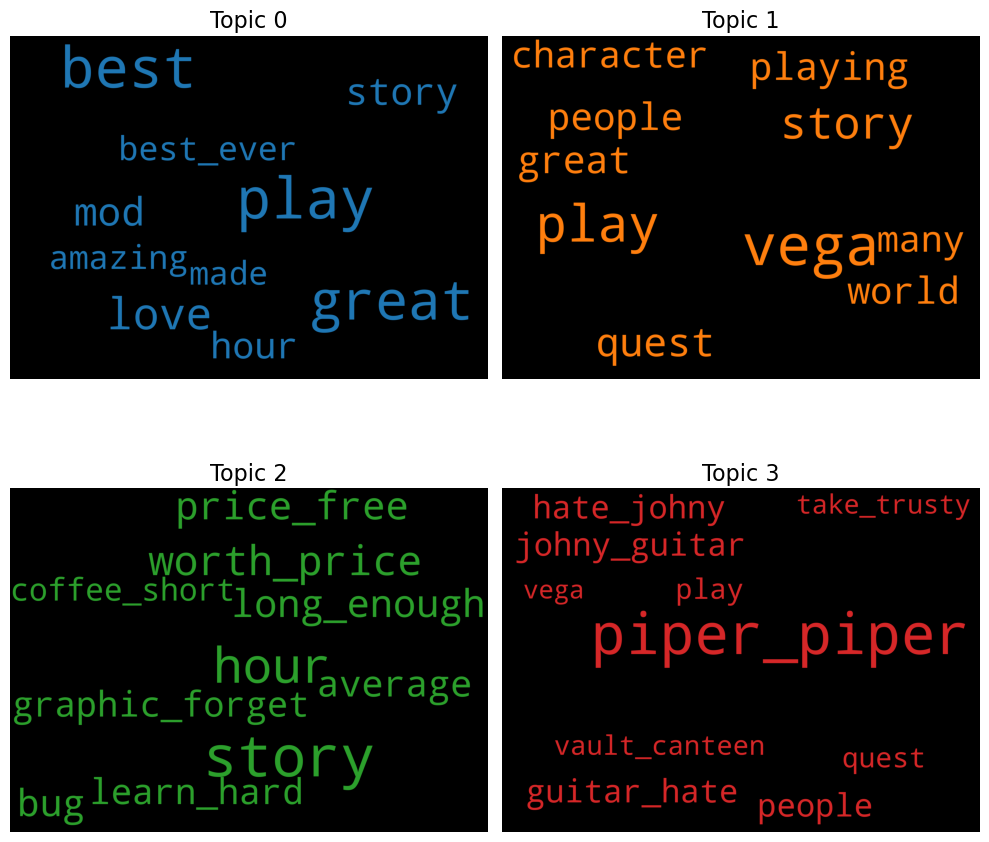

In [35]:
# Wordcloud of Top N words in each topic for voted up

from matplotlib import pyplot as plt
from wordcloud import WordCloud, STOPWORDS
import matplotlib.colors as mcolors

cols = [color for name, color in mcolors.TABLEAU_COLORS.items()]  # more colors: 'mcolors.XKCD_COLORS'

cloud = WordCloud(background_color='black',
                  width=2500,
                  height=1800,
                  max_words=10,
                  colormap='viridis',
                  color_func=lambda *args, **kwargs: cols[i],
                  prefer_horizontal=1.0)

topics = lda_model_voted_up.show_topics(formatted=False)

fig, axes = plt.subplots(2, 2, figsize=(10,10), sharex=True, sharey=True)

for i, ax in enumerate(axes.flatten()):
    fig.add_subplot(ax)
    topic_words = dict(topics[i][1])
    cloud.generate_from_frequencies(topic_words, max_font_size=300)
    plt.gca().imshow(cloud)
    plt.gca().set_title('Topic ' + str(i), fontdict=dict(size=16))
    plt.gca().axis('off')


plt.subplots_adjust(wspace=0, hspace=0)
plt.axis('off')
plt.margins(x=0, y=0)
plt.tight_layout()
plt.show()

C:\Users\jocel\anaconda3\lib\site-packages\wordcloud\wordcloud.py:508: DeprecationWarning: textsize is deprecated and will be removed in Pillow 10 (2023-07-01). Use textbbox or textlength instead.
  box_size = draw.textsize(word, font=transposed_font)
C:\Users\jocel\anaconda3\lib\site-packages\wordcloud\wordcloud.py:508: DeprecationWarning: textsize is deprecated and will be removed in Pillow 10 (2023-07-01). Use textbbox or textlength instead.
  box_size = draw.textsize(word, font=transposed_font)
C:\Users\jocel\anaconda3\lib\site-packages\wordcloud\wordcloud.py:508: DeprecationWarning: textsize is deprecated and will be removed in Pillow 10 (2023-07-01). Use textbbox or textlength instead.
  box_size = draw.textsize(word, font=transposed_font)
C:\Users\jocel\anaconda3\lib\site-packages\wordcloud\wordcloud.py:508: DeprecationWarning: textsize is deprecated and will be removed in Pillow 10 (2023-07-01). Use textbbox or textlength instead.
  box_size = draw.textsize(word, font=transpose

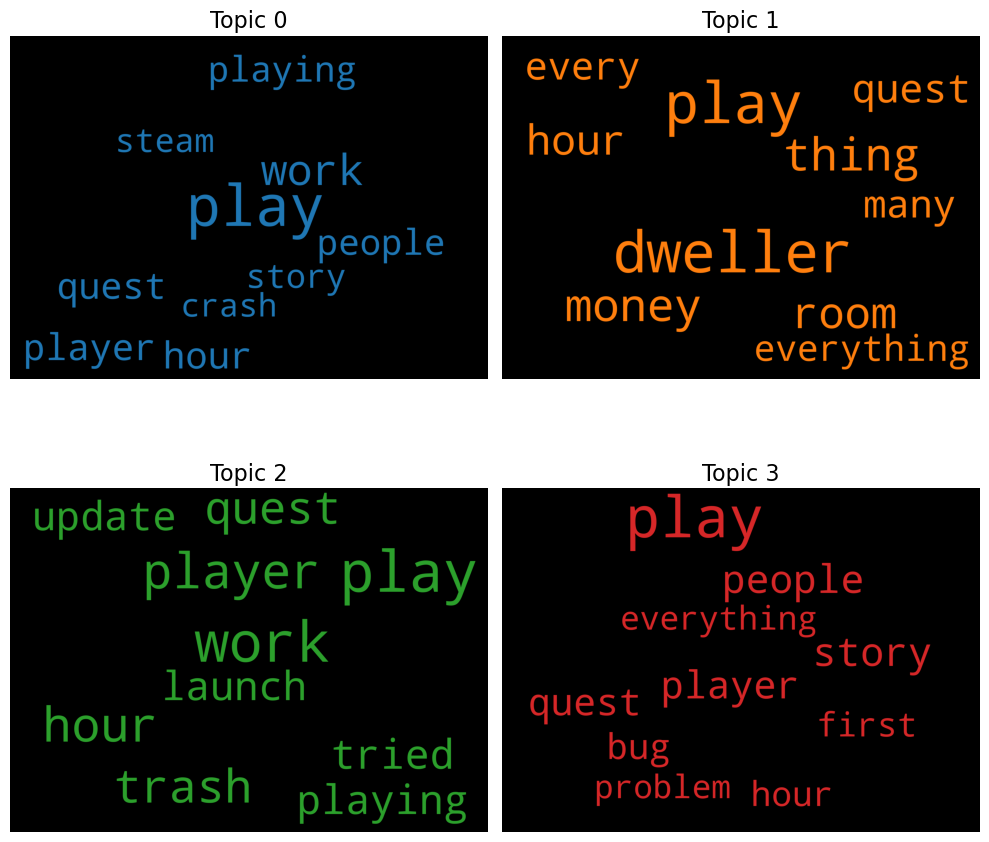

In [36]:
# Wordcloud of Top N words in each topic for voted down

from matplotlib import pyplot as plt
from wordcloud import WordCloud, STOPWORDS
import matplotlib.colors as mcolors

cols = [color for name, color in mcolors.TABLEAU_COLORS.items()]  # more colors: 'mcolors.XKCD_COLORS'

cloud = WordCloud(background_color='black',
                  width=2500,
                  height=1800,
                  max_words=10,
                  colormap='viridis',
                  color_func=lambda *args, **kwargs: cols[i],
                  prefer_horizontal=1.0)

topics = lda_model_voted_down.show_topics(formatted=False)

fig, axes = plt.subplots(2, 2, figsize=(10,10), sharex=True, sharey=True)

for i, ax in enumerate(axes.flatten()):
    fig.add_subplot(ax)
    topic_words = dict(topics[i][1])
    cloud.generate_from_frequencies(topic_words, max_font_size=300)
    plt.gca().imshow(cloud)
    plt.gca().set_title('Topic ' + str(i), fontdict=dict(size=16))
    plt.gca().axis('off')


plt.subplots_adjust(wspace=0, hspace=0)
plt.axis('off')
plt.margins(x=0, y=0)
plt.tight_layout()
plt.show()

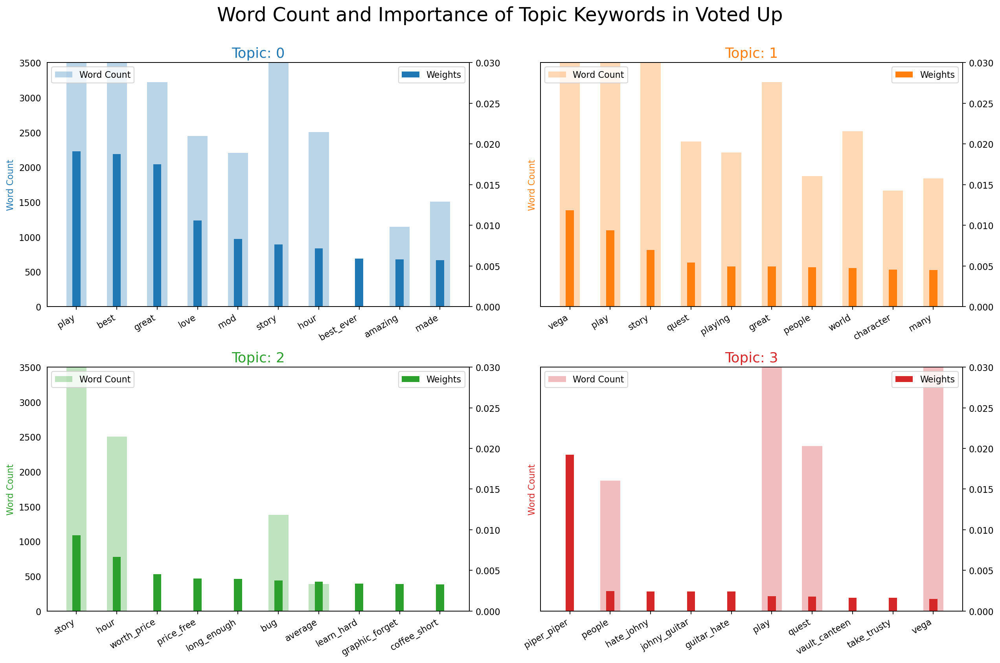

In [37]:
from collections import Counter
topics = lda_model_voted_up.show_topics(formatted=False)
data_flat = [w for w_list in voted_up["review_preprocessed"] for w in w_list]
counter = Counter(data_flat)

out = []
for i, topic in topics:
    for word, weight in topic:
        out.append([word, i , weight, counter[word]])

df1 = pd.DataFrame(out, columns=['word', 'topic_id', 'importance', 'word_count'])        

# Plot Word Count and Weights of Topic Keywords
fig, axes = plt.subplots(2, 2, figsize=(16,10), sharey=True, dpi=160)
cols = [color for name, color in mcolors.TABLEAU_COLORS.items()]
for i, ax in enumerate(axes.flatten()):
    ax.bar(x='word', height="word_count", data=df1.loc[df1.topic_id==i, :], color=cols[i], width=0.5, alpha=0.3, label='Word Count')
    ax_twin = ax.twinx()
    ax_twin.bar(x='word', height="importance", data=df1.loc[df1.topic_id==i, :], color=cols[i], width=0.2, label='Weights')
    ax.set_ylabel('Word Count', color=cols[i])
    ax_twin.set_ylim(0, 0.030); ax.set_ylim(0, 3500)
    ax.set_title('Topic: ' + str(i), color=cols[i], fontsize=16)
    ax.tick_params(axis='y', left=False)
    ax.set_xticklabels(df1.loc[df1.topic_id==i, 'word'], rotation=30, horizontalalignment= 'right')
    ax.legend(loc='upper left'); ax_twin.legend(loc='upper right')

fig.tight_layout(w_pad=2)    
fig.suptitle('Word Count and Importance of Topic Keywords in Voted Up', fontsize=22, y=1.05)    
plt.show()

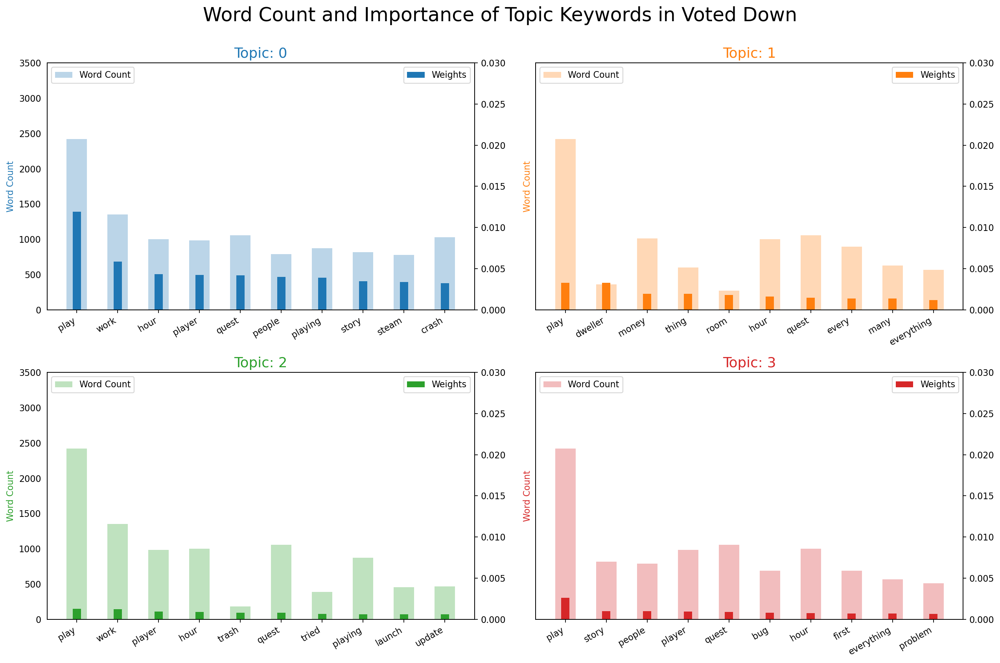

In [38]:
from collections import Counter
topics = lda_model_voted_down.show_topics(formatted=False)
data_flat = [w for w_list in voted_down["review_preprocessed"] for w in w_list]
counter = Counter(data_flat)

out = []
for i, topic in topics:
    for word, weight in topic:
        out.append([word, i , weight, counter[word]])

df2 = pd.DataFrame(out, columns=['word', 'topic_id', 'importance', 'word_count'])        

# Plot Word Count and Weights of Topic Keywords
fig, axes = plt.subplots(2, 2, figsize=(16,10), sharey=True, dpi=160)
cols = [color for name, color in mcolors.TABLEAU_COLORS.items()]
for i, ax in enumerate(axes.flatten()):
    ax.bar(x='word', height="word_count", data=df2.loc[df2.topic_id==i, :], color=cols[i], width=0.5, alpha=0.3, label='Word Count')
    ax_twin = ax.twinx()
    ax_twin.bar(x='word', height="importance", data=df2.loc[df2.topic_id==i, :], color=cols[i], width=0.2, label='Weights')
    ax.set_ylabel('Word Count', color=cols[i])
    ax_twin.set_ylim(0, 0.030); ax.set_ylim(0, 3500)
    ax.set_title('Topic: ' + str(i), color=cols[i], fontsize=16)
    ax.tick_params(axis='y', left=False)
    ax.set_xticklabels(df2.loc[df2.topic_id==i, 'word'], rotation=30, horizontalalignment= 'right')
    ax.legend(loc='upper left'); ax_twin.legend(loc='upper right')

fig.tight_layout(w_pad=2)    
fig.suptitle('Word Count and Importance of Topic Keywords in Voted Down', fontsize=22, y=1.05)    
plt.show()

In [39]:
# most discussed topics in the documents voted up

def topics_per_document(model, corpus, start=0, end=1):
    corpus_sel = corpus[start:end]
    dominant_topics = []
    topic_percentages = []
    for i, corp in enumerate(corpus_sel):
        topic_percs, wordid_topics, wordid_phivalues = model[corp]
        dominant_topic = sorted(topic_percs, key = lambda x: x[1], reverse=True)[0][0]
        dominant_topics.append((i, dominant_topic))
        topic_percentages.append(topic_percs)
    return(dominant_topics, topic_percentages)

dominant_topics_voted_up, topic_percentages_voted_up = topics_per_document(model=lda_model_voted_up, corpus=corpus_voted_up, end=-1)            

# Distribution of Dominant Topics in Each Document
df_voted_up = pd.DataFrame(dominant_topics_voted_up, columns=['Document_Id', 'Dominant_Topic'])
dominant_topic_in_each_doc = df_voted_up.groupby('Dominant_Topic').size()
df_dominant_topic_in_each_doc_voted_up = dominant_topic_in_each_doc.to_frame(name='count').reset_index()

# Total Topic Distribution by actual weight
topic_weightage_by_doc = pd.DataFrame([dict(t) for t in topic_percentages_voted_up])
df_topic_weightage_by_doc_voted_up = topic_weightage_by_doc.sum().to_frame(name='count').reset_index()

# Top 3 Keywords for each Topic
topic_top3words_voted_up = [(i, topic) for i, topics in lda_model_voted_up.show_topics(formatted=False) 
                                 for j, (topic, wt) in enumerate(topics) if j < 3]

df_top3words_stacked = pd.DataFrame(topic_top3words_voted_up, columns=['topic_id', 'words'])
df_top3words_voted_up = df_top3words_stacked.groupby('topic_id').agg(', \n'.join)
df_top3words_voted_up.reset_index(level=0,inplace=True)

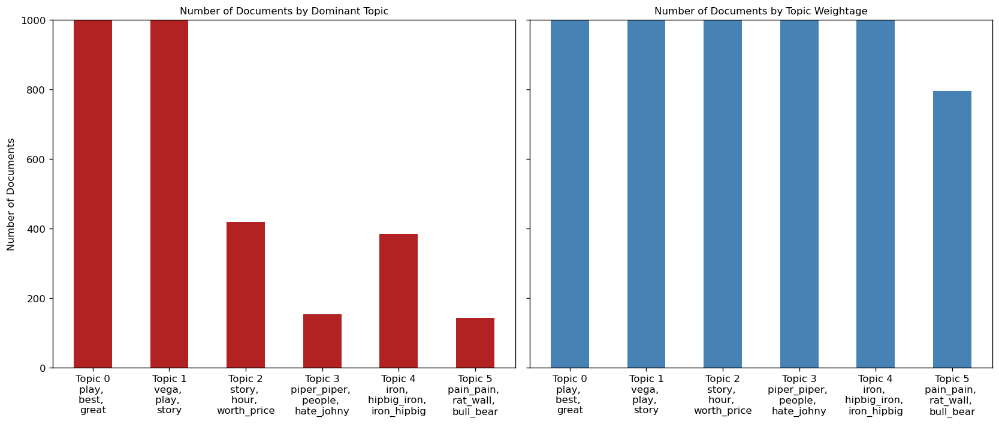

In [40]:
from matplotlib.ticker import FuncFormatter

# Plot
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(14, 6), dpi=120, sharey=True)

# Topic Distribution by Dominant Topics
ax1.bar(x='Dominant_Topic', height='count', data=df_dominant_topic_in_each_doc_voted_up, width=.5, color='firebrick')
ax1.set_xticks(range(df_dominant_topic_in_each_doc_voted_up.Dominant_Topic.unique().__len__()))
tick_formatter = FuncFormatter(lambda x, pos: 'Topic ' + str(x)+ '\n' + df_top3words_voted_up.loc[df_top3words_voted_up.topic_id==x, 'words'].values[0])
ax1.xaxis.set_major_formatter(tick_formatter)
ax1.set_title('Number of Documents by Dominant Topic', fontdict=dict(size=10))
ax1.set_ylabel('Number of Documents')
# ax1.set_xticklabels(ax1.get_xticklabels(), rotation = 45)
ax1.set_ylim(0, 1000)

# Topic Distribution by Topic Weights
ax2.bar(x='index', height='count', data=df_topic_weightage_by_doc_voted_up, width=.5, color='steelblue')
ax2.set_xticks(range(df_topic_weightage_by_doc_voted_up.index.unique().__len__()))
ax2.xaxis.set_major_formatter(tick_formatter)
# ax2.set_xticklabels(ax2.get_xticklabels(), rotation = 45)
ax2.set_title('Number of Documents by Topic Weightage', fontdict=dict(size=10))

plt.tight_layout()
plt.show()

In [41]:
# most discussed topics in the documents voted down

def topics_per_document(model, corpus, start=0, end=1):
    corpus_sel = corpus[start:end]
    dominant_topics = []
    topic_percentages = []
    for i, corp in enumerate(corpus_sel):
        topic_percs, wordid_topics, wordid_phivalues = model[corp]
        dominant_topic = sorted(topic_percs, key = lambda x: x[1], reverse=True)[0][0]
        dominant_topics.append((i, dominant_topic))
        topic_percentages.append(topic_percs)
    return(dominant_topics, topic_percentages)

dominant_topics_voted_down, topic_percentages_voted_down = topics_per_document(model=lda_model_voted_down, corpus=corpus_voted_down, end=-1)            

# Distribution of Dominant Topics in Each Document
df_voted_down = pd.DataFrame(dominant_topics_voted_down, columns=['Document_Id', 'Dominant_Topic'])
dominant_topic_in_each_doc = df_voted_down.groupby('Dominant_Topic').size()
df_dominant_topic_in_each_doc_voted_down = dominant_topic_in_each_doc.to_frame(name='count').reset_index()

# Total Topic Distribution by actual weight
topic_weightage_by_doc = pd.DataFrame([dict(t) for t in topic_percentages_voted_down])
df_topic_weightage_by_doc_voted_down = topic_weightage_by_doc.sum().to_frame(name='count').reset_index()

# Top 3 Keywords for each Topic
topic_top3words_voted_down = [(i, topic) for i, topics in lda_model_voted_down.show_topics(formatted=False) 
                                 for j, (topic, wt) in enumerate(topics) if j < 3]

df_top3words_stacked = pd.DataFrame(topic_top3words_voted_down, columns=['topic_id', 'words'])
df_top3words_voted_down = df_top3words_stacked.groupby('topic_id').agg(', \n'.join)
df_top3words_voted_down.reset_index(level=0,inplace=True)

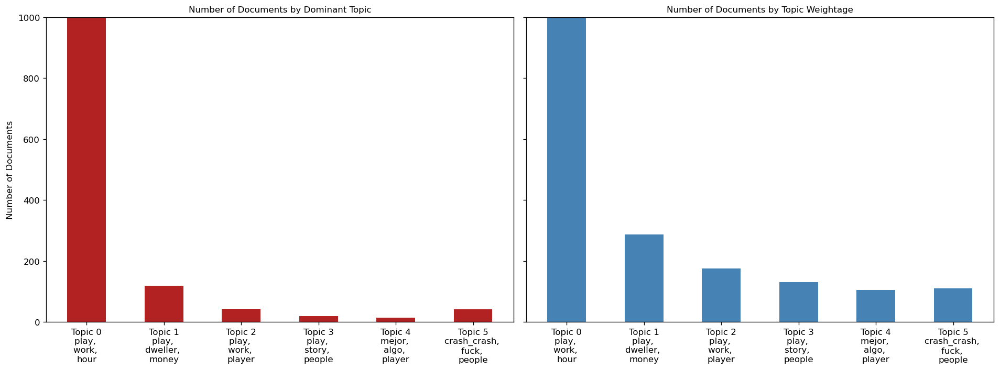

In [42]:
from matplotlib.ticker import FuncFormatter

# Plot
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(16, 6), dpi=120, sharey=True)

# Topic Distribution by Dominant Topics
ax1.bar(x='Dominant_Topic', height='count', data=df_dominant_topic_in_each_doc_voted_down, width=.5, color='firebrick')
ax1.set_xticks(range(df_dominant_topic_in_each_doc_voted_down.Dominant_Topic.unique().__len__()))
tick_formatter = FuncFormatter(lambda x, pos: 'Topic ' + str(x)+ '\n' + df_top3words_voted_down.loc[df_top3words_voted_down.topic_id==x, 'words'].values[0])
ax1.xaxis.set_major_formatter(tick_formatter)
ax1.set_title('Number of Documents by Dominant Topic', fontdict=dict(size=10))
ax1.set_ylabel('Number of Documents')
# ax1.set_xticklabels(ax1.get_xticklabels(), rotation = 45)
ax1.set_ylim(0, 1000)

# Topic Distribution by Topic Weights
ax2.bar(x='index', height='count', data=df_topic_weightage_by_doc_voted_down, width=.5, color='steelblue')
ax2.set_xticks(range(df_topic_weightage_by_doc_voted_down.index.unique().__len__()))
ax2.xaxis.set_major_formatter(tick_formatter)
# ax2.set_xticklabels(ax2.get_xticklabels(), rotation = 45)
ax2.set_title('Number of Documents by Topic Weightage', fontdict=dict(size=10))

plt.tight_layout()
plt.show()